Imports

In [1]:
import numpy as np
import torch
import torch.nn as nn
from torch import optim
import torch.nn.functional as F
from torch.utils.data import DataLoader

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

from utils import extract_time
from utils import random_generator
from utils import MinMaxScaler
from utils import sine_data_generation
from utils import real_data_loading
from utils import visualization

from modules_and_training import TimeGAN
from modules_and_training import Time_GAN_module


Parameters

In [2]:
#output_size = 20
gamma = 1
#no, seq_len, dim = 3685,24,6 utlisé pour le sine

parameters = dict()
parameters['module'] = 'gru' 
parameters['hidden_dim'] = 40
parameters['num_layers'] = 1
parameters['iterations'] = 100
parameters['batch_size'] = 5
parameters['epoch'] = 1


#paramétrage learning rate

learning_rates = [0.035,0.01,0.001,0.01,0.01]

In [3]:
def real_data_loading (lien_local_data,delimiter,skiprows ,seq_length):

    x = np.loadtxt(lien_local_data, delimiter,skiprows=skiprows)
    
    # Flip the data to make chronological data
    x = x[::-1]
    # Min-Max Normalizer
    x = MinMaxScaler(x)
    
    # Build dataset
    dataX = []
    
    # Cut data by sequence length
    for i in range(0, len(x) - seq_length):
        _x = x[i:i + seq_length]
        dataX.append(_x)
        
    # Mix Data (to make it similar to i.i.d)
    idx = np.random.permutation(len(dataX))
    
    outputX = []
    for i in range(len(dataX)):
        outputX.append(dataX[idx[i]])
    
    return outputX

data=real_data_loading (delimiter =",",skiprows =1 ,seq_length=24)


TypeError: real_data_loading() missing 1 required positional argument: 'lien_local_data'

Data Generation:
12800 synthetic time univariate timeseries are created, with 24 timesteps each 

In [3]:
type='real_data'

if type =='sine':
    no, seq_len, dim = 3685,24,6
    data = sine_data_generation(no, seq_len, dim)
elif type == 'real_data':
    lien_local_data = 'C:/Users/alpho/Downloads/GOOGLE_BIG.csv'
    delimiter="," 
    #skiprows = 1
    seq_len = 5
    data=real_data_loading (lien_local_data=lien_local_data,delimiter =delimiter,skiprows =1 ,seq_length=seq_len)

data = MinMaxScaler(data)
data = torch.Tensor(data)
data.shape

SyntaxError: invalid syntax (<unknown>, line 1)

In [13]:
len(data)
len(data[0][0,:])

6

In [33]:
import pandas as pd
import numpy as np

csv_file_path = 'C:/Users/alpho/Downloads/GOOGLE_BIG.csv'


d = pd.read_csv(csv_file_path)
d = d.to_numpy()

#d = d.values.reshape(d.shape[0], 1, d.shape[1])
#d=np.transpose(d, (0,2, 1))
#d = torch.Tensor(d)

d.shape

(3685, 6)

In [47]:
d=google_data_loading(5)
#len(d)
len(d[0][0,:])
np.asarray(d).shape

(3680, 5, 6)

In [49]:
from numpy import dtype
data.dtype
d = torch.Tensor(d)

Training and Examination of generating process: for each epoch a single sample is generated from the current state of the generator and visualized alongside with the coressponding loss values

Début entrainement de lEmbedding Network 
Fin de lentrainement de lEmbedding Network 
Début Training avec la Supervised Loss 
Fin Training avec la Supervised Loss 
Début Training conjoint
step: 0/1, D_loss: 3.8140688, G_loss_U: 0.24809796, G_loss_S: 0.0060225804, E_loss_t0: 1.7530951


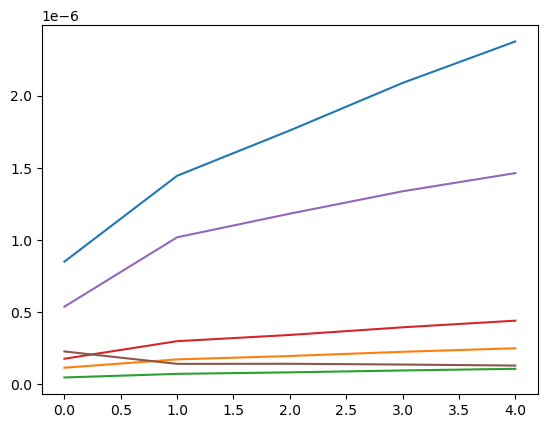

step: 0/1, D_loss: 3.2543154, G_loss_U: 0.35403955, G_loss_S: 0.0065968903, E_loss_t0: 1.7803603


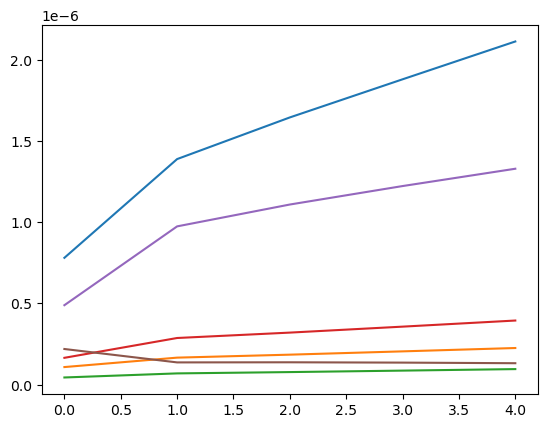

step: 0/1, D_loss: 2.660771, G_loss_U: 0.49260193, G_loss_S: 0.009868393, E_loss_t0: 2.1412387


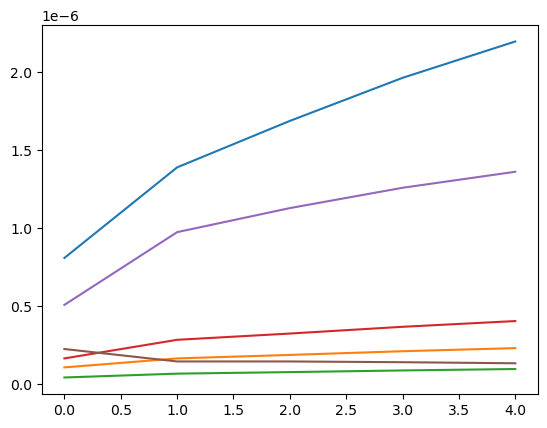

step: 0/1, D_loss: 2.2178555, G_loss_U: 0.6456688, G_loss_S: 0.020402918, E_loss_t0: 1.6450709


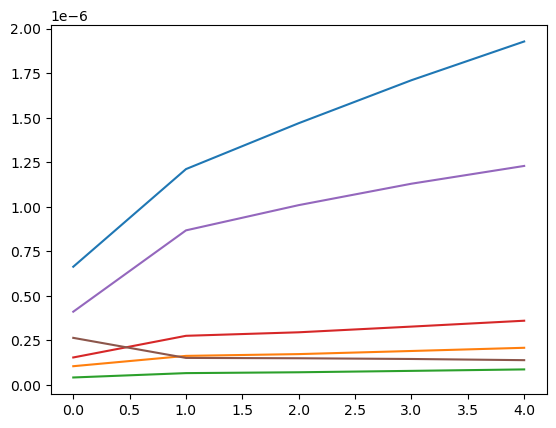

step: 0/1, D_loss: 1.9901457, G_loss_U: 0.79775274, G_loss_S: 0.028005132, E_loss_t0: 2.3708315


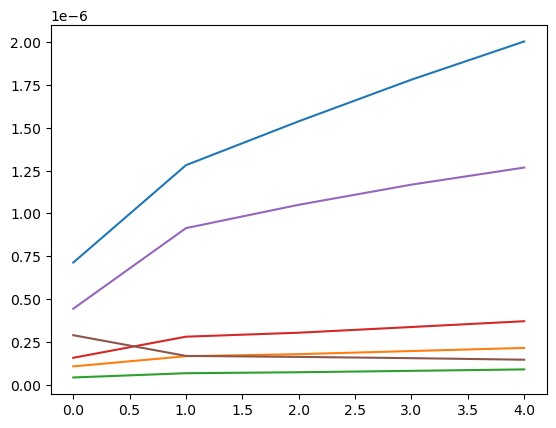

step: 0/1, D_loss: 1.8646741, G_loss_U: 0.93564653, G_loss_S: 0.0392056, E_loss_t0: 1.7477071


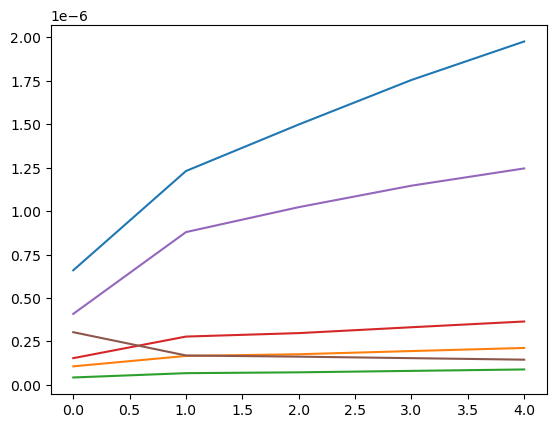

step: 0/1, D_loss: 1.8161863, G_loss_U: 1.0515145, G_loss_S: 0.04269176, E_loss_t0: 1.738133


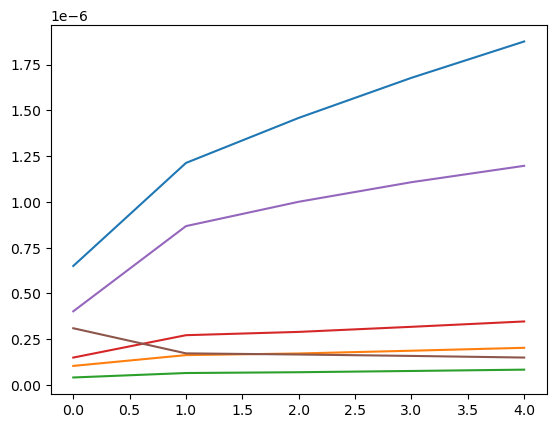

step: 0/1, D_loss: 1.780188, G_loss_U: 1.142957, G_loss_S: 0.04699848, E_loss_t0: 1.9852072


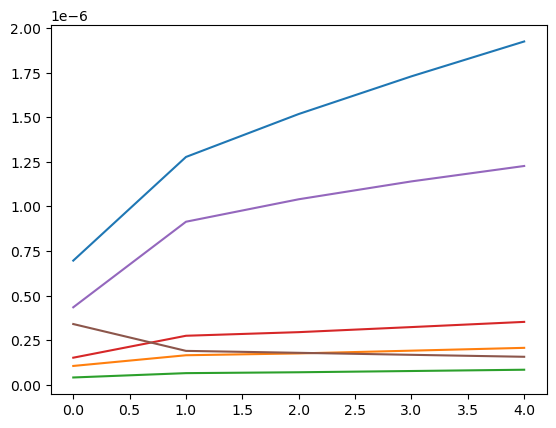

step: 0/1, D_loss: 1.725876, G_loss_U: 1.2122958, G_loss_S: 0.054079987, E_loss_t0: 2.3199716


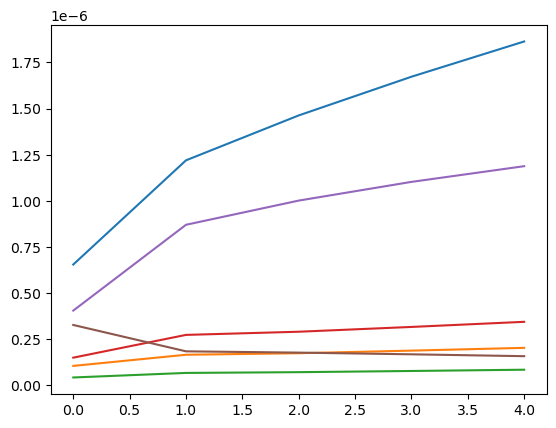

step: 0/1, D_loss: 1.6637167, G_loss_U: 1.2623127, G_loss_S: 0.06544837, E_loss_t0: 1.7486416


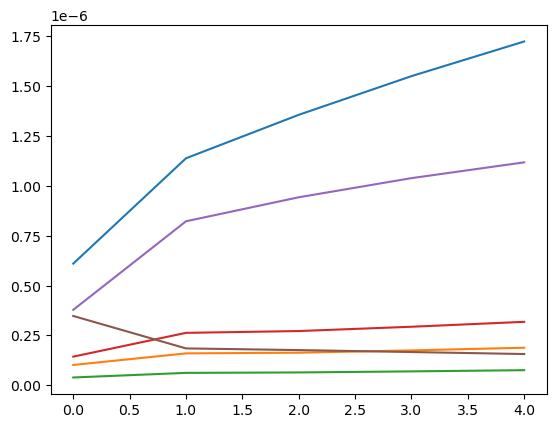

step: 0/1, D_loss: 1.5903032, G_loss_U: 1.2980568, G_loss_S: 0.078217365, E_loss_t0: 1.7602755


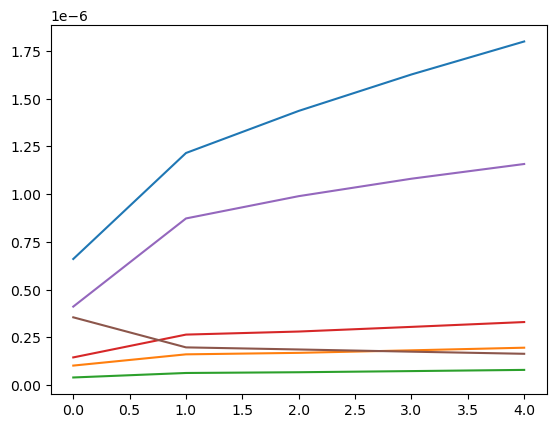

step: 0/1, D_loss: 1.5014822, G_loss_U: 1.3248737, G_loss_S: 0.09291367, E_loss_t0: 1.2962453


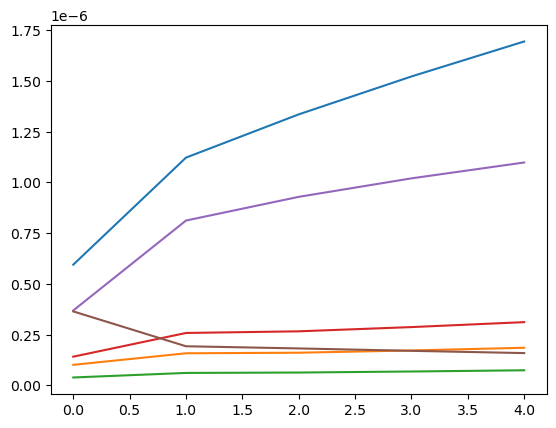

step: 0/1, D_loss: 1.3889354, G_loss_U: 1.3510128, G_loss_S: 0.10804746, E_loss_t0: 1.8155018


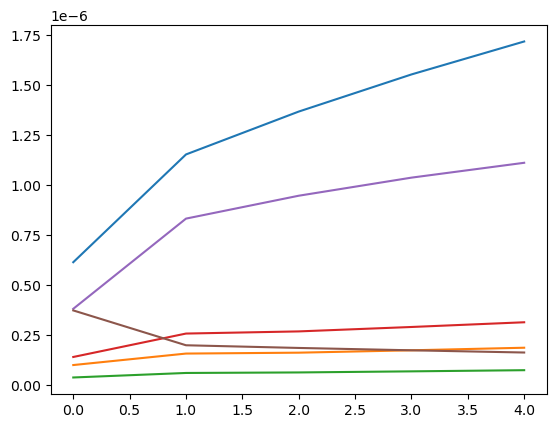

step: 0/1, D_loss: 1.2863401, G_loss_U: 1.3828658, G_loss_S: 0.11959196, E_loss_t0: 2.1690042


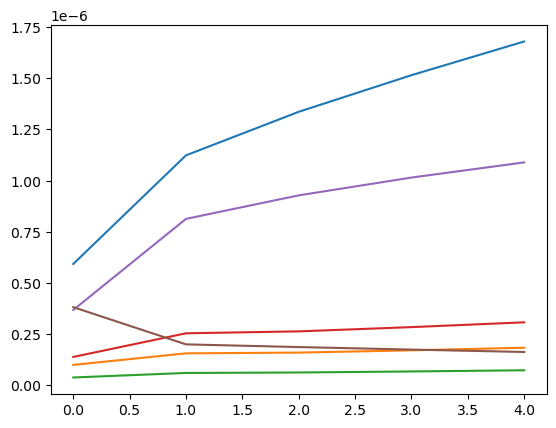

step: 0/1, D_loss: 1.1596706, G_loss_U: 1.4267987, G_loss_S: 0.12914155, E_loss_t0: 1.9284294


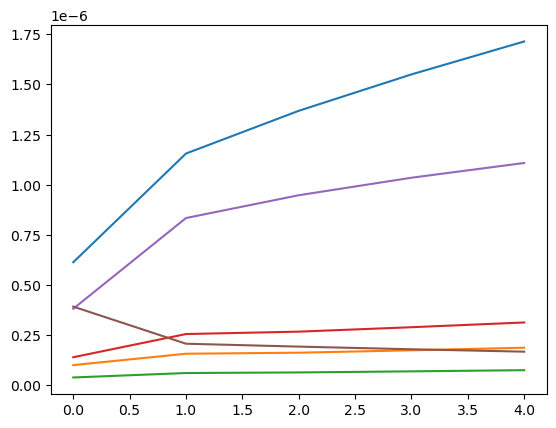

step: 0/1, D_loss: 1.0564177, G_loss_U: 1.4897346, G_loss_S: 0.13777925, E_loss_t0: 2.363482


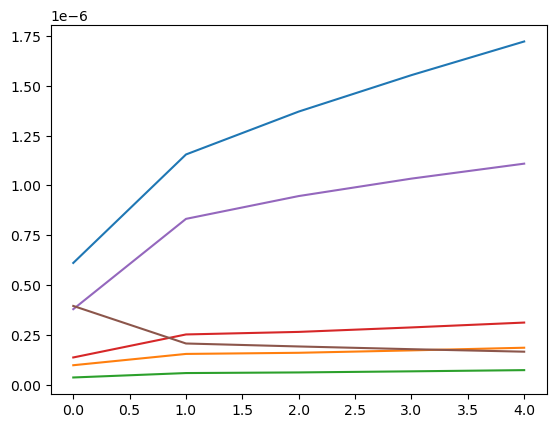

step: 0/1, D_loss: 0.9328658, G_loss_U: 1.5777359, G_loss_S: 0.13697912, E_loss_t0: 1.6311047


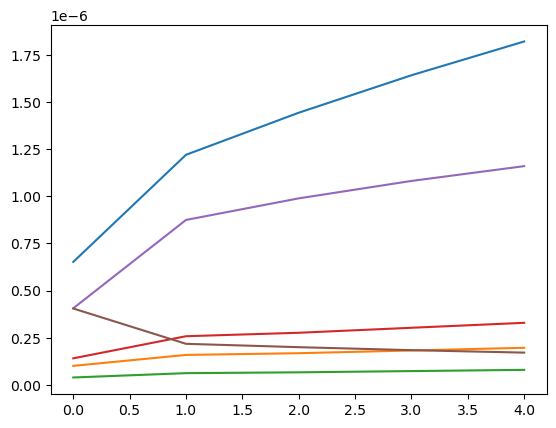

step: 0/1, D_loss: 0.8090384, G_loss_U: 1.7019837, G_loss_S: 0.14185178, E_loss_t0: 1.880967


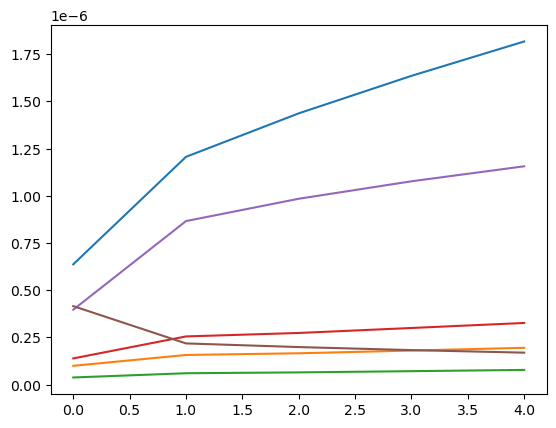

step: 0/1, D_loss: 0.70754856, G_loss_U: 1.8697313, G_loss_S: 0.14675246, E_loss_t0: 2.3057318


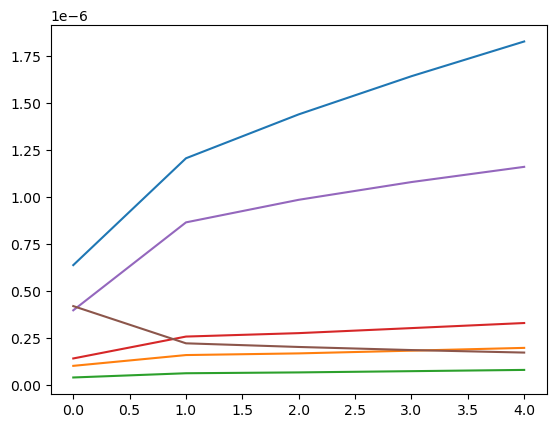

step: 0/1, D_loss: 0.587957, G_loss_U: 2.0785806, G_loss_S: 0.14304772, E_loss_t0: 1.9127997


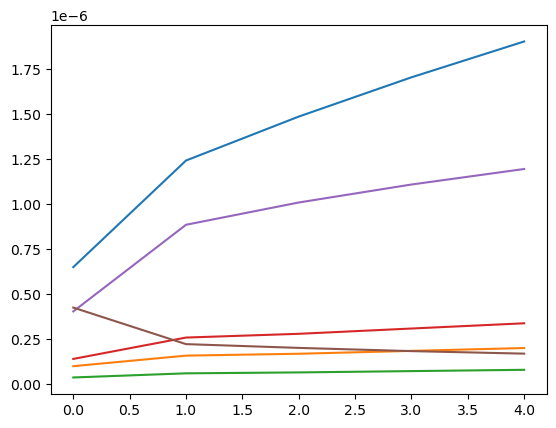

step: 0/1, D_loss: 0.48416397, G_loss_U: 2.3169265, G_loss_S: 0.14589283, E_loss_t0: 2.0974479


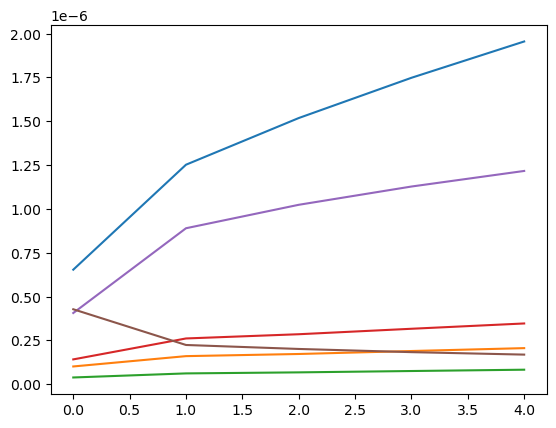

step: 0/1, D_loss: 0.3868683, G_loss_U: 2.5681999, G_loss_S: 0.14296181, E_loss_t0: 1.6304091


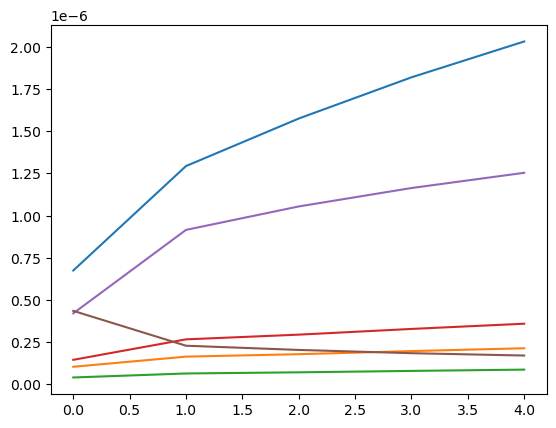

step: 0/1, D_loss: 0.31495208, G_loss_U: 2.819191, G_loss_S: 0.14379753, E_loss_t0: 1.2832732


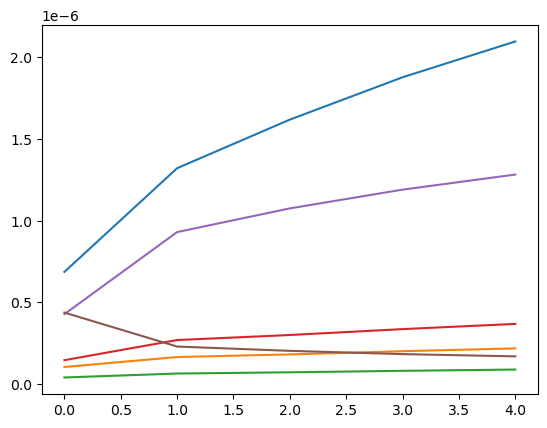

step: 0/1, D_loss: 0.2670288, G_loss_U: 3.064188, G_loss_S: 0.14435583, E_loss_t0: 2.37595


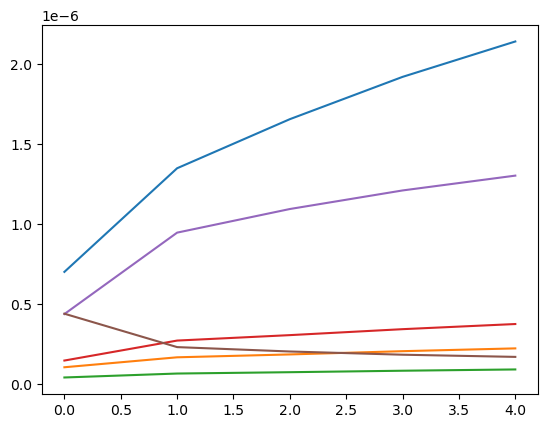

step: 0/1, D_loss: 0.21371841, G_loss_U: 3.3007739, G_loss_S: 0.1443299, E_loss_t0: 2.0416214


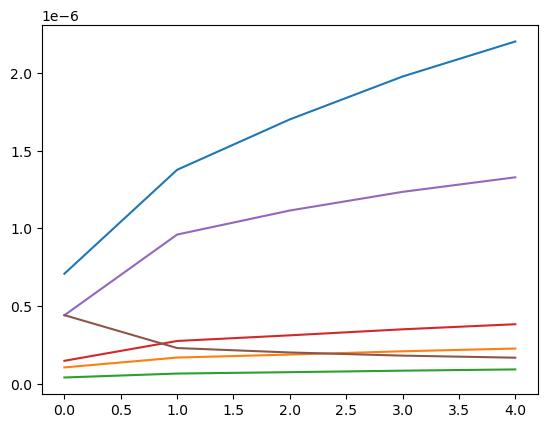

step: 0/1, D_loss: 0.1653696, G_loss_U: 3.5287683, G_loss_S: 0.14459127, E_loss_t0: 1.2636706


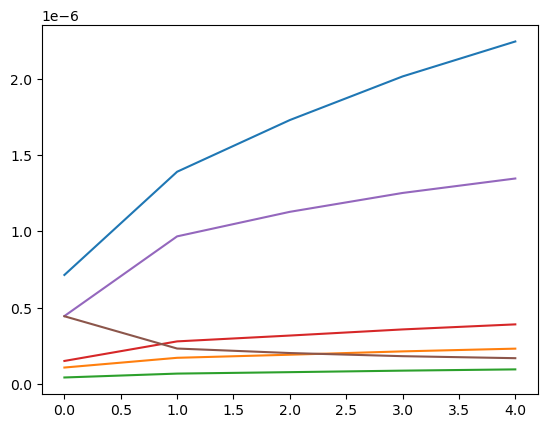

step: 0/1, D_loss: 0.13472345, G_loss_U: 3.527602, G_loss_S: 0.143675, E_loss_t0: 1.4626145


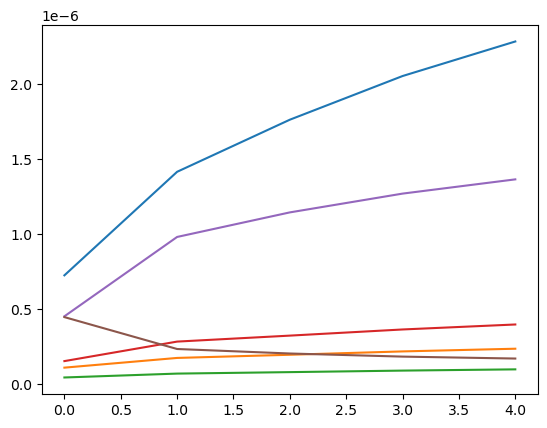

step: 0/1, D_loss: 0.13528226, G_loss_U: 3.5265543, G_loss_S: 0.14198795, E_loss_t0: 1.67172


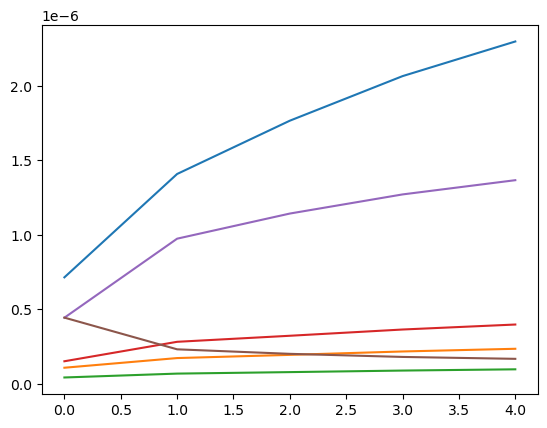

step: 0/1, D_loss: 0.13444595, G_loss_U: 3.5256116, G_loss_S: 0.13942714, E_loss_t0: 1.6302532


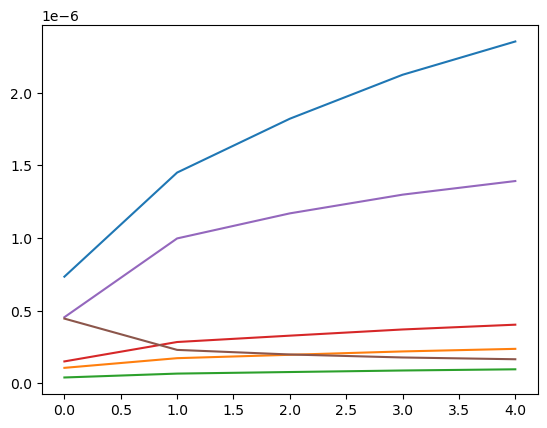

step: 0/1, D_loss: 0.13558862, G_loss_U: 3.5247564, G_loss_S: 0.13826995, E_loss_t0: 1.2805504


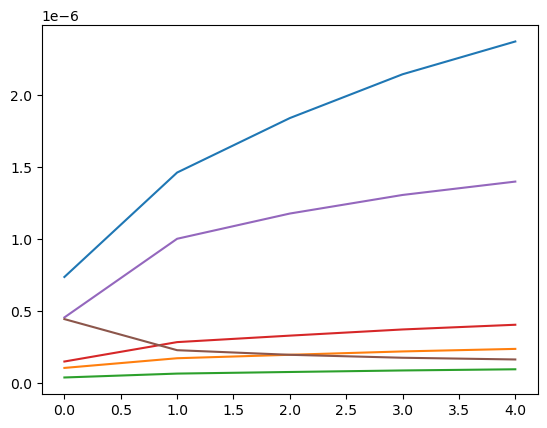

step: 0/1, D_loss: 0.13524337, G_loss_U: 3.523968, G_loss_S: 0.13511683, E_loss_t0: 1.5481513


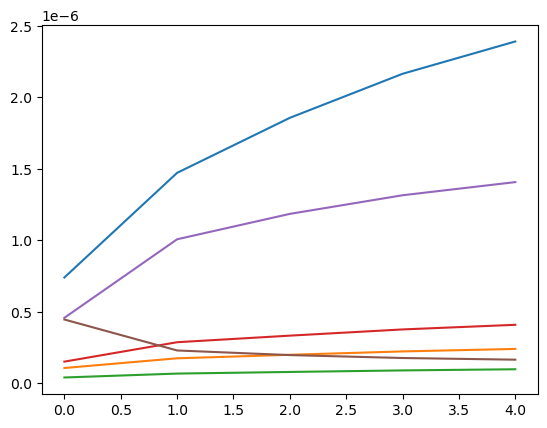

step: 0/1, D_loss: 0.13752843, G_loss_U: 3.5232258, G_loss_S: 0.13387737, E_loss_t0: 1.7738807


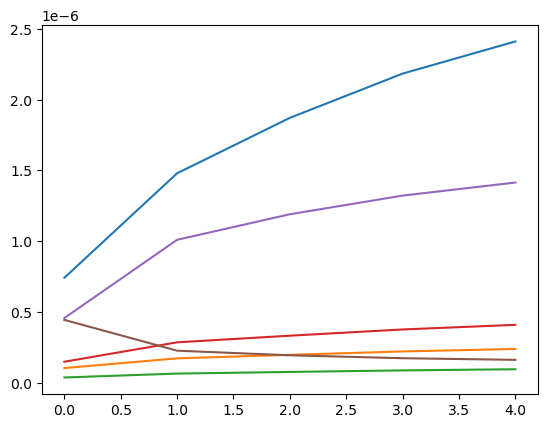

step: 0/1, D_loss: 0.15102088, G_loss_U: 3.7426794, G_loss_S: 0.13490617, E_loss_t0: 2.3348048


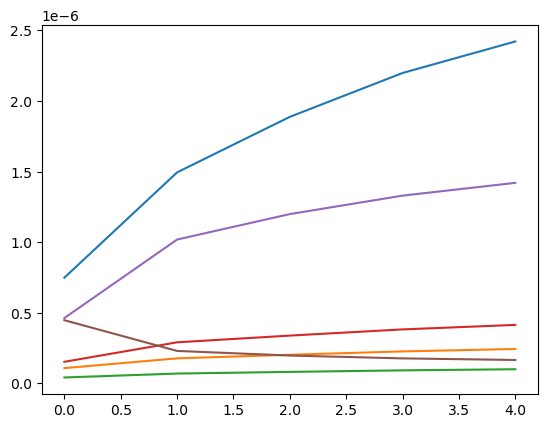

step: 0/1, D_loss: 0.11215767, G_loss_U: 3.7419827, G_loss_S: 0.13236678, E_loss_t0: 1.3157064


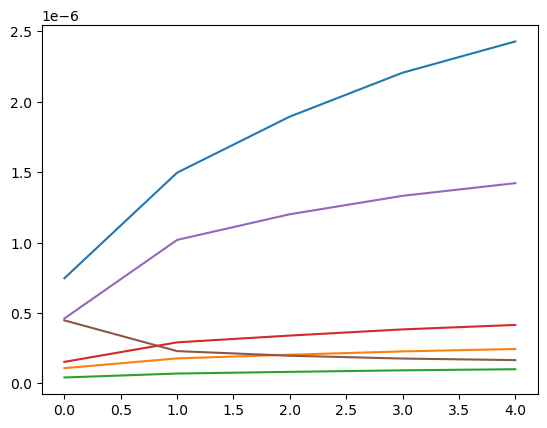

step: 0/1, D_loss: 0.12946476, G_loss_U: 3.7412875, G_loss_S: 0.13422535, E_loss_t0: 2.452843


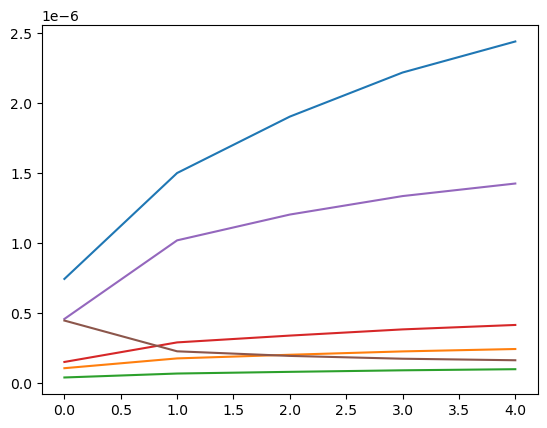

step: 0/1, D_loss: 0.12119993, G_loss_U: 3.7405906, G_loss_S: 0.13128145, E_loss_t0: 2.024572


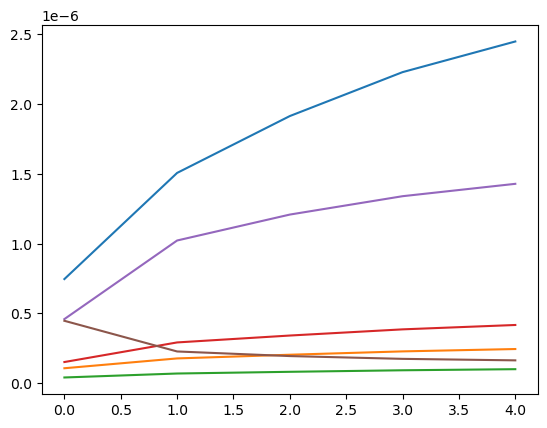

step: 0/1, D_loss: 0.11364248, G_loss_U: 3.739894, G_loss_S: 0.12920341, E_loss_t0: 1.3667899


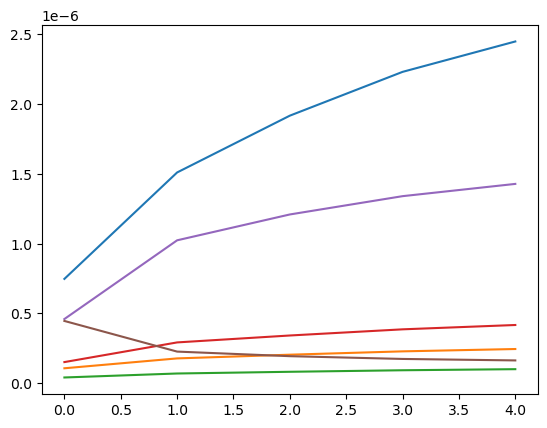

step: 0/1, D_loss: 0.11868655, G_loss_U: 3.7392058, G_loss_S: 0.1292973, E_loss_t0: 2.010438


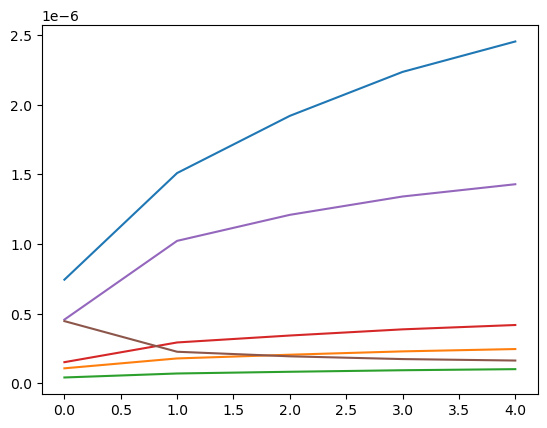

step: 0/1, D_loss: 0.1281692, G_loss_U: 3.73854, G_loss_S: 0.12691644, E_loss_t0: 2.2534802


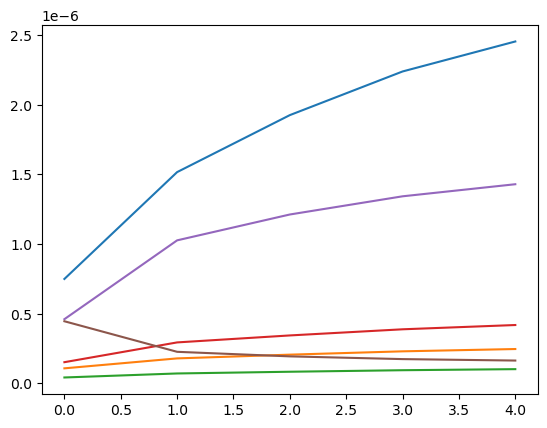

step: 0/1, D_loss: 0.123040214, G_loss_U: 3.7379098, G_loss_S: 0.12620845, E_loss_t0: 2.125643


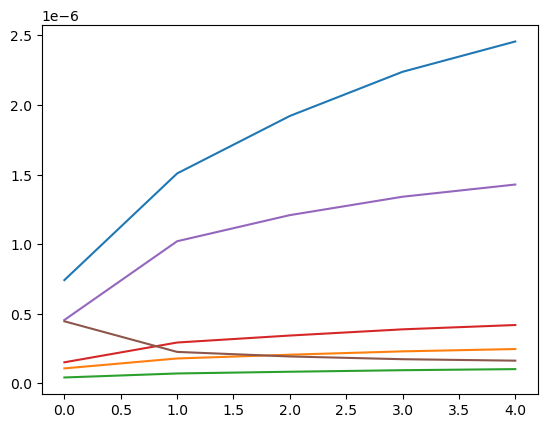

step: 0/1, D_loss: 0.11466497, G_loss_U: 3.7373254, G_loss_S: 0.12255042, E_loss_t0: 1.2696062


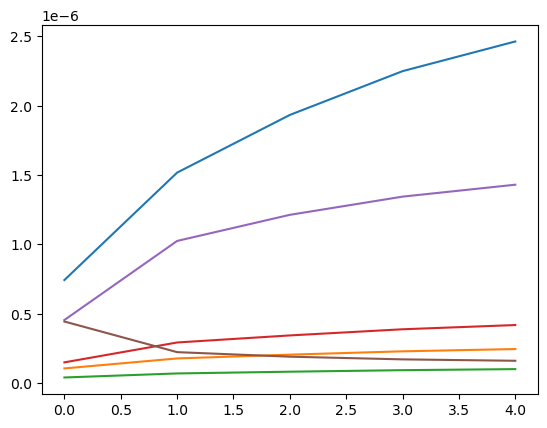

step: 0/1, D_loss: 0.120837085, G_loss_U: 3.7367914, G_loss_S: 0.12178481, E_loss_t0: 1.9276073


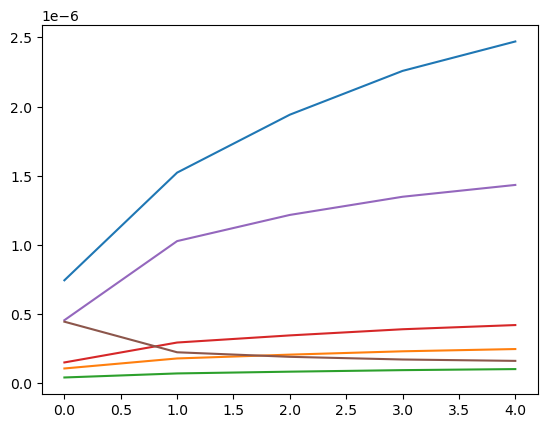

step: 0/1, D_loss: 0.12067436, G_loss_U: 3.7363067, G_loss_S: 0.12046606, E_loss_t0: 1.9514227


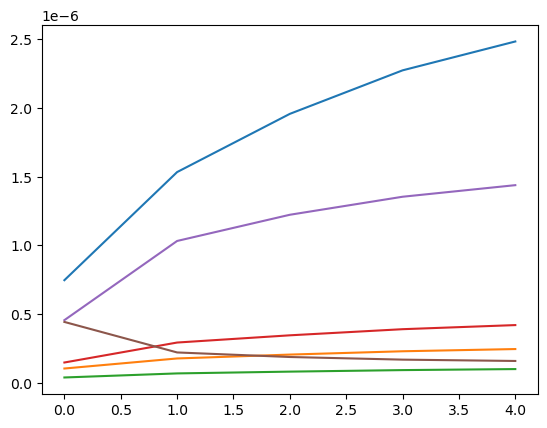

step: 0/1, D_loss: 0.11607504, G_loss_U: 3.735866, G_loss_S: 0.119830124, E_loss_t0: 1.3982764


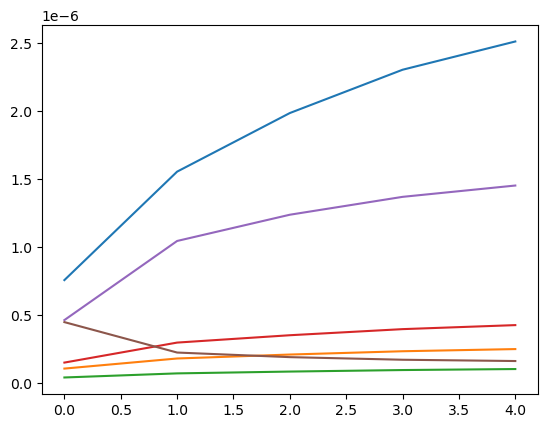

step: 0/1, D_loss: 0.11619246, G_loss_U: 3.7354612, G_loss_S: 0.11895693, E_loss_t0: 1.4760436


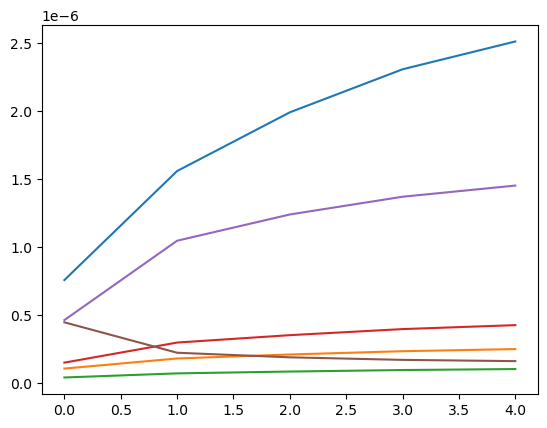

step: 0/1, D_loss: 0.1197611, G_loss_U: 3.7350817, G_loss_S: 0.11813721, E_loss_t0: 2.0048583


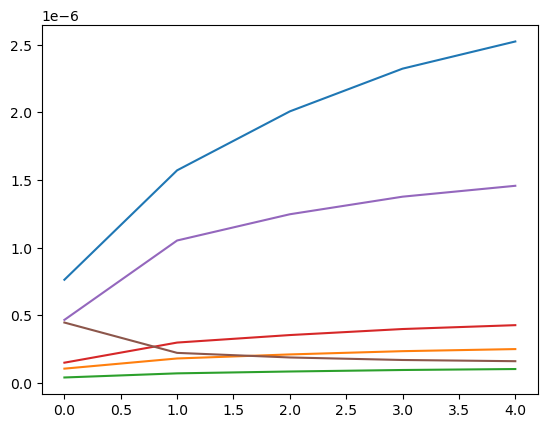

step: 0/1, D_loss: 0.11814928, G_loss_U: 3.734716, G_loss_S: 0.11646808, E_loss_t0: 1.8699816


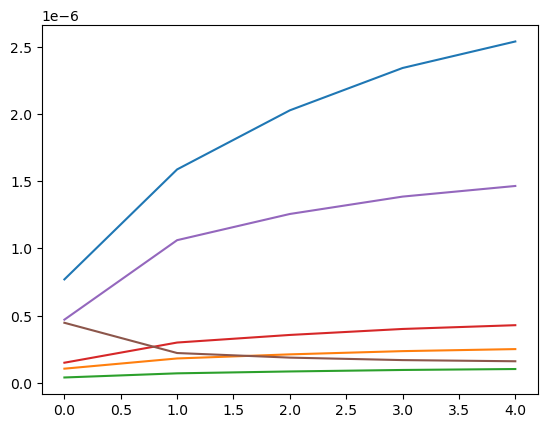

step: 0/1, D_loss: 0.11512058, G_loss_U: 3.7343528, G_loss_S: 0.11506367, E_loss_t0: 1.291791


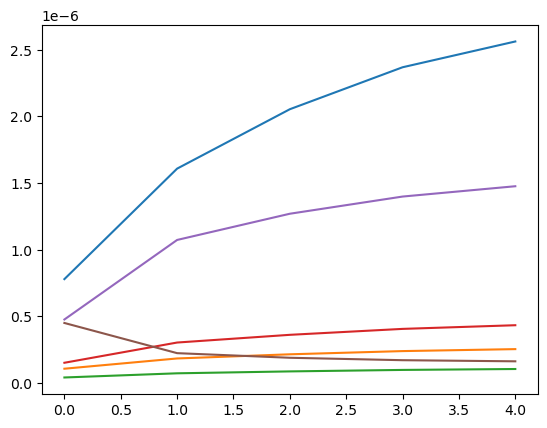

step: 0/1, D_loss: 0.12589636, G_loss_U: 3.7339795, G_loss_S: 0.11457604, E_loss_t0: 2.1608677


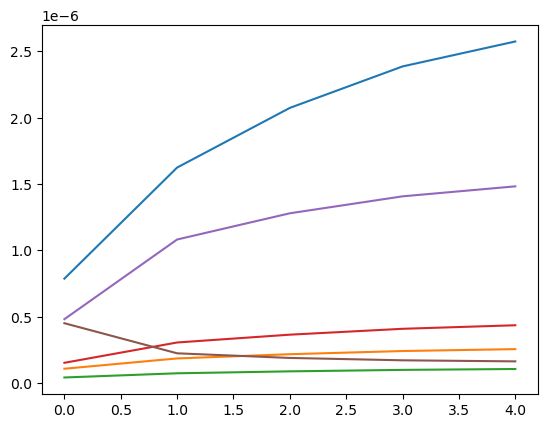

step: 0/1, D_loss: 0.12907742, G_loss_U: 3.733584, G_loss_S: 0.114021845, E_loss_t0: 2.3247423


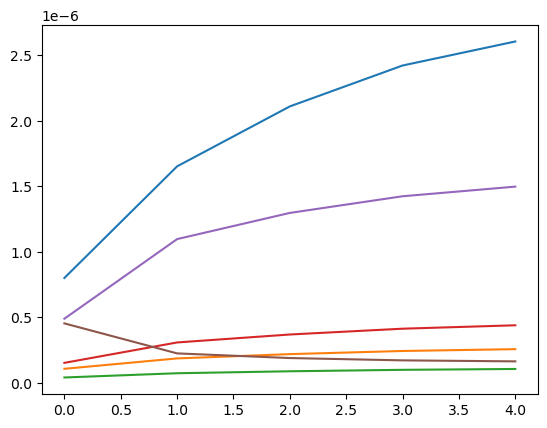

step: 0/1, D_loss: 0.1199388, G_loss_U: 3.7331524, G_loss_S: 0.11310044, E_loss_t0: 1.9347352


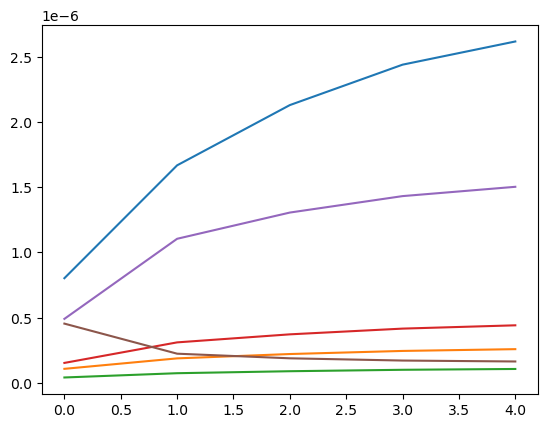

step: 0/1, D_loss: 0.12758298, G_loss_U: 3.7326744, G_loss_S: 0.113868445, E_loss_t0: 2.175613


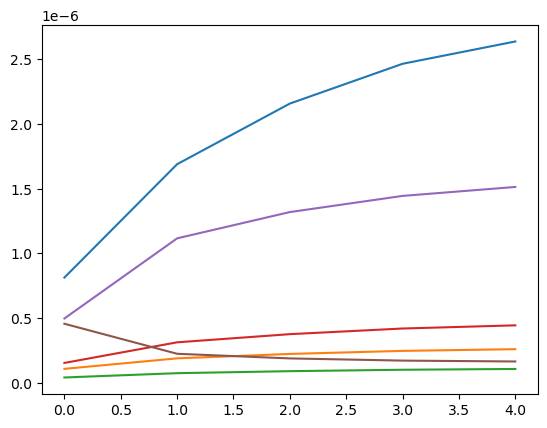

step: 0/1, D_loss: 0.11714183, G_loss_U: 3.7321408, G_loss_S: 0.11368902, E_loss_t0: 1.3128209


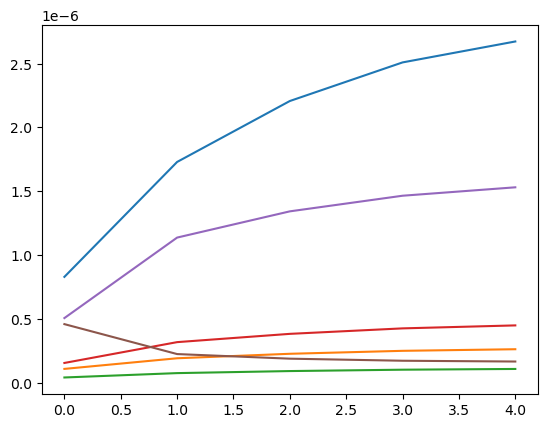

step: 0/1, D_loss: 0.122331426, G_loss_U: 3.7315457, G_loss_S: 0.113657214, E_loss_t0: 1.8532444


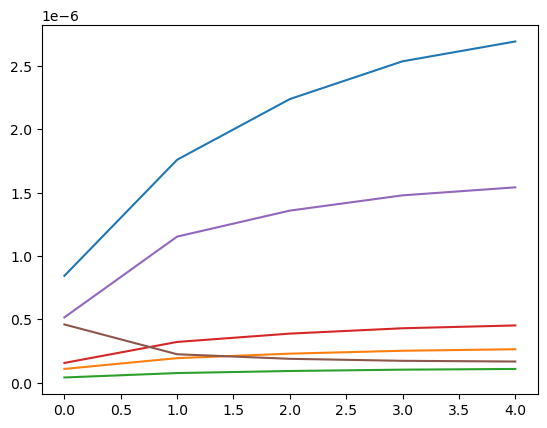

step: 0/1, D_loss: 0.11957157, G_loss_U: 3.7308862, G_loss_S: 0.114045314, E_loss_t0: 1.5623848


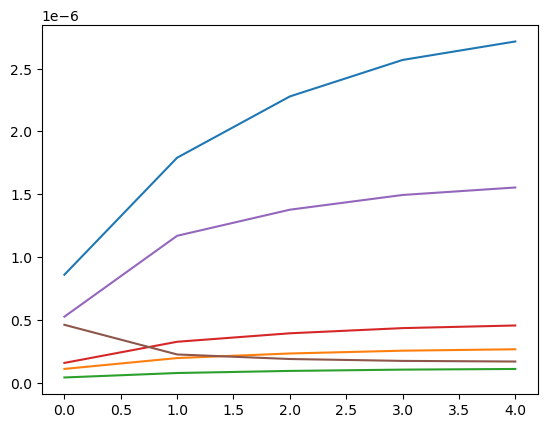

step: 0/1, D_loss: 0.11778578, G_loss_U: 3.730158, G_loss_S: 0.11349885, E_loss_t0: 1.2375274


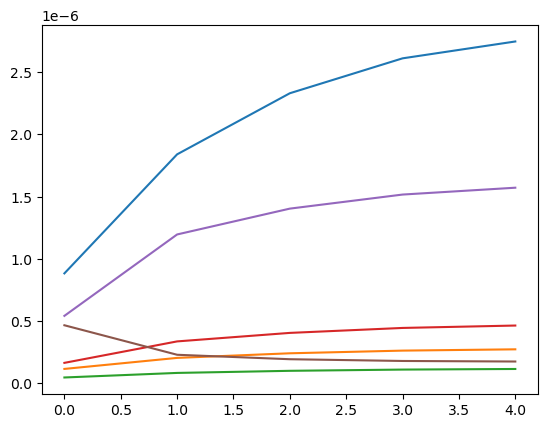

step: 0/1, D_loss: 0.12845731, G_loss_U: 3.7293549, G_loss_S: 0.11356075, E_loss_t0: 2.1168768


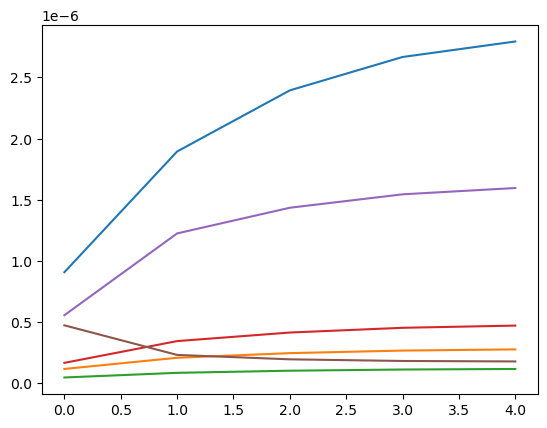

step: 0/1, D_loss: 0.12576546, G_loss_U: 3.7284696, G_loss_S: 0.112684906, E_loss_t0: 2.1110132


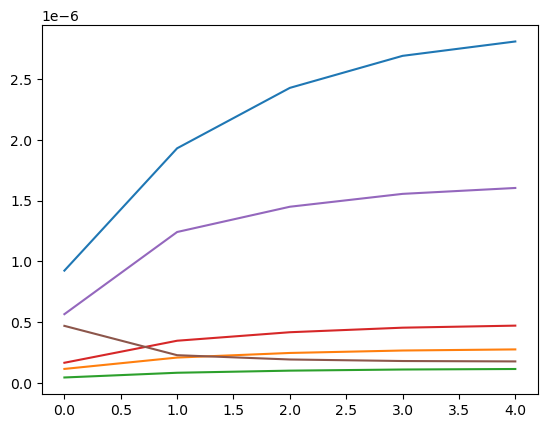

step: 0/1, D_loss: 0.12629882, G_loss_U: 3.7275023, G_loss_S: 0.11153822, E_loss_t0: 2.0415654


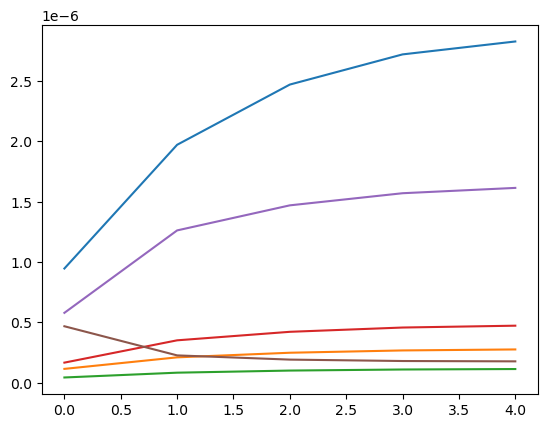

step: 0/1, D_loss: 0.12436057, G_loss_U: 3.7264614, G_loss_S: 0.11057832, E_loss_t0: 2.0542967


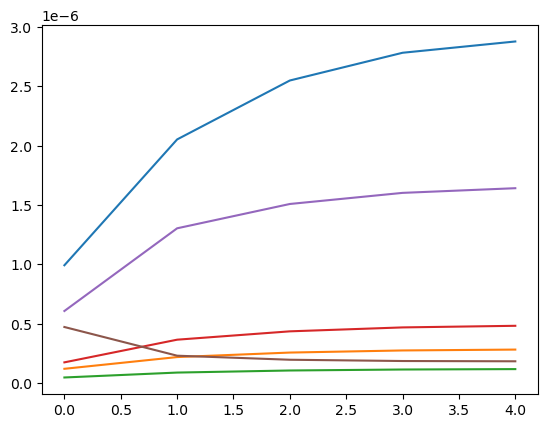

step: 0/1, D_loss: 0.1200071, G_loss_U: 3.7253637, G_loss_S: 0.10955384, E_loss_t0: 1.84941


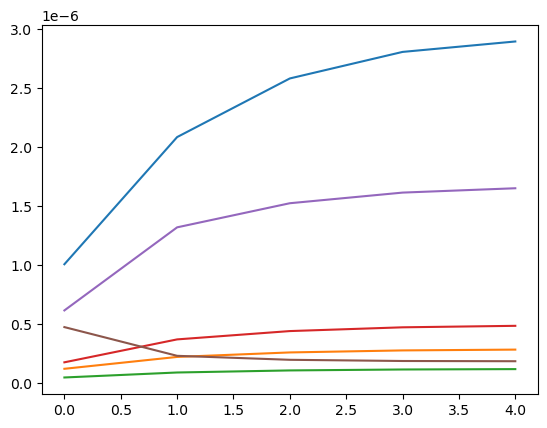

step: 0/1, D_loss: 0.11979554, G_loss_U: 3.7242298, G_loss_S: 0.108708315, E_loss_t0: 1.683529


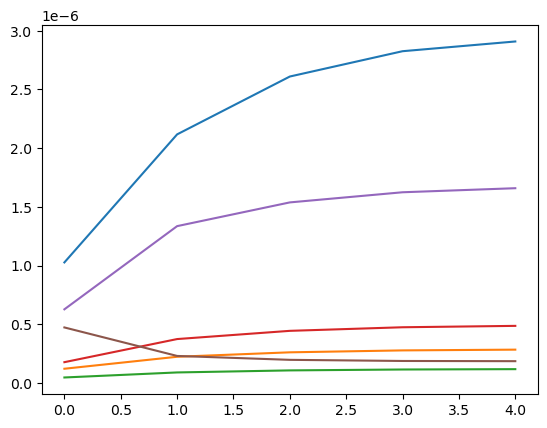

step: 0/1, D_loss: 0.12560482, G_loss_U: 3.7230802, G_loss_S: 0.10803613, E_loss_t0: 2.0021043


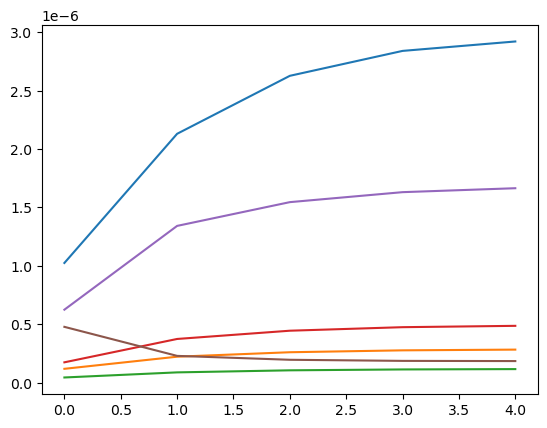

step: 0/1, D_loss: 0.122803345, G_loss_U: 3.7219303, G_loss_S: 0.1074766, E_loss_t0: 1.9390945


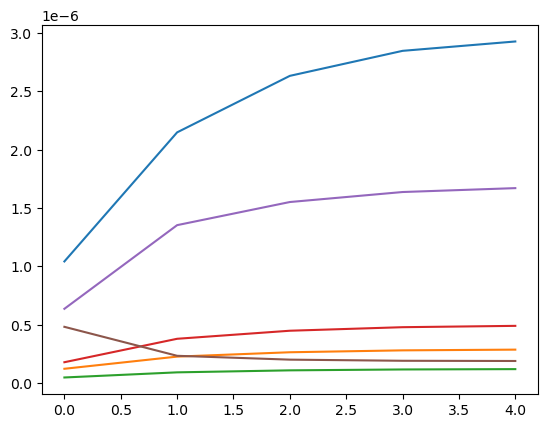

step: 0/1, D_loss: 0.12463292, G_loss_U: 3.7207923, G_loss_S: 0.10714592, E_loss_t0: 2.123203


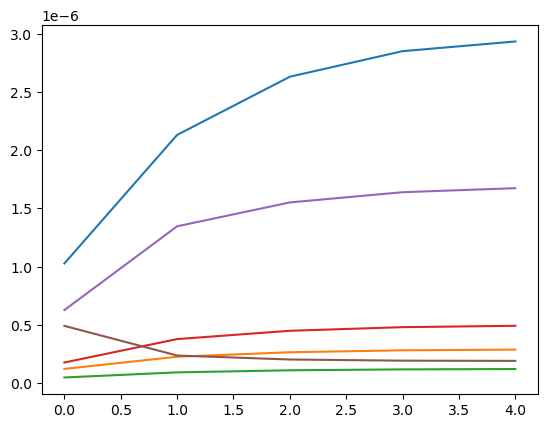

step: 0/1, D_loss: 0.12466329, G_loss_U: 3.7196734, G_loss_S: 0.1064538, E_loss_t0: 2.0191958


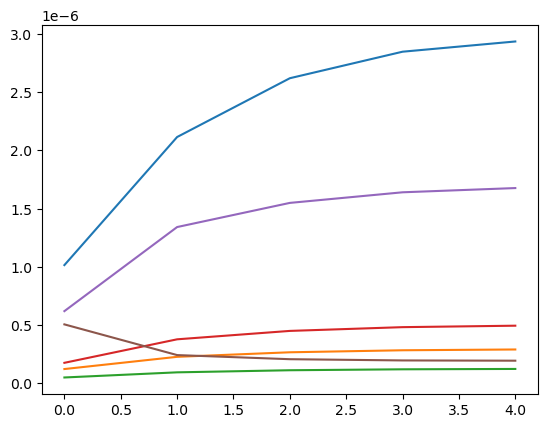

step: 0/1, D_loss: 0.118242696, G_loss_U: 3.7185812, G_loss_S: 0.105247505, E_loss_t0: 1.1047


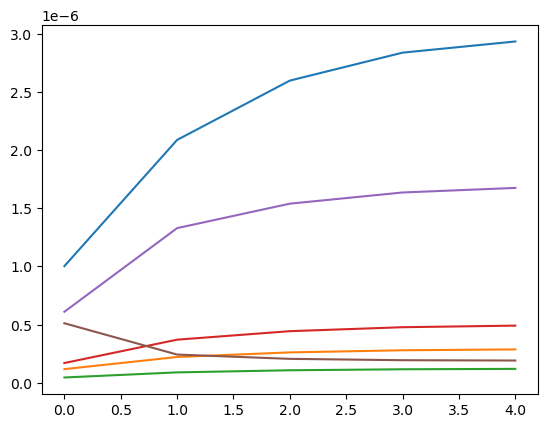

step: 0/1, D_loss: 0.12000629, G_loss_U: 3.7175229, G_loss_S: 0.10473954, E_loss_t0: 1.6713821


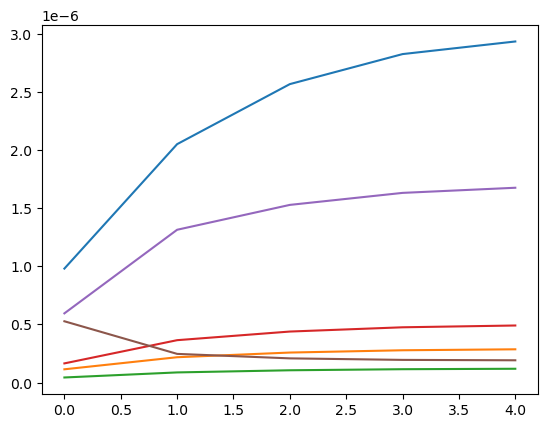

step: 0/1, D_loss: 0.12002583, G_loss_U: 3.7165058, G_loss_S: 0.10394104, E_loss_t0: 1.4517181


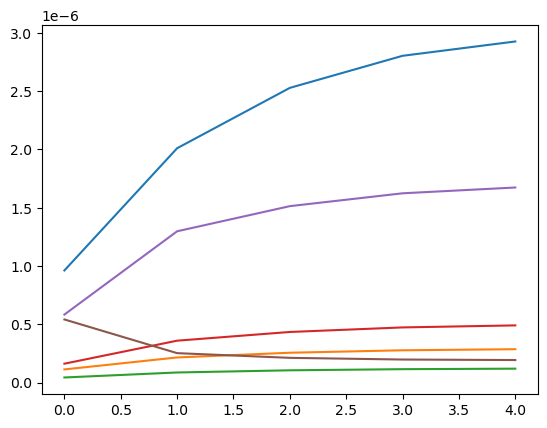

step: 0/1, D_loss: 0.12453653, G_loss_U: 3.7155333, G_loss_S: 0.10378479, E_loss_t0: 1.9305267


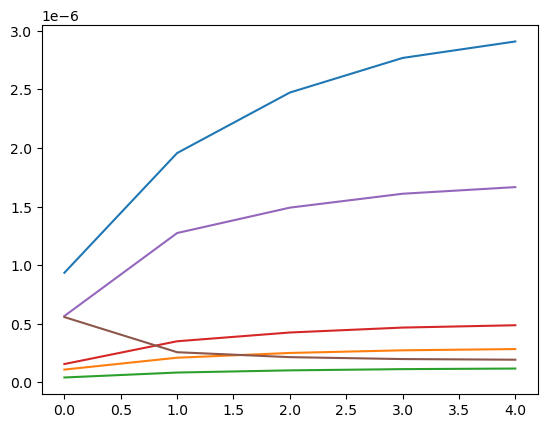

step: 0/1, D_loss: 0.12221046, G_loss_U: 3.7146037, G_loss_S: 0.10298976, E_loss_t0: 1.6749005


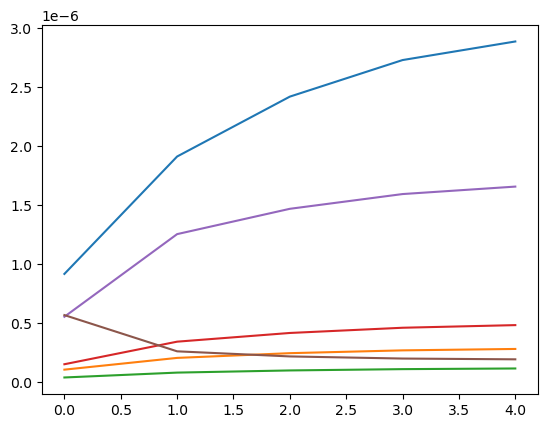

step: 0/1, D_loss: 0.12368861, G_loss_U: 3.713706, G_loss_S: 0.10249425, E_loss_t0: 1.6815935


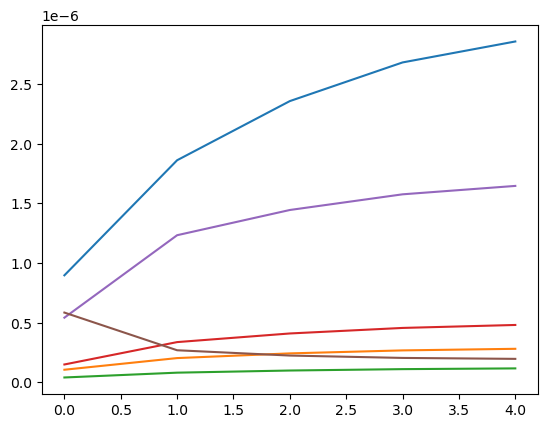

step: 0/1, D_loss: 0.13084634, G_loss_U: 3.7128284, G_loss_S: 0.10163975, E_loss_t0: 2.1190255


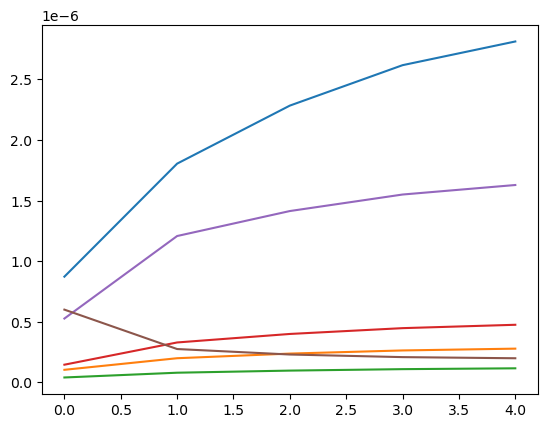

step: 0/1, D_loss: 0.12872234, G_loss_U: 3.7119575, G_loss_S: 0.1007755, E_loss_t0: 1.8732271


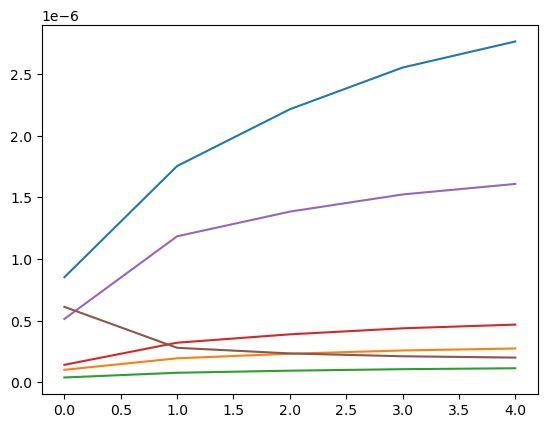

step: 0/1, D_loss: 0.13375926, G_loss_U: 3.7110882, G_loss_S: 0.09921523, E_loss_t0: 2.1298594


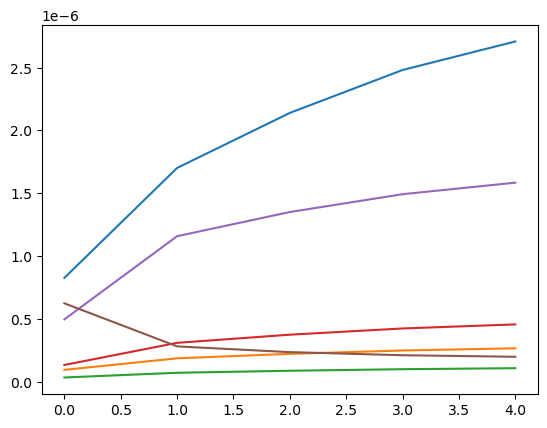

step: 0/1, D_loss: 0.13649222, G_loss_U: 3.7102292, G_loss_S: 0.09785675, E_loss_t0: 2.2634716


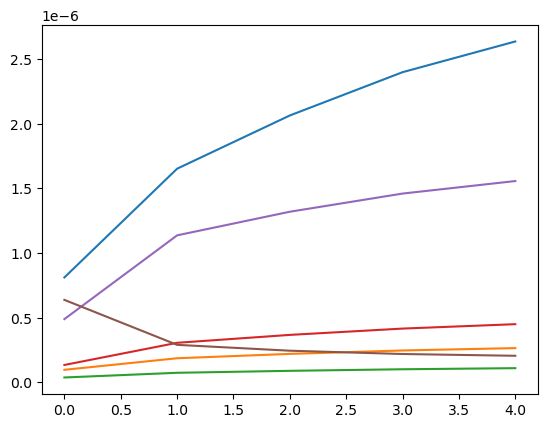

step: 0/1, D_loss: 0.12643026, G_loss_U: 3.7094026, G_loss_S: 0.09650838, E_loss_t0: 1.6882416


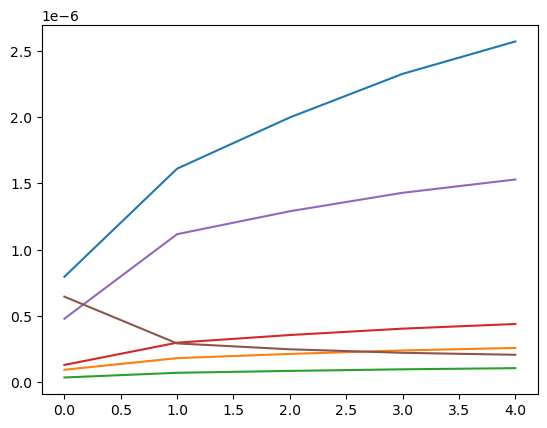

step: 0/1, D_loss: 0.12751833, G_loss_U: 3.7086358, G_loss_S: 0.09534676, E_loss_t0: 1.809765


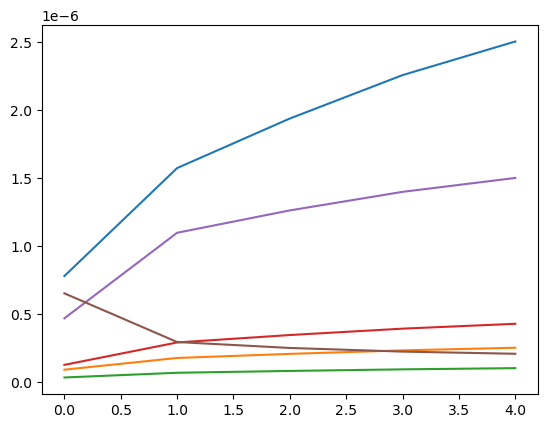

step: 0/1, D_loss: 0.1346243, G_loss_U: 3.7079542, G_loss_S: 0.09496916, E_loss_t0: 2.0565977


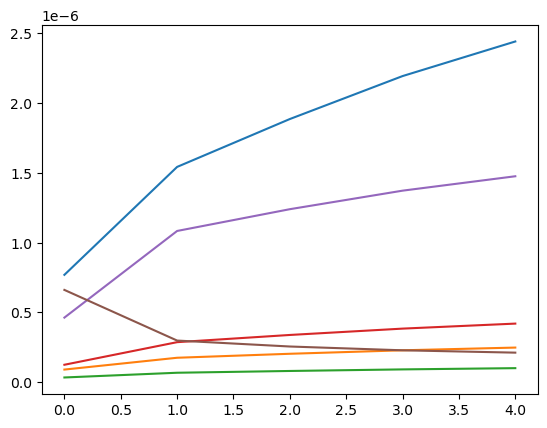

step: 0/1, D_loss: 0.13770485, G_loss_U: 3.7073715, G_loss_S: 0.094303675, E_loss_t0: 2.1517007


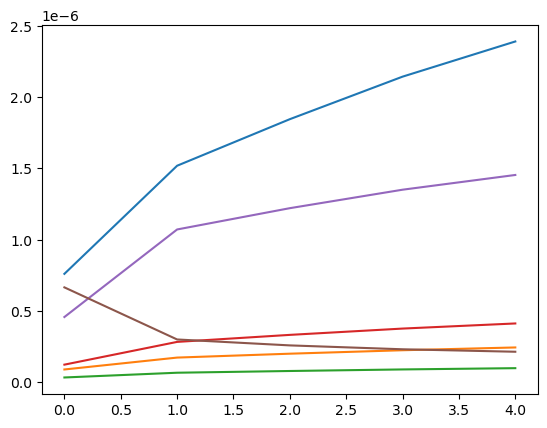

step: 0/1, D_loss: 0.13235092, G_loss_U: 3.7068853, G_loss_S: 0.09440102, E_loss_t0: 2.0378075


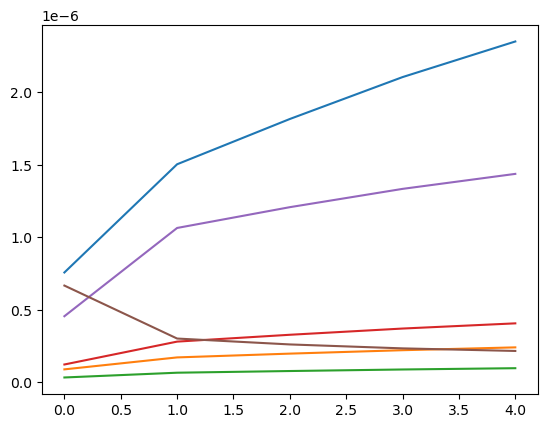

step: 0/1, D_loss: 0.13393347, G_loss_U: 3.7064843, G_loss_S: 0.09491471, E_loss_t0: 1.9967604


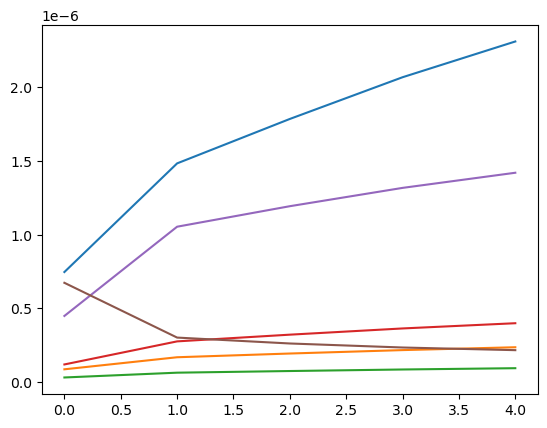

step: 0/1, D_loss: 0.15046519, G_loss_U: 3.9152493, G_loss_S: 0.0952907, E_loss_t0: 2.5198057


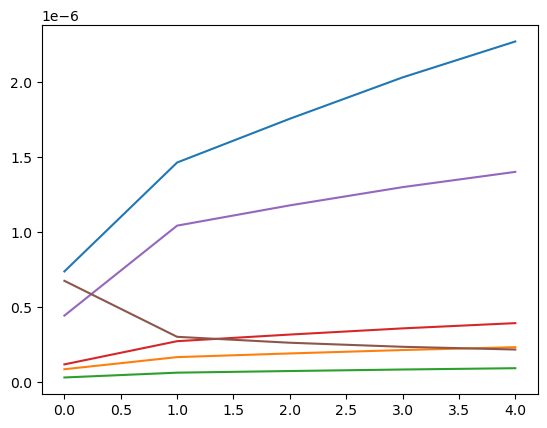

step: 0/1, D_loss: 0.11476132, G_loss_U: 3.914964, G_loss_S: 0.09575152, E_loss_t0: 2.1968217


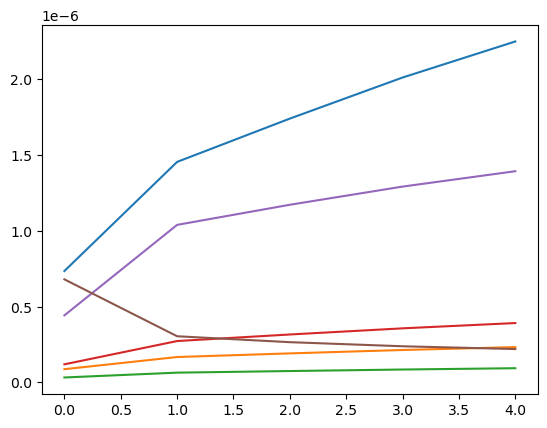

step: 0/1, D_loss: 0.11928138, G_loss_U: 3.9147124, G_loss_S: 0.096085, E_loss_t0: 2.3033898


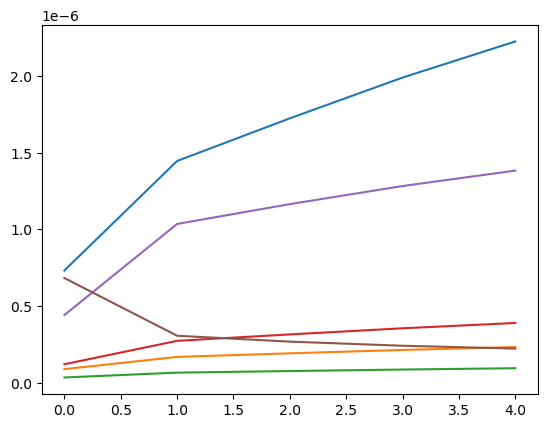

step: 0/1, D_loss: 0.10564996, G_loss_U: 3.914482, G_loss_S: 0.096197695, E_loss_t0: 1.40022


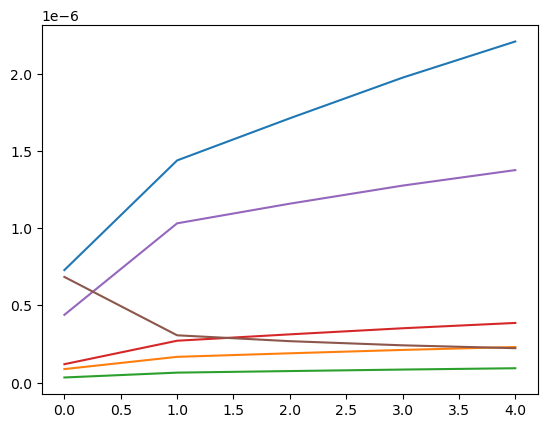

step: 0/1, D_loss: 0.108862415, G_loss_U: 3.914262, G_loss_S: 0.095790386, E_loss_t0: 1.8644775


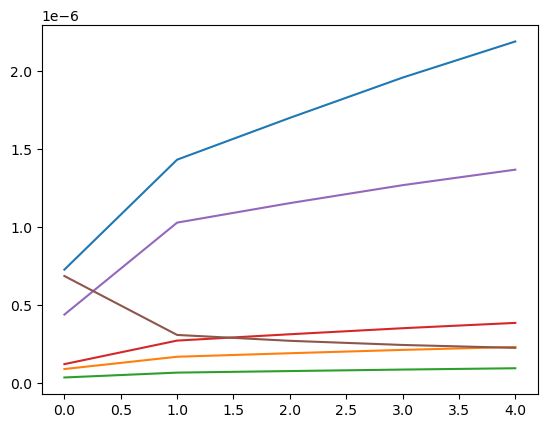

step: 0/1, D_loss: 0.10325376, G_loss_U: 3.9140425, G_loss_S: 0.09535027, E_loss_t0: 1.5512979


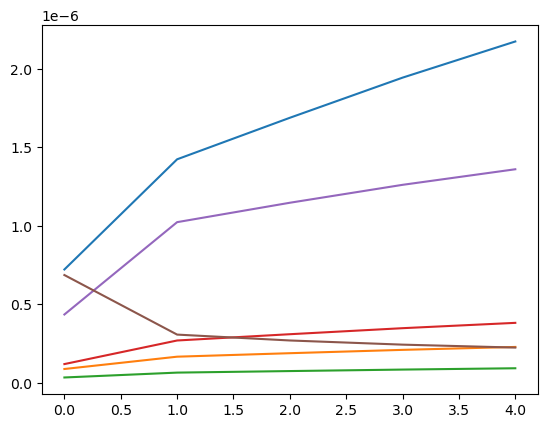

step: 0/1, D_loss: 0.11471628, G_loss_U: 3.913814, G_loss_S: 0.09511372, E_loss_t0: 2.2527065


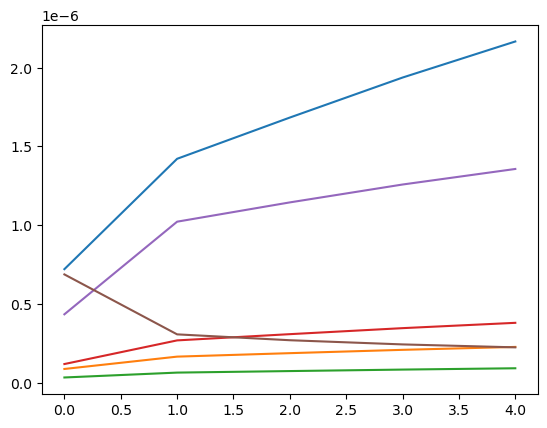

step: 0/1, D_loss: 0.11718611, G_loss_U: 3.9135664, G_loss_S: 0.09466342, E_loss_t0: 2.4238884


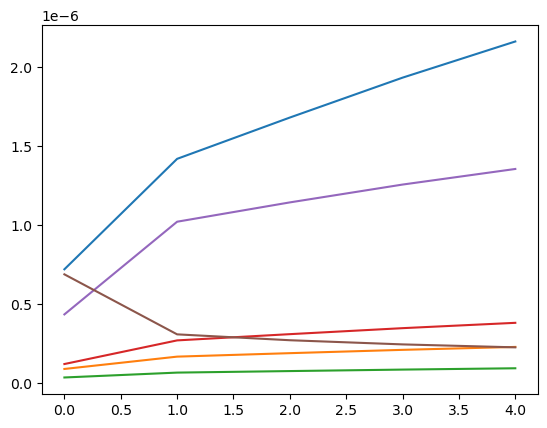

step: 0/1, D_loss: 0.115315765, G_loss_U: 3.9132874, G_loss_S: 0.09429837, E_loss_t0: 2.3476942


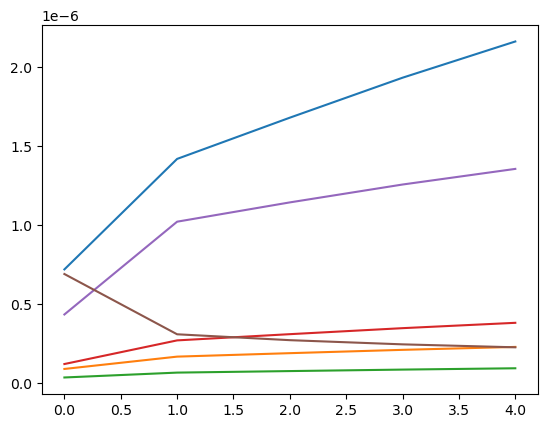

step: 0/1, D_loss: 0.10923196, G_loss_U: 3.9129603, G_loss_S: 0.09388199, E_loss_t0: 1.9814843


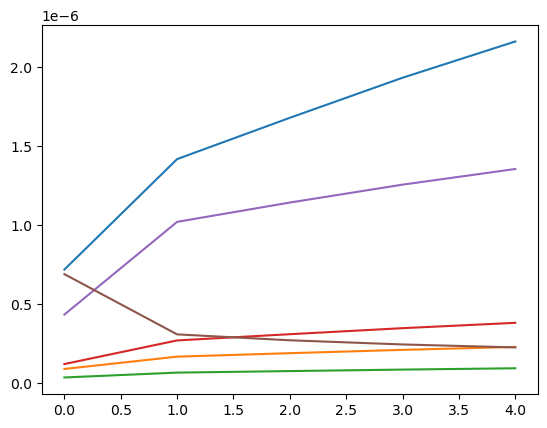

step: 0/1, D_loss: 0.105675265, G_loss_U: 3.9125648, G_loss_S: 0.093932025, E_loss_t0: 1.9443268


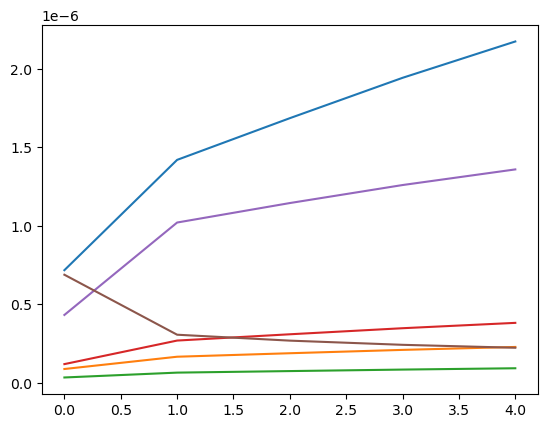

step: 0/1, D_loss: 0.112734094, G_loss_U: 3.9120724, G_loss_S: 0.09402895, E_loss_t0: 2.1007838


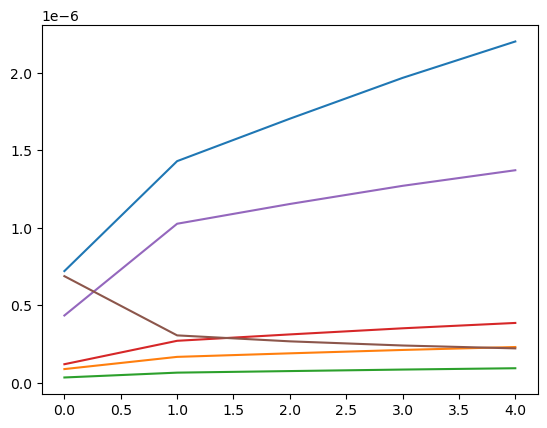

step: 0/1, D_loss: 0.10503178, G_loss_U: 3.911448, G_loss_S: 0.09386679, E_loss_t0: 1.3746939


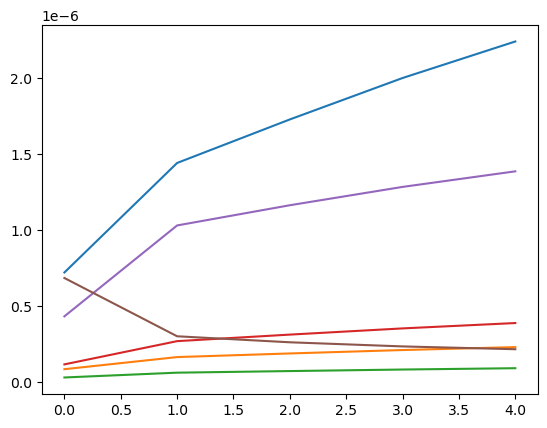

step: 0/1, D_loss: 0.1151015, G_loss_U: 3.9106543, G_loss_S: 0.09407923, E_loss_t0: 2.279416


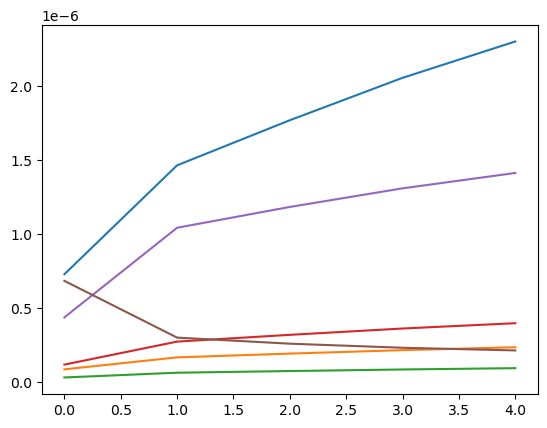

step: 0/1, D_loss: 0.11490714, G_loss_U: 3.9096644, G_loss_S: 0.094017476, E_loss_t0: 2.2148716


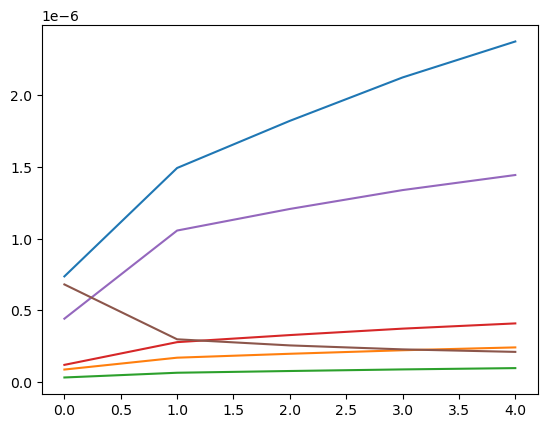

step: 0/1, D_loss: 0.11687203, G_loss_U: 3.9084888, G_loss_S: 0.09393773, E_loss_t0: 2.297147


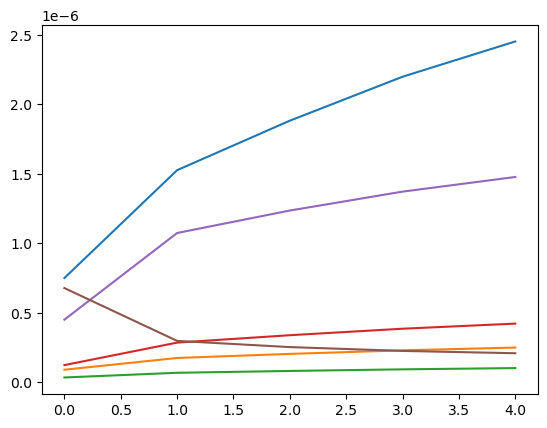

step: 0/1, D_loss: 0.10552835, G_loss_U: 3.9072034, G_loss_S: 0.093767576, E_loss_t0: 1.5208141


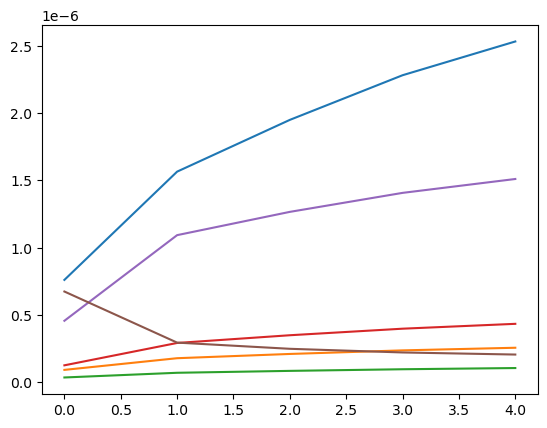

step: 0/1, D_loss: 0.1237172, G_loss_U: 3.9059408, G_loss_S: 0.09393747, E_loss_t0: 2.497494


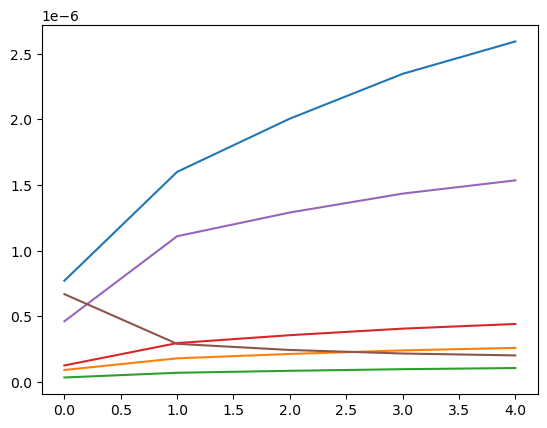

step: 0/1, D_loss: 0.11162592, G_loss_U: 3.9048288, G_loss_S: 0.09346526, E_loss_t0: 1.9478236


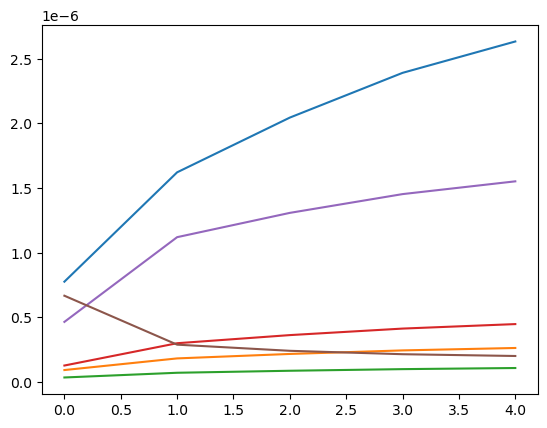

step: 0/1, D_loss: 0.10664876, G_loss_U: 3.9039273, G_loss_S: 0.09350328, E_loss_t0: 1.5138478


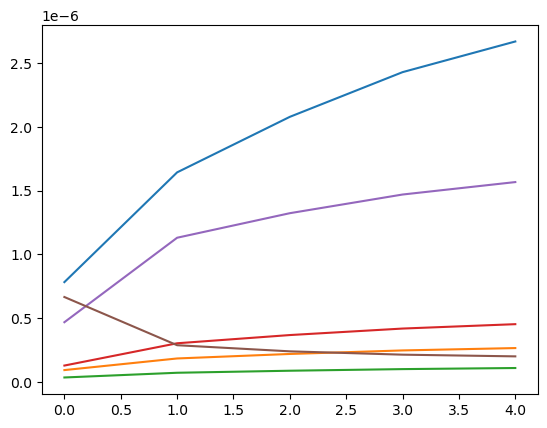

step: 0/1, D_loss: 0.10747787, G_loss_U: 3.9032214, G_loss_S: 0.09345502, E_loss_t0: 1.5439047


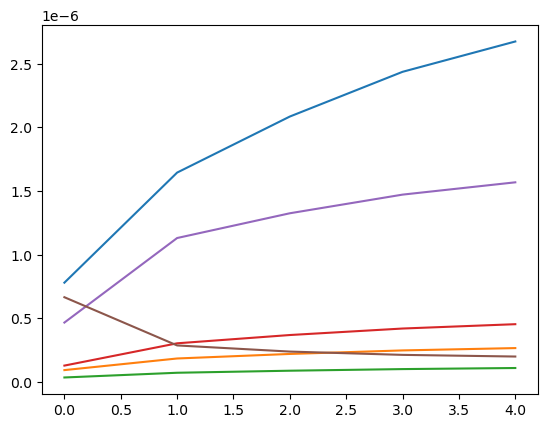

step: 0/1, D_loss: 0.10766864, G_loss_U: 3.9026594, G_loss_S: 0.09328949, E_loss_t0: 1.6970772


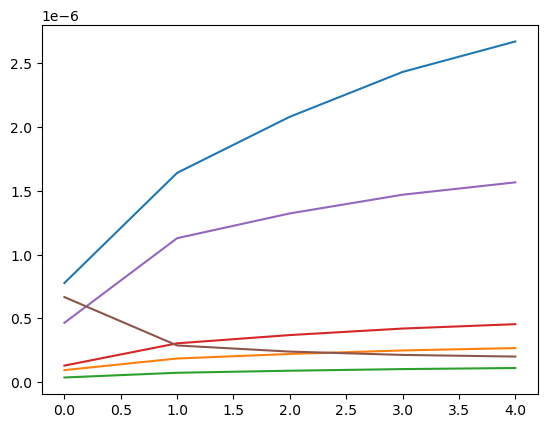

step: 0/1, D_loss: 0.10802552, G_loss_U: 3.9021878, G_loss_S: 0.09319861, E_loss_t0: 1.7638184


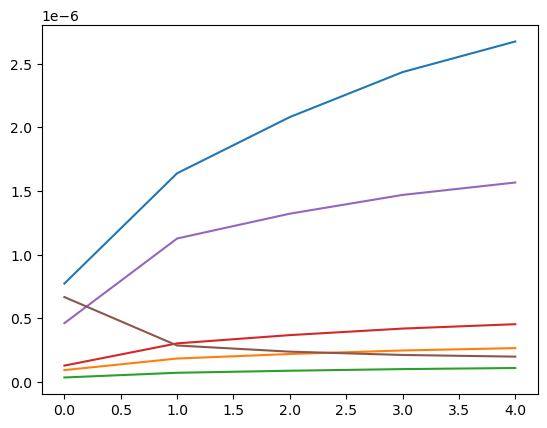

step: 0/1, D_loss: 0.112723306, G_loss_U: 3.9017663, G_loss_S: 0.09302104, E_loss_t0: 2.0611296


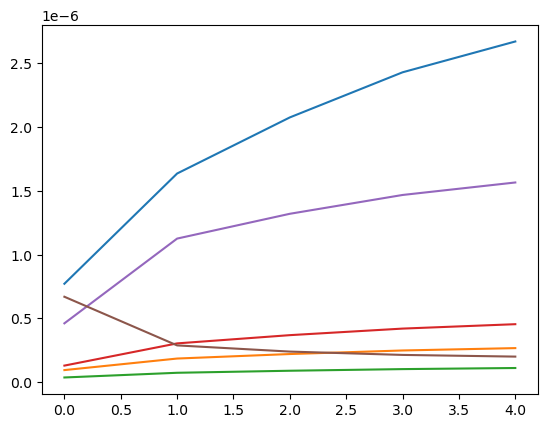

step: 0/1, D_loss: 0.10725985, G_loss_U: 3.9013638, G_loss_S: 0.09288394, E_loss_t0: 1.7030257


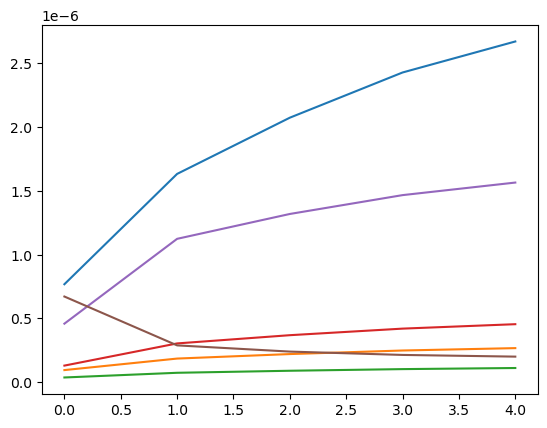

step: 0/1, D_loss: 0.110585965, G_loss_U: 3.9009552, G_loss_S: 0.09275369, E_loss_t0: 1.8443365


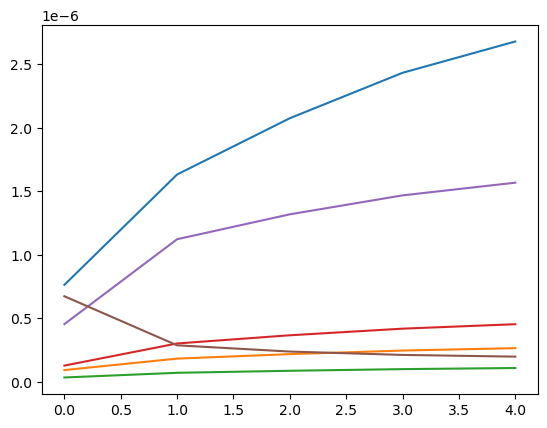

step: 0/1, D_loss: 0.11528255, G_loss_U: 3.9005156, G_loss_S: 0.09271367, E_loss_t0: 2.0122807


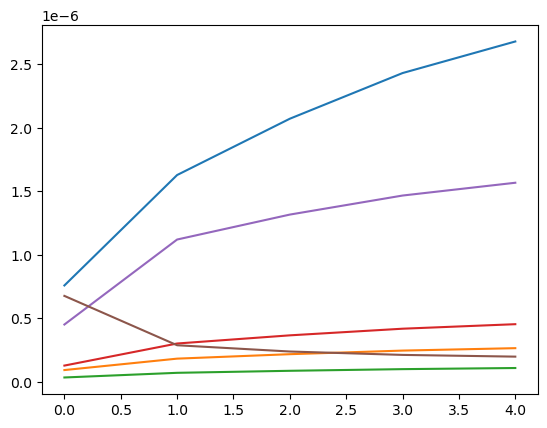

step: 0/1, D_loss: 0.12048927, G_loss_U: 3.9000115, G_loss_S: 0.09261309, E_loss_t0: 2.316304


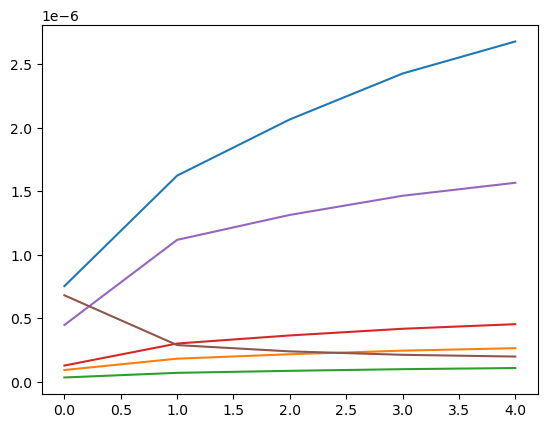

step: 0/1, D_loss: 0.11708763, G_loss_U: 3.8994007, G_loss_S: 0.092425644, E_loss_t0: 2.0333538


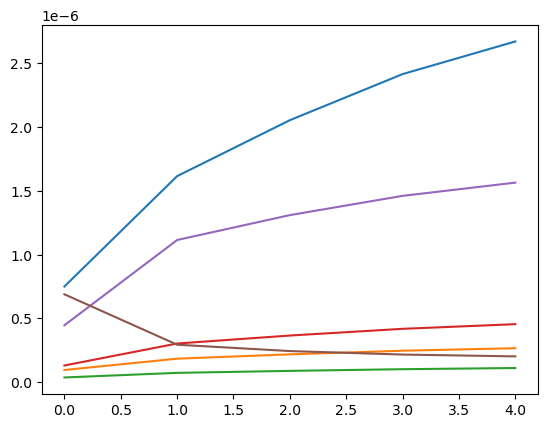

step: 0/1, D_loss: 0.10841015, G_loss_U: 3.8986237, G_loss_S: 0.092201225, E_loss_t0: 1.5430322


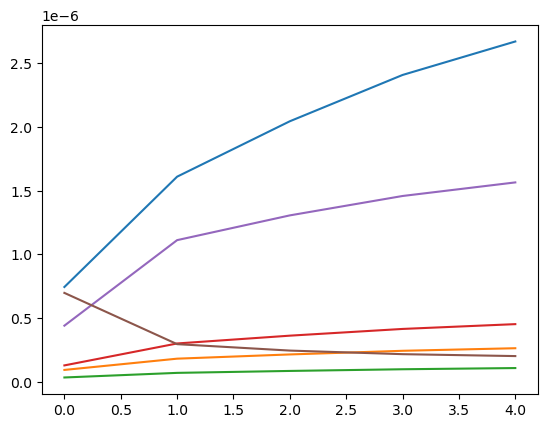

step: 0/1, D_loss: 0.11404379, G_loss_U: 3.8976142, G_loss_S: 0.092061445, E_loss_t0: 2.0778518


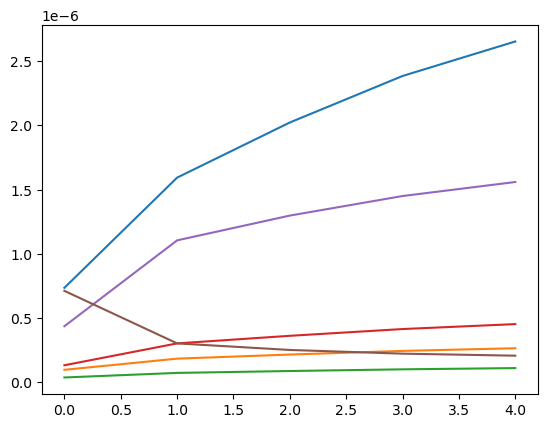

step: 0/1, D_loss: 0.11029048, G_loss_U: 3.8963327, G_loss_S: 0.09181608, E_loss_t0: 1.6582084


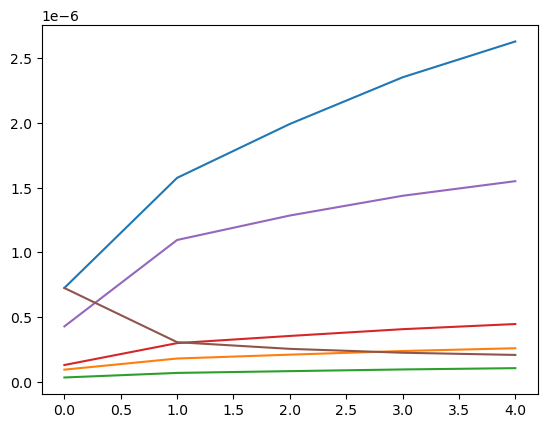

step: 0/1, D_loss: 0.1176933, G_loss_U: 3.8948312, G_loss_S: 0.09150756, E_loss_t0: 2.1355245


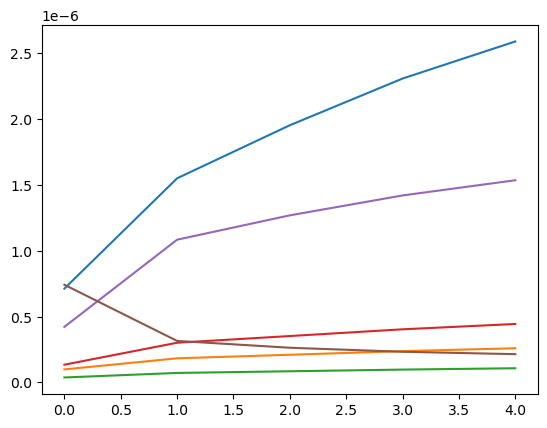

step: 0/1, D_loss: 0.11077701, G_loss_U: 3.8932886, G_loss_S: 0.090926975, E_loss_t0: 1.1968488


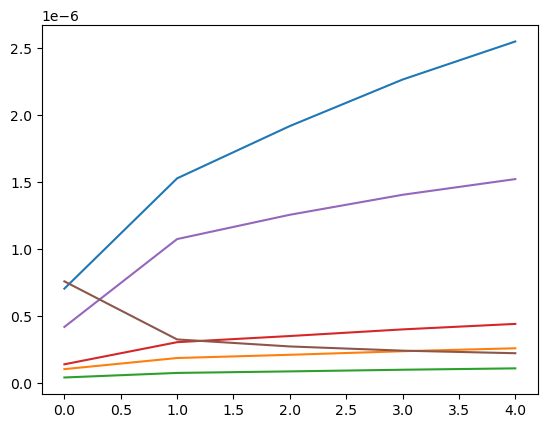

step: 0/1, D_loss: 0.11553901, G_loss_U: 3.8919284, G_loss_S: 0.09055073, E_loss_t0: 1.8838079


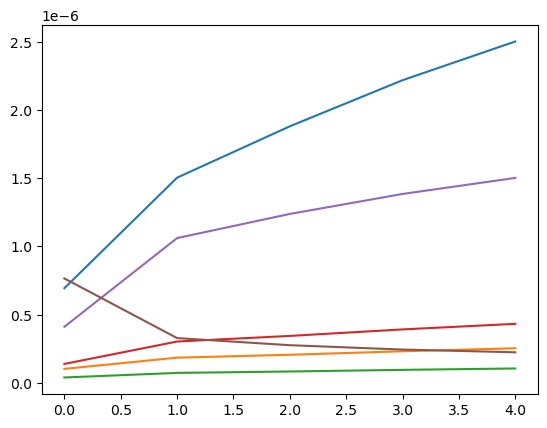

step: 0/1, D_loss: 0.11263761, G_loss_U: 3.8908734, G_loss_S: 0.09004454, E_loss_t0: 1.4572452


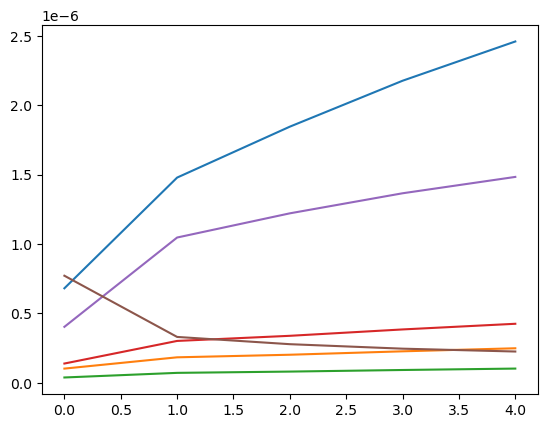

step: 0/1, D_loss: 0.11431743, G_loss_U: 3.8900988, G_loss_S: 0.08981137, E_loss_t0: 1.6796913


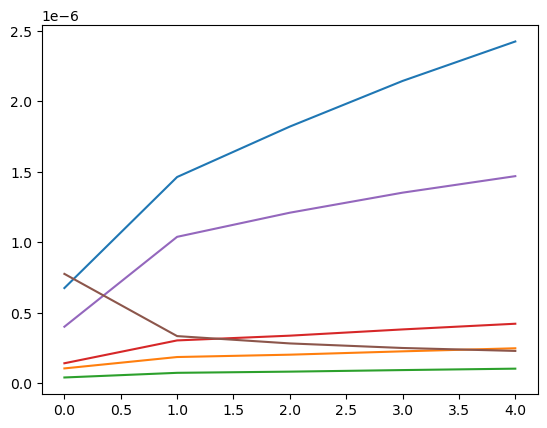

step: 0/1, D_loss: 0.12232566, G_loss_U: 3.8895175, G_loss_S: 0.08941381, E_loss_t0: 2.1830192


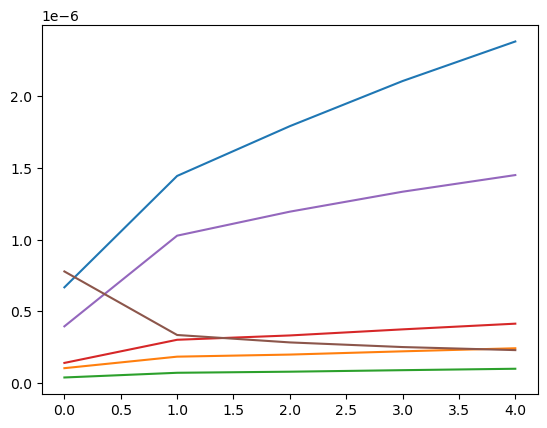

step: 0/1, D_loss: 0.11294905, G_loss_U: 3.8890505, G_loss_S: 0.0885692, E_loss_t0: 1.3014833


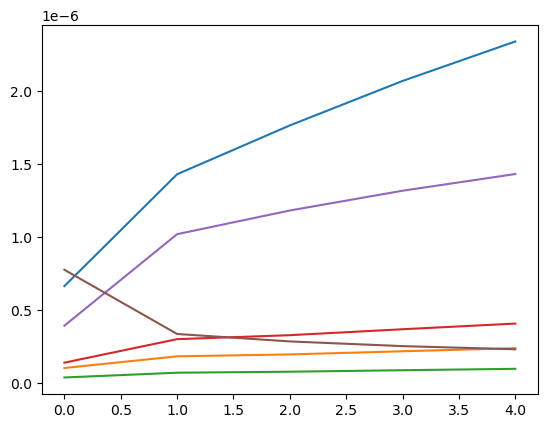

step: 0/1, D_loss: 0.119841695, G_loss_U: 3.888653, G_loss_S: 0.08842605, E_loss_t0: 1.9902924


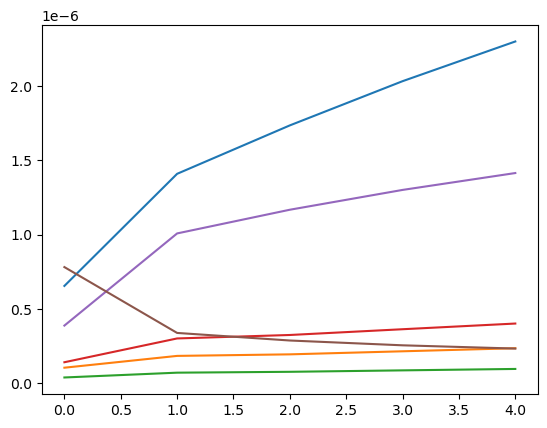

step: 0/1, D_loss: 0.11475907, G_loss_U: 3.888302, G_loss_S: 0.0884959, E_loss_t0: 1.9004058


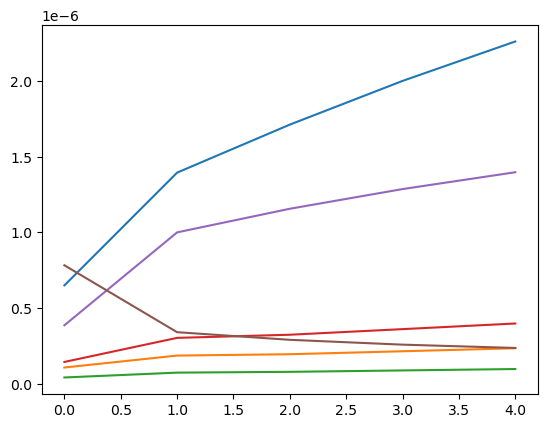

step: 0/1, D_loss: 0.11496155, G_loss_U: 3.8879936, G_loss_S: 0.088181876, E_loss_t0: 1.5960706


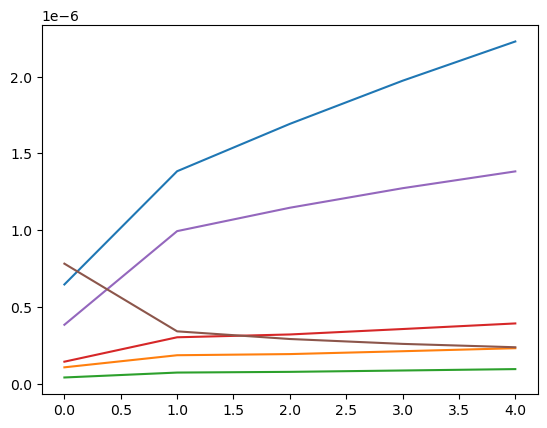

step: 0/1, D_loss: 0.118185714, G_loss_U: 3.8877258, G_loss_S: 0.08805121, E_loss_t0: 1.7807018


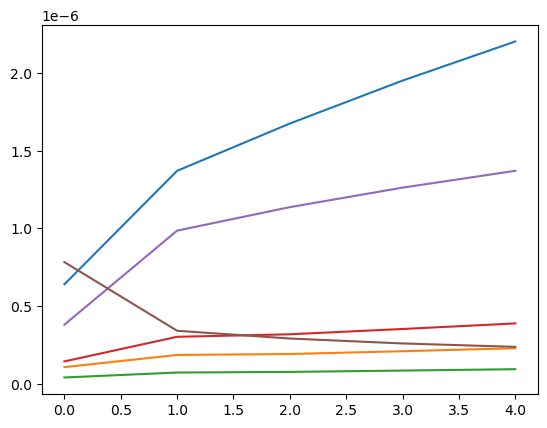

step: 0/1, D_loss: 0.11855576, G_loss_U: 3.887499, G_loss_S: 0.08811715, E_loss_t0: 2.0386665


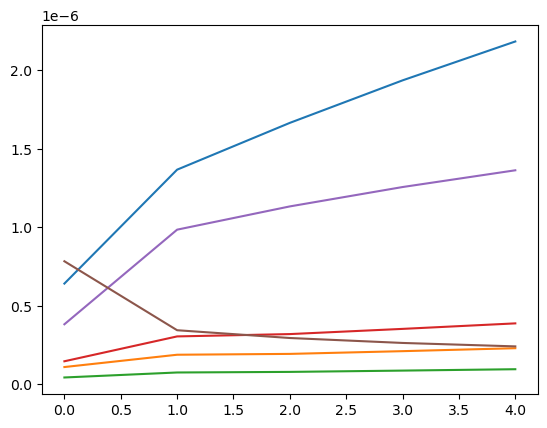

step: 0/1, D_loss: 0.11557489, G_loss_U: 3.8873103, G_loss_S: 0.08738212, E_loss_t0: 1.4580647


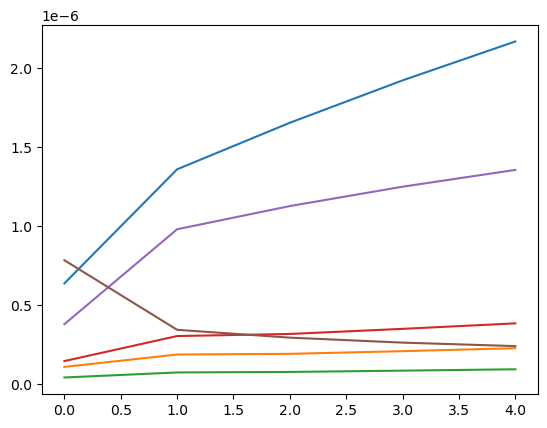

step: 0/1, D_loss: 0.1179789, G_loss_U: 3.8871565, G_loss_S: 0.08700363, E_loss_t0: 1.5320319


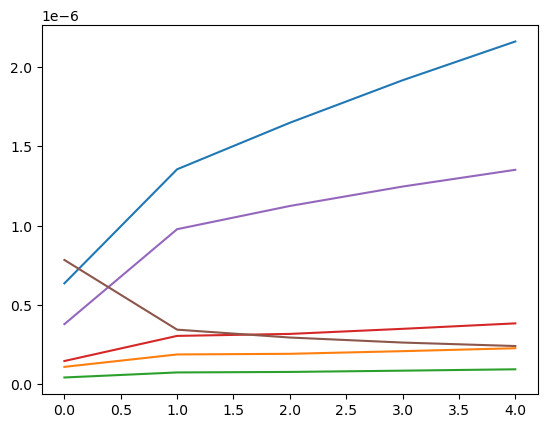

step: 0/1, D_loss: 0.120116085, G_loss_U: 3.8870316, G_loss_S: 0.086737834, E_loss_t0: 2.0268376


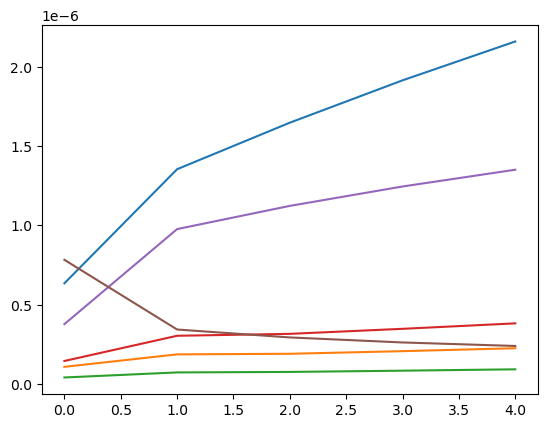

step: 0/1, D_loss: 0.116370246, G_loss_U: 3.8869312, G_loss_S: 0.085616045, E_loss_t0: 1.5817708


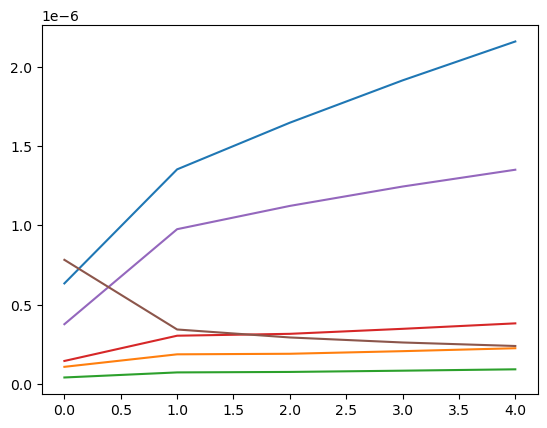

step: 0/1, D_loss: 0.14023468, G_loss_U: 3.8868494, G_loss_S: 0.085948035, E_loss_t0: 2.577761


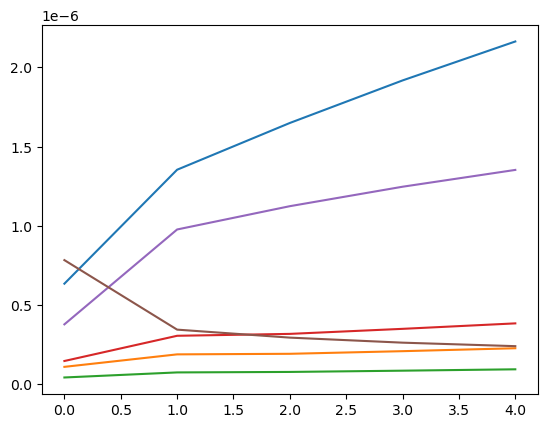

step: 0/1, D_loss: 0.12634768, G_loss_U: 3.886783, G_loss_S: 0.084470205, E_loss_t0: 2.1343884


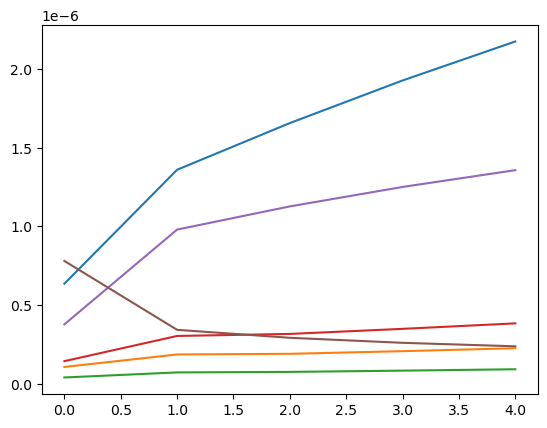

step: 0/1, D_loss: 0.117332295, G_loss_U: 3.886727, G_loss_S: 0.08367563, E_loss_t0: 1.6502181


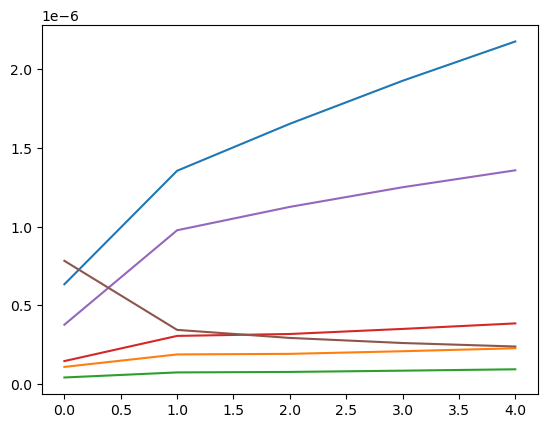

step: 0/1, D_loss: 0.118578345, G_loss_U: 3.8866806, G_loss_S: 0.08384643, E_loss_t0: 1.7025695


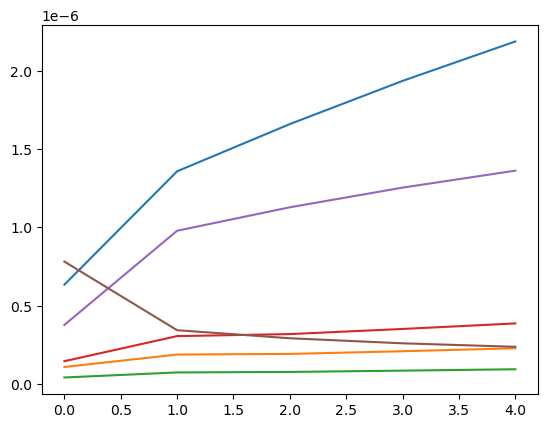

step: 0/1, D_loss: 0.1173943, G_loss_U: 3.8866403, G_loss_S: 0.0842184, E_loss_t0: 1.3328966


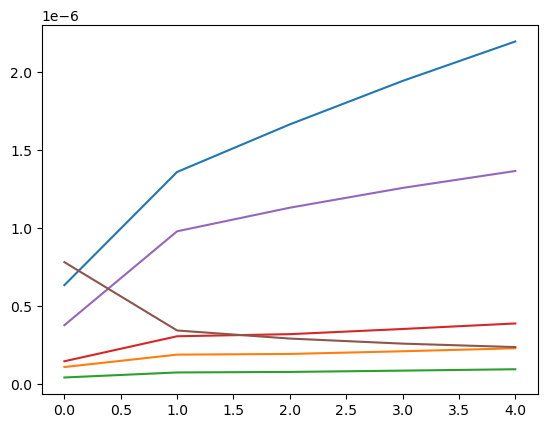

step: 0/1, D_loss: 0.1189417, G_loss_U: 3.8866045, G_loss_S: 0.08454936, E_loss_t0: 1.6209733


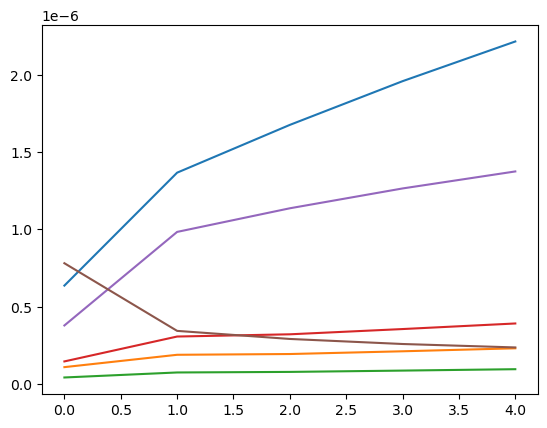

step: 0/1, D_loss: 0.119327076, G_loss_U: 3.886573, G_loss_S: 0.08401016, E_loss_t0: 1.8783791


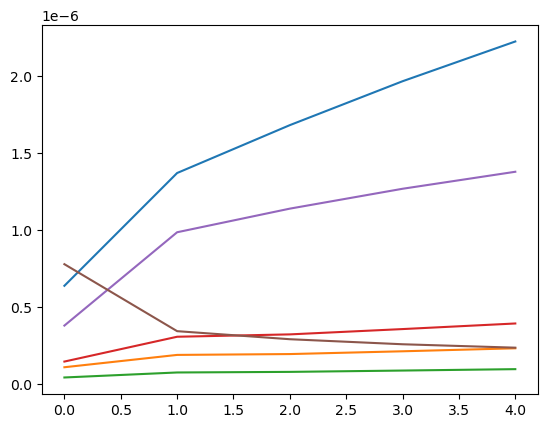

step: 0/1, D_loss: 0.12355618, G_loss_U: 3.8865435, G_loss_S: 0.08581713, E_loss_t0: 1.3918637


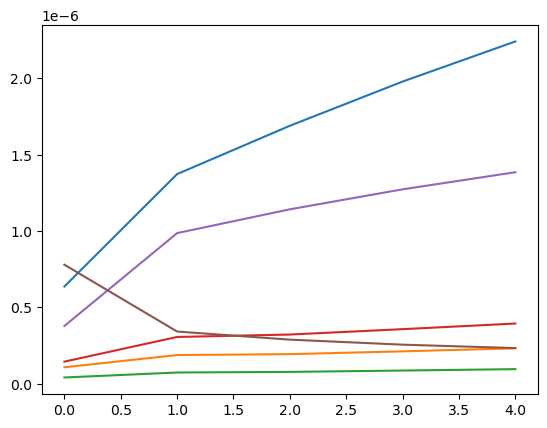

step: 0/1, D_loss: 0.12598228, G_loss_U: 3.8865168, G_loss_S: 0.083600424, E_loss_t0: 1.981267


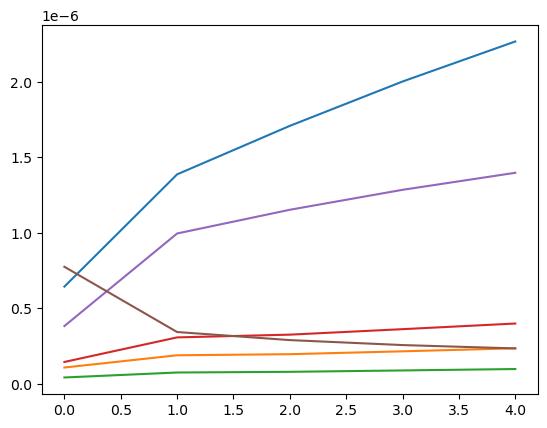

step: 0/1, D_loss: 0.1171254, G_loss_U: 3.8864906, G_loss_S: 0.08279589, E_loss_t0: 1.4046412


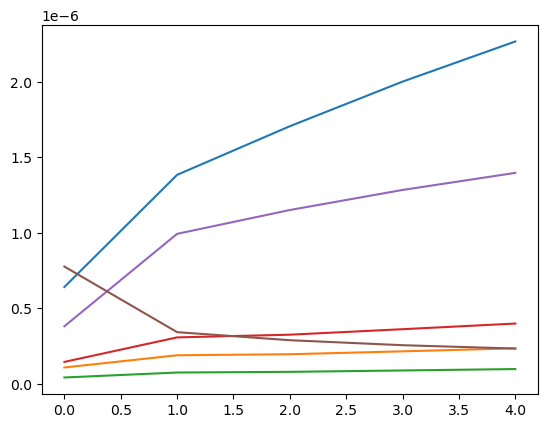

step: 0/1, D_loss: 0.12170587, G_loss_U: 3.8864648, G_loss_S: 0.081999294, E_loss_t0: 1.9436595


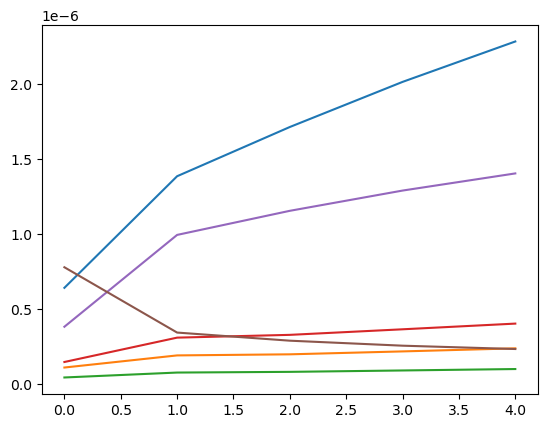

step: 0/1, D_loss: 0.13130188, G_loss_U: 3.8864398, G_loss_S: 0.08148673, E_loss_t0: 2.1056182


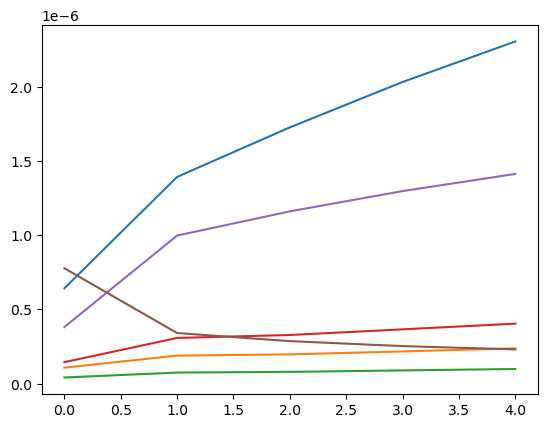

step: 0/1, D_loss: 0.14340416, G_loss_U: 3.8864143, G_loss_S: 0.08090354, E_loss_t0: 2.4918191


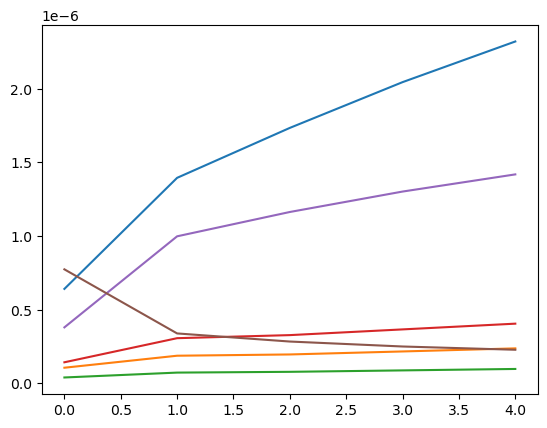

step: 0/1, D_loss: 0.12002477, G_loss_U: 3.8863883, G_loss_S: 0.080099694, E_loss_t0: 1.9223683


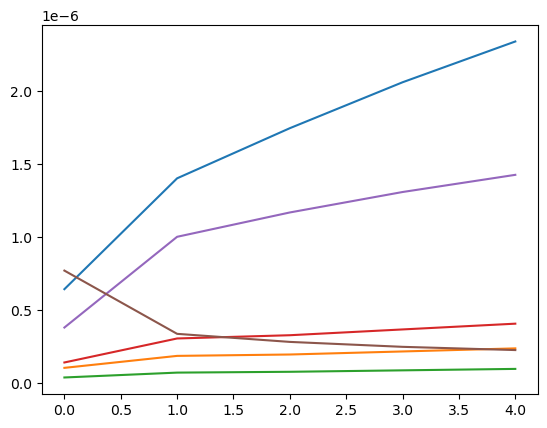

step: 0/1, D_loss: 0.11769729, G_loss_U: 3.8863604, G_loss_S: 0.07965079, E_loss_t0: 1.7264777


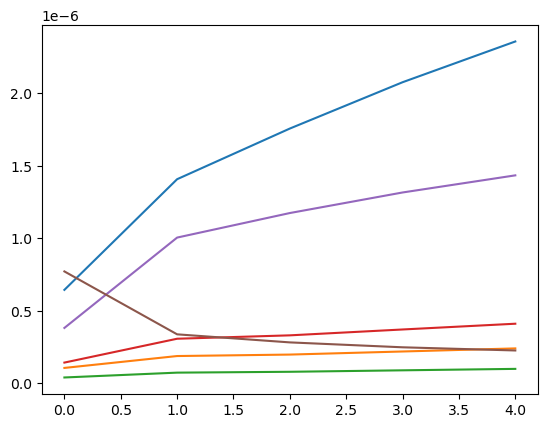

step: 0/1, D_loss: 0.123829335, G_loss_U: 3.8863318, G_loss_S: 0.079828575, E_loss_t0: 2.0650334


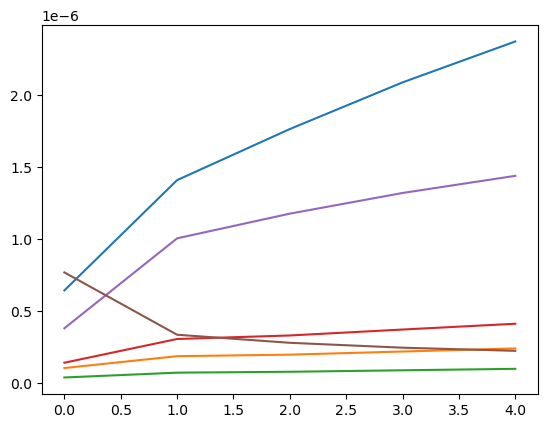

step: 0/1, D_loss: 0.12507309, G_loss_U: 3.8863013, G_loss_S: 0.07990524, E_loss_t0: 2.0641172


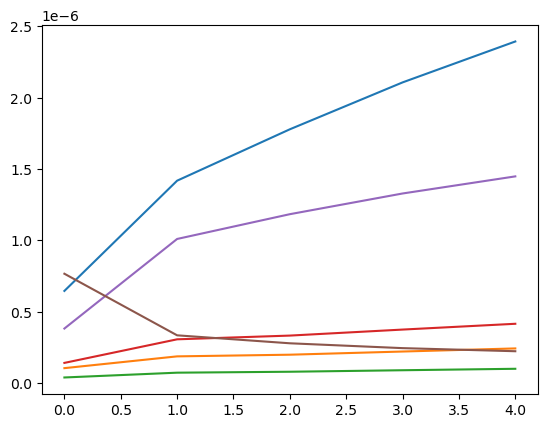

step: 0/1, D_loss: 0.12059124, G_loss_U: 3.8862689, G_loss_S: 0.079929024, E_loss_t0: 1.6347383


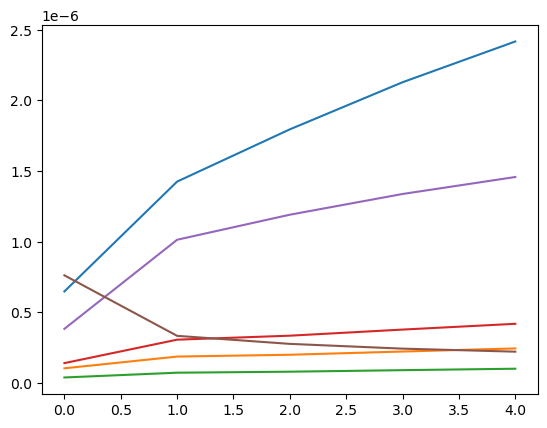

step: 0/1, D_loss: 0.12234895, G_loss_U: 3.8862324, G_loss_S: 0.08018342, E_loss_t0: 1.6929678


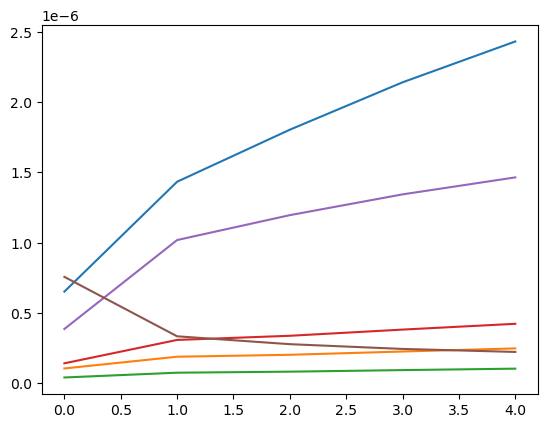

step: 0/1, D_loss: 0.12130455, G_loss_U: 3.8861926, G_loss_S: 0.080267556, E_loss_t0: 1.8123037


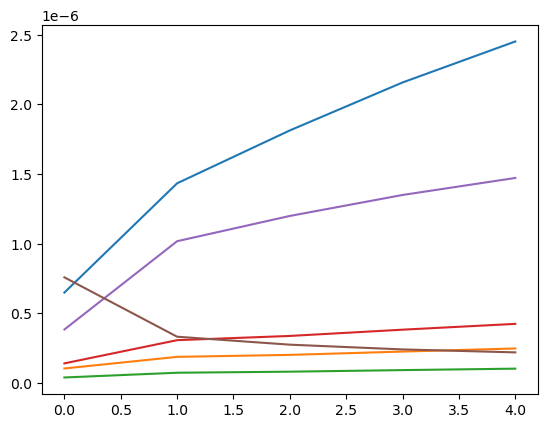

step: 0/1, D_loss: 0.11992927, G_loss_U: 3.8861494, G_loss_S: 0.08026288, E_loss_t0: 1.6407913


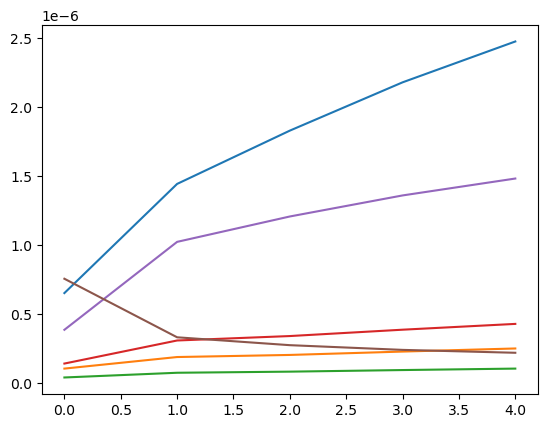

step: 0/1, D_loss: 0.12950796, G_loss_U: 3.8861008, G_loss_S: 0.08020312, E_loss_t0: 2.0578353


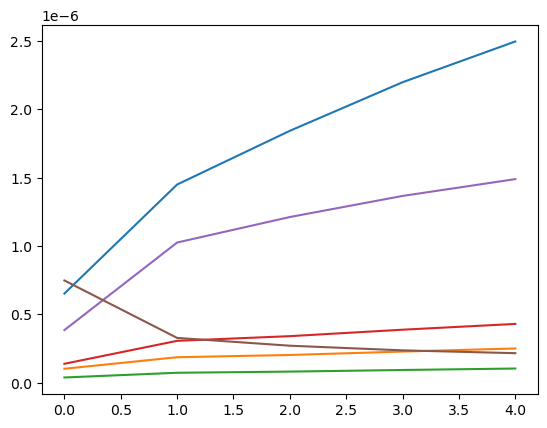

step: 0/1, D_loss: 0.121302955, G_loss_U: 3.886046, G_loss_S: 0.07993618, E_loss_t0: 1.8105836


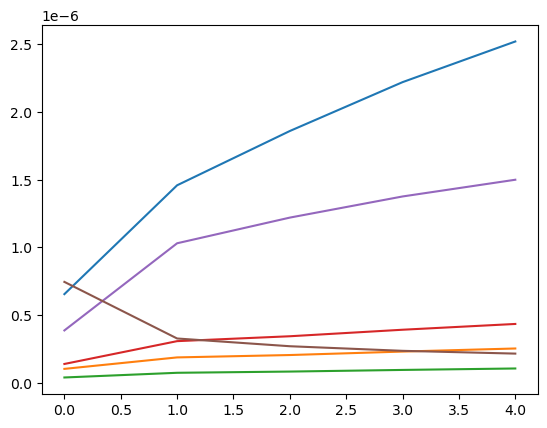

step: 0/1, D_loss: 0.12605299, G_loss_U: 3.8859844, G_loss_S: 0.07988253, E_loss_t0: 1.8519628


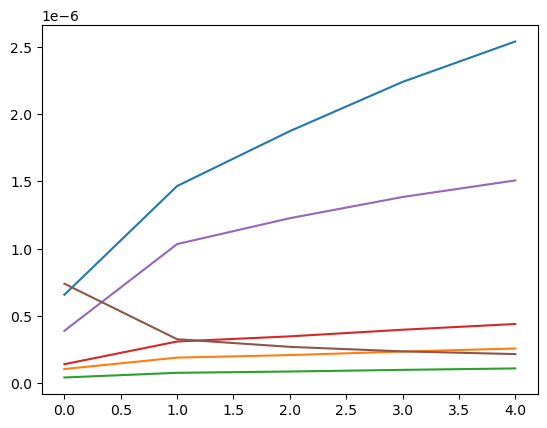

step: 0/1, D_loss: 0.12624483, G_loss_U: 3.8859158, G_loss_S: 0.08072649, E_loss_t0: 1.5545352


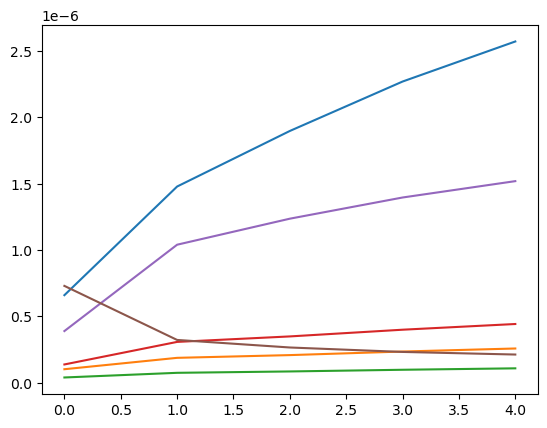

step: 0/1, D_loss: 0.12862092, G_loss_U: 3.8858392, G_loss_S: 0.07941988, E_loss_t0: 2.0206385


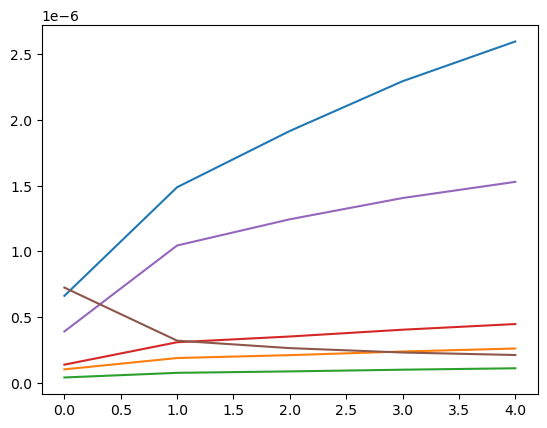

step: 0/1, D_loss: 0.11999674, G_loss_U: 3.8857539, G_loss_S: 0.07909602, E_loss_t0: 1.7384291


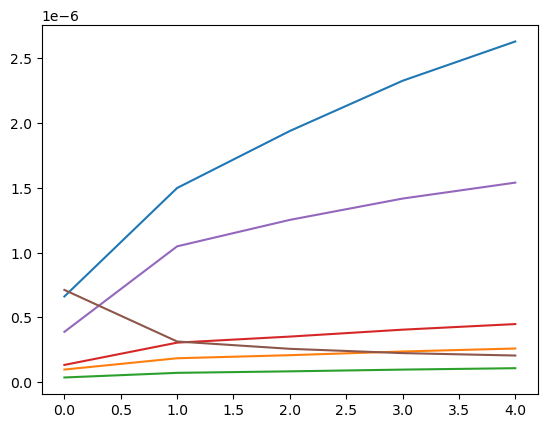

step: 0/1, D_loss: 0.14482862, G_loss_U: 3.8856592, G_loss_S: 0.07907448, E_loss_t0: 2.4776108


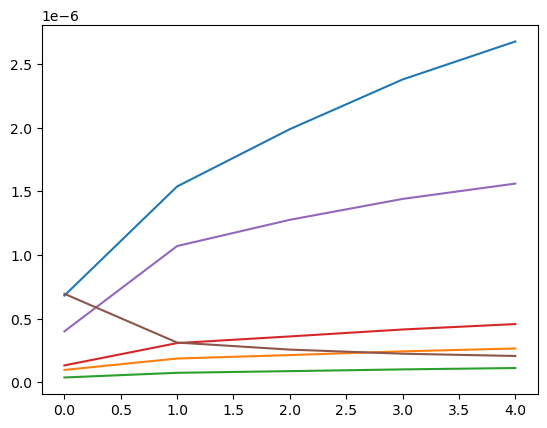

step: 0/1, D_loss: 0.12666945, G_loss_U: 3.8855577, G_loss_S: 0.078914344, E_loss_t0: 2.0530496


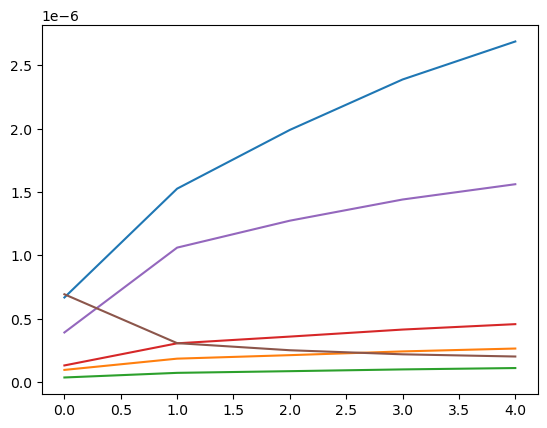

step: 0/1, D_loss: 0.12799804, G_loss_U: 3.88545, G_loss_S: 0.078829244, E_loss_t0: 2.1088486


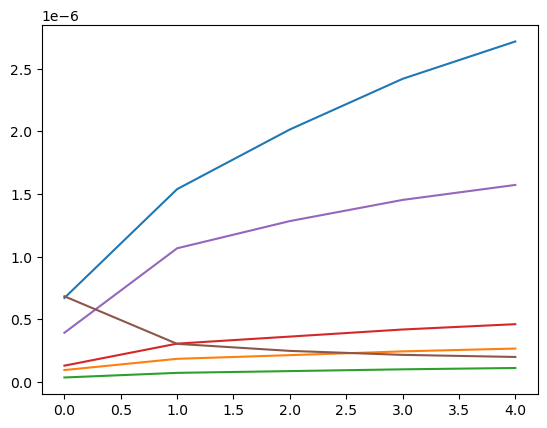

step: 0/1, D_loss: 0.12236793, G_loss_U: 3.885338, G_loss_S: 0.078908294, E_loss_t0: 1.8613691


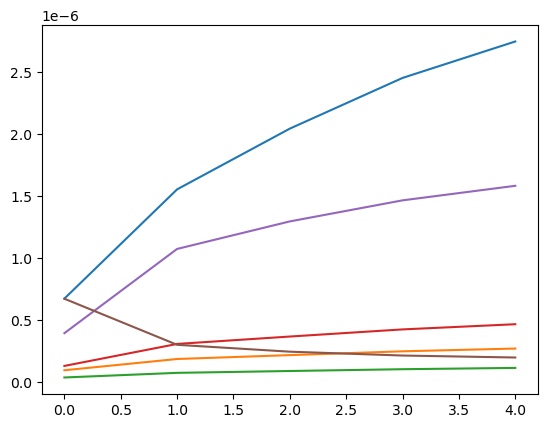

step: 0/1, D_loss: 0.12658459, G_loss_U: 3.8852253, G_loss_S: 0.078639925, E_loss_t0: 2.0630853


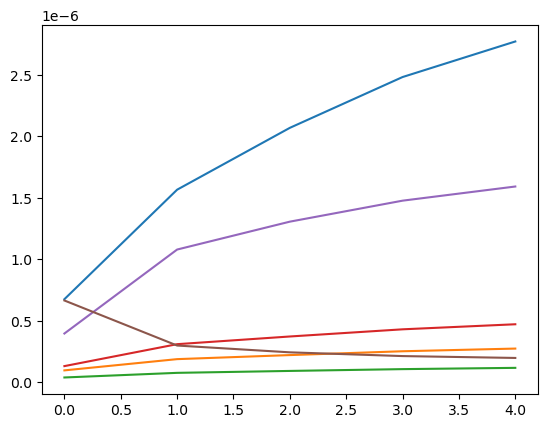

step: 0/1, D_loss: 0.11951778, G_loss_U: 3.8851147, G_loss_S: 0.07837308, E_loss_t0: 1.6473064


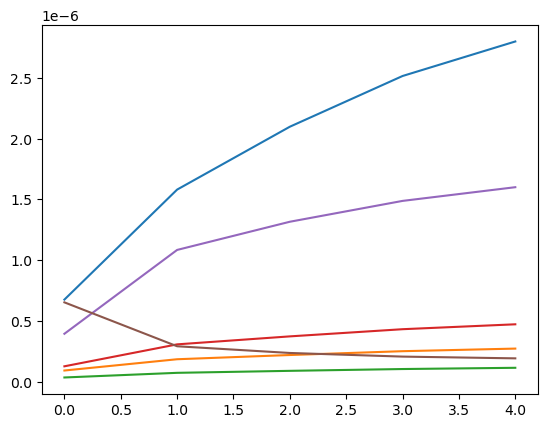

step: 0/1, D_loss: 0.12108468, G_loss_U: 3.8850095, G_loss_S: 0.07821656, E_loss_t0: 1.6455811


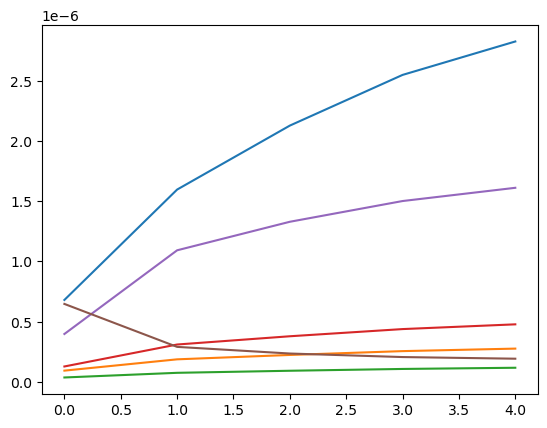

step: 0/1, D_loss: 0.1484991, G_loss_U: 3.8849094, G_loss_S: 0.07787066, E_loss_t0: 2.5310097


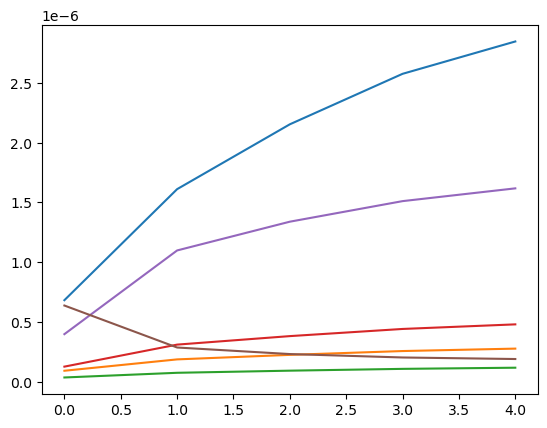

step: 0/1, D_loss: 0.13775173, G_loss_U: 3.8848176, G_loss_S: 0.07717668, E_loss_t0: 2.2531776


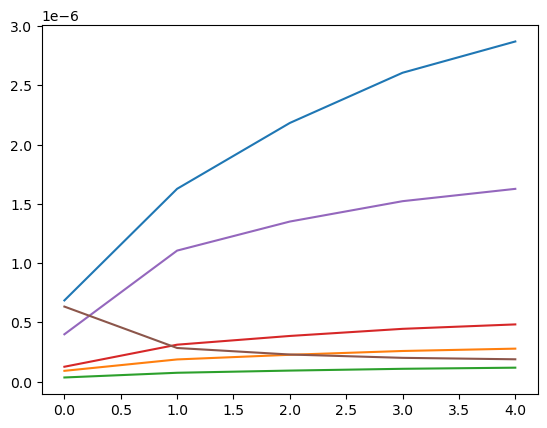

step: 0/1, D_loss: 0.13108647, G_loss_U: 3.884732, G_loss_S: 0.076240994, E_loss_t0: 2.0296748


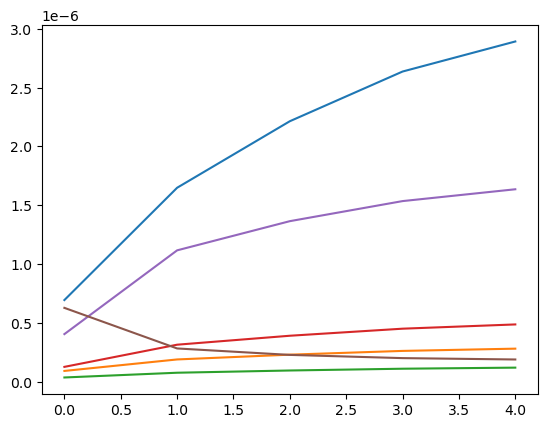

step: 0/1, D_loss: 0.12097306, G_loss_U: 3.8846514, G_loss_S: 0.075284526, E_loss_t0: 1.260451


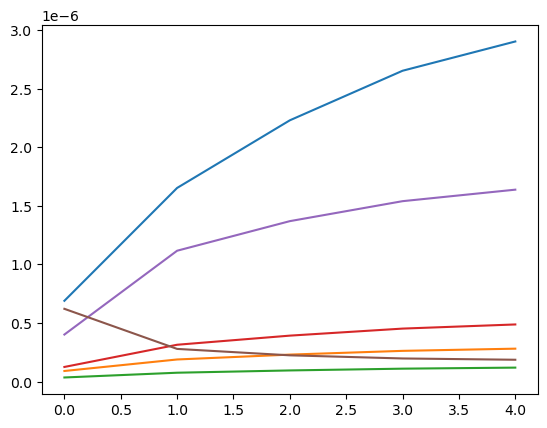

step: 0/1, D_loss: 0.13688059, G_loss_U: 3.8845742, G_loss_S: 0.07475588, E_loss_t0: 2.1810992


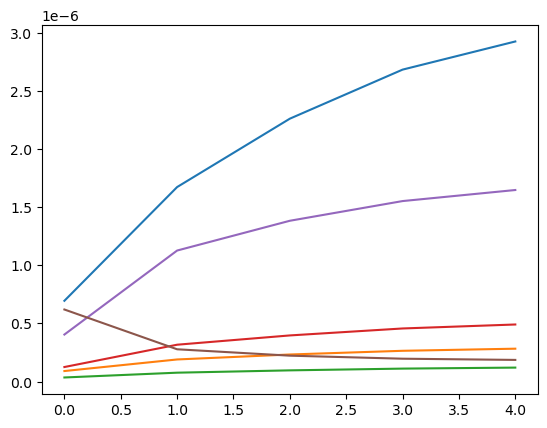

step: 0/1, D_loss: 0.1313203, G_loss_U: 3.8844976, G_loss_S: 0.07486388, E_loss_t0: 1.8974059


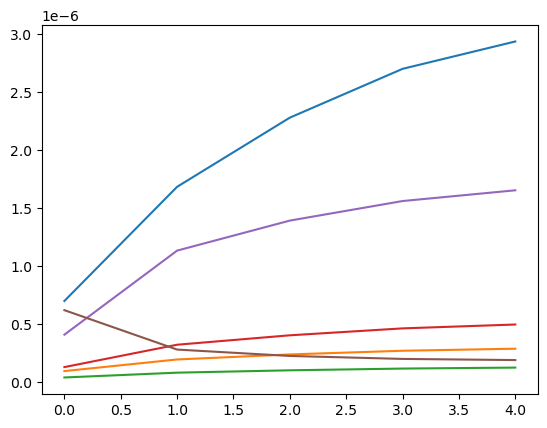

step: 0/1, D_loss: 0.12997055, G_loss_U: 3.8844187, G_loss_S: 0.07532279, E_loss_t0: 1.9519128


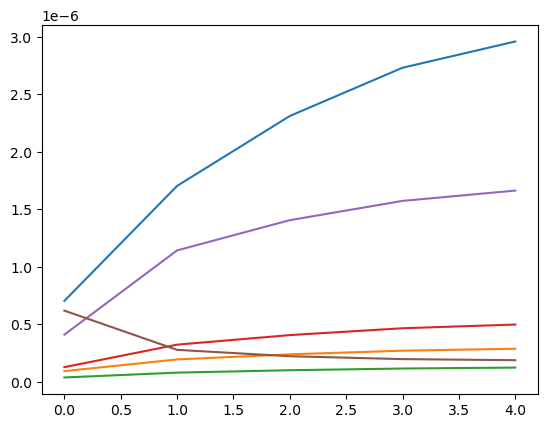

step: 0/1, D_loss: 0.13841766, G_loss_U: 3.8843343, G_loss_S: 0.07575586, E_loss_t0: 2.1226795


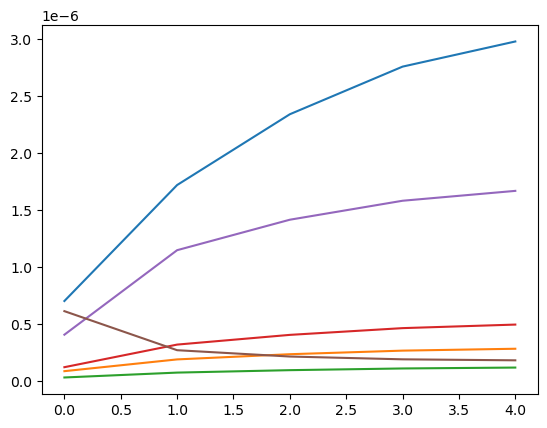

step: 0/1, D_loss: 0.12973109, G_loss_U: 3.8842402, G_loss_S: 0.07599578, E_loss_t0: 1.9450287


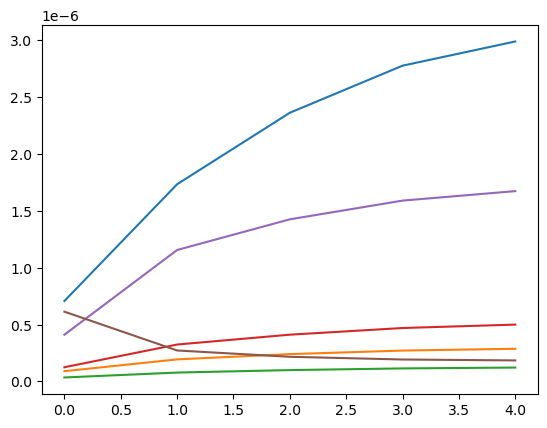

step: 0/1, D_loss: 0.13648072, G_loss_U: 3.8841324, G_loss_S: 0.07574677, E_loss_t0: 2.1007795


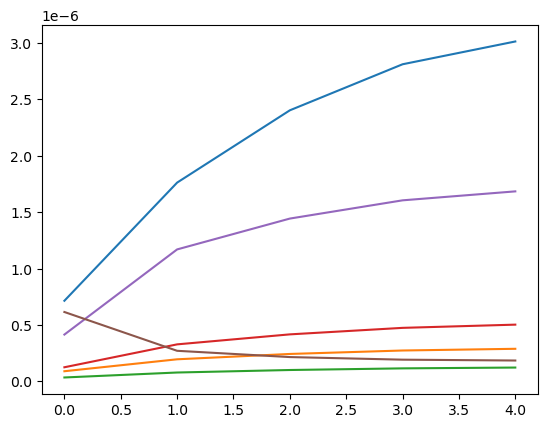

step: 0/1, D_loss: 0.1269792, G_loss_U: 3.8840048, G_loss_S: 0.07547627, E_loss_t0: 1.7537814


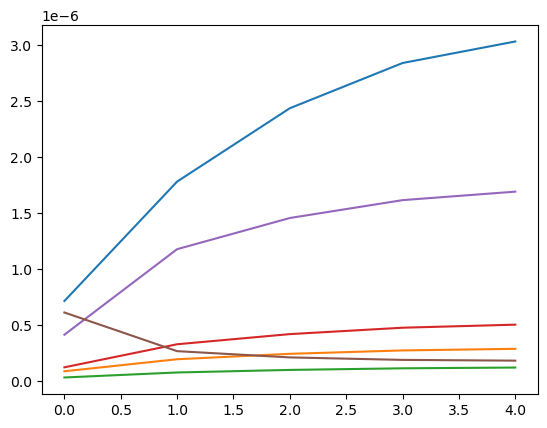

step: 0/1, D_loss: 0.13465084, G_loss_U: 3.8838522, G_loss_S: 0.07490065, E_loss_t0: 2.0096338


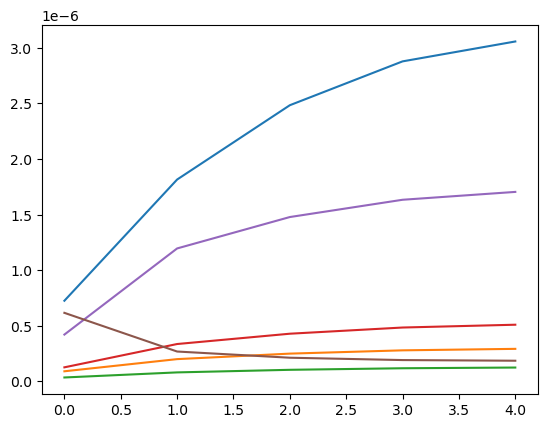

step: 0/1, D_loss: 0.13463204, G_loss_U: 3.883668, G_loss_S: 0.07455901, E_loss_t0: 2.0963075


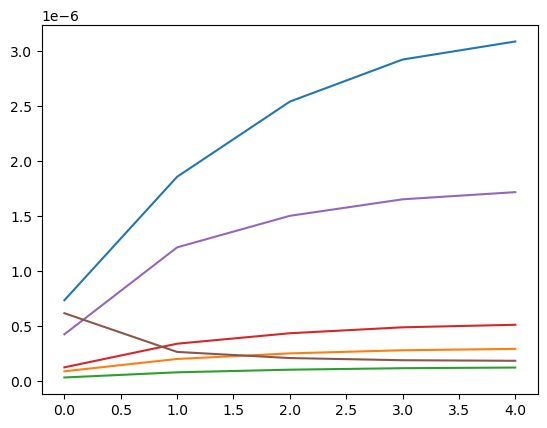

step: 0/1, D_loss: 0.12516344, G_loss_U: 3.883446, G_loss_S: 0.07464039, E_loss_t0: 1.6997981


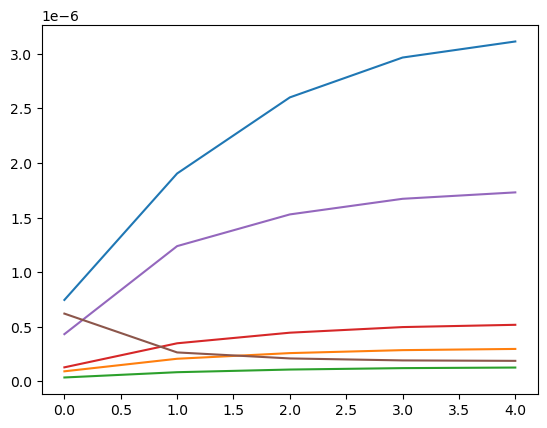

step: 0/1, D_loss: 0.14082086, G_loss_U: 3.8831844, G_loss_S: 0.074820116, E_loss_t0: 2.1328337


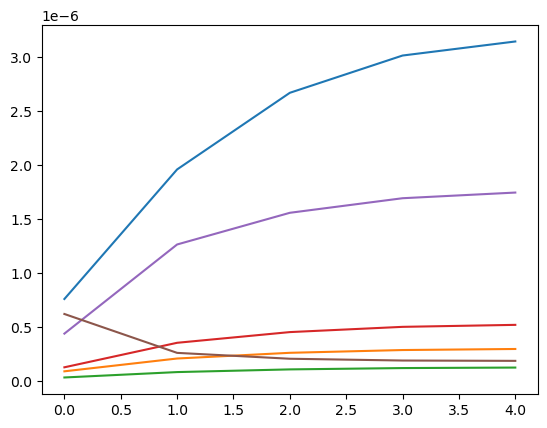

step: 0/1, D_loss: 0.12602991, G_loss_U: 3.882886, G_loss_S: 0.07496609, E_loss_t0: 1.764373


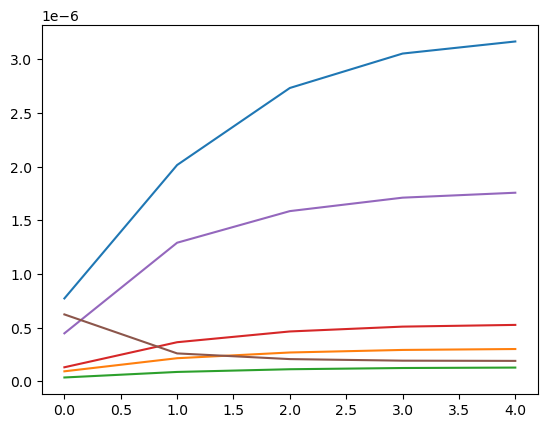

step: 0/1, D_loss: 0.13888635, G_loss_U: 3.8825636, G_loss_S: 0.07503635, E_loss_t0: 2.0570993


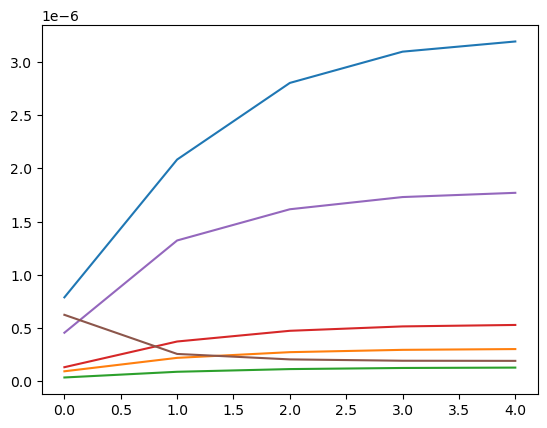

step: 0/1, D_loss: 0.12829265, G_loss_U: 3.8822389, G_loss_S: 0.074992545, E_loss_t0: 1.7039574


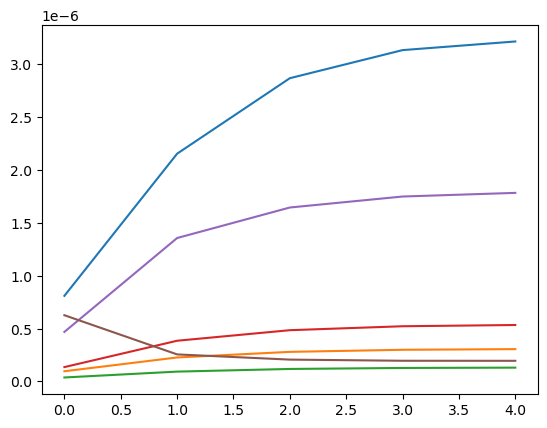

step: 0/1, D_loss: 0.12666824, G_loss_U: 3.881935, G_loss_S: 0.07482204, E_loss_t0: 1.5039531


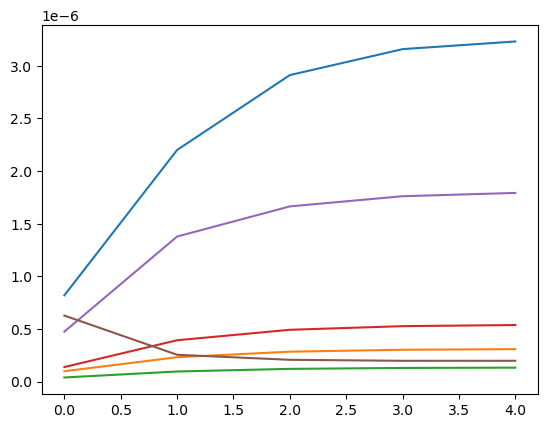

step: 0/1, D_loss: 0.12924442, G_loss_U: 3.8816721, G_loss_S: 0.07457556, E_loss_t0: 1.6511755


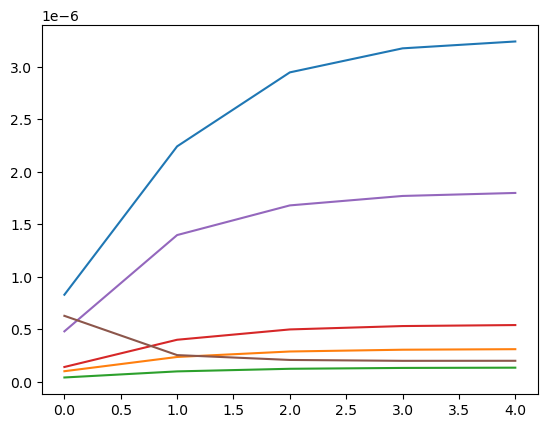

step: 0/1, D_loss: 0.13024437, G_loss_U: 3.8814588, G_loss_S: 0.07443255, E_loss_t0: 1.6959727


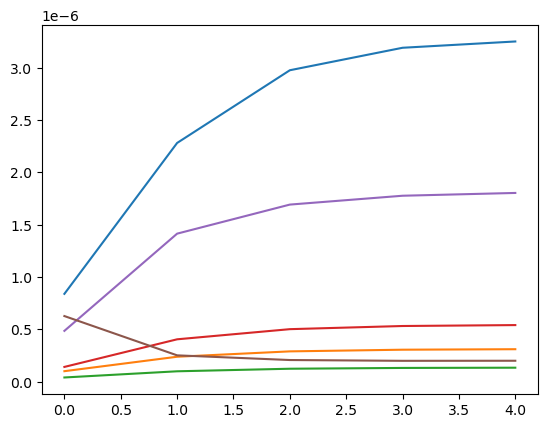

step: 0/1, D_loss: 0.13003275, G_loss_U: 3.8812935, G_loss_S: 0.07431372, E_loss_t0: 1.7019378


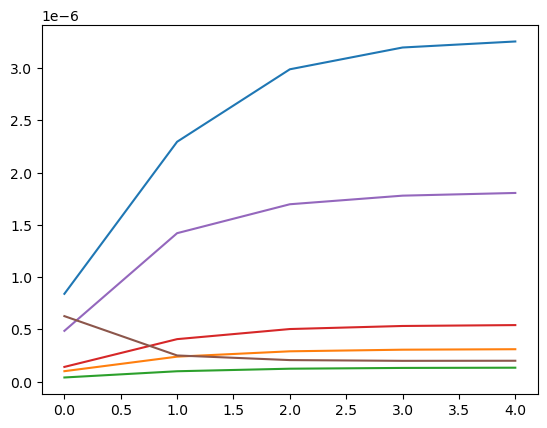

step: 0/1, D_loss: 0.13117334, G_loss_U: 3.8811688, G_loss_S: 0.07434849, E_loss_t0: 1.6780784


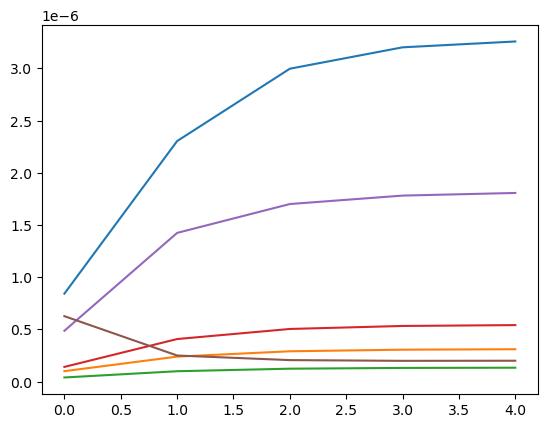

step: 0/1, D_loss: 0.13280475, G_loss_U: 3.881075, G_loss_S: 0.07431011, E_loss_t0: 1.789168


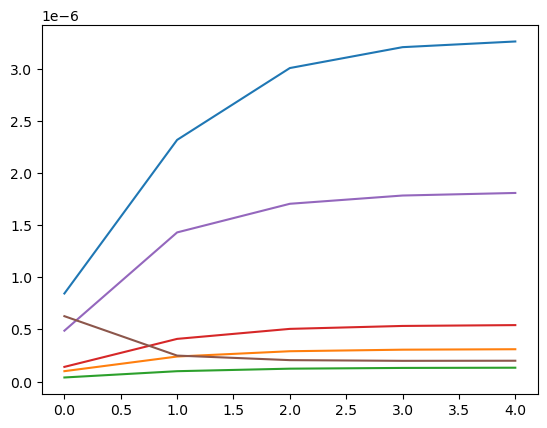

step: 0/1, D_loss: 0.13043824, G_loss_U: 3.881004, G_loss_S: 0.07443187, E_loss_t0: 1.2647667


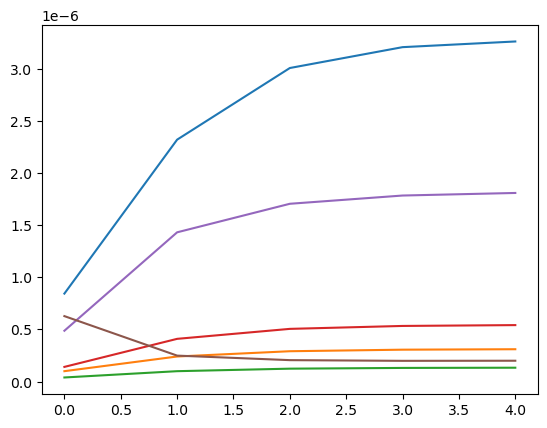

step: 0/1, D_loss: 0.13344173, G_loss_U: 3.8809497, G_loss_S: 0.074326634, E_loss_t0: 1.7771167


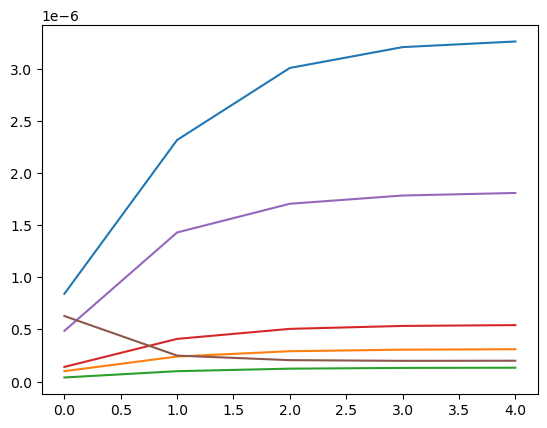

step: 0/1, D_loss: 0.13468912, G_loss_U: 3.8809066, G_loss_S: 0.07414177, E_loss_t0: 1.8903735


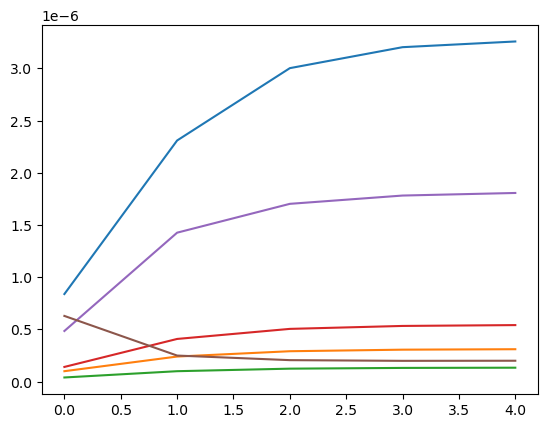

step: 0/1, D_loss: 0.13433309, G_loss_U: 3.8808718, G_loss_S: 0.073960654, E_loss_t0: 1.8668957


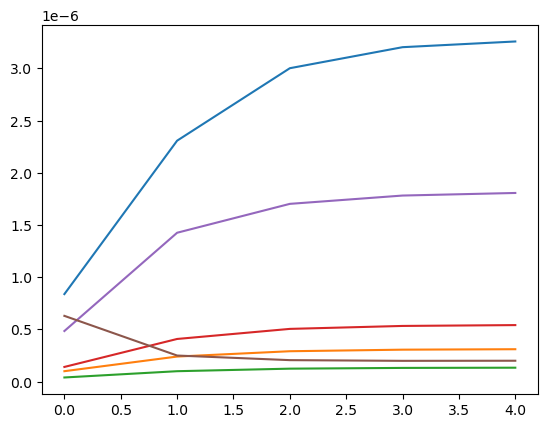

step: 0/1, D_loss: 0.13239685, G_loss_U: 3.8808439, G_loss_S: 0.07380634, E_loss_t0: 1.6989819


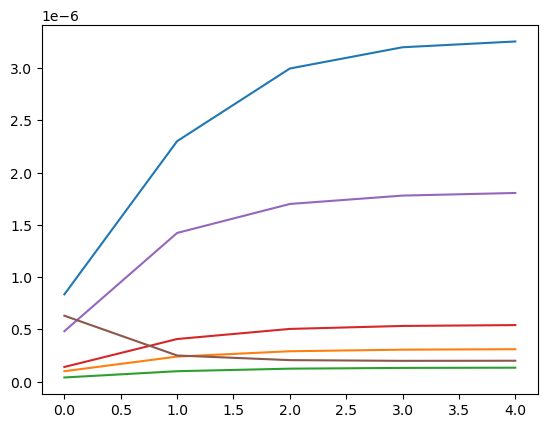

step: 0/1, D_loss: 0.14465296, G_loss_U: 3.8808203, G_loss_S: 0.07364231, E_loss_t0: 2.1454098


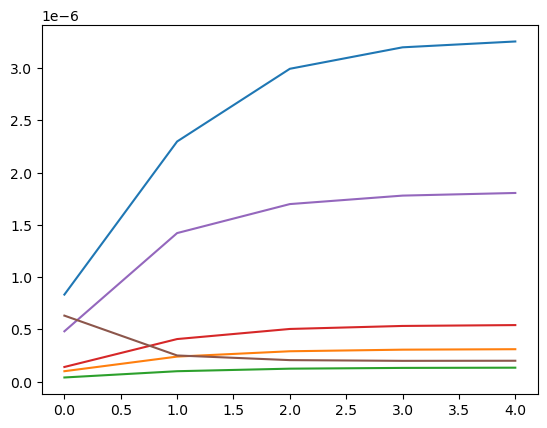

step: 0/1, D_loss: 0.1323763, G_loss_U: 3.8808002, G_loss_S: 0.07354304, E_loss_t0: 1.8075721


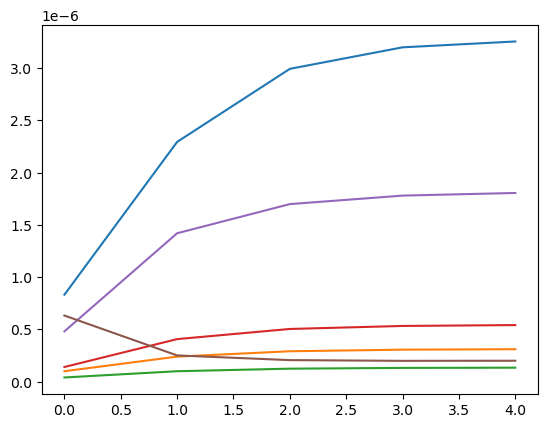

step: 0/1, D_loss: 0.13187008, G_loss_U: 3.880783, G_loss_S: 0.073417194, E_loss_t0: 1.7209857


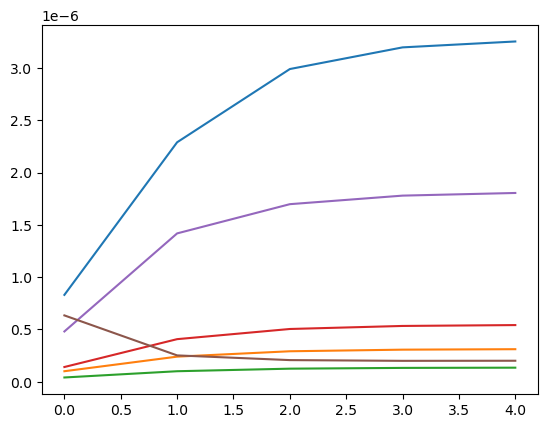

step: 0/1, D_loss: 0.1336579, G_loss_U: 3.880768, G_loss_S: 0.07324042, E_loss_t0: 1.6352903


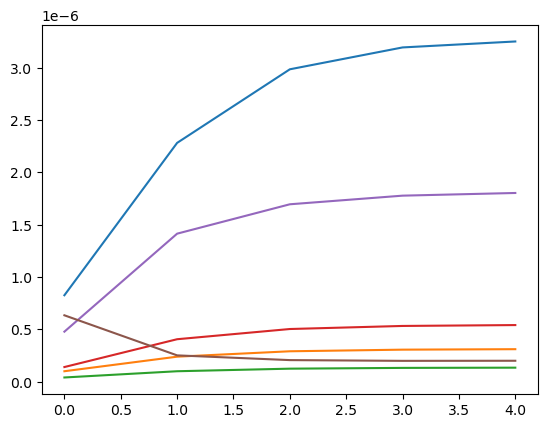

step: 0/1, D_loss: 0.14238417, G_loss_U: 3.880756, G_loss_S: 0.07288648, E_loss_t0: 1.9765254


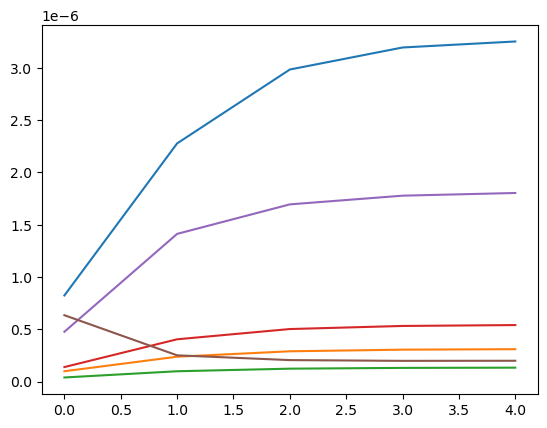

step: 0/1, D_loss: 0.13662481, G_loss_U: 3.8807447, G_loss_S: 0.07246274, E_loss_t0: 2.1119044


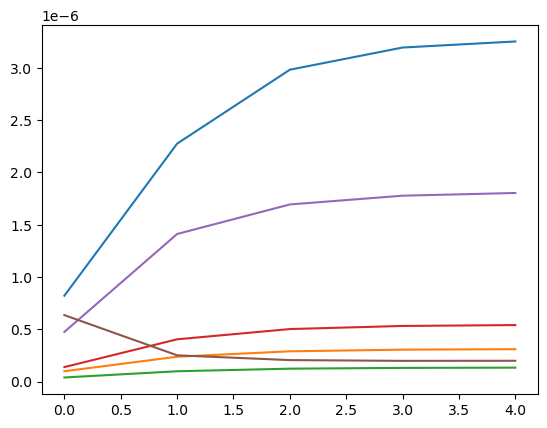

step: 0/1, D_loss: 0.13968925, G_loss_U: 3.8807342, G_loss_S: 0.071999185, E_loss_t0: 2.1285076


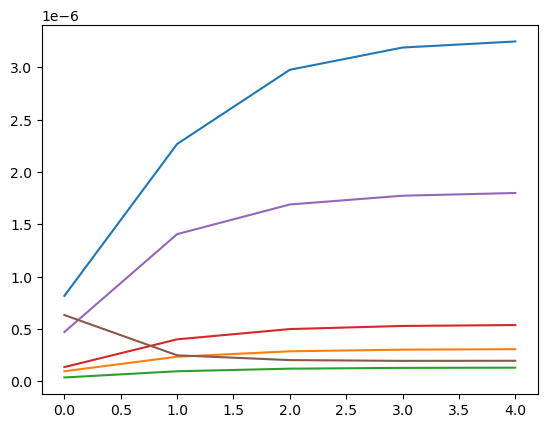

step: 0/1, D_loss: 0.13230337, G_loss_U: 3.8807251, G_loss_S: 0.07157381, E_loss_t0: 1.6229237


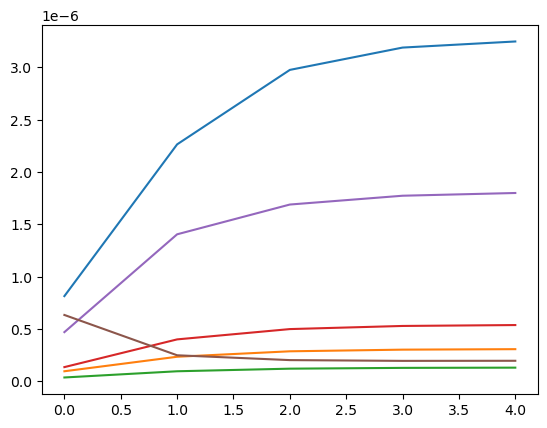

step: 0/1, D_loss: 0.1413129, G_loss_U: 3.8807173, G_loss_S: 0.070956476, E_loss_t0: 2.1208892


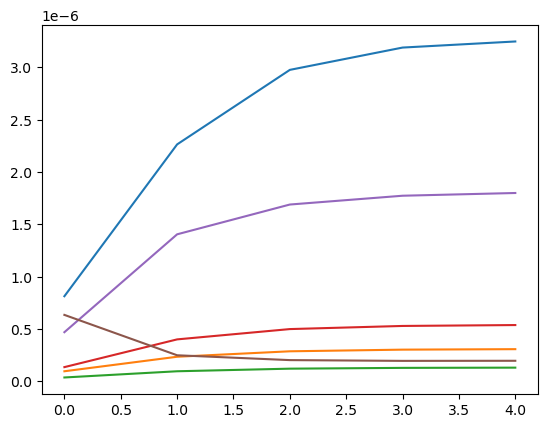

step: 0/1, D_loss: 0.1355248, G_loss_U: 3.8807104, G_loss_S: 0.070461474, E_loss_t0: 1.8536847


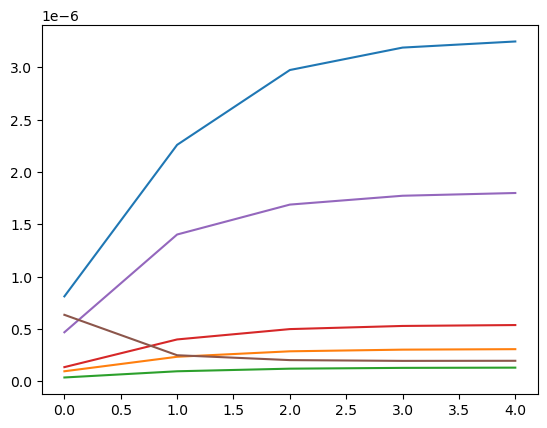

step: 0/1, D_loss: 0.13519354, G_loss_U: 3.880704, G_loss_S: 0.07040952, E_loss_t0: 1.2571912


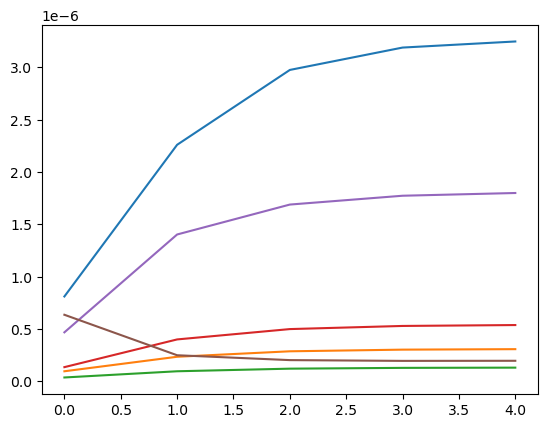

step: 0/1, D_loss: 0.13891006, G_loss_U: 3.880698, G_loss_S: 0.06992663, E_loss_t0: 1.8955019


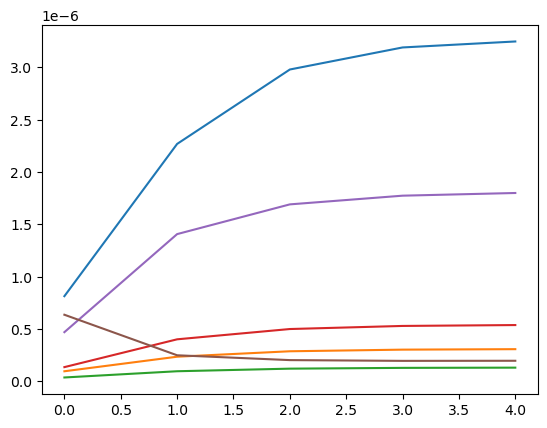

step: 0/1, D_loss: 0.15974376, G_loss_U: 4.0822816, G_loss_S: 0.06976687, E_loss_t0: 2.3962488


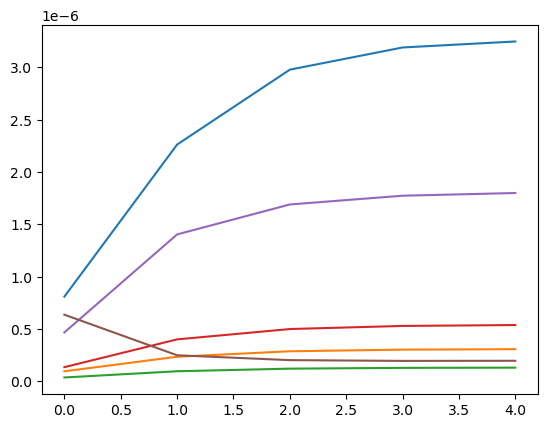

step: 0/1, D_loss: 0.11104553, G_loss_U: 4.0822773, G_loss_S: 0.07015253, E_loss_t0: 1.6624951


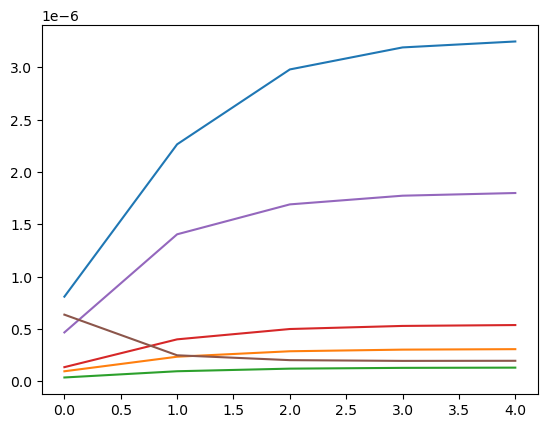

step: 0/1, D_loss: 0.115270674, G_loss_U: 4.082274, G_loss_S: 0.070839785, E_loss_t0: 2.0446565


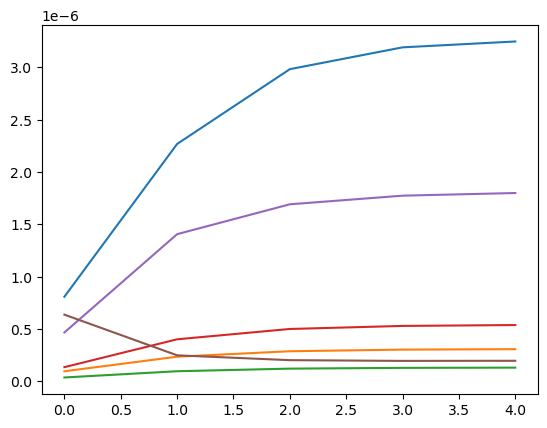

step: 0/1, D_loss: 0.11741221, G_loss_U: 4.082271, G_loss_S: 0.071371414, E_loss_t0: 2.0235631


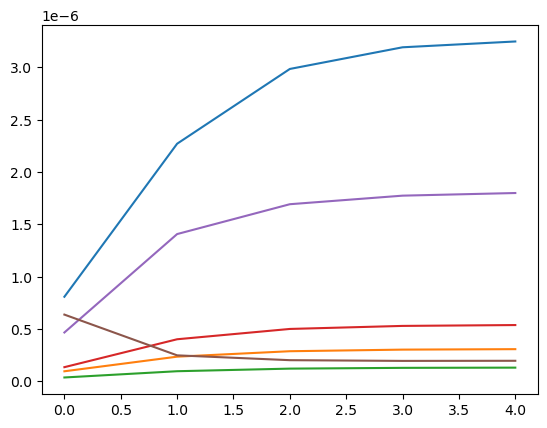

step: 0/1, D_loss: 0.117428094, G_loss_U: 4.0822673, G_loss_S: 0.07135409, E_loss_t0: 2.1076043


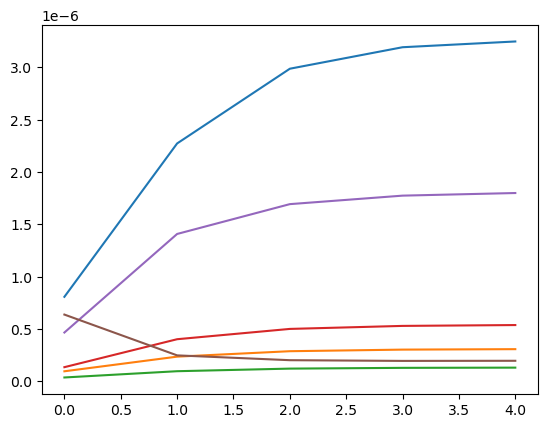

step: 0/1, D_loss: 0.11546899, G_loss_U: 4.0822644, G_loss_S: 0.07114842, E_loss_t0: 2.0067363


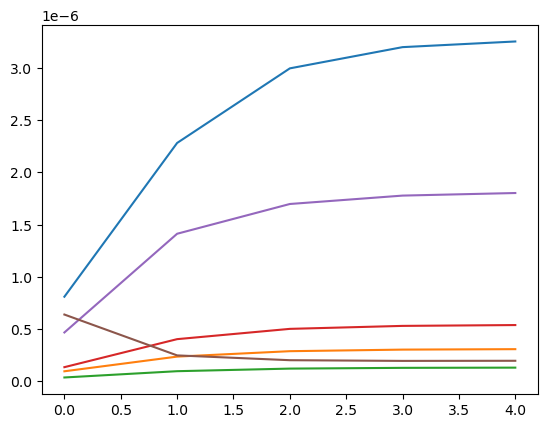

step: 0/1, D_loss: 0.10881339, G_loss_U: 4.0822616, G_loss_S: 0.070815265, E_loss_t0: 1.4008522


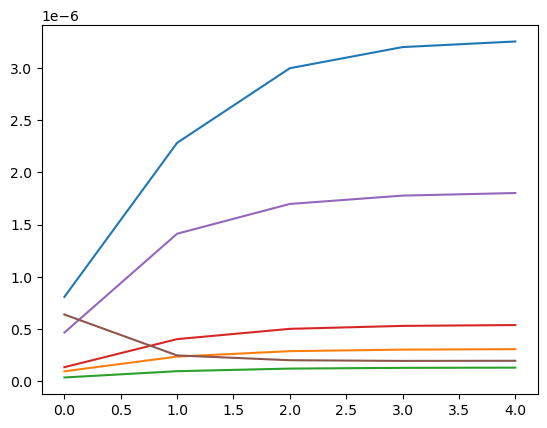

step: 0/1, D_loss: 0.110869974, G_loss_U: 4.082258, G_loss_S: 0.07065988, E_loss_t0: 1.6515725


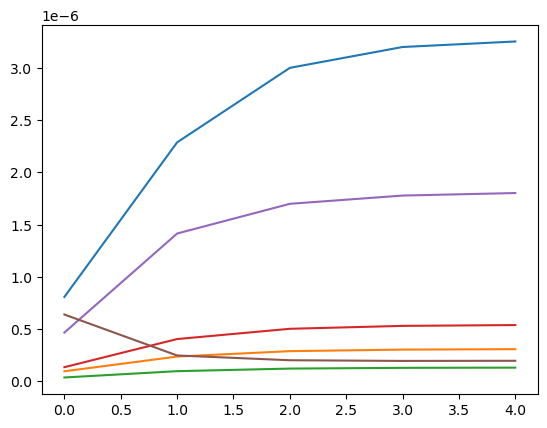

step: 0/1, D_loss: 0.111852065, G_loss_U: 4.0822554, G_loss_S: 0.07050626, E_loss_t0: 1.9238598


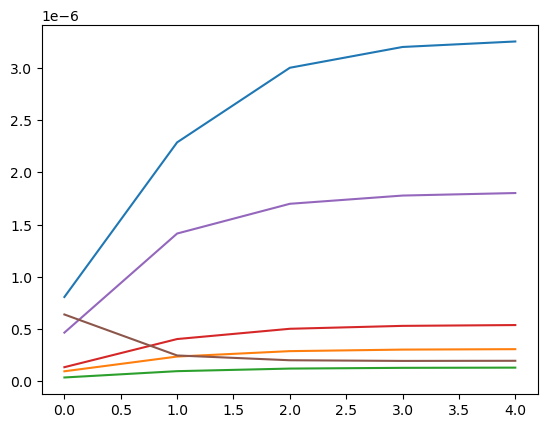

step: 0/1, D_loss: 0.11143175, G_loss_U: 4.082253, G_loss_S: 0.07027471, E_loss_t0: 1.5778563


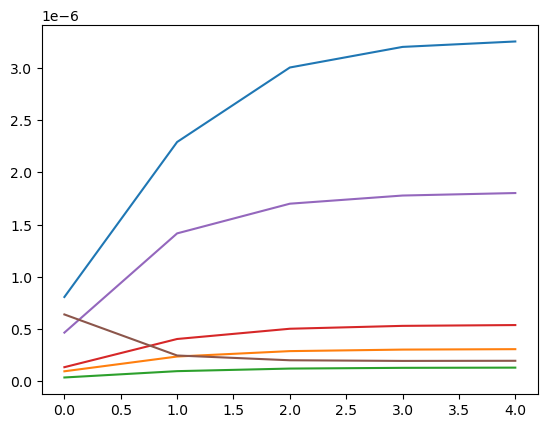

step: 0/1, D_loss: 0.12182215, G_loss_U: 4.0822506, G_loss_S: 0.07059997, E_loss_t0: 2.0313876


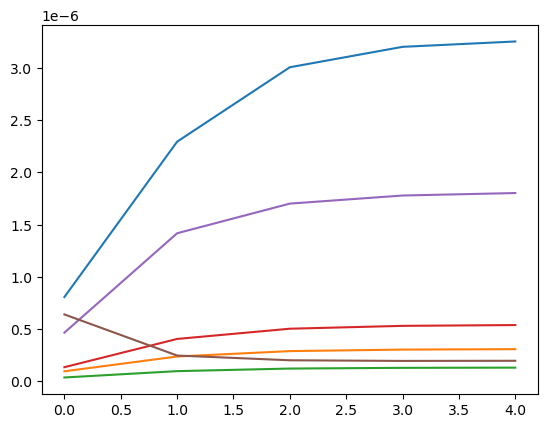

step: 0/1, D_loss: 0.1120321, G_loss_U: 4.0822477, G_loss_S: 0.07006108, E_loss_t0: 1.642037


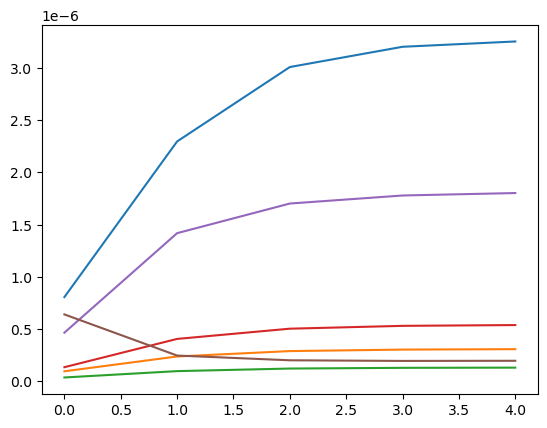

step: 0/1, D_loss: 0.11237848, G_loss_U: 4.082245, G_loss_S: 0.07010732, E_loss_t0: 1.776999


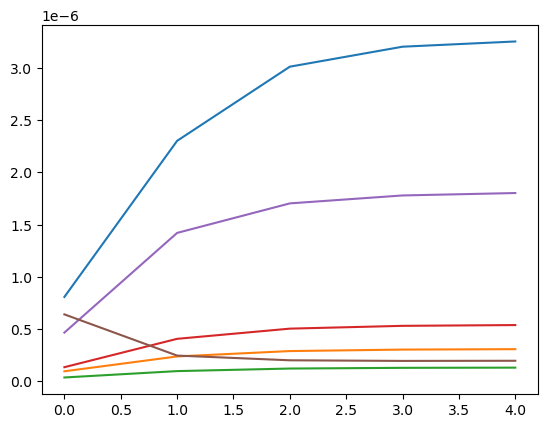

step: 0/1, D_loss: 0.11181621, G_loss_U: 4.082243, G_loss_S: 0.070087455, E_loss_t0: 1.6909124


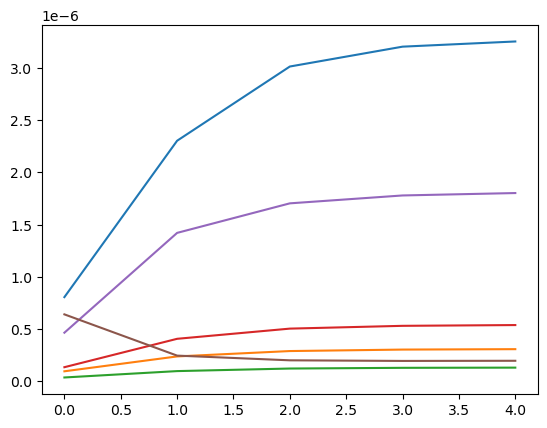

step: 0/1, D_loss: 0.10994587, G_loss_U: 4.082241, G_loss_S: 0.07028334, E_loss_t0: 1.274943


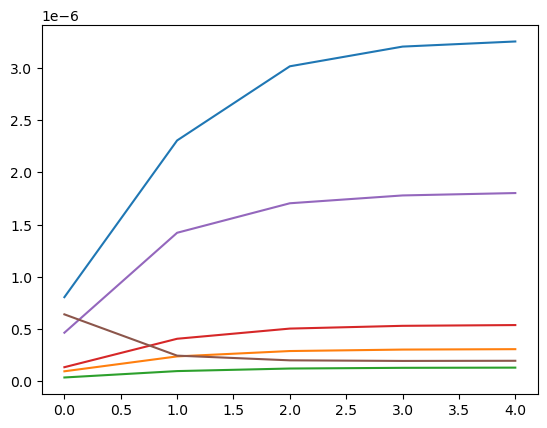

step: 0/1, D_loss: 0.11810836, G_loss_U: 4.082238, G_loss_S: 0.07038353, E_loss_t0: 2.0289857


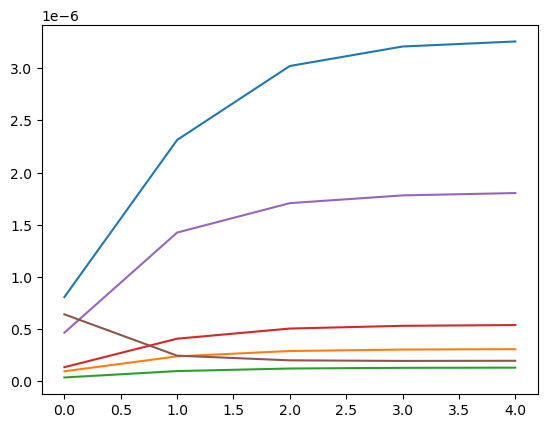

step: 0/1, D_loss: 0.11666165, G_loss_U: 4.082236, G_loss_S: 0.070212886, E_loss_t0: 1.8794225


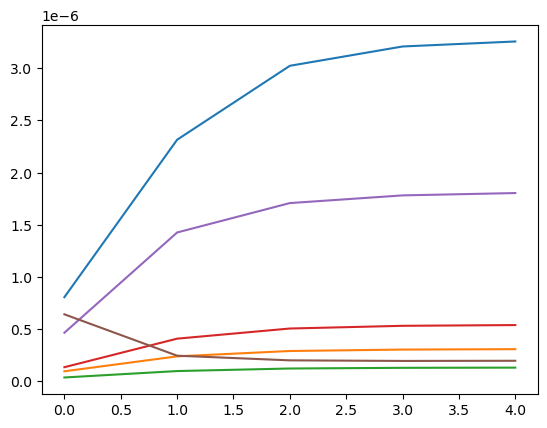

step: 0/1, D_loss: 0.11183419, G_loss_U: 4.0822344, G_loss_S: 0.070301116, E_loss_t0: 1.307836


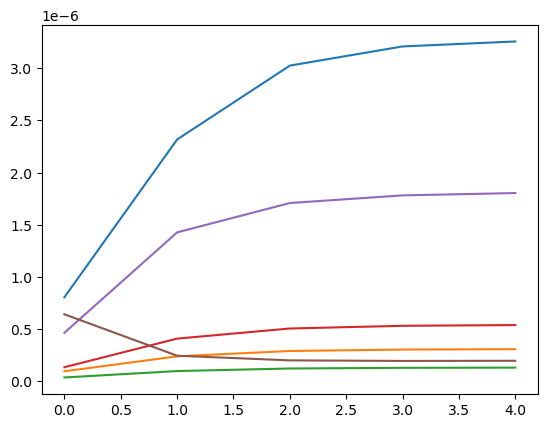

step: 0/1, D_loss: 0.1157325, G_loss_U: 4.0822325, G_loss_S: 0.06999643, E_loss_t0: 1.9502662


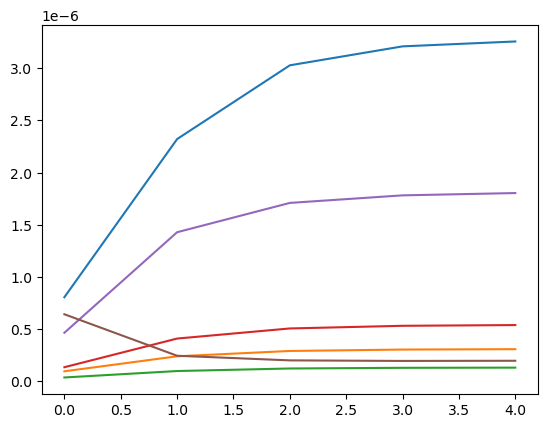

step: 0/1, D_loss: 0.10977111, G_loss_U: 4.08223, G_loss_S: 0.06999689, E_loss_t0: 1.5129791


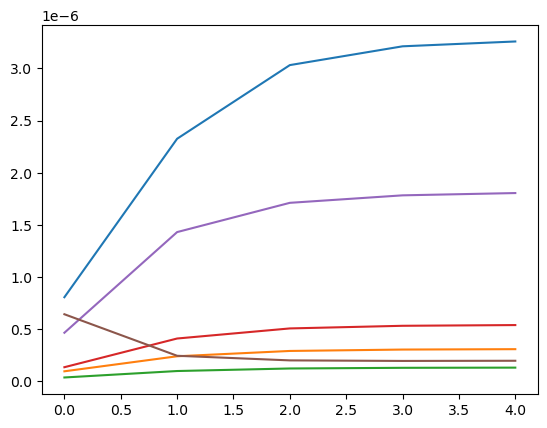

step: 0/1, D_loss: 0.12413043, G_loss_U: 4.082228, G_loss_S: 0.06990377, E_loss_t0: 2.352592


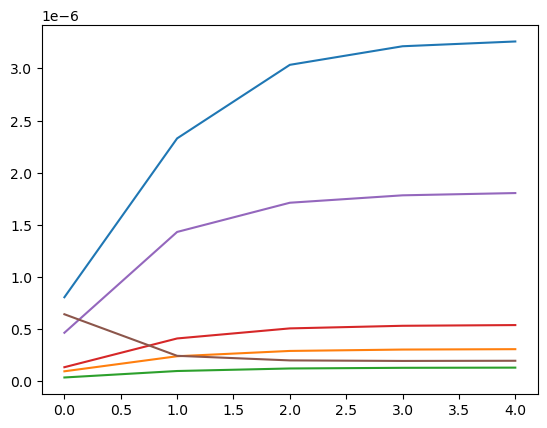

step: 0/1, D_loss: 0.12554082, G_loss_U: 4.082226, G_loss_S: 0.06995912, E_loss_t0: 2.2494955


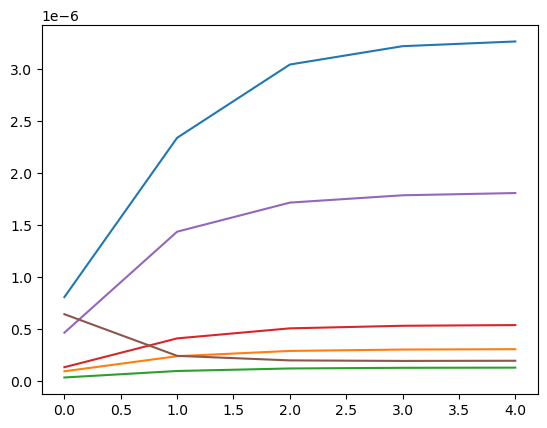

step: 0/1, D_loss: 0.11636378, G_loss_U: 4.0822244, G_loss_S: 0.06988407, E_loss_t0: 1.9320529


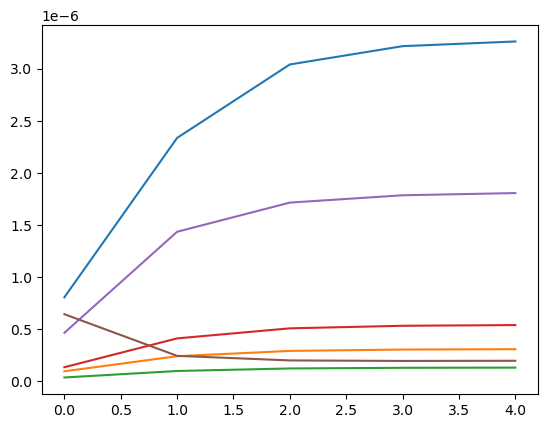

step: 0/1, D_loss: 0.11025229, G_loss_U: 4.0822225, G_loss_S: 0.06985377, E_loss_t0: 1.7473539


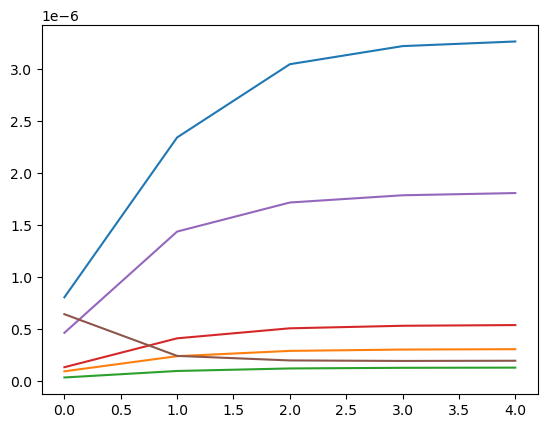

step: 0/1, D_loss: 0.11322695, G_loss_U: 4.0822206, G_loss_S: 0.069836505, E_loss_t0: 1.9040571


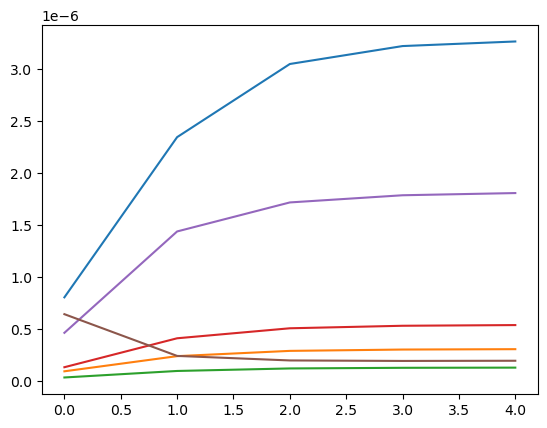

step: 0/1, D_loss: 0.11697678, G_loss_U: 4.0822186, G_loss_S: 0.06981613, E_loss_t0: 1.9660392


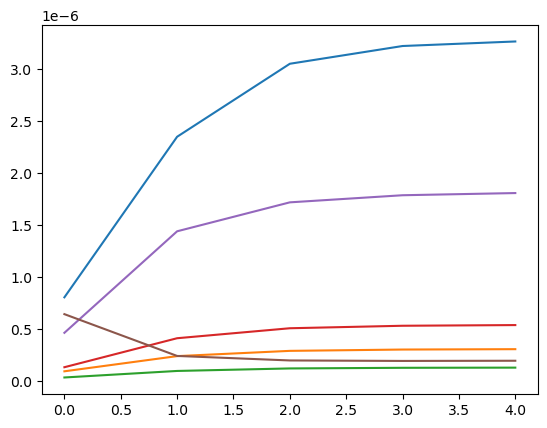

step: 0/1, D_loss: 0.111061186, G_loss_U: 4.082217, G_loss_S: 0.069881275, E_loss_t0: 1.5825583


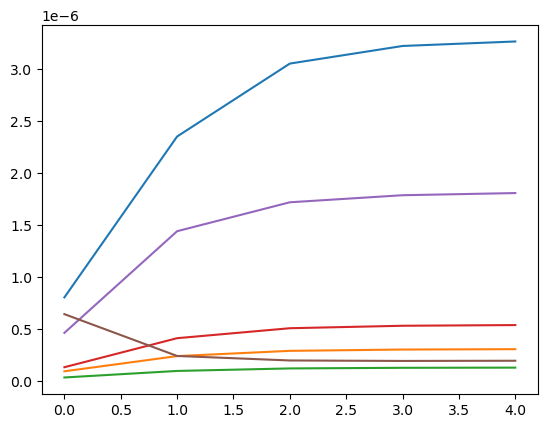

step: 0/1, D_loss: 0.11680792, G_loss_U: 4.082216, G_loss_S: 0.069805145, E_loss_t0: 2.0830297


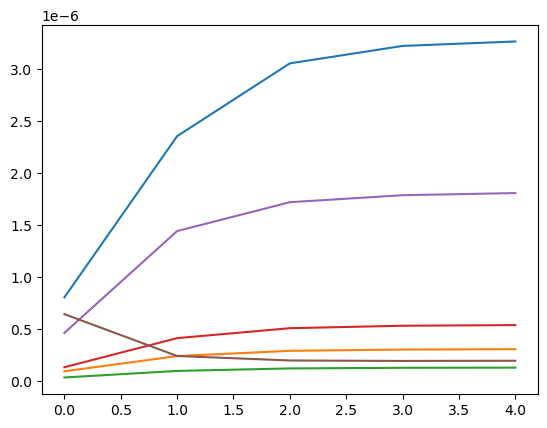

step: 0/1, D_loss: 0.11208744, G_loss_U: 4.0822134, G_loss_S: 0.069901824, E_loss_t0: 1.6809628


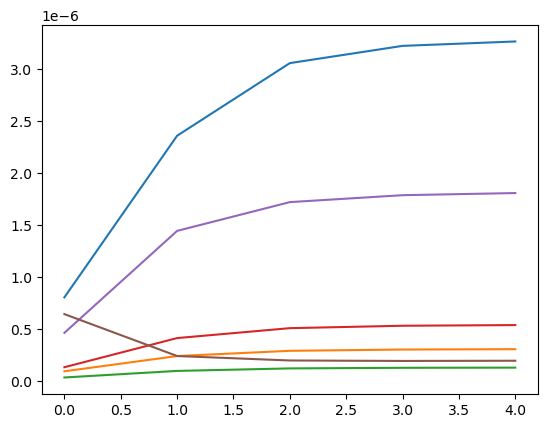

step: 0/1, D_loss: 0.11003459, G_loss_U: 4.082212, G_loss_S: 0.06991588, E_loss_t0: 1.6137102


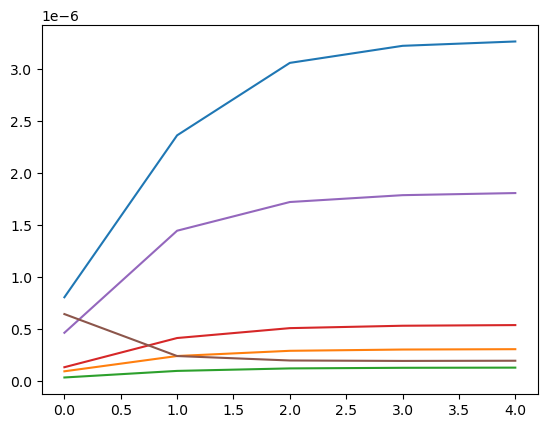

step: 0/1, D_loss: 0.111439705, G_loss_U: 4.0822105, G_loss_S: 0.06986617, E_loss_t0: 1.7499815


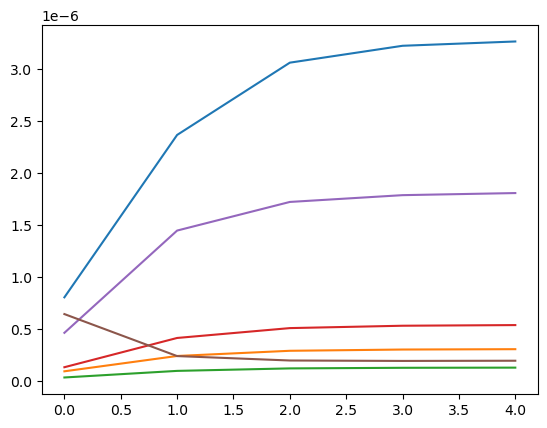

step: 0/1, D_loss: 0.1238849, G_loss_U: 4.082208, G_loss_S: 0.06978586, E_loss_t0: 2.2473612


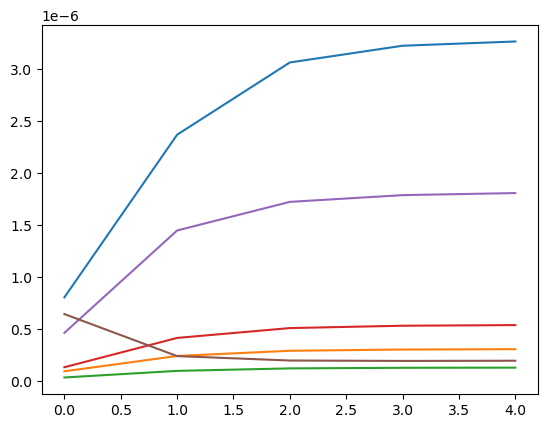

step: 0/1, D_loss: 0.111701, G_loss_U: 4.082207, G_loss_S: 0.06988228, E_loss_t0: 1.7825483


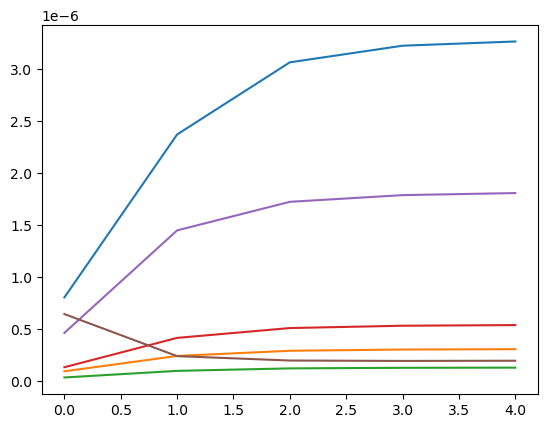

step: 0/1, D_loss: 0.11865704, G_loss_U: 4.0822053, G_loss_S: 0.06966386, E_loss_t0: 2.241948


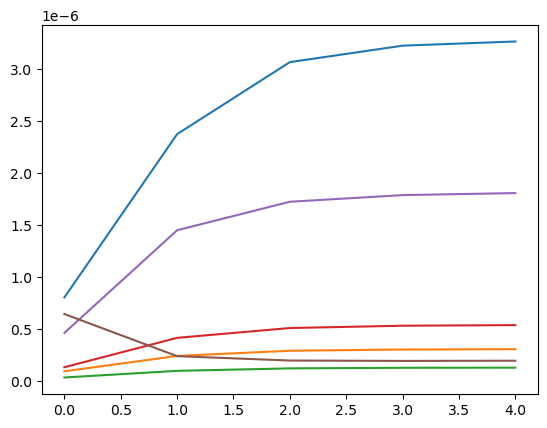

step: 0/1, D_loss: 0.1151266, G_loss_U: 4.082204, G_loss_S: 0.069711015, E_loss_t0: 2.0892801


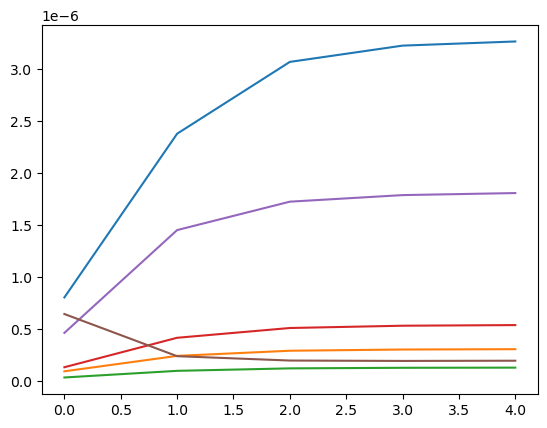

step: 0/1, D_loss: 0.110641465, G_loss_U: 4.082203, G_loss_S: 0.0697715, E_loss_t0: 1.7258219


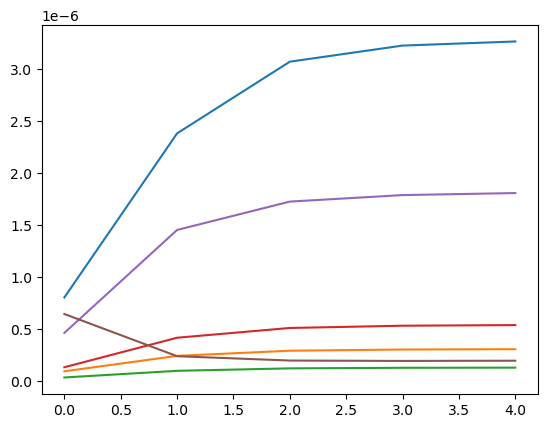

step: 0/1, D_loss: 0.11011835, G_loss_U: 4.082201, G_loss_S: 0.0698285, E_loss_t0: 1.2056334


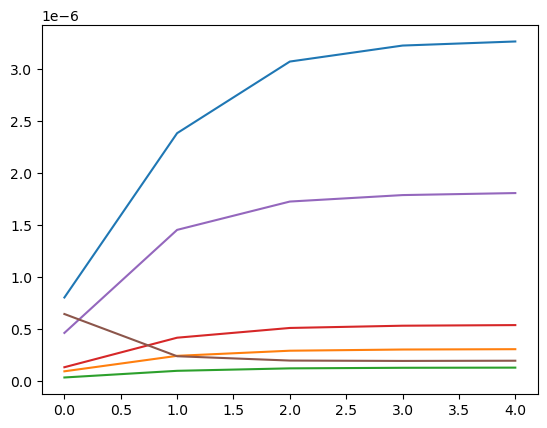

step: 0/1, D_loss: 0.111381106, G_loss_U: 4.0822, G_loss_S: 0.0697524, E_loss_t0: 1.9299566


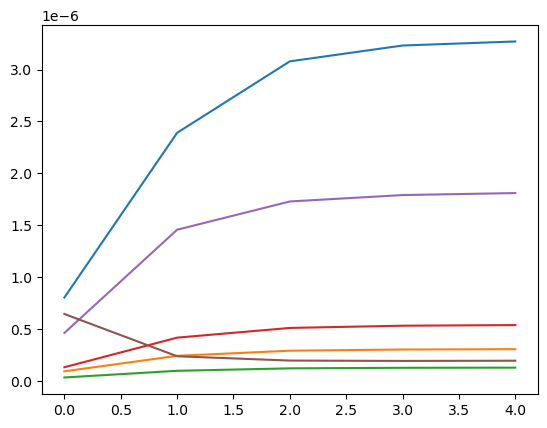

step: 0/1, D_loss: 0.11970453, G_loss_U: 4.0821977, G_loss_S: 0.06966565, E_loss_t0: 2.2364552


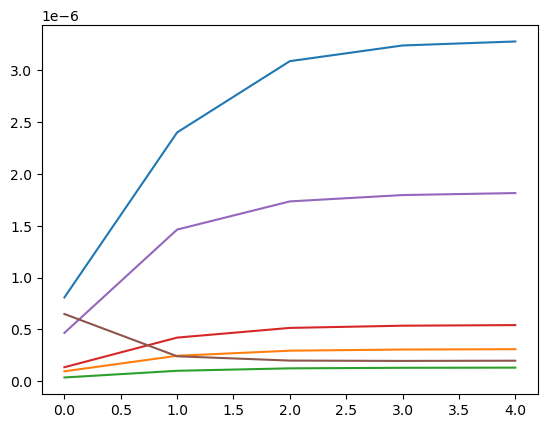

step: 0/1, D_loss: 0.11243214, G_loss_U: 4.0821967, G_loss_S: 0.069714844, E_loss_t0: 1.9157912


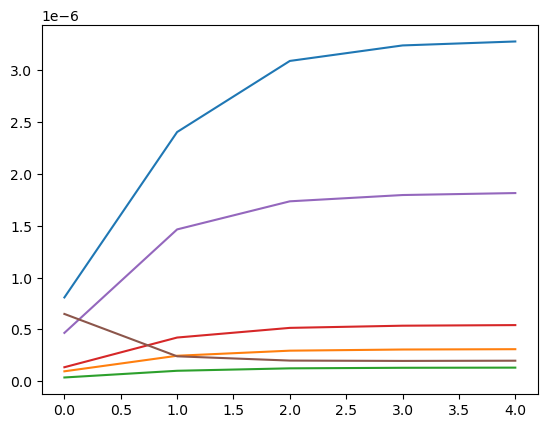

step: 0/1, D_loss: 0.10966502, G_loss_U: 4.0821953, G_loss_S: 0.069759086, E_loss_t0: 1.6077112


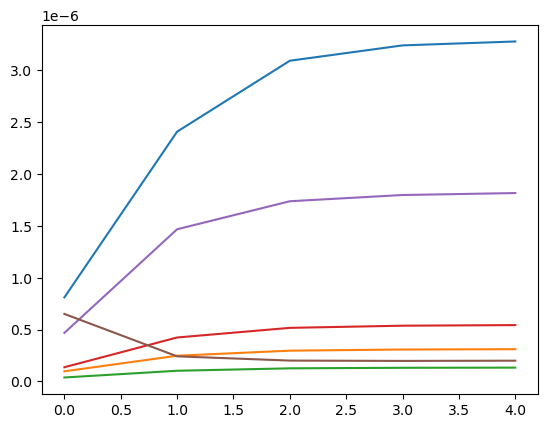

step: 0/1, D_loss: 0.11013424, G_loss_U: 4.0821943, G_loss_S: 0.069784224, E_loss_t0: 1.4224268


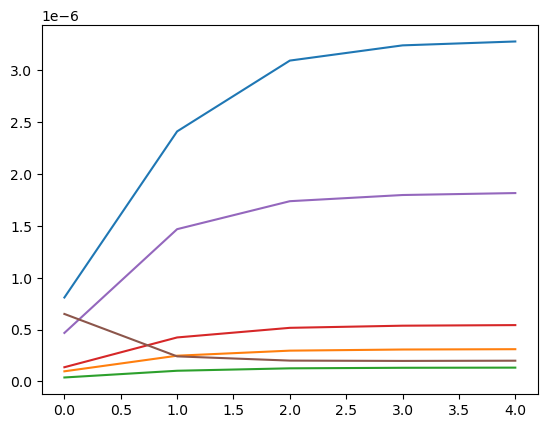

step: 0/1, D_loss: 0.11008522, G_loss_U: 4.082193, G_loss_S: 0.06995842, E_loss_t0: 1.1630943


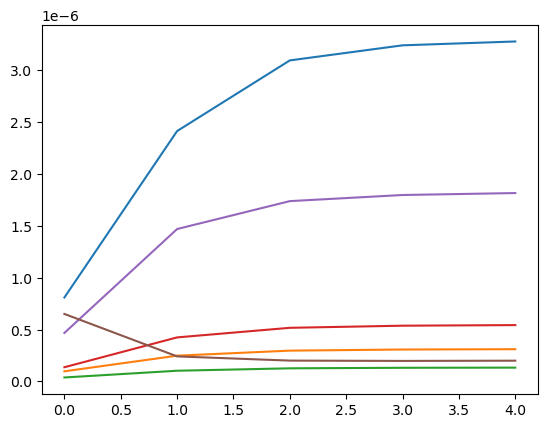

step: 0/1, D_loss: 0.124437645, G_loss_U: 4.082191, G_loss_S: 0.06964955, E_loss_t0: 2.3861163


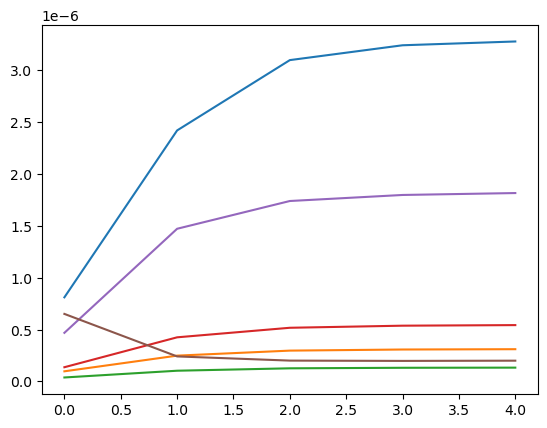

step: 0/1, D_loss: 0.11509304, G_loss_U: 4.08219, G_loss_S: 0.069660634, E_loss_t0: 2.102247


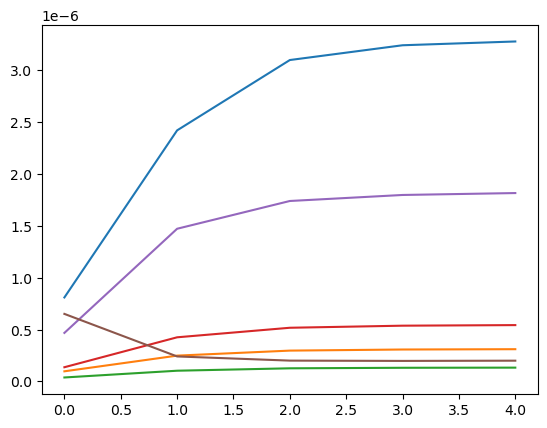

step: 0/1, D_loss: 0.1112504, G_loss_U: 4.0821886, G_loss_S: 0.069714956, E_loss_t0: 1.8557886


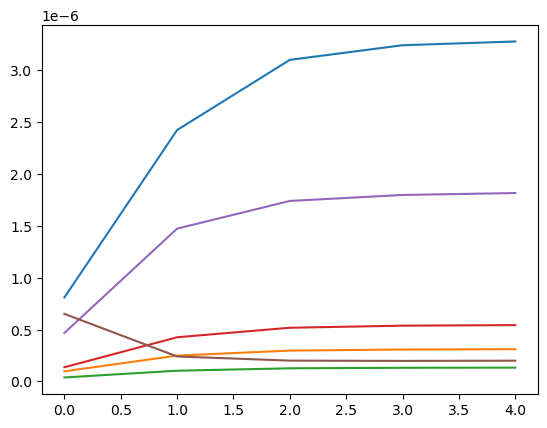

step: 0/1, D_loss: 0.12230718, G_loss_U: 4.082187, G_loss_S: 0.06962105, E_loss_t0: 2.283477


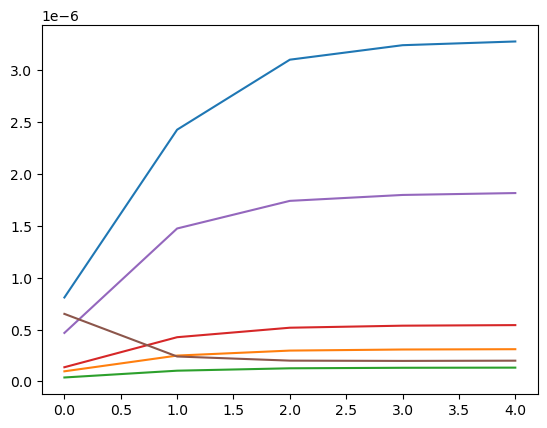

step: 0/1, D_loss: 0.12914905, G_loss_U: 4.082186, G_loss_S: 0.069688365, E_loss_t0: 2.2820873


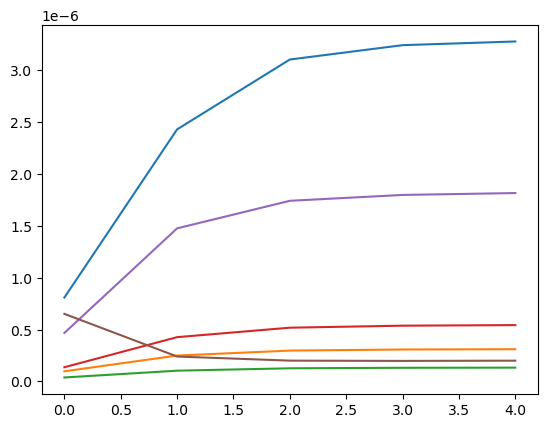

step: 0/1, D_loss: 0.11617014, G_loss_U: 4.0821853, G_loss_S: 0.069667414, E_loss_t0: 2.050074


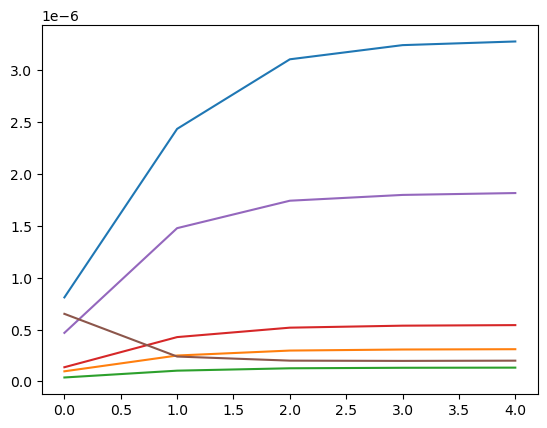

step: 0/1, D_loss: 0.12841712, G_loss_U: 4.0821834, G_loss_S: 0.069636665, E_loss_t0: 2.362947


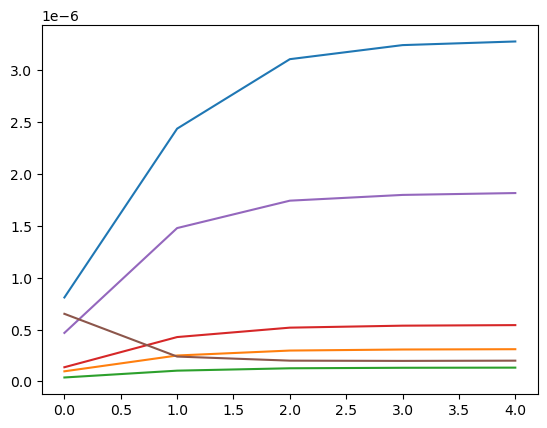

step: 0/1, D_loss: 0.110255264, G_loss_U: 4.082182, G_loss_S: 0.06975292, E_loss_t0: 1.6399375


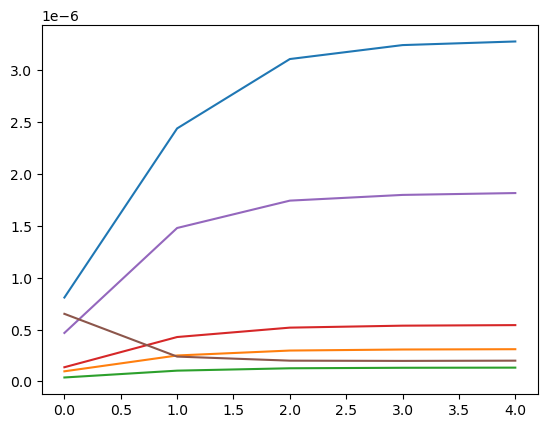

step: 0/1, D_loss: 0.112832375, G_loss_U: 4.082181, G_loss_S: 0.06969339, E_loss_t0: 1.8929698


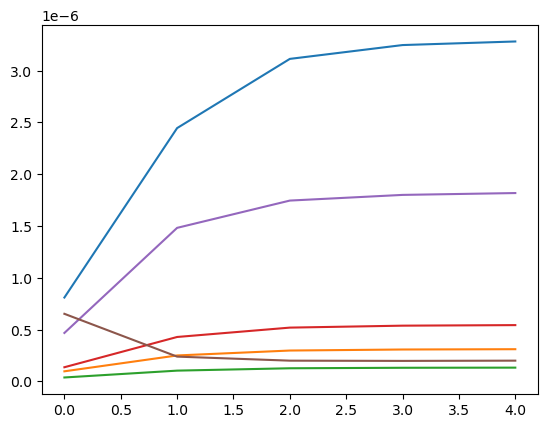

step: 0/1, D_loss: 0.11880869, G_loss_U: 4.08218, G_loss_S: 0.06973014, E_loss_t0: 2.0025694


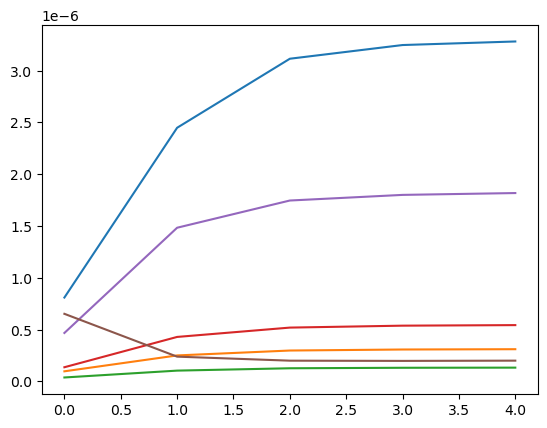

step: 0/1, D_loss: 0.11675497, G_loss_U: 4.082179, G_loss_S: 0.06971714, E_loss_t0: 1.9550067


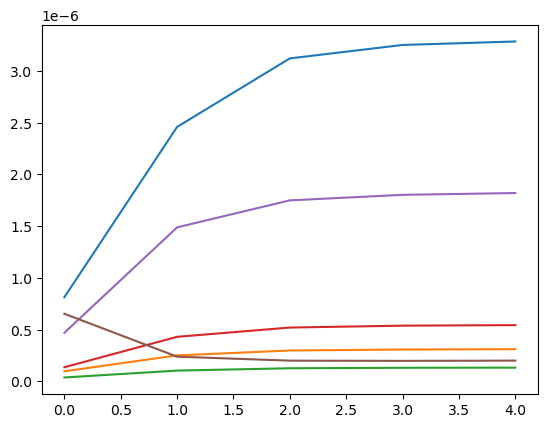

step: 0/1, D_loss: 0.117951244, G_loss_U: 4.0821776, G_loss_S: 0.069735005, E_loss_t0: 2.066487


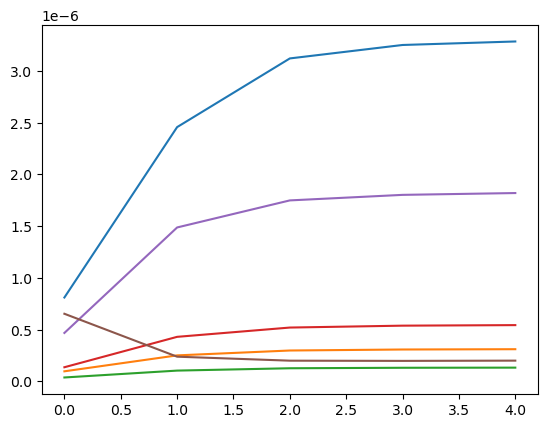

step: 0/1, D_loss: 0.11689814, G_loss_U: 4.0821757, G_loss_S: 0.06959885, E_loss_t0: 2.252782


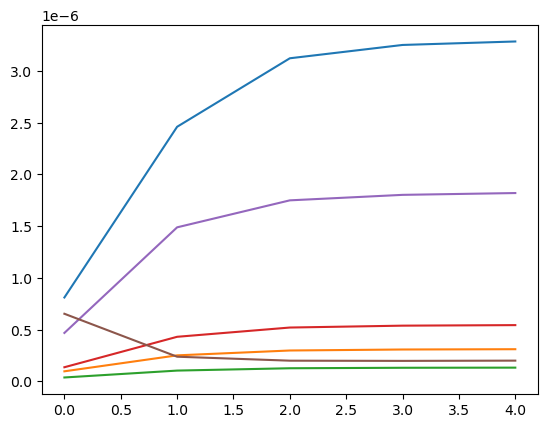

step: 0/1, D_loss: 0.11005936, G_loss_U: 4.082175, G_loss_S: 0.07000529, E_loss_t0: 1.2393261


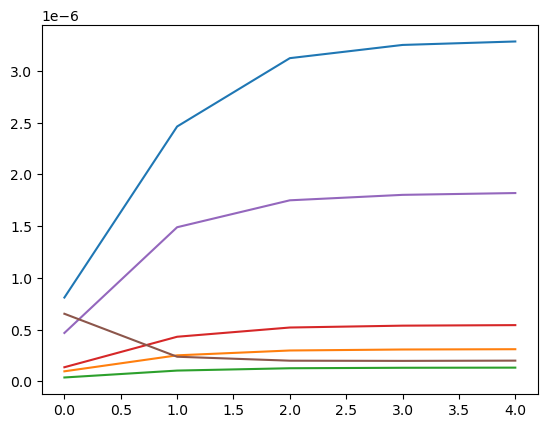

step: 0/1, D_loss: 0.12170914, G_loss_U: 4.0821743, G_loss_S: 0.069680296, E_loss_t0: 2.0402


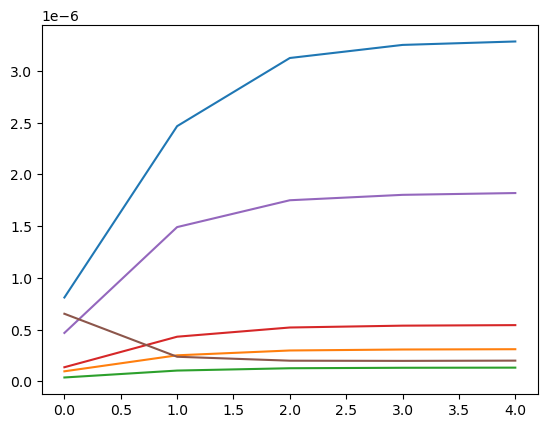

step: 0/1, D_loss: 0.1118223, G_loss_U: 4.0821724, G_loss_S: 0.06973386, E_loss_t0: 1.9332445


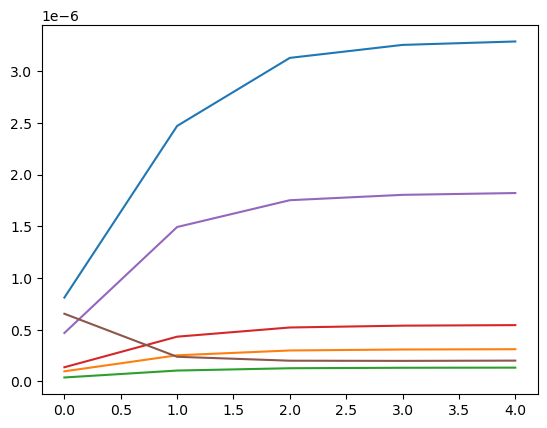

step: 0/1, D_loss: 0.11084694, G_loss_U: 4.082172, G_loss_S: 0.0698355, E_loss_t0: 1.4870604


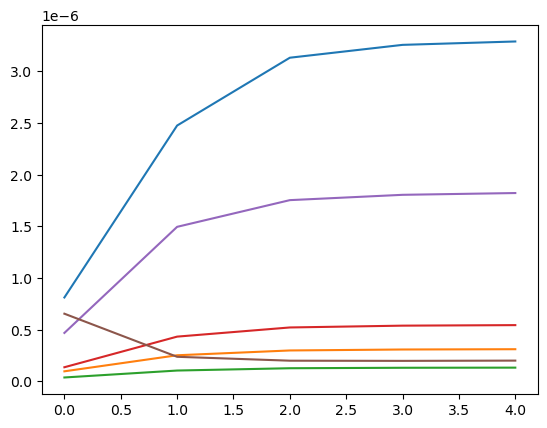

step: 0/1, D_loss: 0.11189523, G_loss_U: 4.0821705, G_loss_S: 0.069676034, E_loss_t0: 1.9486762


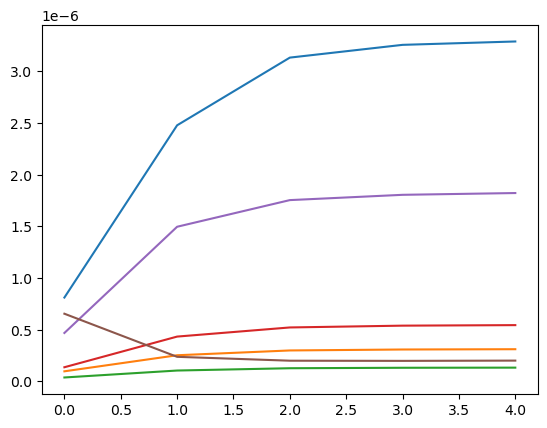

step: 0/1, D_loss: 0.11160343, G_loss_U: 4.0821695, G_loss_S: 0.06966297, E_loss_t0: 1.8475455


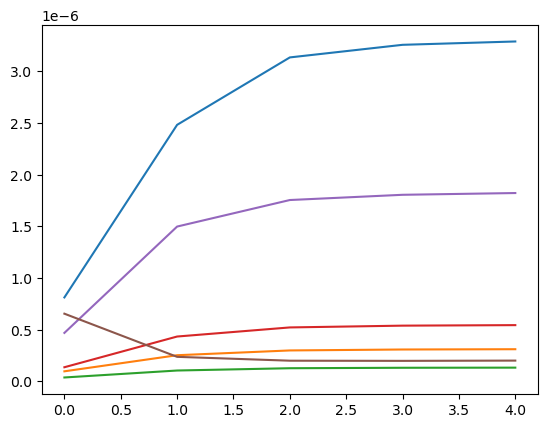

step: 0/1, D_loss: 0.110439554, G_loss_U: 4.0821686, G_loss_S: 0.06966924, E_loss_t0: 1.8043401


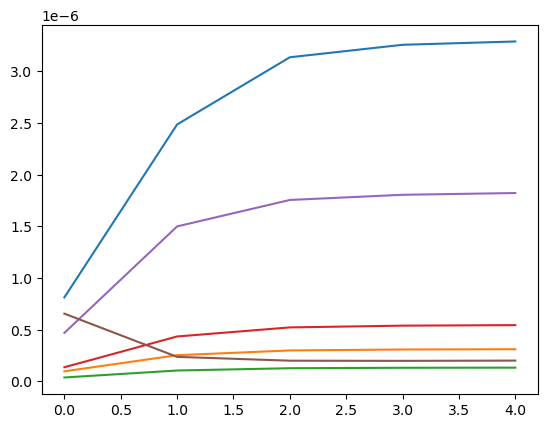

step: 0/1, D_loss: 0.12132171, G_loss_U: 4.0821676, G_loss_S: 0.06957694, E_loss_t0: 2.3113785


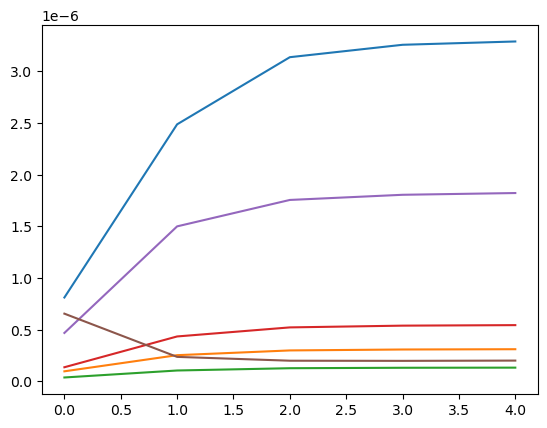

step: 0/1, D_loss: 0.11798141, G_loss_U: 4.082166, G_loss_S: 0.06970628, E_loss_t0: 2.0736306


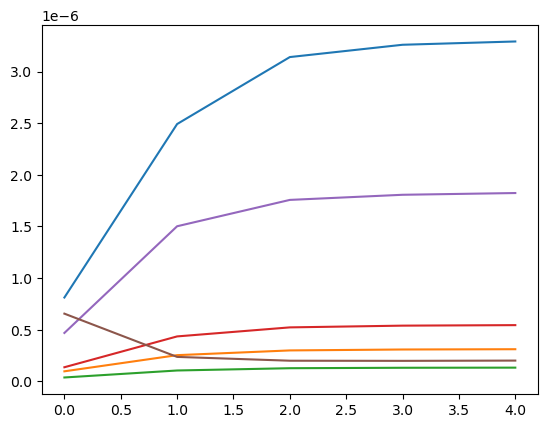

step: 0/1, D_loss: 0.120775424, G_loss_U: 4.0821652, G_loss_S: 0.069598876, E_loss_t0: 2.2341893


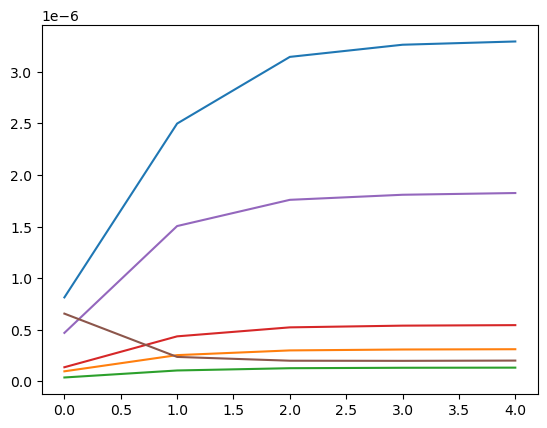

step: 0/1, D_loss: 0.113738276, G_loss_U: 4.082164, G_loss_S: 0.06968688, E_loss_t0: 2.0092347


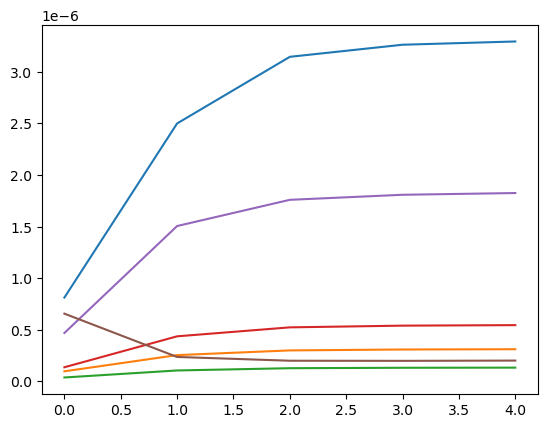

step: 0/1, D_loss: 0.1168174, G_loss_U: 4.082163, G_loss_S: 0.06968857, E_loss_t0: 1.9243965


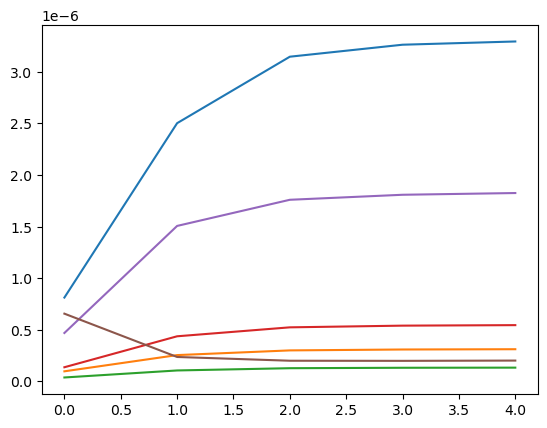

step: 0/1, D_loss: 0.13446829, G_loss_U: 4.0821624, G_loss_S: 0.0695689, E_loss_t0: 2.504274


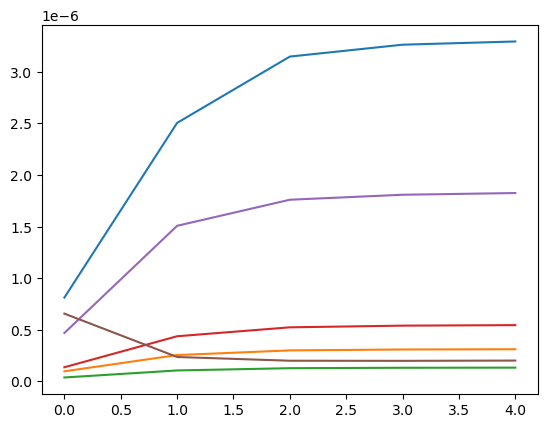

step: 0/1, D_loss: 0.11955802, G_loss_U: 4.0821614, G_loss_S: 0.06963733, E_loss_t0: 2.1743212


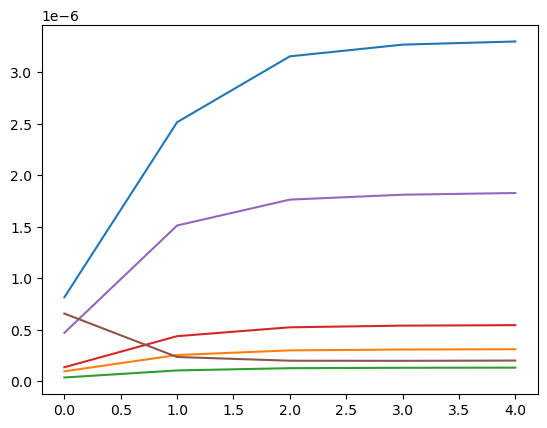

step: 0/1, D_loss: 0.11086628, G_loss_U: 4.08216, G_loss_S: 0.0696906, E_loss_t0: 1.7150655


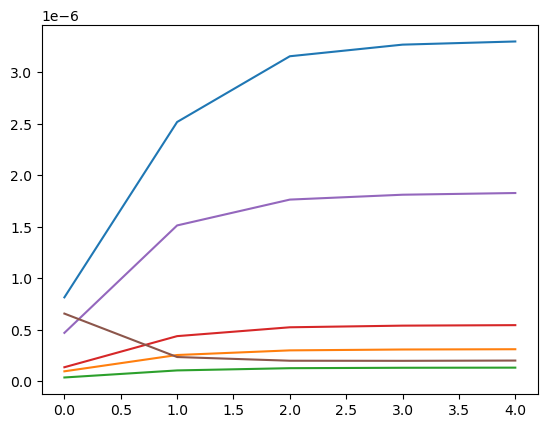

step: 0/1, D_loss: 0.11515898, G_loss_U: 4.082159, G_loss_S: 0.06963975, E_loss_t0: 1.9149487


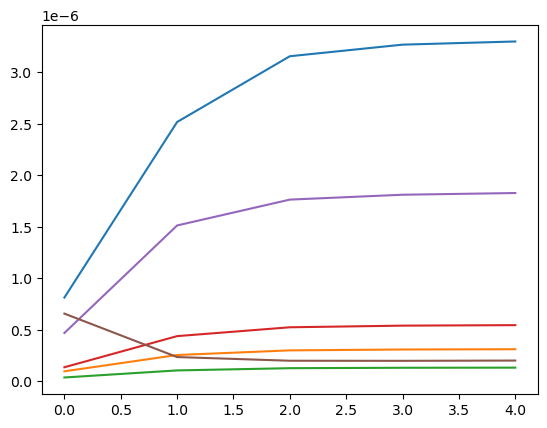

step: 0/1, D_loss: 0.11616686, G_loss_U: 4.082158, G_loss_S: 0.069665596, E_loss_t0: 1.971125


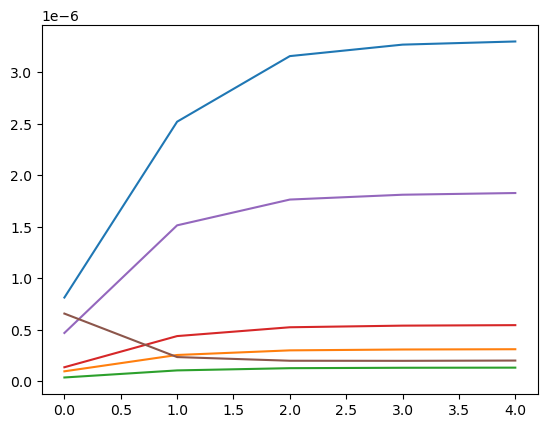

step: 0/1, D_loss: 0.11737083, G_loss_U: 4.0821576, G_loss_S: 0.06974384, E_loss_t0: 1.9306169


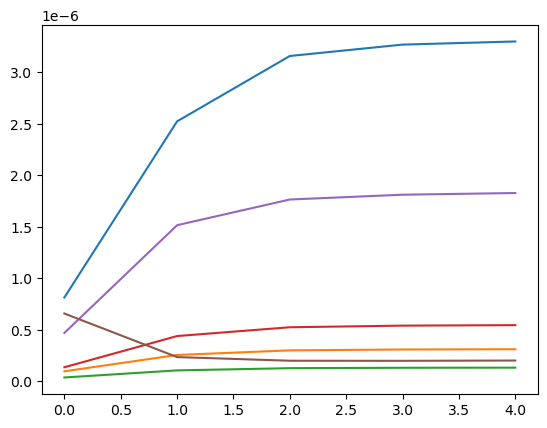

step: 0/1, D_loss: 0.11047129, G_loss_U: 4.082156, G_loss_S: 0.06978102, E_loss_t0: 1.5090144


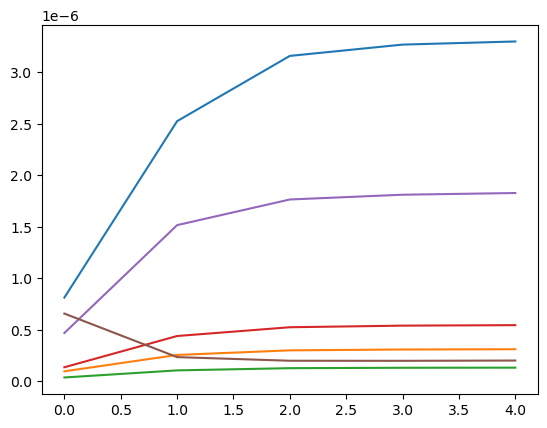

step: 0/1, D_loss: 0.11012381, G_loss_U: 4.082155, G_loss_S: 0.069658026, E_loss_t0: 1.778232


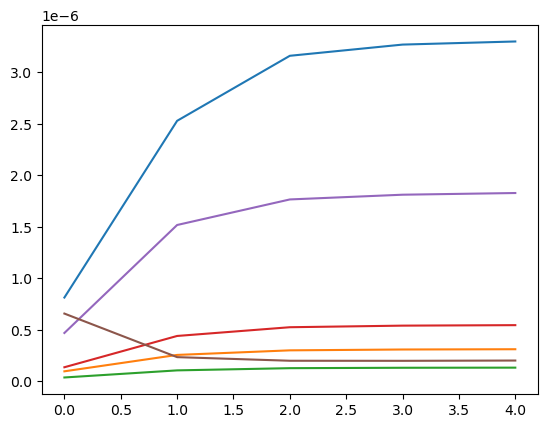

step: 0/1, D_loss: 0.12112651, G_loss_U: 4.082154, G_loss_S: 0.06959551, E_loss_t0: 2.1816223


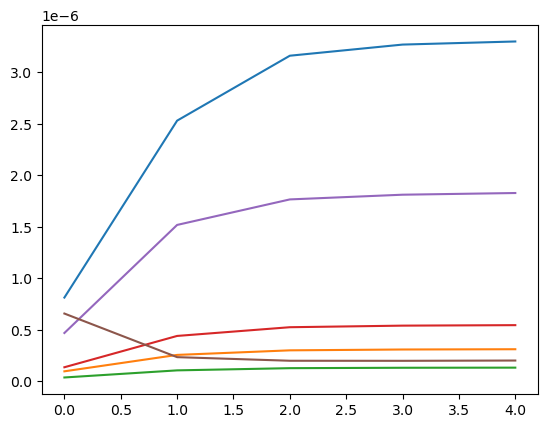

step: 0/1, D_loss: 0.11660896, G_loss_U: 4.082153, G_loss_S: 0.069633424, E_loss_t0: 1.9772059


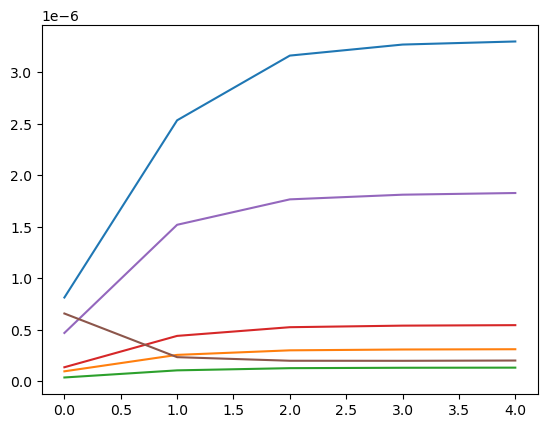

step: 0/1, D_loss: 0.110779375, G_loss_U: 4.082152, G_loss_S: 0.069643125, E_loss_t0: 1.7631686


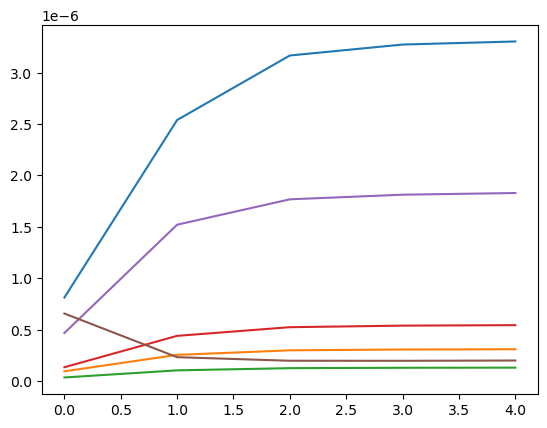

step: 0/1, D_loss: 0.12078465, G_loss_U: 4.0821514, G_loss_S: 0.0696206, E_loss_t0: 2.1149523


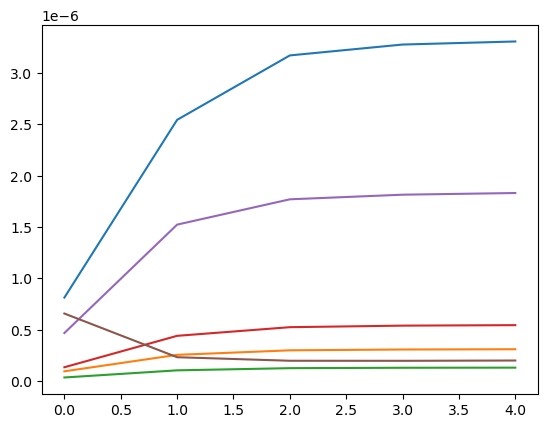

step: 0/1, D_loss: 0.11108507, G_loss_U: 4.0821505, G_loss_S: 0.06965621, E_loss_t0: 1.7812264


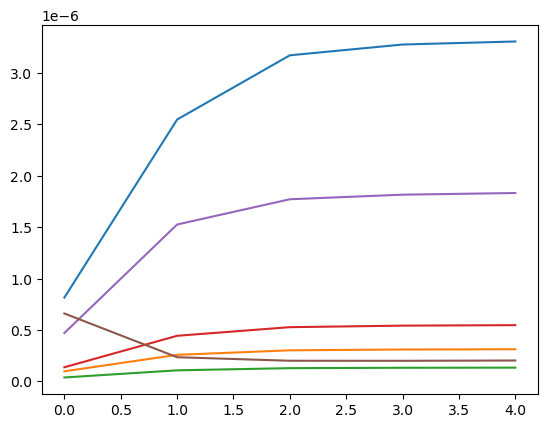

step: 0/1, D_loss: 0.114636764, G_loss_U: 4.0821495, G_loss_S: 0.069688775, E_loss_t0: 1.8308668


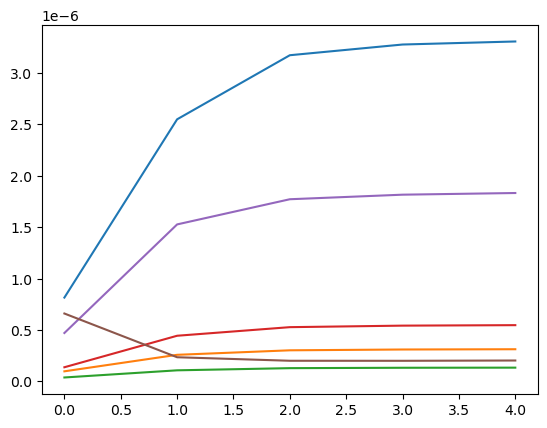

step: 0/1, D_loss: 0.12688634, G_loss_U: 4.0821486, G_loss_S: 0.06956954, E_loss_t0: 2.3256872


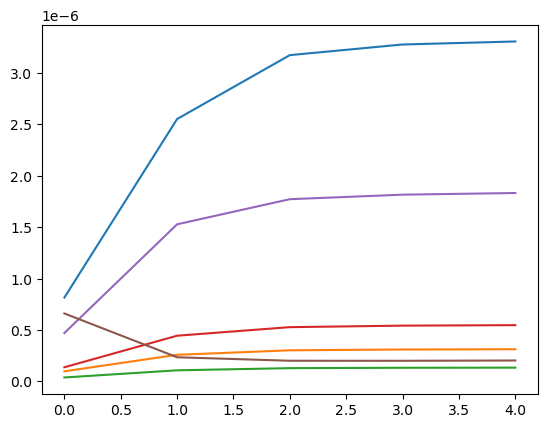

step: 0/1, D_loss: 0.11713669, G_loss_U: 4.0821476, G_loss_S: 0.070270196, E_loss_t0: 1.9560075


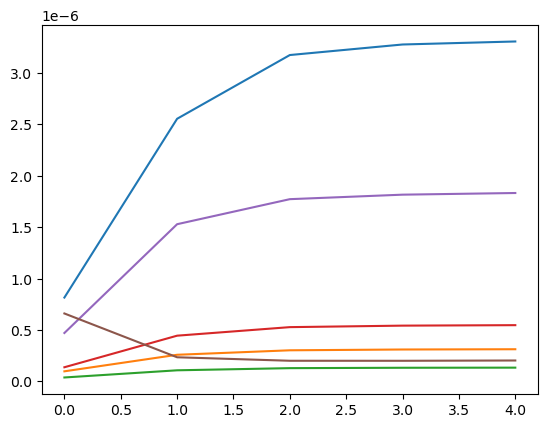

step: 0/1, D_loss: 0.11176834, G_loss_U: 4.0821466, G_loss_S: 0.0695858, E_loss_t0: 2.0039349


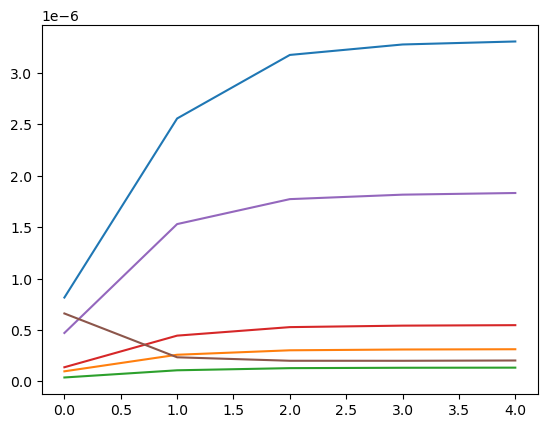

step: 0/1, D_loss: 0.111616686, G_loss_U: 4.082146, G_loss_S: 0.06964228, E_loss_t0: 1.8354554


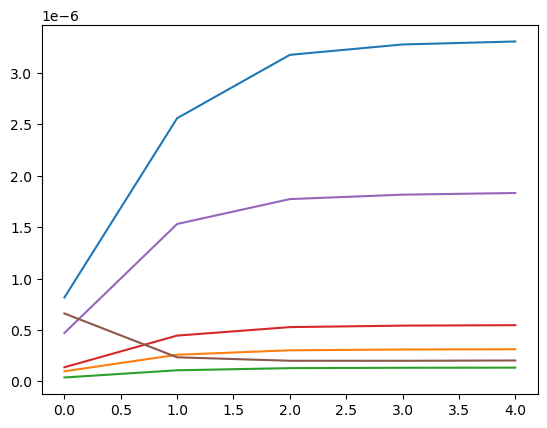

step: 0/1, D_loss: 0.115926415, G_loss_U: 4.0821447, G_loss_S: 0.06959856, E_loss_t0: 2.0452735


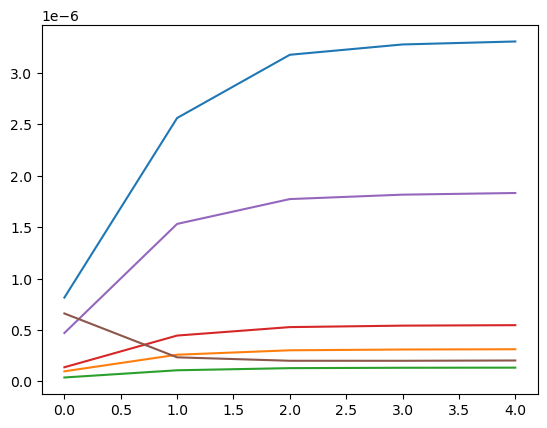

step: 0/1, D_loss: 0.123688154, G_loss_U: 4.0821443, G_loss_S: 0.06960395, E_loss_t0: 2.210273


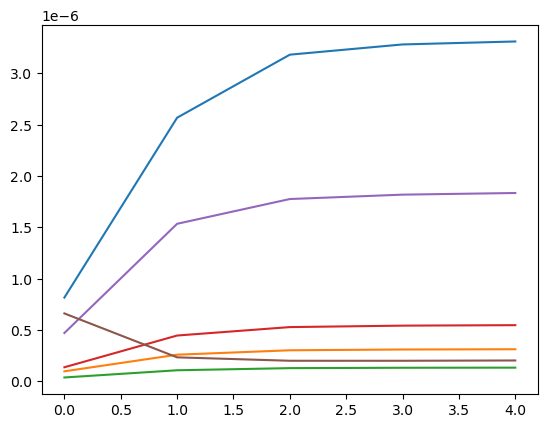

step: 0/1, D_loss: 0.110810295, G_loss_U: 4.082144, G_loss_S: 0.0696552, E_loss_t0: 1.6871117


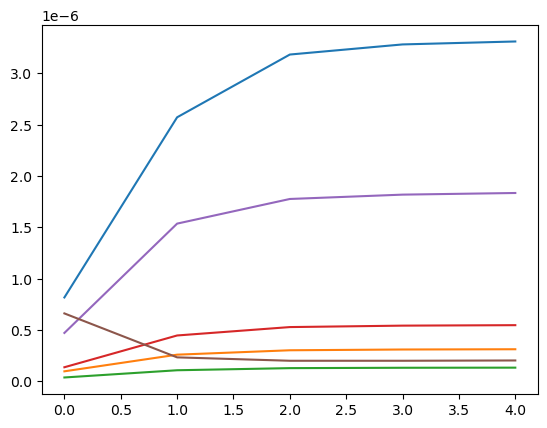

step: 0/1, D_loss: 0.11980575, G_loss_U: 4.0821424, G_loss_S: 0.06959773, E_loss_t0: 2.1120086


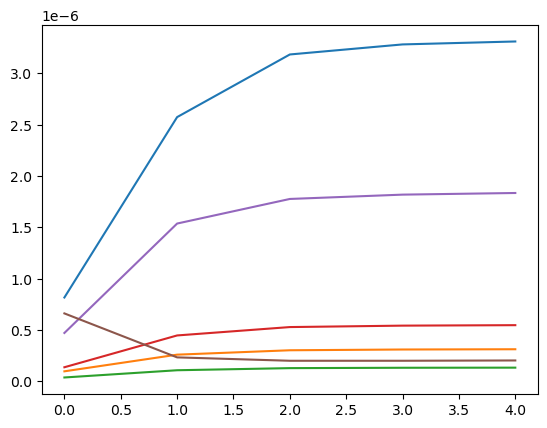

step: 0/1, D_loss: 0.115586065, G_loss_U: 4.082142, G_loss_S: 0.06958839, E_loss_t0: 2.0006661


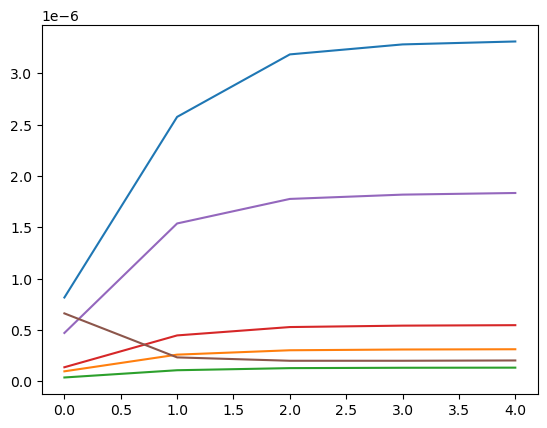

step: 0/1, D_loss: 0.11204467, G_loss_U: 4.0821404, G_loss_S: 0.069925025, E_loss_t0: 1.4647385


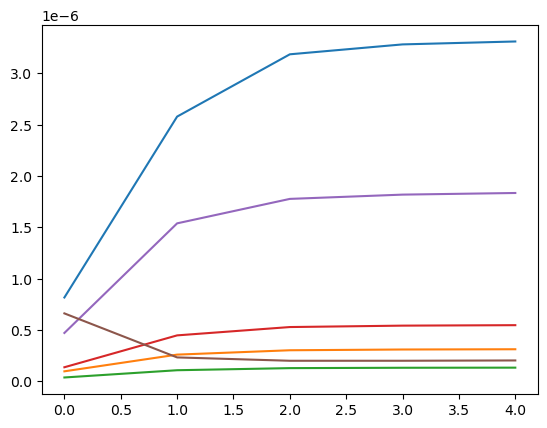

step: 0/1, D_loss: 0.11107199, G_loss_U: 4.0821395, G_loss_S: 0.069654785, E_loss_t0: 1.779531


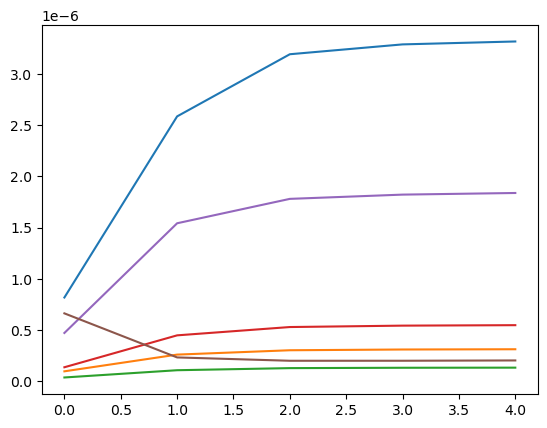

step: 0/1, D_loss: 0.10993082, G_loss_U: 4.0821395, G_loss_S: 0.06968288, E_loss_t0: 1.629093


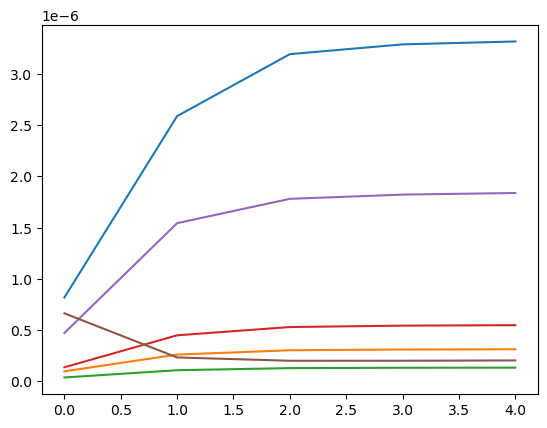

step: 0/1, D_loss: 0.12240337, G_loss_U: 4.0821385, G_loss_S: 0.0696028, E_loss_t0: 2.196849


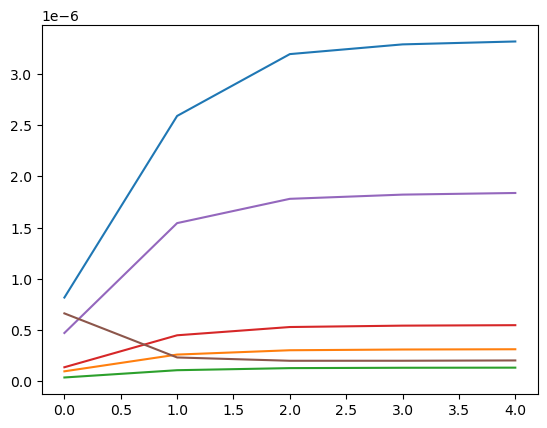

step: 0/1, D_loss: 0.11187265, G_loss_U: 4.0821376, G_loss_S: 0.0696723, E_loss_t0: 1.7254674


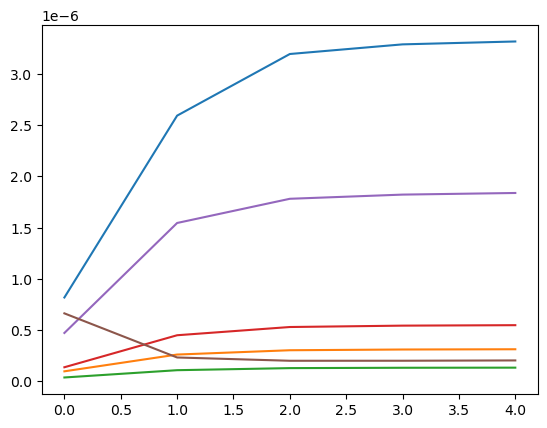

step: 0/1, D_loss: 0.1109159, G_loss_U: 4.082137, G_loss_S: 0.06963864, E_loss_t0: 1.7014276


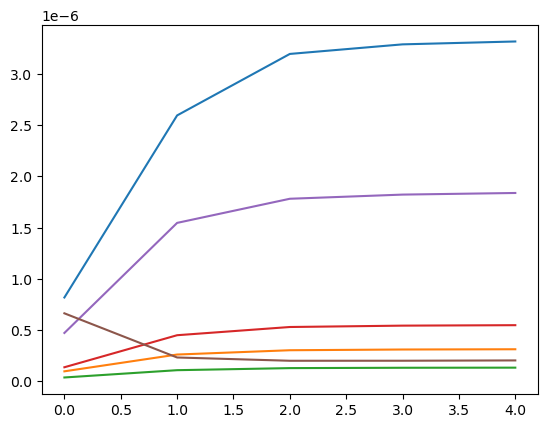

step: 0/1, D_loss: 0.109482855, G_loss_U: 4.0821357, G_loss_S: 0.069688424, E_loss_t0: 1.3482292


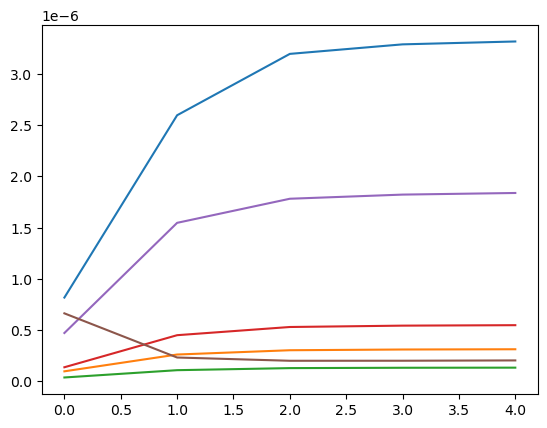

step: 0/1, D_loss: 0.12329687, G_loss_U: 4.082135, G_loss_S: 0.06949073, E_loss_t0: 2.3653646


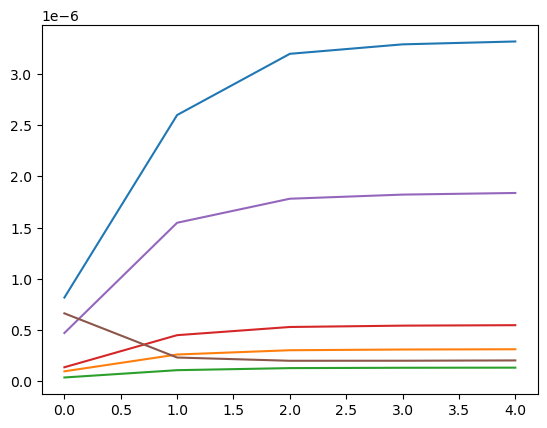

step: 0/1, D_loss: 0.117025144, G_loss_U: 4.0821342, G_loss_S: 0.06958511, E_loss_t0: 2.0477433


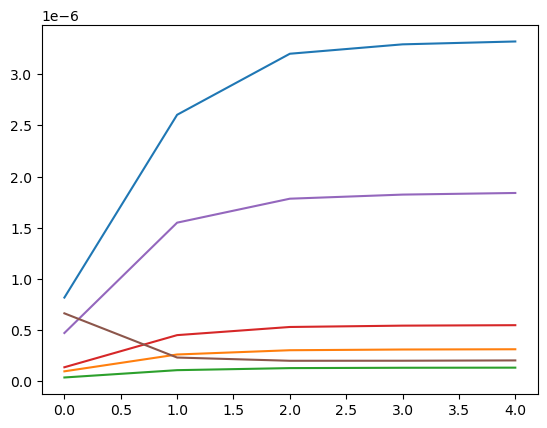

step: 0/1, D_loss: 0.109598175, G_loss_U: 4.082134, G_loss_S: 0.06979923, E_loss_t0: 1.2107322


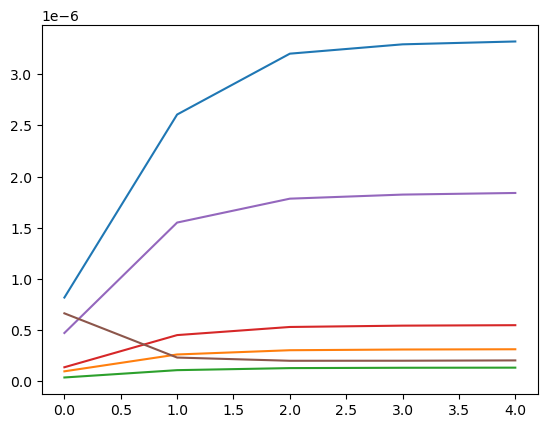

step: 0/1, D_loss: 0.112755746, G_loss_U: 4.0821323, G_loss_S: 0.06961554, E_loss_t0: 1.7862055


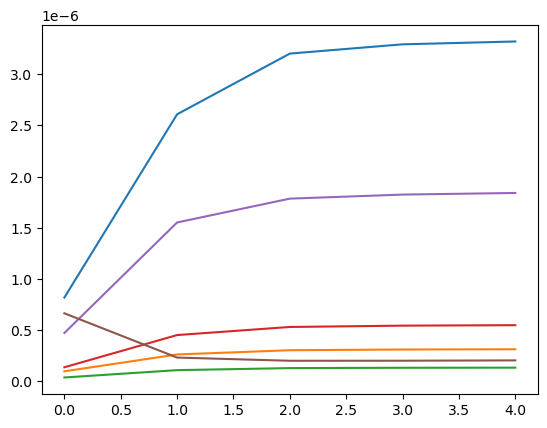

step: 0/1, D_loss: 0.11647963, G_loss_U: 4.082132, G_loss_S: 0.069651626, E_loss_t0: 2.1725333


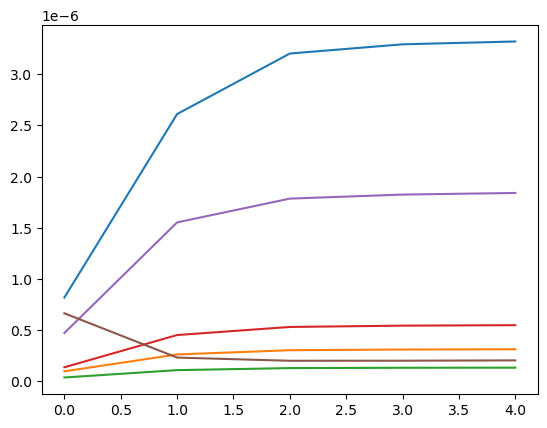

step: 0/1, D_loss: 0.11353758, G_loss_U: 4.082132, G_loss_S: 0.06956647, E_loss_t0: 1.9777522


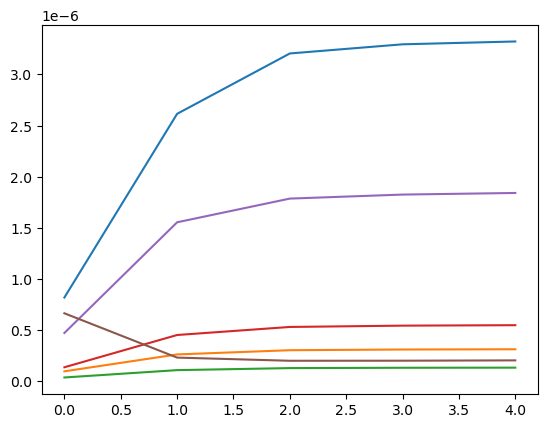

step: 0/1, D_loss: 0.11404511, G_loss_U: 4.082131, G_loss_S: 0.069587, E_loss_t0: 1.933143


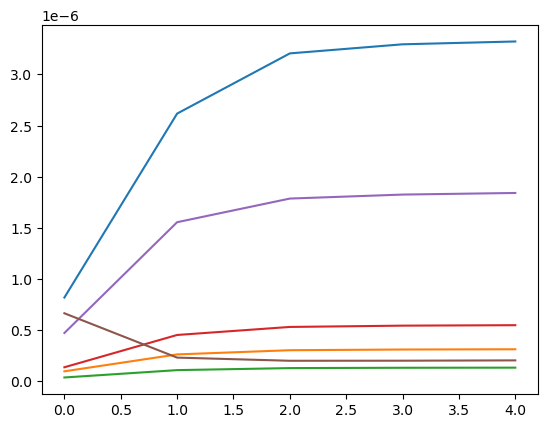

step: 0/1, D_loss: 0.11213447, G_loss_U: 4.08213, G_loss_S: 0.069624074, E_loss_t0: 1.8718665


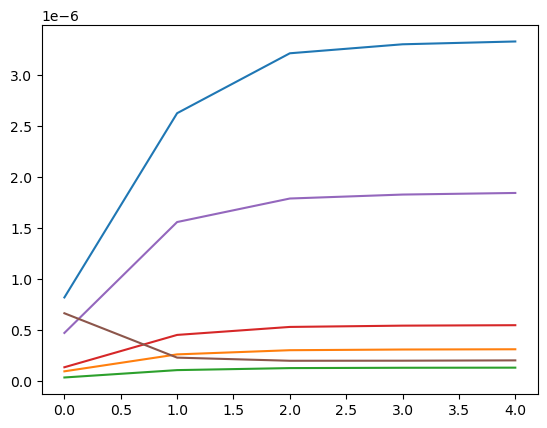

step: 0/1, D_loss: 0.10984295, G_loss_U: 4.082129, G_loss_S: 0.06985432, E_loss_t0: 1.2733053


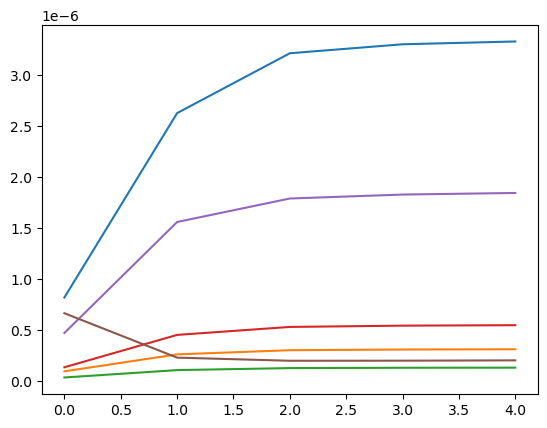

step: 0/1, D_loss: 0.117772385, G_loss_U: 4.0821285, G_loss_S: 0.069601744, E_loss_t0: 2.0327053


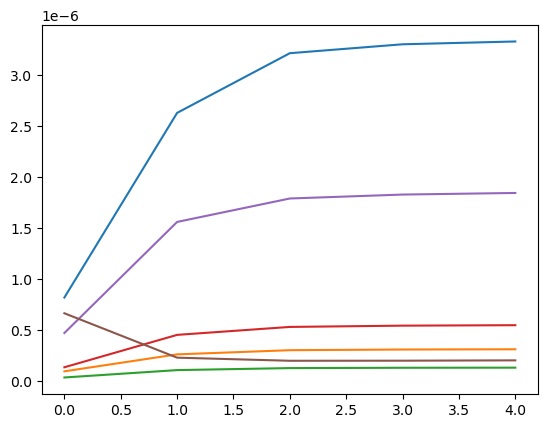

step: 0/1, D_loss: 0.111396775, G_loss_U: 4.082127, G_loss_S: 0.06959949, E_loss_t0: 1.8475188


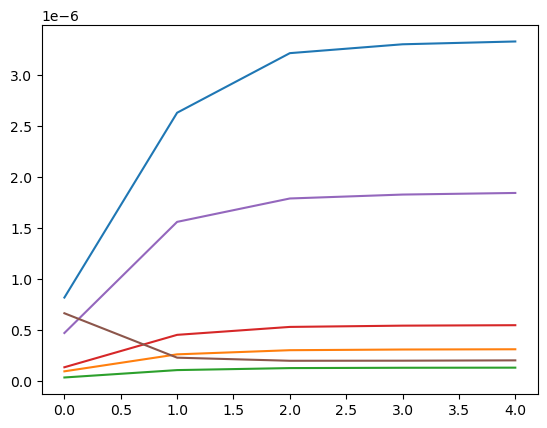

step: 0/1, D_loss: 0.11161126, G_loss_U: 4.082127, G_loss_S: 0.069591306, E_loss_t0: 1.887184


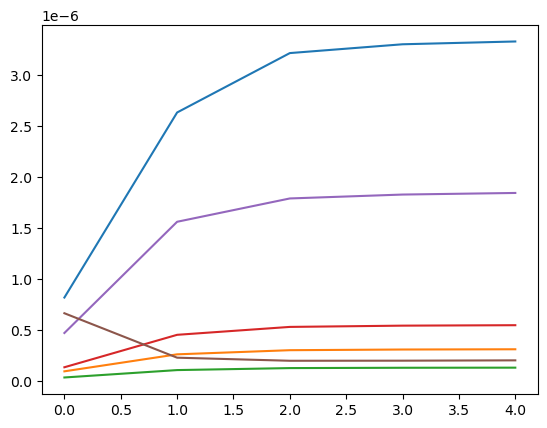

step: 0/1, D_loss: 0.113894954, G_loss_U: 4.0821257, G_loss_S: 0.06962716, E_loss_t0: 2.0260377


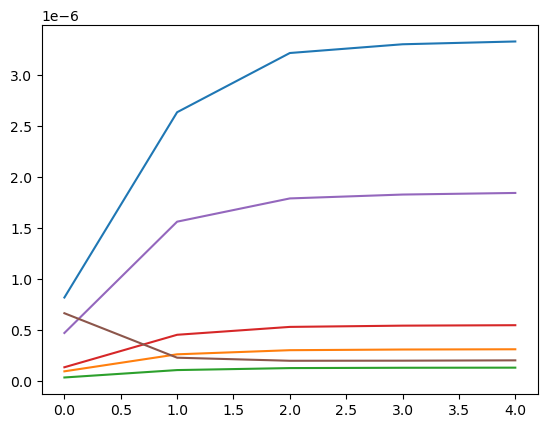

step: 0/1, D_loss: 0.11088329, G_loss_U: 4.082125, G_loss_S: 0.06975115, E_loss_t0: 1.3283386


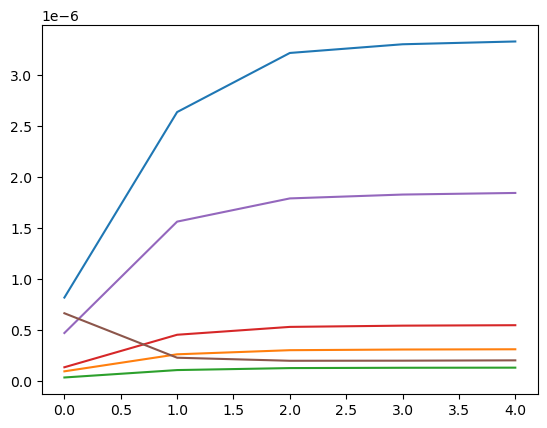

step: 0/1, D_loss: 0.11249916, G_loss_U: 4.0821247, G_loss_S: 0.069599785, E_loss_t0: 1.9012762


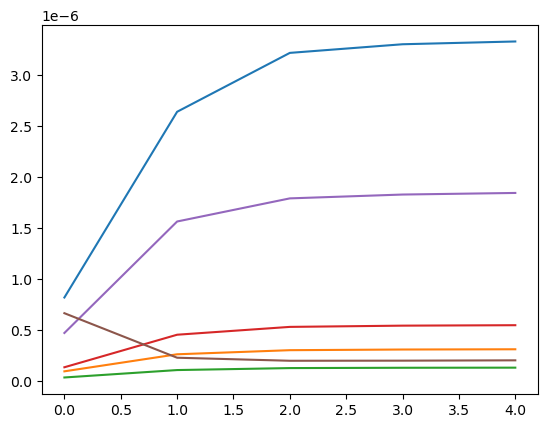

step: 0/1, D_loss: 0.11379242, G_loss_U: 4.082124, G_loss_S: 0.06952503, E_loss_t0: 2.0649166


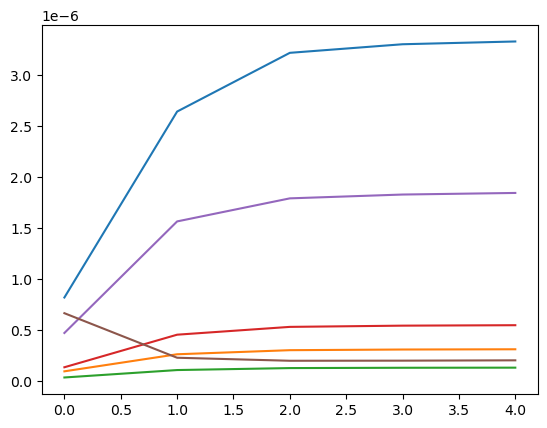

step: 0/1, D_loss: 0.11006812, G_loss_U: 4.0821233, G_loss_S: 0.069627725, E_loss_t0: 1.6258563


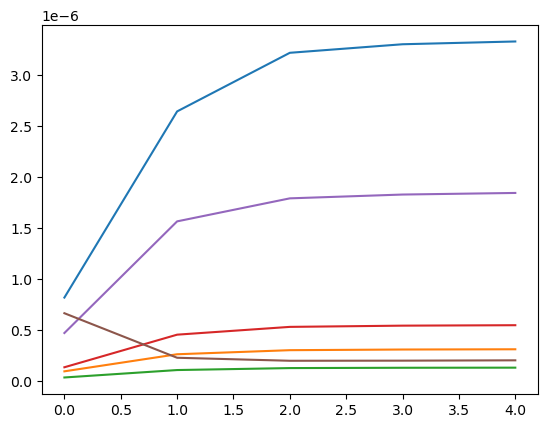

step: 0/1, D_loss: 0.111439124, G_loss_U: 4.082123, G_loss_S: 0.06960365, E_loss_t0: 1.7804898


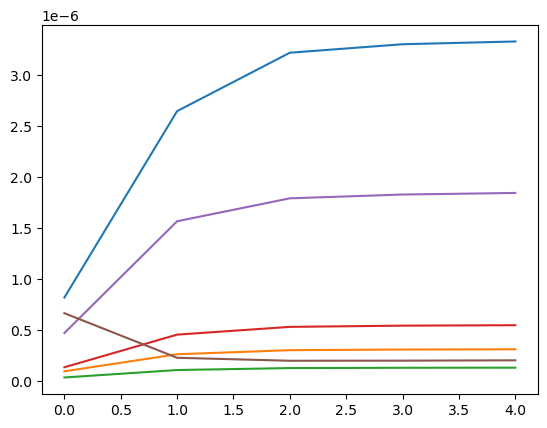

step: 0/1, D_loss: 0.110415086, G_loss_U: 4.0821223, G_loss_S: 0.06966677, E_loss_t0: 1.6008372


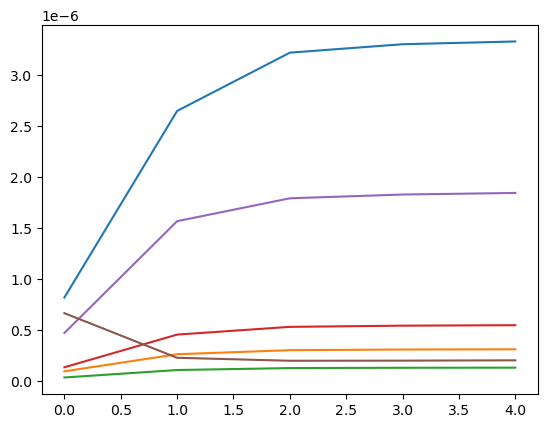

step: 0/1, D_loss: 0.12137237, G_loss_U: 4.082121, G_loss_S: 0.06958803, E_loss_t0: 2.0141556


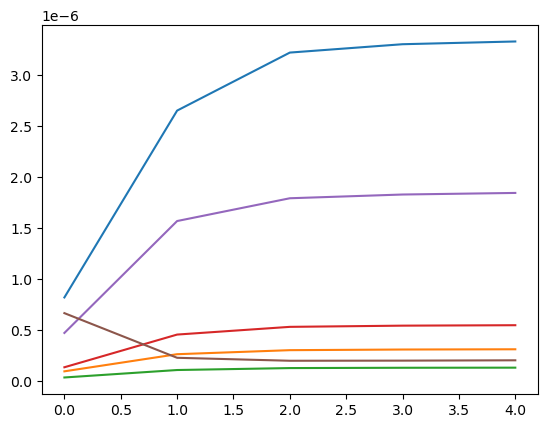

step: 0/1, D_loss: 0.112275735, G_loss_U: 4.082121, G_loss_S: 0.06961193, E_loss_t0: 1.8170972


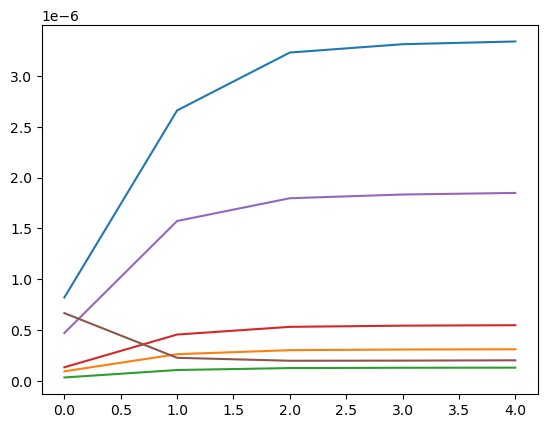

step: 0/1, D_loss: 0.12413211, G_loss_U: 4.08212, G_loss_S: 0.06962735, E_loss_t0: 2.1970987


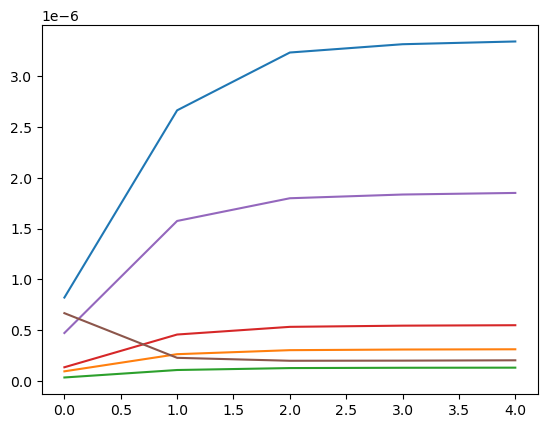

step: 0/1, D_loss: 0.11118399, G_loss_U: 4.082119, G_loss_S: 0.069549, E_loss_t0: 1.8521458


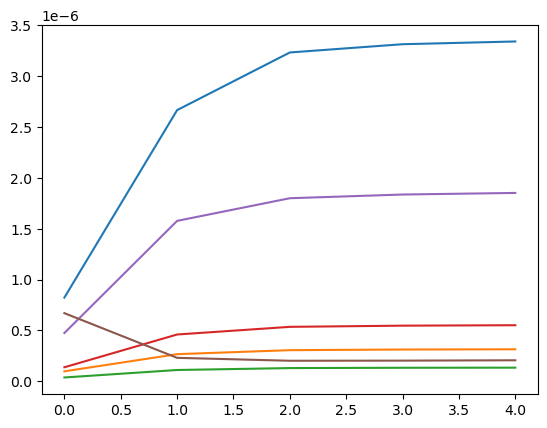

step: 0/1, D_loss: 0.11547584, G_loss_U: 4.082118, G_loss_S: 0.06954093, E_loss_t0: 2.0196774


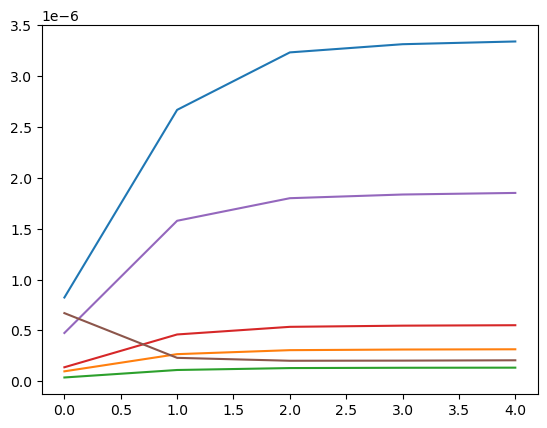

step: 0/1, D_loss: 0.12256235, G_loss_U: 4.082118, G_loss_S: 0.06950371, E_loss_t0: 2.2780964


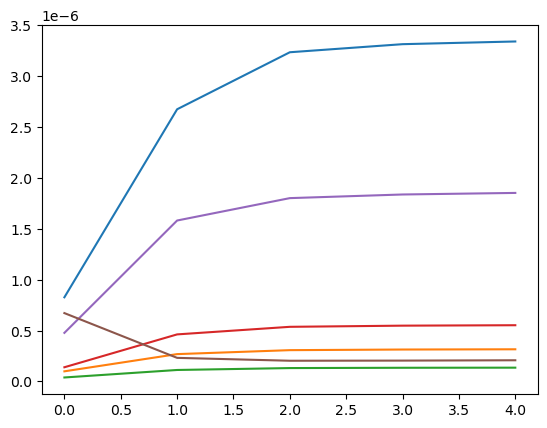

step: 0/1, D_loss: 0.12067994, G_loss_U: 4.082117, G_loss_S: 0.06953903, E_loss_t0: 2.101373


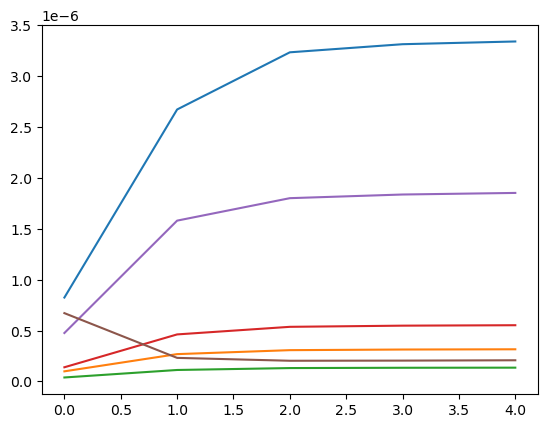

step: 0/1, D_loss: 0.12229174, G_loss_U: 4.082116, G_loss_S: 0.06992545, E_loss_t0: 2.070732


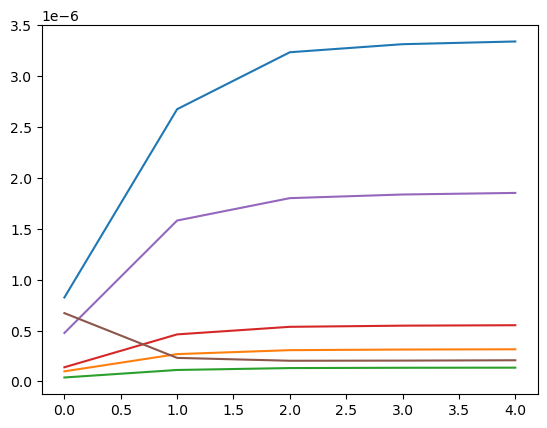

step: 0/1, D_loss: 0.11321973, G_loss_U: 4.0821157, G_loss_S: 0.06950196, E_loss_t0: 2.034861


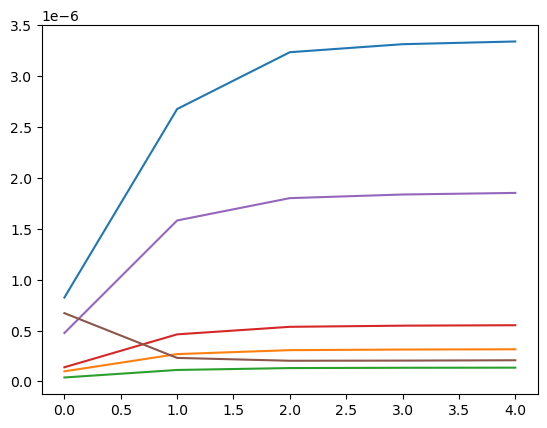

step: 0/1, D_loss: 0.12658958, G_loss_U: 4.0821157, G_loss_S: 0.0694762, E_loss_t0: 2.3460846


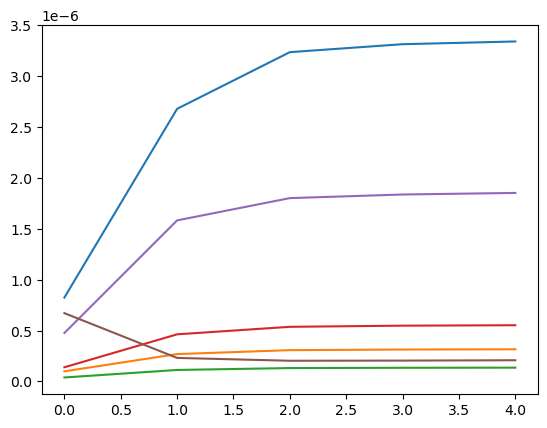

step: 0/1, D_loss: 0.11771291, G_loss_U: 4.082115, G_loss_S: 0.069522336, E_loss_t0: 2.1144543


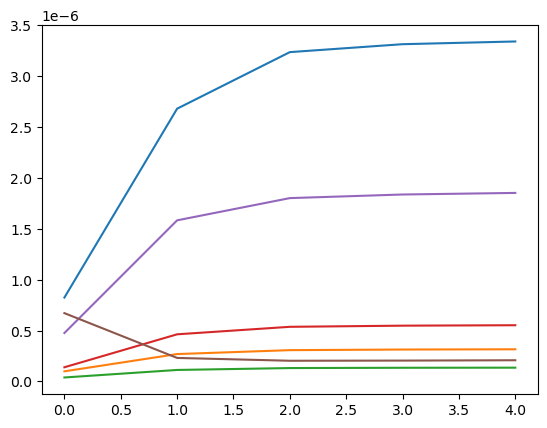

step: 0/1, D_loss: 0.11063585, G_loss_U: 4.082114, G_loss_S: 0.069597274, E_loss_t0: 1.5915738


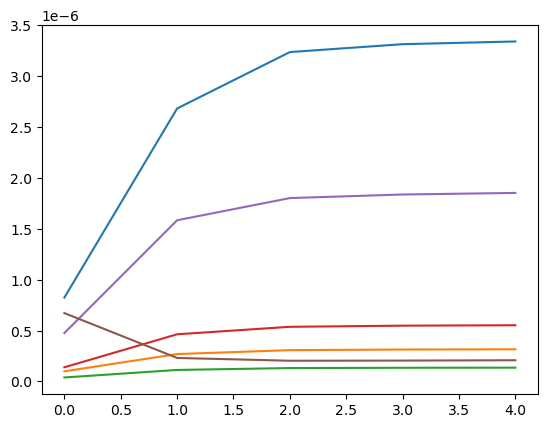

step: 0/1, D_loss: 0.11339747, G_loss_U: 4.0821133, G_loss_S: 0.06955257, E_loss_t0: 1.9556284


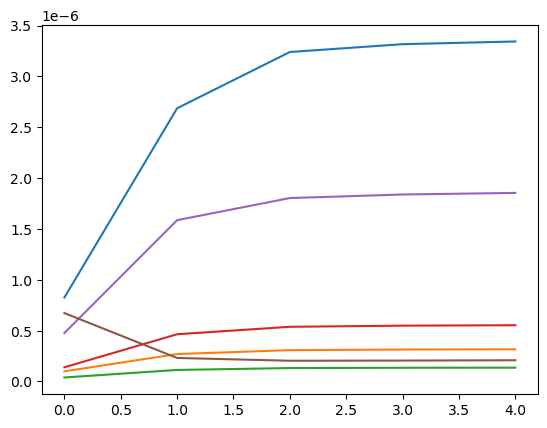

step: 0/1, D_loss: 0.12359675, G_loss_U: 4.082113, G_loss_S: 0.06954512, E_loss_t0: 2.1730604


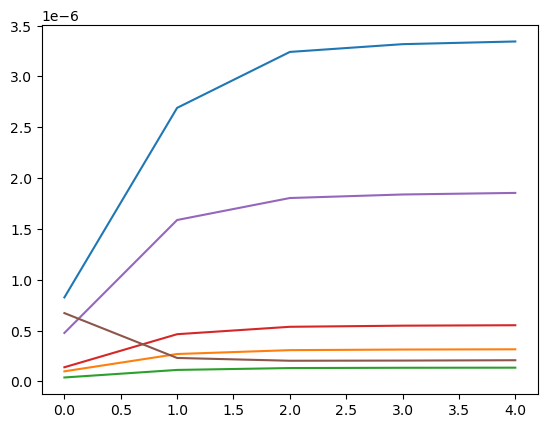

step: 0/1, D_loss: 0.12199177, G_loss_U: 4.082112, G_loss_S: 0.06953102, E_loss_t0: 2.164061


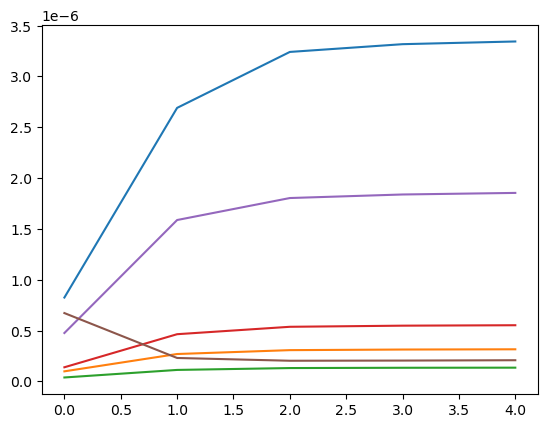

step: 0/1, D_loss: 0.114252344, G_loss_U: 4.082112, G_loss_S: 0.0695108, E_loss_t0: 2.010038


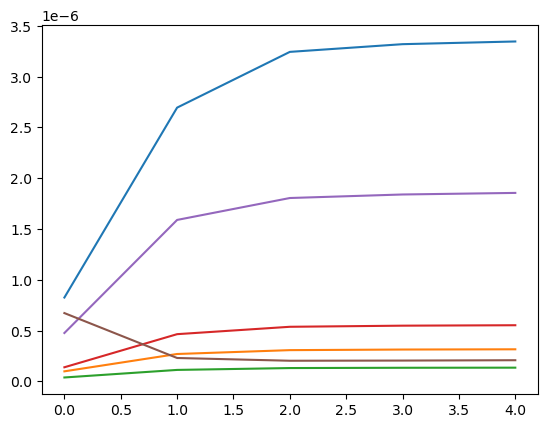

step: 0/1, D_loss: 0.10983357, G_loss_U: 4.0821104, G_loss_S: 0.06955909, E_loss_t0: 1.6907809


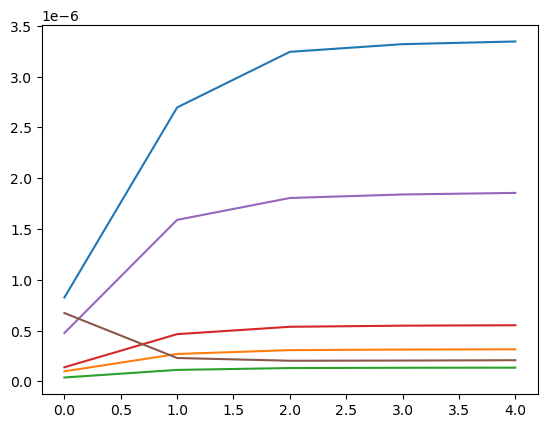

step: 0/1, D_loss: 0.11829536, G_loss_U: 4.0821095, G_loss_S: 0.06956028, E_loss_t0: 1.9895858


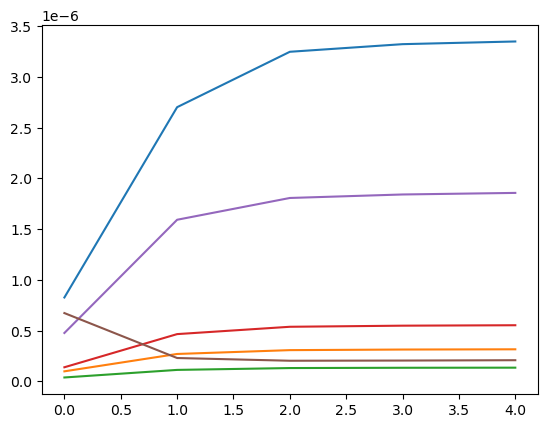

step: 0/1, D_loss: 0.12650336, G_loss_U: 4.0821095, G_loss_S: 0.06946383, E_loss_t0: 2.3396132


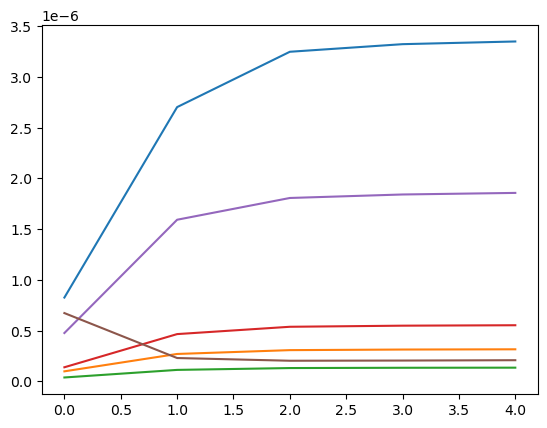

step: 0/1, D_loss: 0.1102662, G_loss_U: 4.082109, G_loss_S: 0.06965834, E_loss_t0: 1.4661704


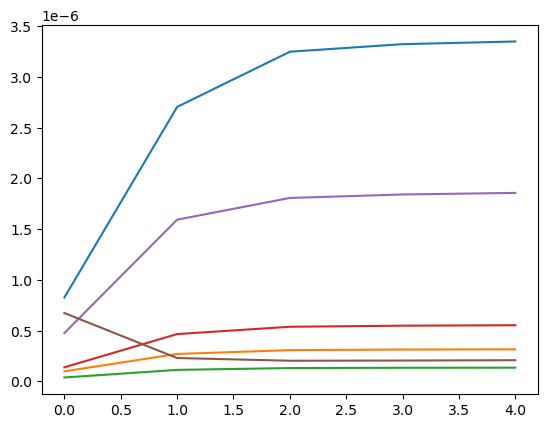

step: 0/1, D_loss: 0.10977391, G_loss_U: 4.082109, G_loss_S: 0.06956158, E_loss_t0: 1.5973231


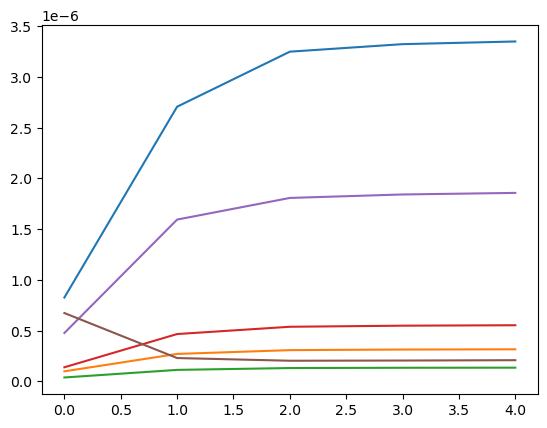

step: 0/1, D_loss: 0.1220383, G_loss_U: 4.0821075, G_loss_S: 0.06949303, E_loss_t0: 2.1751301


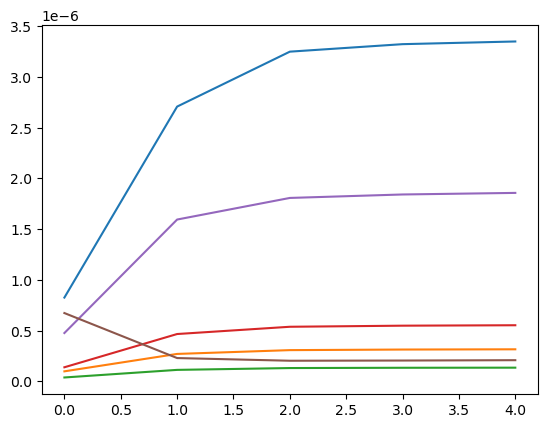

step: 0/1, D_loss: 0.11097211, G_loss_U: 4.082107, G_loss_S: 0.06964323, E_loss_t0: 1.3300934


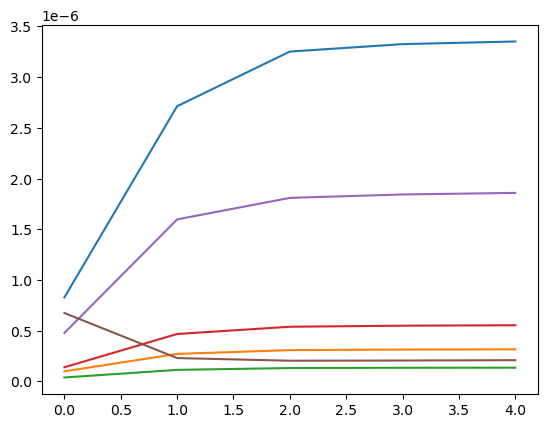

step: 0/1, D_loss: 0.1100088, G_loss_U: 4.0821066, G_loss_S: 0.06954691, E_loss_t0: 1.6029648


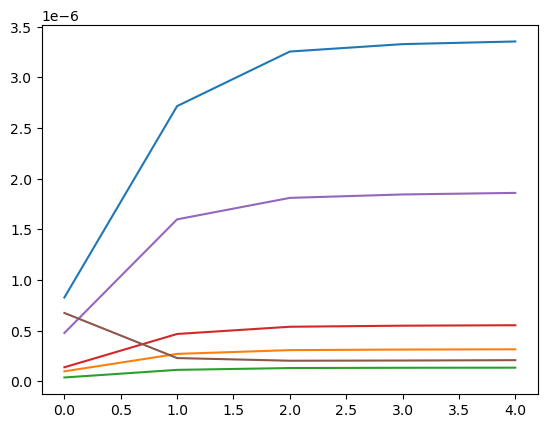

step: 0/1, D_loss: 0.10923668, G_loss_U: 4.082106, G_loss_S: 0.0696618, E_loss_t0: 1.5193948


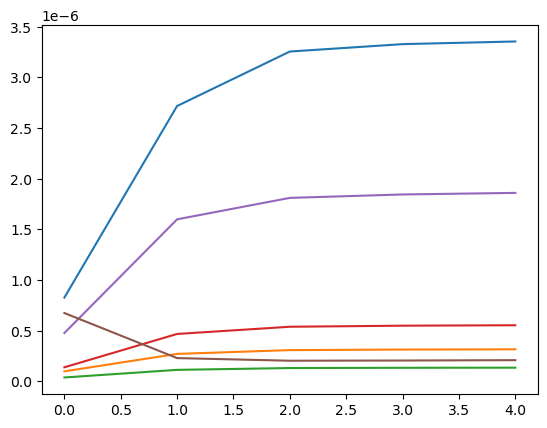

step: 0/1, D_loss: 0.10971086, G_loss_U: 4.0821056, G_loss_S: 0.06955875, E_loss_t0: 1.5785723


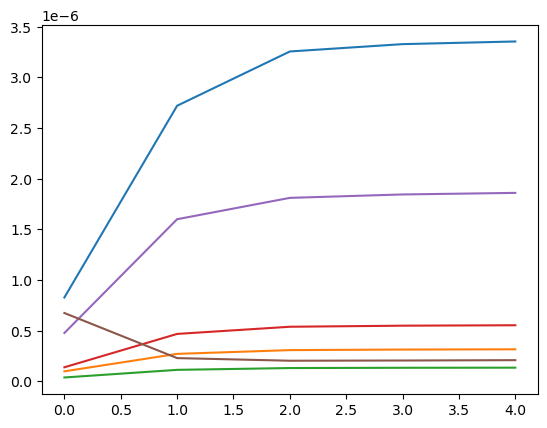

step: 0/1, D_loss: 0.11180282, G_loss_U: 4.0821047, G_loss_S: 0.06953942, E_loss_t0: 1.7672617


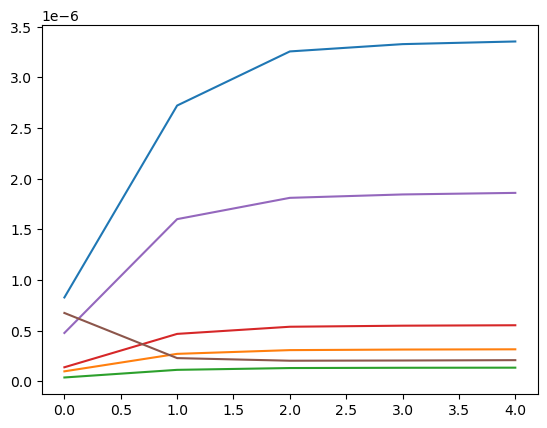

step: 0/1, D_loss: 0.109865576, G_loss_U: 4.082104, G_loss_S: 0.06964431, E_loss_t0: 1.2520975


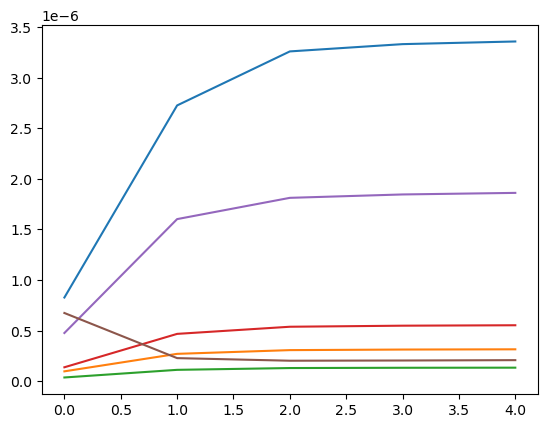

step: 0/1, D_loss: 0.13372119, G_loss_U: 4.0821037, G_loss_S: 0.06967007, E_loss_t0: 2.430035


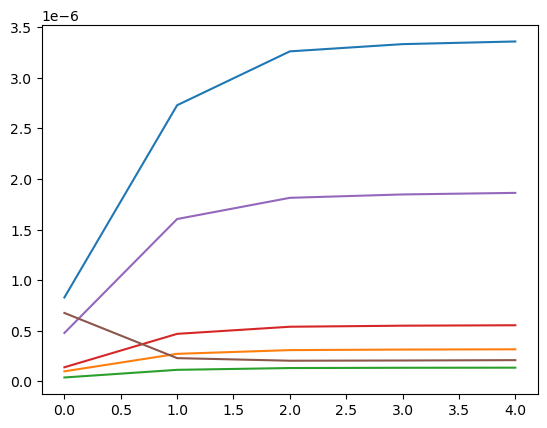

step: 0/1, D_loss: 0.1094624, G_loss_U: 4.0821037, G_loss_S: 0.069557674, E_loss_t0: 1.518689


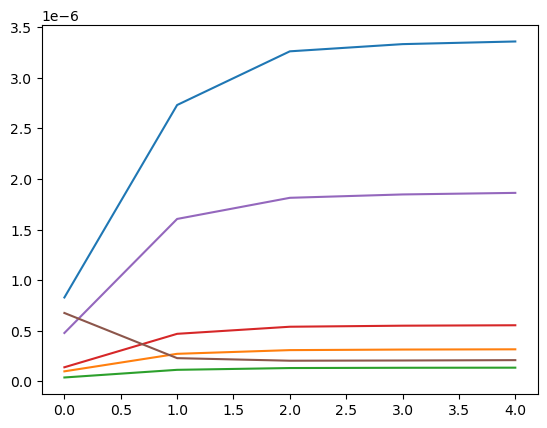

step: 0/1, D_loss: 0.11021831, G_loss_U: 4.082103, G_loss_S: 0.06962765, E_loss_t0: 1.390014


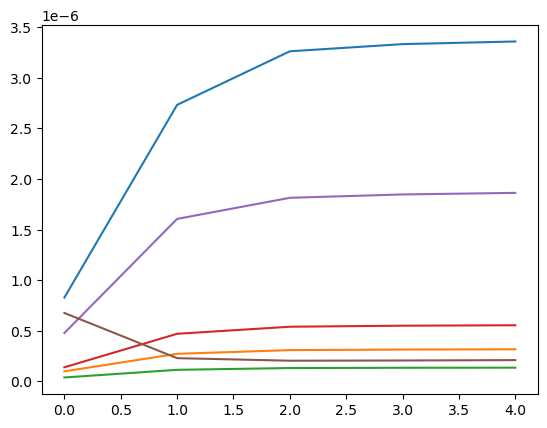

step: 0/1, D_loss: 0.112402335, G_loss_U: 4.082102, G_loss_S: 0.06955258, E_loss_t0: 1.8346356


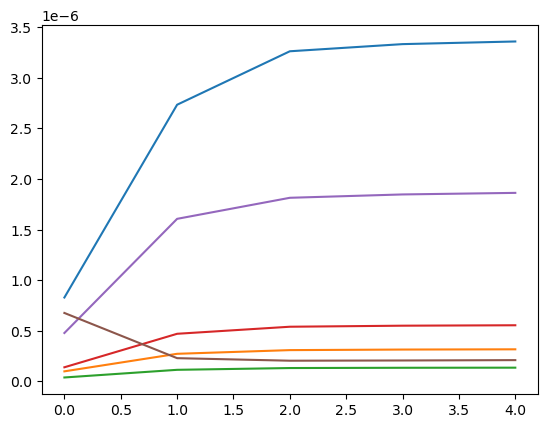

step: 0/1, D_loss: 0.12173198, G_loss_U: 4.0821013, G_loss_S: 0.06945793, E_loss_t0: 2.2652946


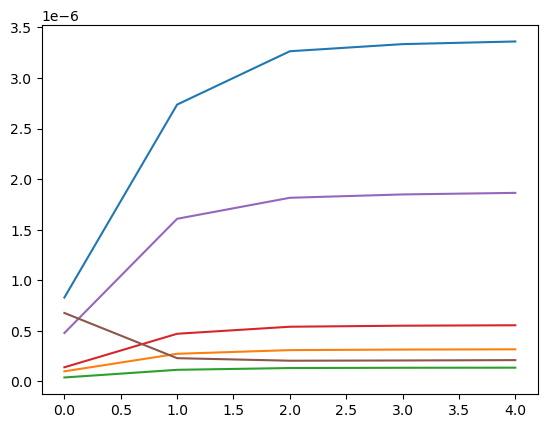

step: 0/1, D_loss: 0.11095235, G_loss_U: 4.0821013, G_loss_S: 0.069633156, E_loss_t0: 1.2279652


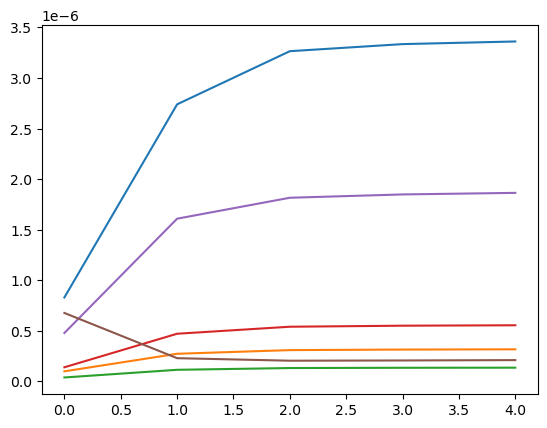

step: 0/1, D_loss: 0.11681351, G_loss_U: 4.082101, G_loss_S: 0.06975107, E_loss_t0: 1.867154


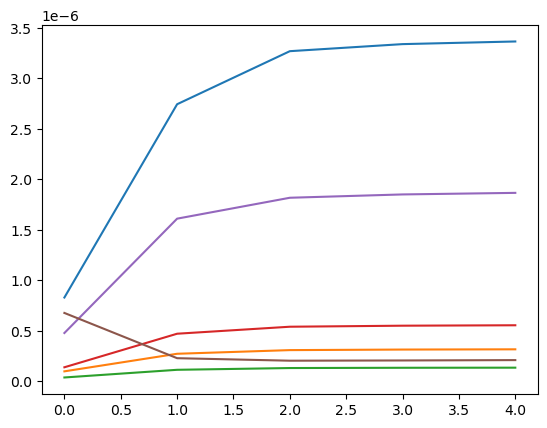

step: 0/1, D_loss: 0.11290492, G_loss_U: 4.0821004, G_loss_S: 0.069854096, E_loss_t0: 1.7220657


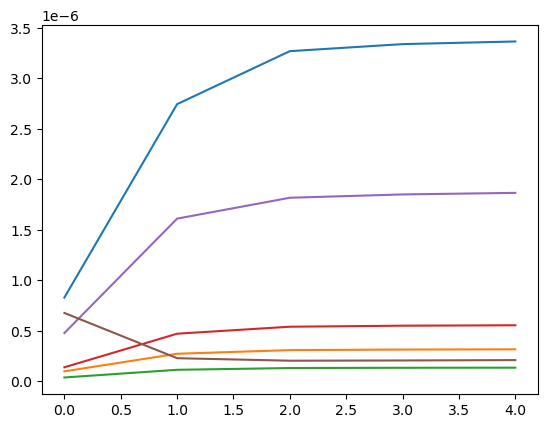

step: 0/1, D_loss: 0.13472742, G_loss_U: 4.0820994, G_loss_S: 0.069469035, E_loss_t0: 2.380495


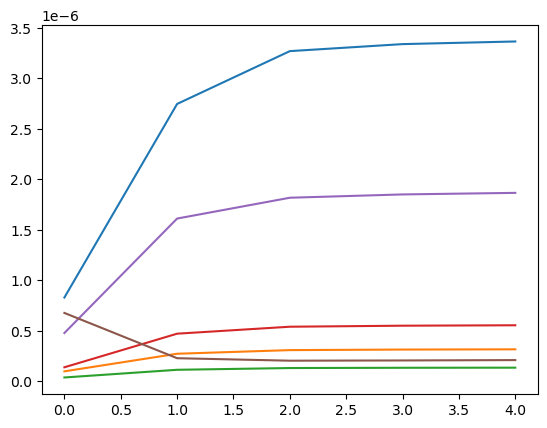

step: 0/1, D_loss: 0.10966022, G_loss_U: 4.0820985, G_loss_S: 0.06954549, E_loss_t0: 1.621382


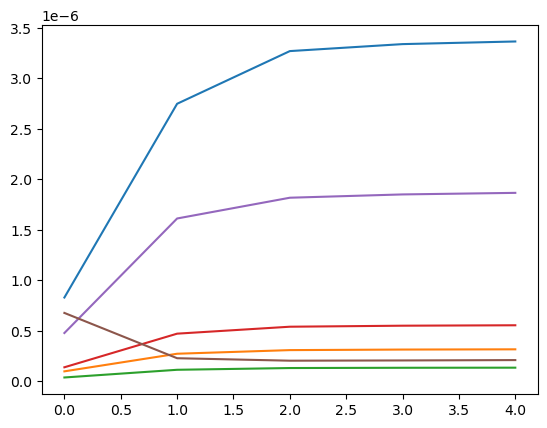

step: 0/1, D_loss: 0.10972896, G_loss_U: 4.082098, G_loss_S: 0.069538355, E_loss_t0: 1.6804128


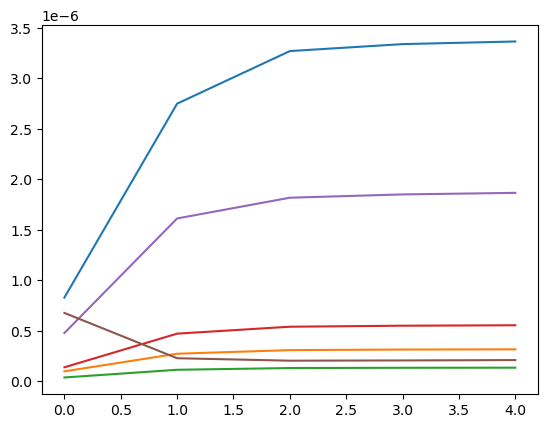

step: 0/1, D_loss: 0.12489265, G_loss_U: 4.082098, G_loss_S: 0.069475606, E_loss_t0: 2.2151542


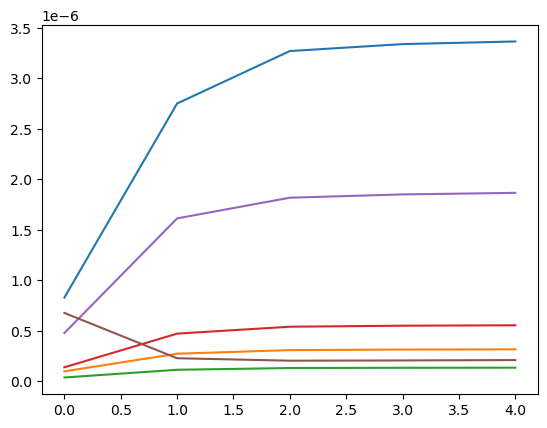

step: 0/1, D_loss: 0.123476565, G_loss_U: 4.082097, G_loss_S: 0.06955429, E_loss_t0: 2.2061067


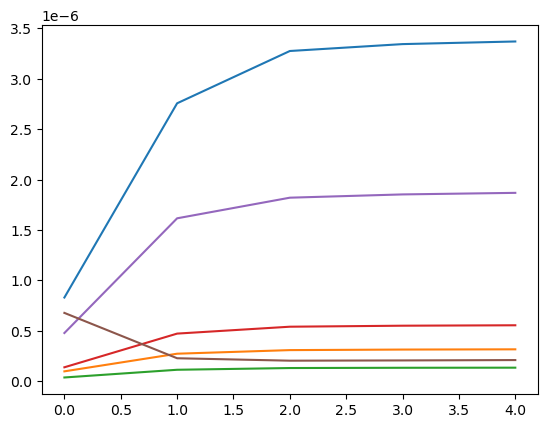

step: 0/1, D_loss: 0.119423114, G_loss_U: 4.082097, G_loss_S: 0.069490455, E_loss_t0: 2.1463244


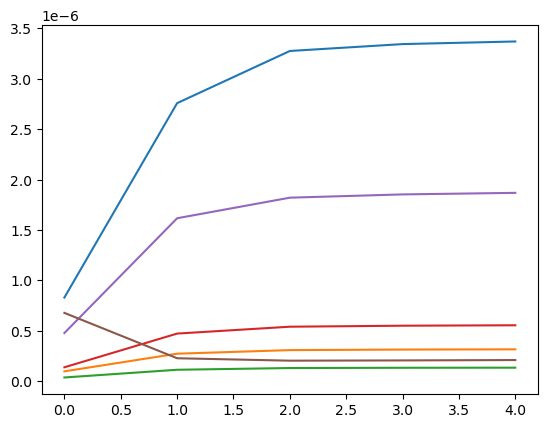

step: 0/1, D_loss: 0.11230004, G_loss_U: 4.082096, G_loss_S: 0.06975362, E_loss_t0: 1.6343976


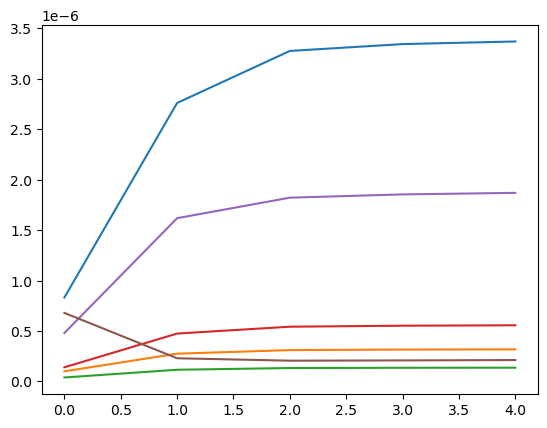

step: 0/1, D_loss: 0.11591694, G_loss_U: 4.082095, G_loss_S: 0.069475815, E_loss_t0: 1.9044936


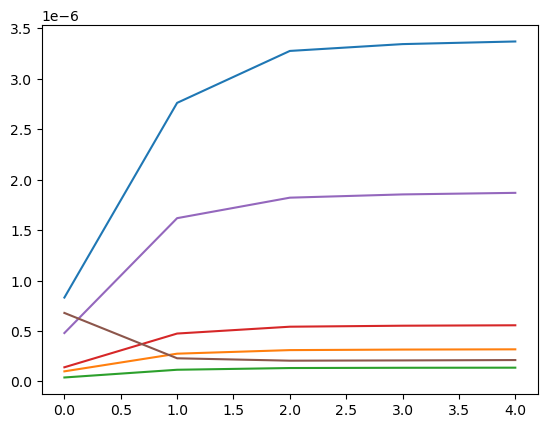

step: 0/1, D_loss: 0.111294486, G_loss_U: 4.082095, G_loss_S: 0.069633886, E_loss_t0: 1.830794


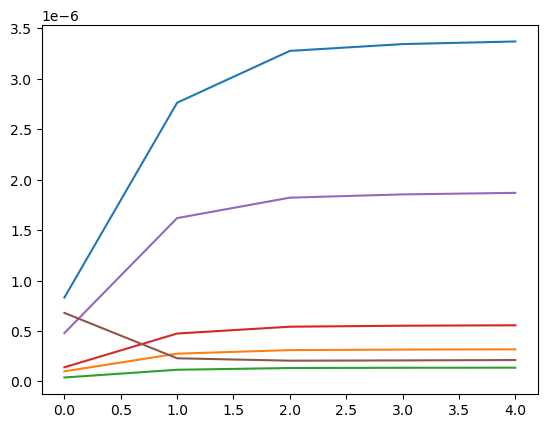

step: 0/1, D_loss: 0.11520792, G_loss_U: 4.082094, G_loss_S: 0.06977477, E_loss_t0: 1.9461653


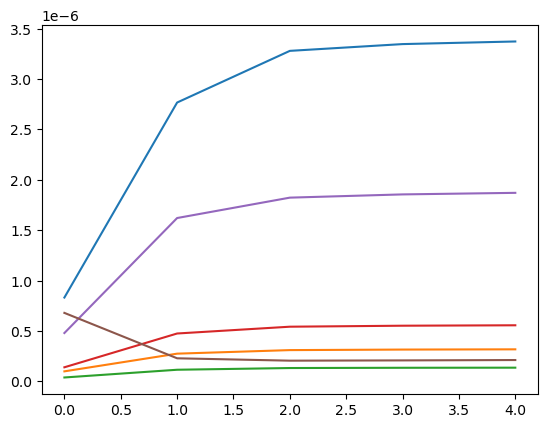

step: 0/1, D_loss: 0.11890258, G_loss_U: 4.0820937, G_loss_S: 0.069477595, E_loss_t0: 2.0718336


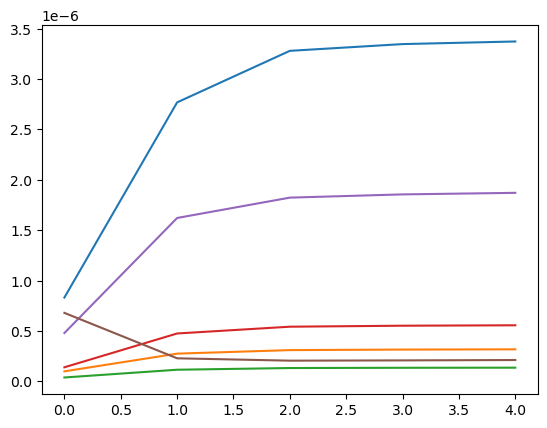

step: 0/1, D_loss: 0.11008765, G_loss_U: 4.0820932, G_loss_S: 0.06956085, E_loss_t0: 1.2578756


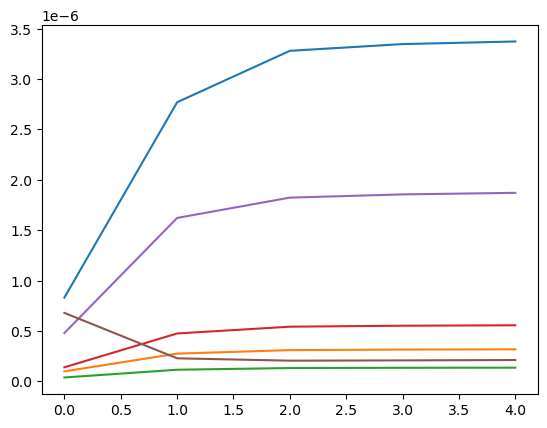

step: 0/1, D_loss: 0.11609374, G_loss_U: 4.082093, G_loss_S: 0.06945808, E_loss_t0: 2.0372894


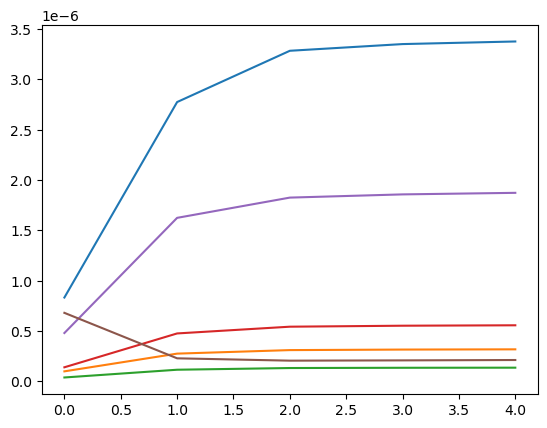

step: 0/1, D_loss: 0.122876, G_loss_U: 4.0820923, G_loss_S: 0.069482975, E_loss_t0: 2.1358151


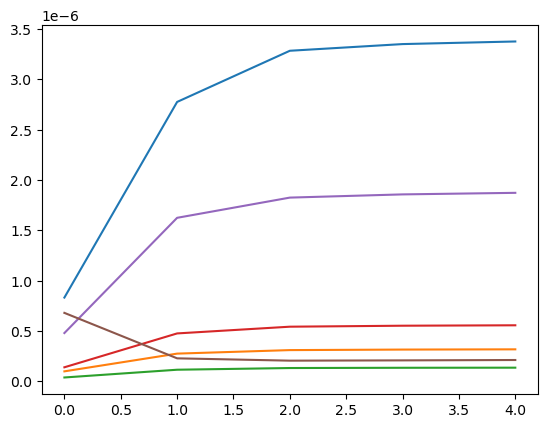

step: 0/1, D_loss: 0.112976246, G_loss_U: 4.082092, G_loss_S: 0.06951218, E_loss_t0: 1.8982334


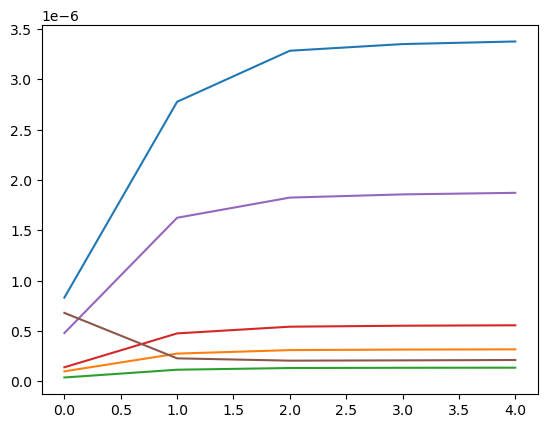

step: 0/1, D_loss: 0.117204025, G_loss_U: 4.082092, G_loss_S: 0.06941282, E_loss_t0: 2.1664286


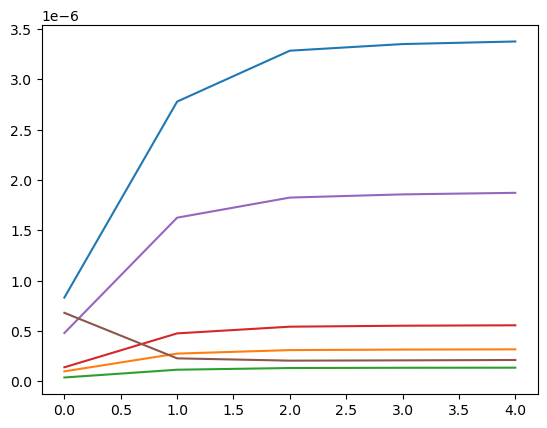

step: 0/1, D_loss: 0.11758615, G_loss_U: 4.0820904, G_loss_S: 0.069463775, E_loss_t0: 2.0128322


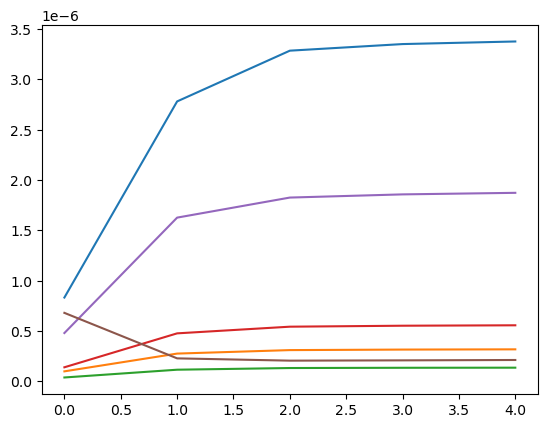

step: 0/1, D_loss: 0.11774452, G_loss_U: 4.0820904, G_loss_S: 0.069516756, E_loss_t0: 1.998419


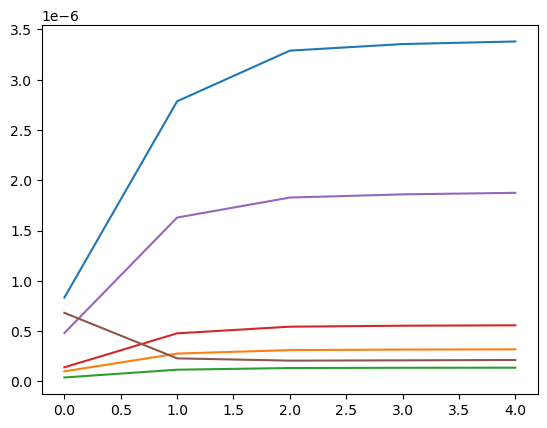

step: 0/1, D_loss: 0.10943501, G_loss_U: 4.08209, G_loss_S: 0.069521844, E_loss_t0: 1.350481


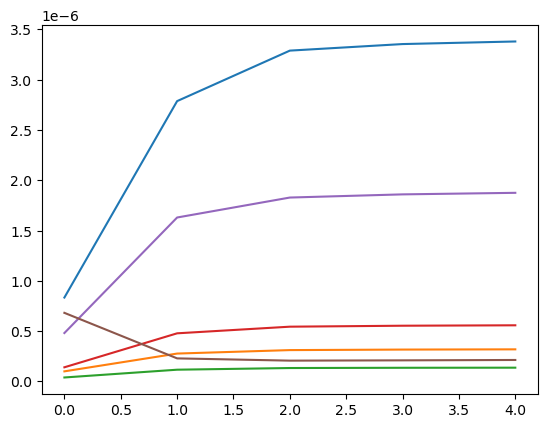

step: 0/1, D_loss: 0.1105532, G_loss_U: 4.0820894, G_loss_S: 0.069558375, E_loss_t0: 1.4236424


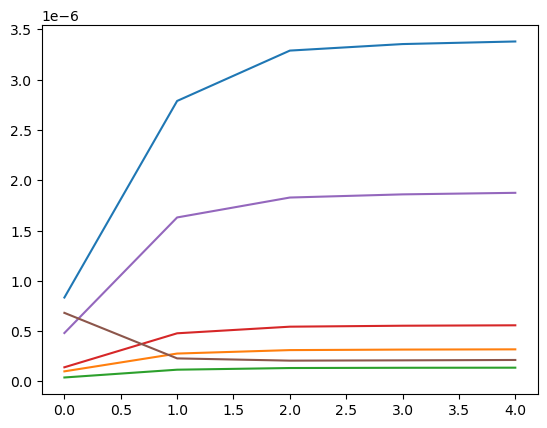

step: 0/1, D_loss: 0.13013199, G_loss_U: 4.0820894, G_loss_S: 0.069431424, E_loss_t0: 2.3437576


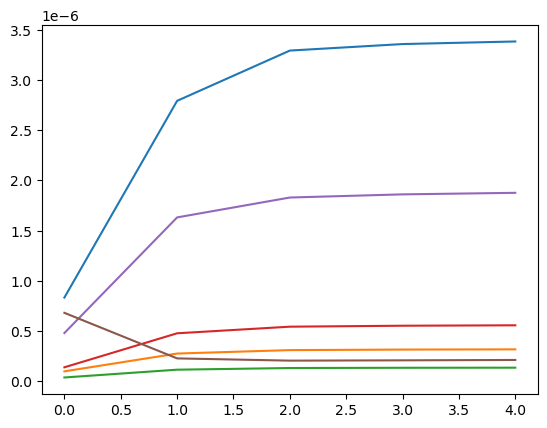

step: 0/1, D_loss: 0.11859861, G_loss_U: 4.082088, G_loss_S: 0.06950985, E_loss_t0: 2.135776


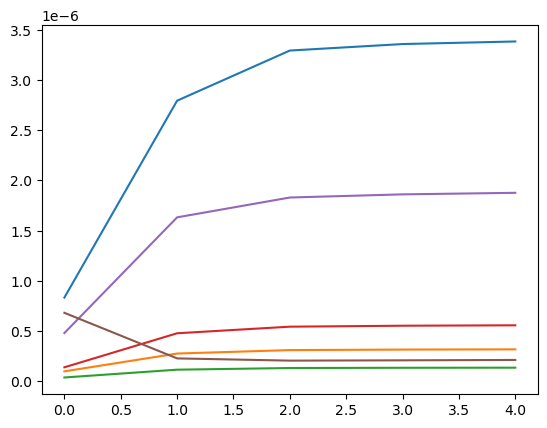

step: 0/1, D_loss: 0.109530956, G_loss_U: 4.0820875, G_loss_S: 0.06950819, E_loss_t0: 1.4844874


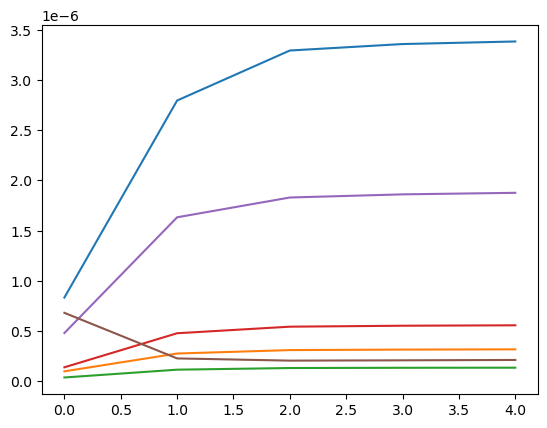

step: 0/1, D_loss: 0.11123279, G_loss_U: 4.0820875, G_loss_S: 0.06946668, E_loss_t0: 1.6842699


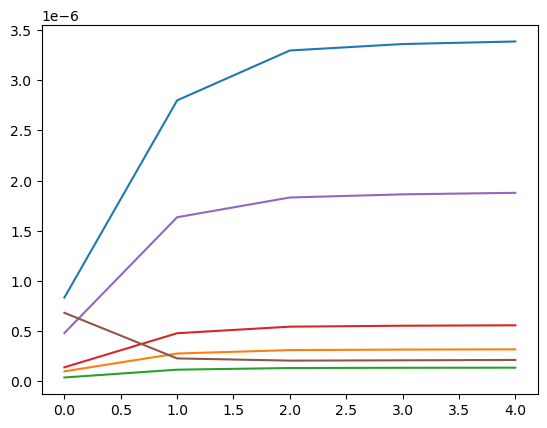

step: 0/1, D_loss: 0.11121806, G_loss_U: 4.082087, G_loss_S: 0.06941821, E_loss_t0: 1.8584636


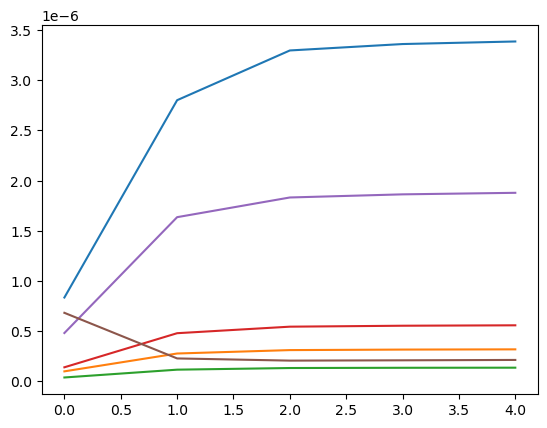

step: 0/1, D_loss: 0.11310592, G_loss_U: 4.082086, G_loss_S: 0.06942206, E_loss_t0: 1.9234475


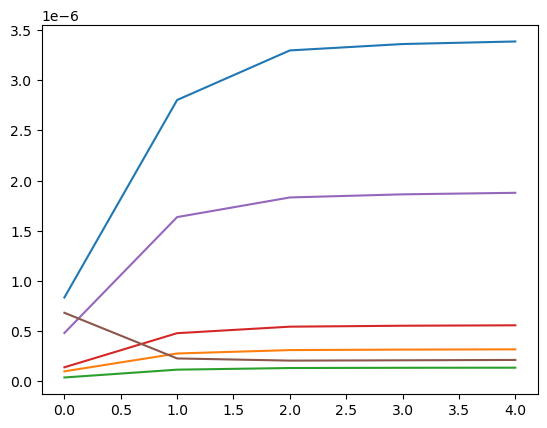

step: 0/1, D_loss: 0.109340824, G_loss_U: 4.0820856, G_loss_S: 0.069482595, E_loss_t0: 1.3335862


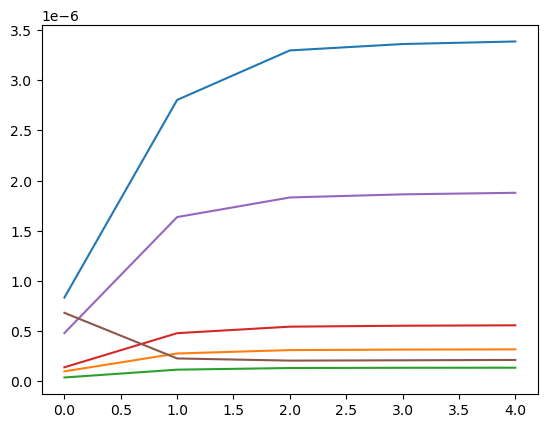

step: 0/1, D_loss: 0.10960671, G_loss_U: 4.0820856, G_loss_S: 0.06953712, E_loss_t0: 1.3237561


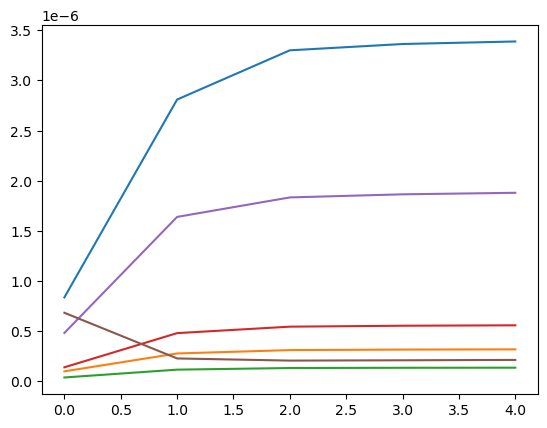

step: 0/1, D_loss: 0.11656961, G_loss_U: 4.082085, G_loss_S: 0.06950611, E_loss_t0: 1.8478633


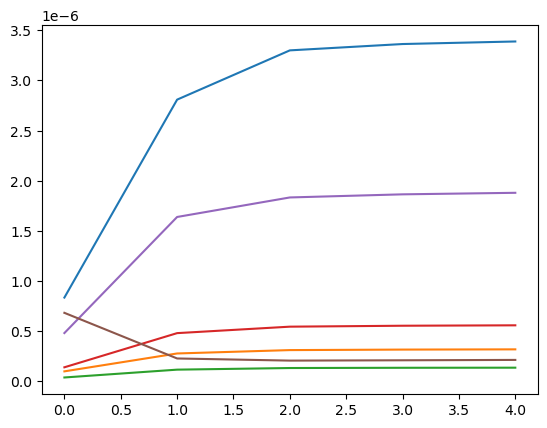

step: 0/1, D_loss: 0.10989845, G_loss_U: 4.0820847, G_loss_S: 0.06951127, E_loss_t0: 1.4567574


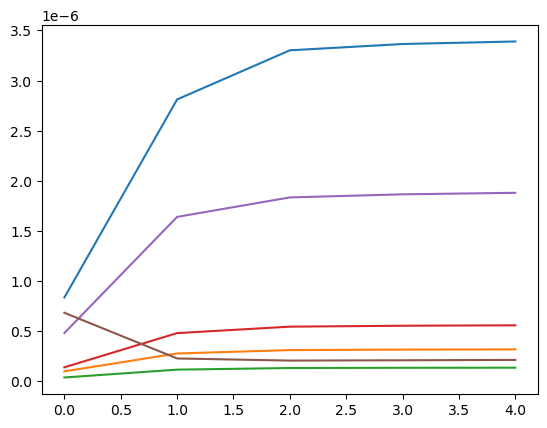

step: 0/1, D_loss: 0.13071996, G_loss_U: 4.082084, G_loss_S: 0.06930759, E_loss_t0: 2.4827302


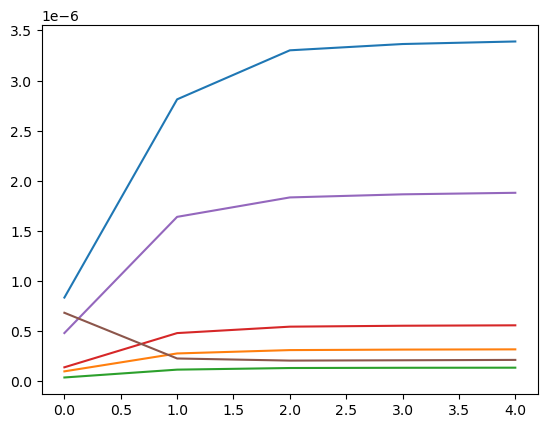

step: 0/1, D_loss: 0.11031504, G_loss_U: 4.0820837, G_loss_S: 0.069498226, E_loss_t0: 1.1293459


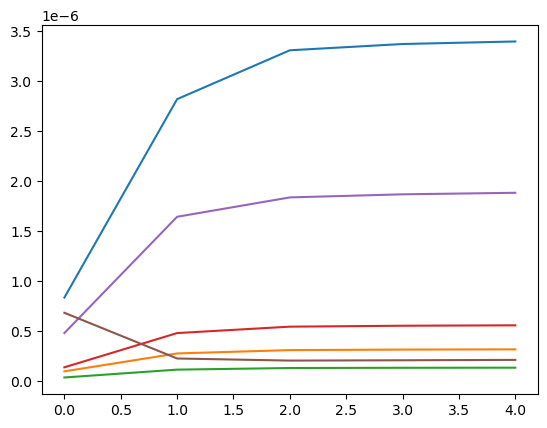

step: 0/1, D_loss: 0.113522, G_loss_U: 4.082083, G_loss_S: 0.06946681, E_loss_t0: 1.9623702


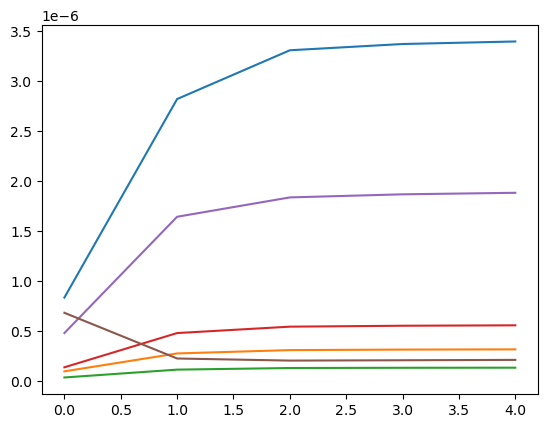

step: 0/1, D_loss: 0.11188902, G_loss_U: 4.0820827, G_loss_S: 0.06941132, E_loss_t0: 1.810263


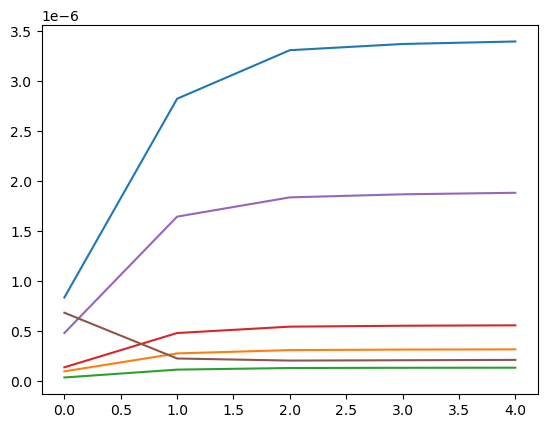

step: 0/1, D_loss: 0.116722345, G_loss_U: 4.0820823, G_loss_S: 0.0696232, E_loss_t0: 1.9889193


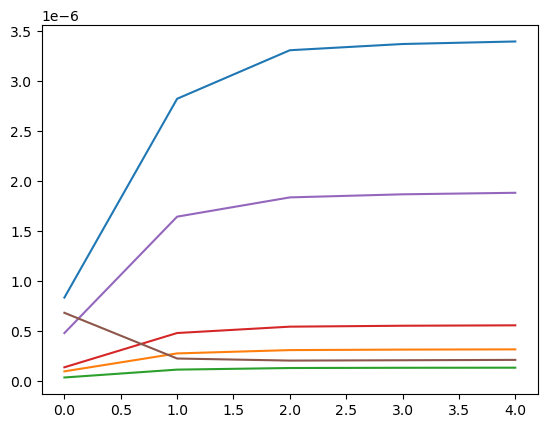

step: 0/1, D_loss: 0.118252486, G_loss_U: 4.0820823, G_loss_S: 0.06939019, E_loss_t0: 1.9622239


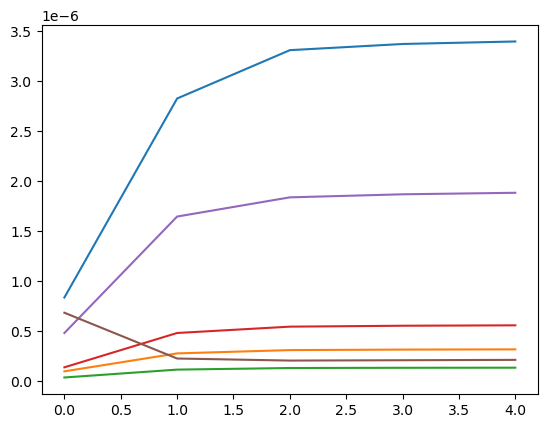

step: 0/1, D_loss: 0.11818863, G_loss_U: 4.0820813, G_loss_S: 0.069408886, E_loss_t0: 2.0089793


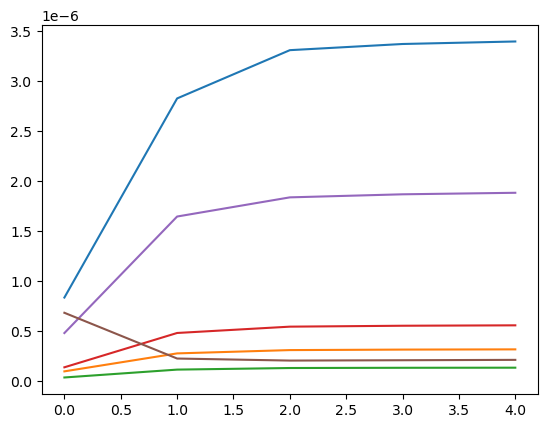

step: 0/1, D_loss: 0.12456146, G_loss_U: 4.0820813, G_loss_S: 0.06930361, E_loss_t0: 2.3406804


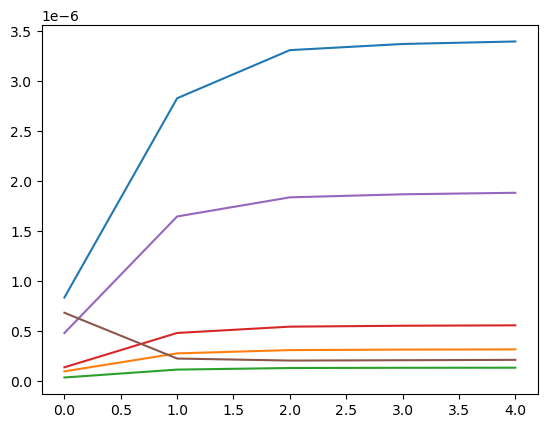

step: 0/1, D_loss: 0.112154275, G_loss_U: 4.0820804, G_loss_S: 0.06936588, E_loss_t0: 1.9158716


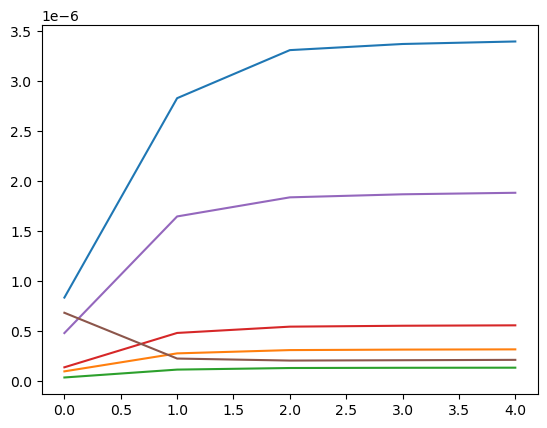

step: 0/1, D_loss: 0.10958301, G_loss_U: 4.08208, G_loss_S: 0.06944143, E_loss_t0: 1.2519984


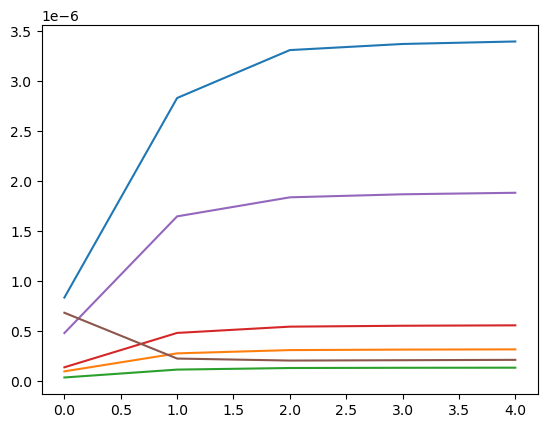

step: 0/1, D_loss: 0.11028317, G_loss_U: 4.0820794, G_loss_S: 0.069399655, E_loss_t0: 1.598786


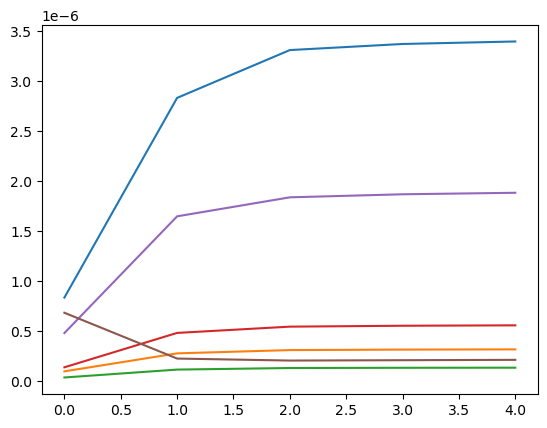

step: 0/1, D_loss: 0.11718903, G_loss_U: 4.082079, G_loss_S: 0.069374755, E_loss_t0: 1.951279


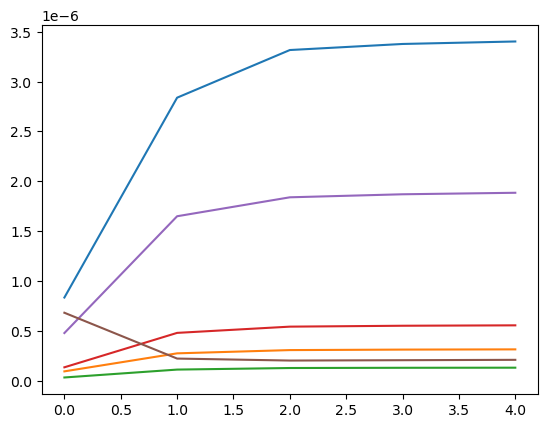

step: 0/1, D_loss: 0.11228905, G_loss_U: 4.082079, G_loss_S: 0.06938609, E_loss_t0: 1.8923872


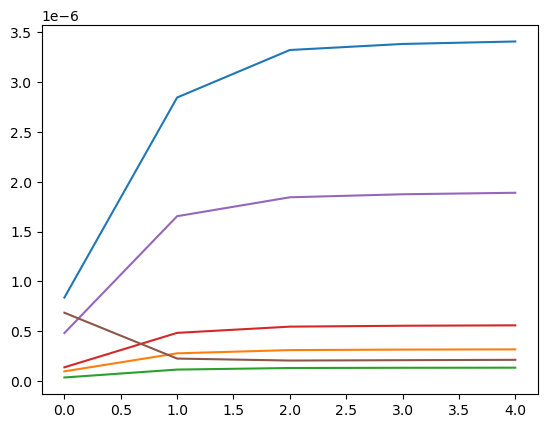

step: 0/1, D_loss: 0.11763021, G_loss_U: 4.0820785, G_loss_S: 0.06943357, E_loss_t0: 1.9284899


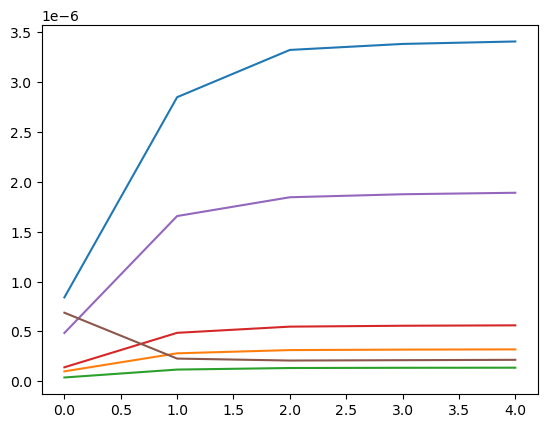

step: 0/1, D_loss: 0.118128166, G_loss_U: 4.0820775, G_loss_S: 0.06933064, E_loss_t0: 2.0889199


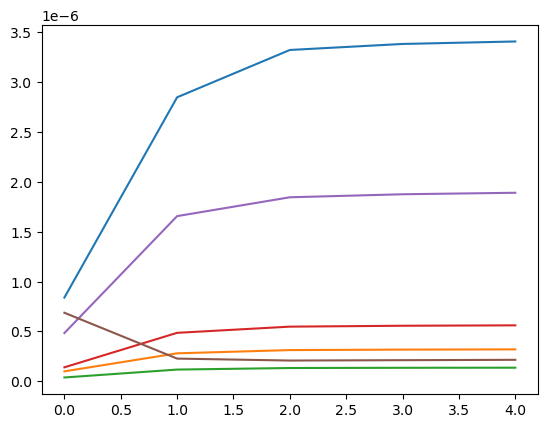

step: 0/1, D_loss: 0.12067566, G_loss_U: 4.0820775, G_loss_S: 0.06944651, E_loss_t0: 1.9771358


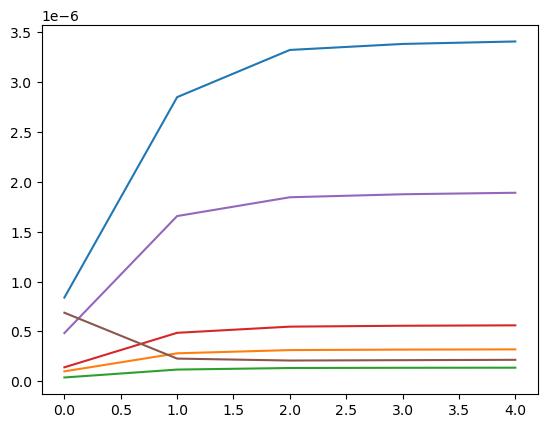

step: 0/1, D_loss: 0.11065092, G_loss_U: 4.0820775, G_loss_S: 0.06936072, E_loss_t0: 1.7388059


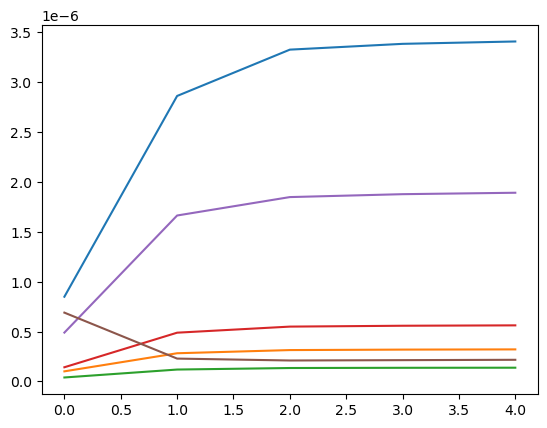

step: 0/1, D_loss: 0.110163376, G_loss_U: 4.0820765, G_loss_S: 0.06940918, E_loss_t0: 1.3635769


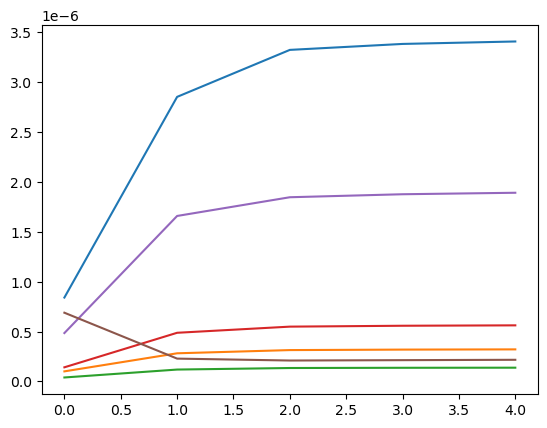

step: 0/1, D_loss: 0.114785485, G_loss_U: 4.082076, G_loss_S: 0.06934052, E_loss_t0: 1.8834251


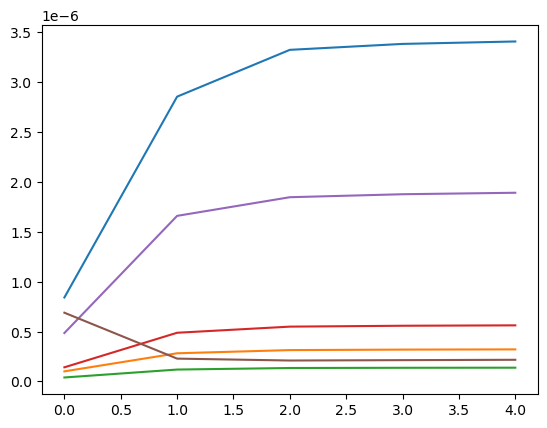

step: 0/1, D_loss: 0.12948316, G_loss_U: 4.0820756, G_loss_S: 0.06934176, E_loss_t0: 2.3026288


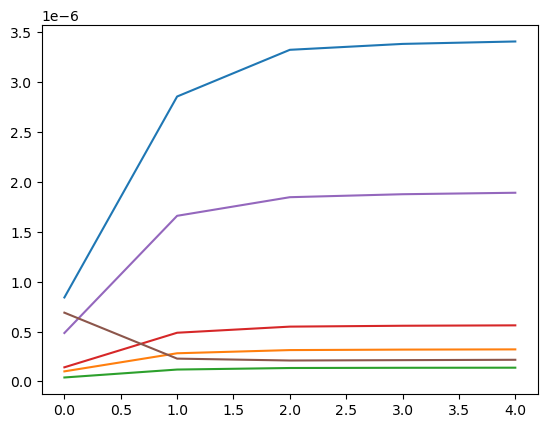

step: 0/1, D_loss: 0.111692645, G_loss_U: 4.082075, G_loss_S: 0.069306776, E_loss_t0: 1.891216


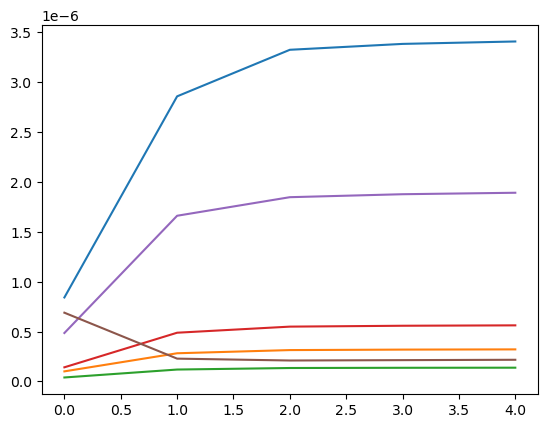

step: 0/1, D_loss: 0.111981064, G_loss_U: 4.0820746, G_loss_S: 0.06931298, E_loss_t0: 1.8697556


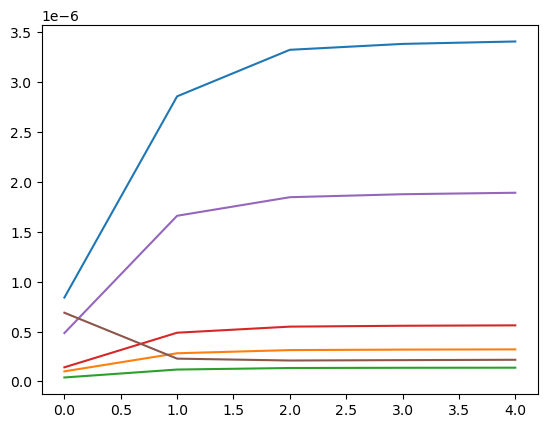

step: 0/1, D_loss: 0.11941997, G_loss_U: 4.082074, G_loss_S: 0.06932067, E_loss_t0: 2.0519917


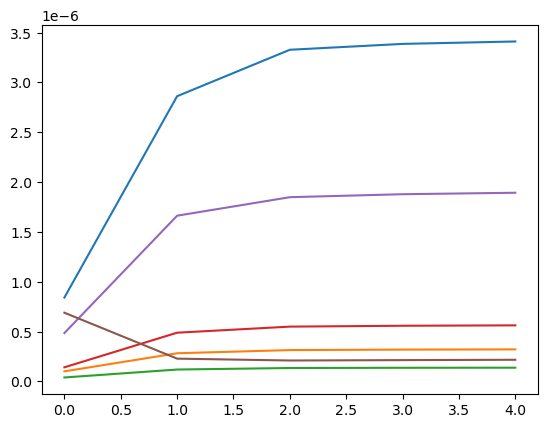

step: 0/1, D_loss: 0.12748677, G_loss_U: 4.082074, G_loss_S: 0.06927864, E_loss_t0: 2.3007298


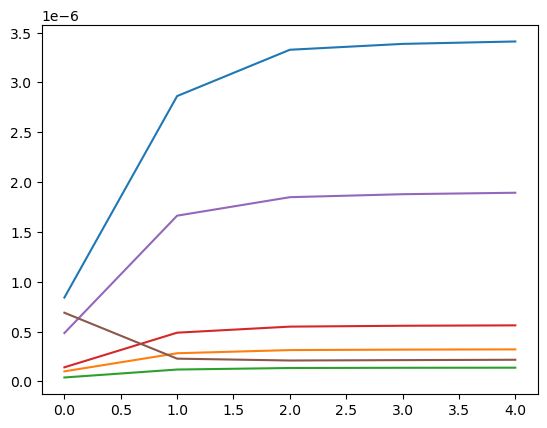

step: 0/1, D_loss: 0.11386297, G_loss_U: 4.082074, G_loss_S: 0.06935666, E_loss_t0: 1.7971061


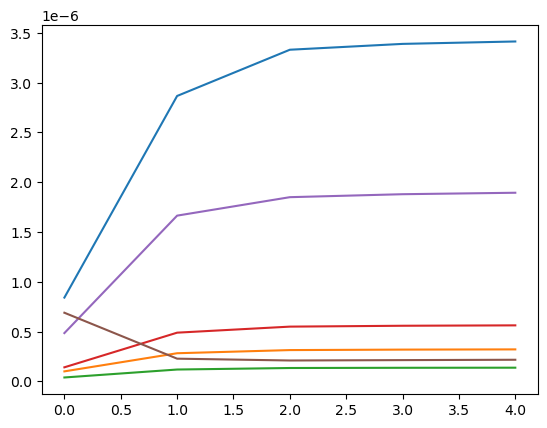

step: 0/1, D_loss: 0.10977948, G_loss_U: 4.082073, G_loss_S: 0.069441, E_loss_t0: 1.4695331


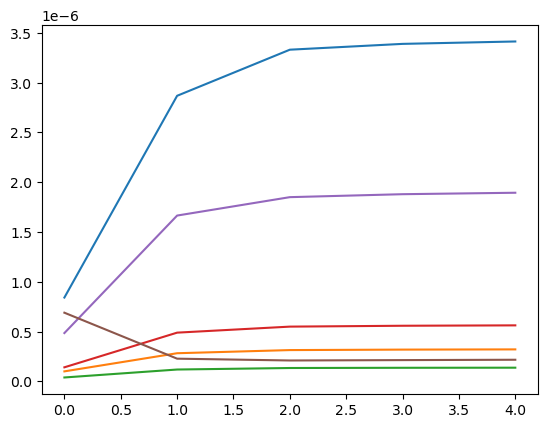

step: 0/1, D_loss: 0.120414466, G_loss_U: 4.0820727, G_loss_S: 0.06922521, E_loss_t0: 2.23569


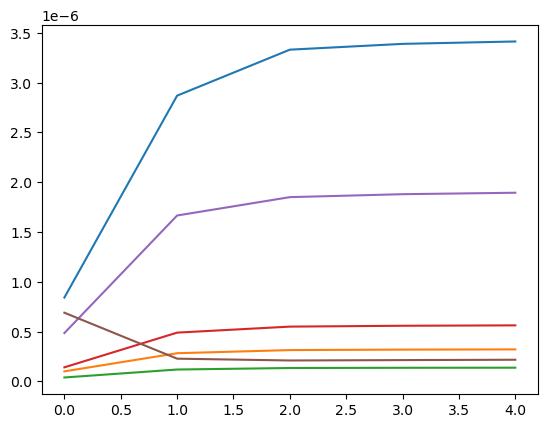

step: 0/1, D_loss: 0.13353771, G_loss_U: 4.0820727, G_loss_S: 0.0691977, E_loss_t0: 2.4886117


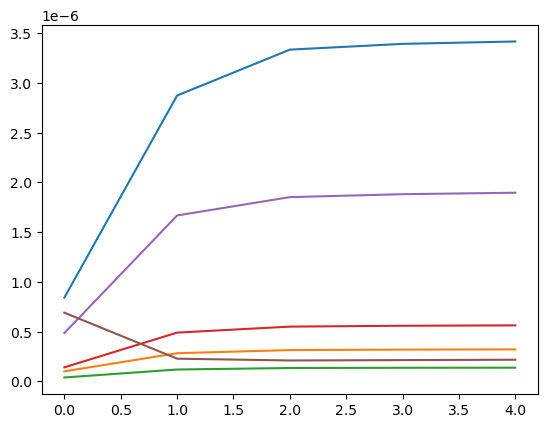

step: 0/1, D_loss: 0.10998339, G_loss_U: 4.082072, G_loss_S: 0.06935577, E_loss_t0: 1.3665836


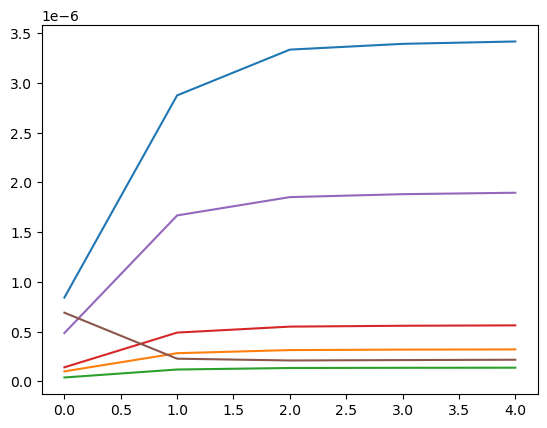

step: 0/1, D_loss: 0.1098138, G_loss_U: 4.0820713, G_loss_S: 0.06929926, E_loss_t0: 1.5212153


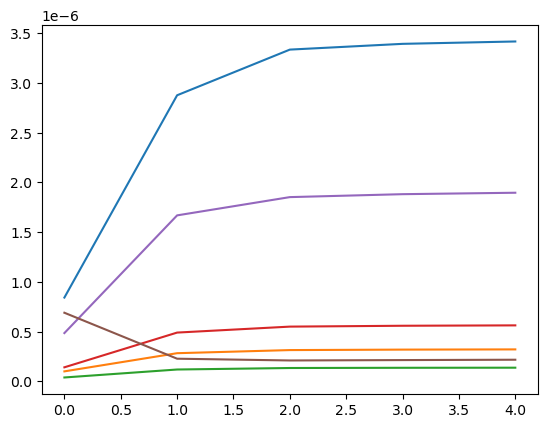

step: 0/1, D_loss: 0.11289222, G_loss_U: 4.0820713, G_loss_S: 0.06925638, E_loss_t0: 1.9450287


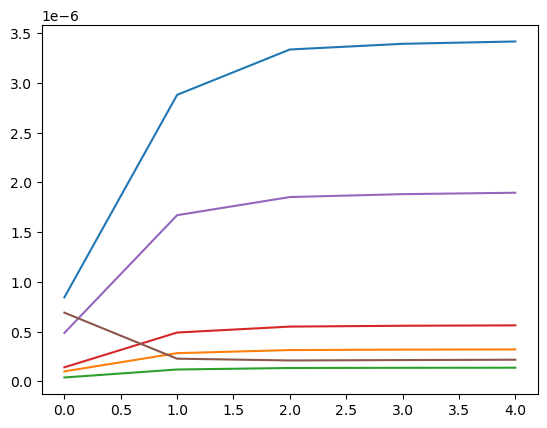

step: 0/1, D_loss: 0.116273895, G_loss_U: 4.082071, G_loss_S: 0.06925262, E_loss_t0: 1.972059


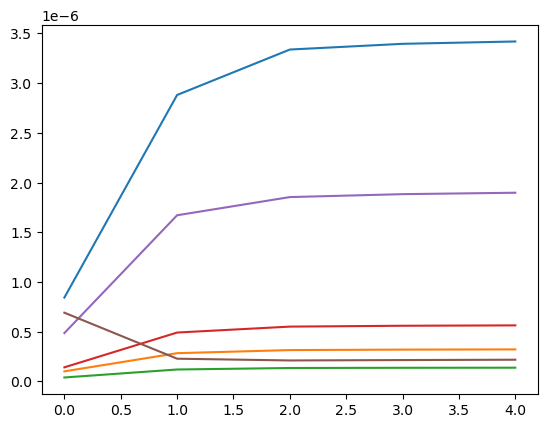

step: 0/1, D_loss: 0.122212075, G_loss_U: 4.0820704, G_loss_S: 0.06933306, E_loss_t0: 2.036091


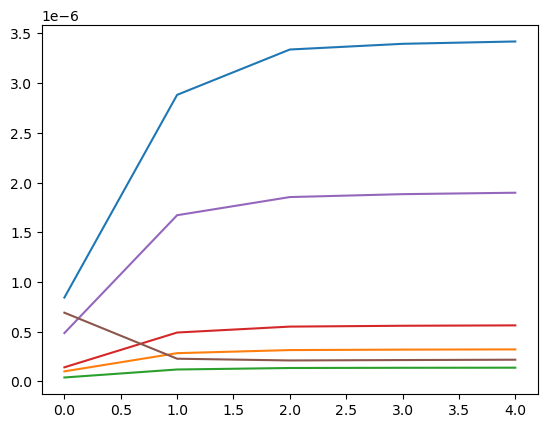

step: 0/1, D_loss: 0.11390268, G_loss_U: 4.08207, G_loss_S: 0.0697002, E_loss_t0: 1.6025884


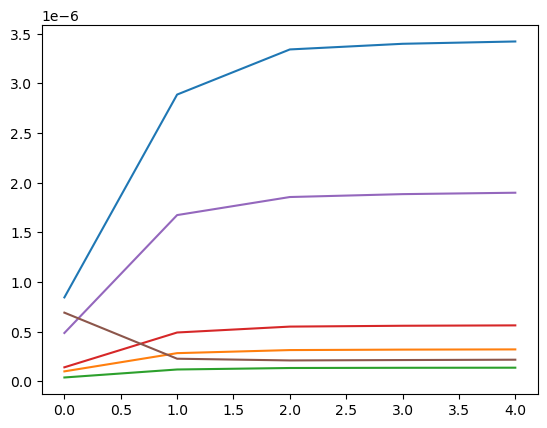

step: 0/1, D_loss: 0.1144702, G_loss_U: 4.08207, G_loss_S: 0.06920708, E_loss_t0: 2.0001523


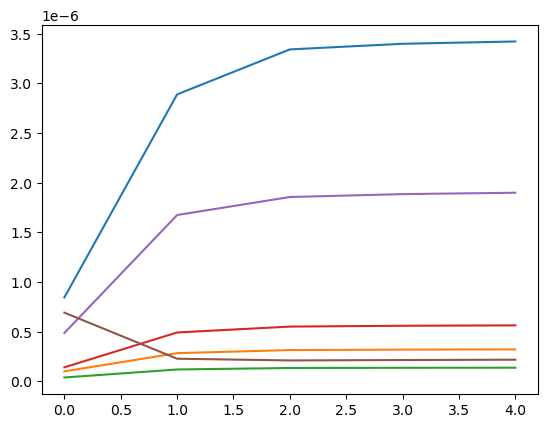

step: 0/1, D_loss: 0.118826635, G_loss_U: 4.082069, G_loss_S: 0.06932344, E_loss_t0: 2.0193257


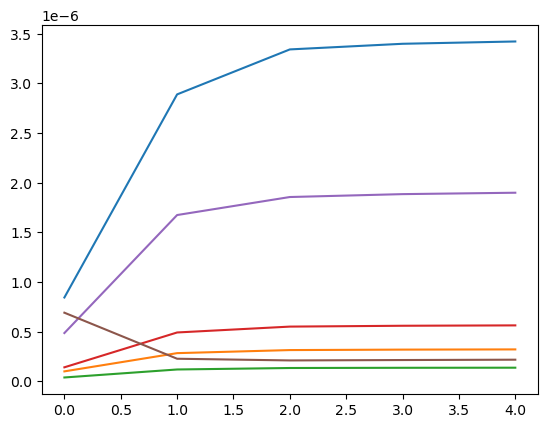

step: 0/1, D_loss: 0.11679756, G_loss_U: 4.0820684, G_loss_S: 0.0692223, E_loss_t0: 1.9737777


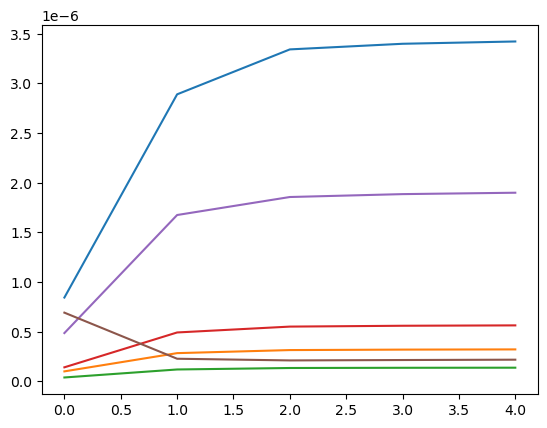

step: 0/1, D_loss: 0.13228965, G_loss_U: 4.082068, G_loss_S: 0.06915974, E_loss_t0: 2.4857812


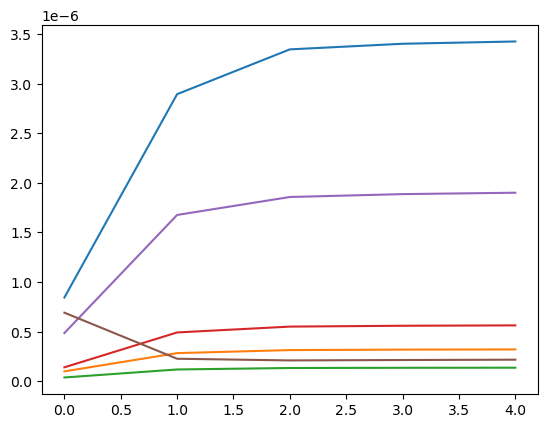

step: 0/1, D_loss: 0.13206616, G_loss_U: 4.082068, G_loss_S: 0.06920183, E_loss_t0: 2.3586736


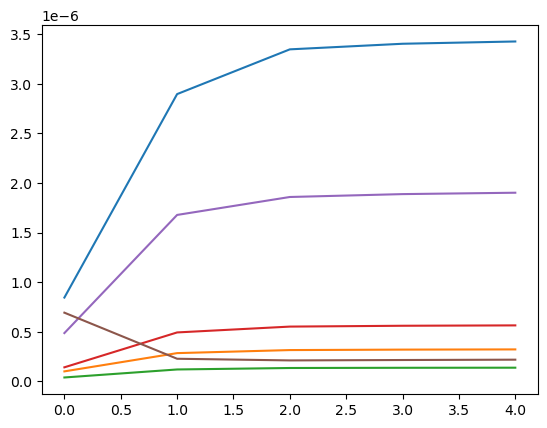

step: 0/1, D_loss: 0.11024162, G_loss_U: 4.082068, G_loss_S: 0.06923639, E_loss_t0: 1.4207363


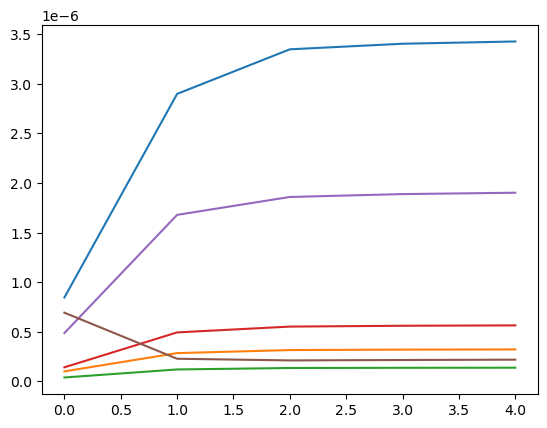

step: 0/1, D_loss: 0.11035284, G_loss_U: 4.0820675, G_loss_S: 0.069245294, E_loss_t0: 1.3979427


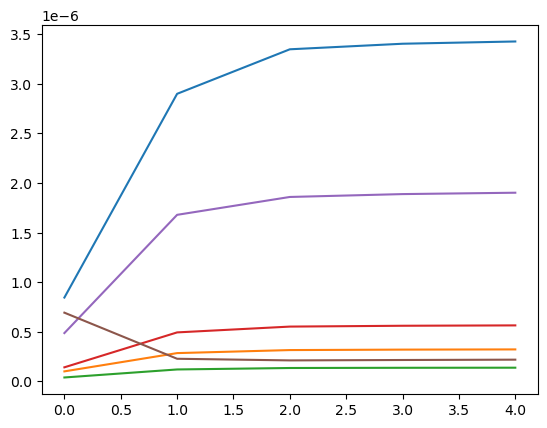

step: 0/1, D_loss: 0.11474395, G_loss_U: 4.0820665, G_loss_S: 0.06915213, E_loss_t0: 1.900495


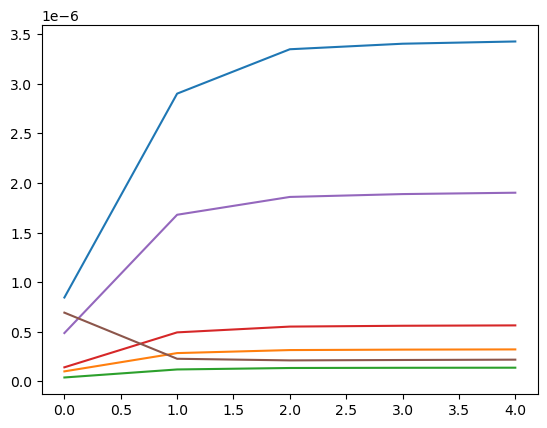

step: 0/1, D_loss: 0.12731922, G_loss_U: 4.0820665, G_loss_S: 0.06908706, E_loss_t0: 2.376676


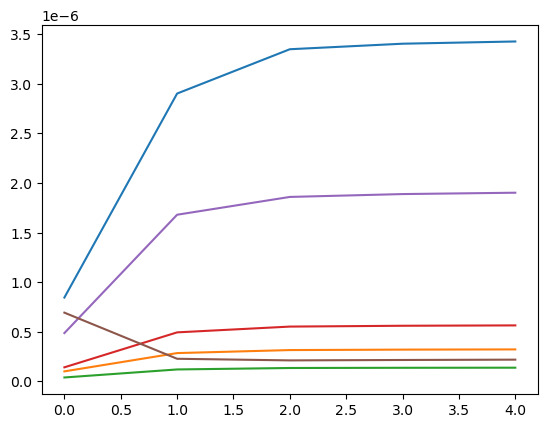

step: 0/1, D_loss: 0.11446785, G_loss_U: 4.0820656, G_loss_S: 0.0691519, E_loss_t0: 1.8812431


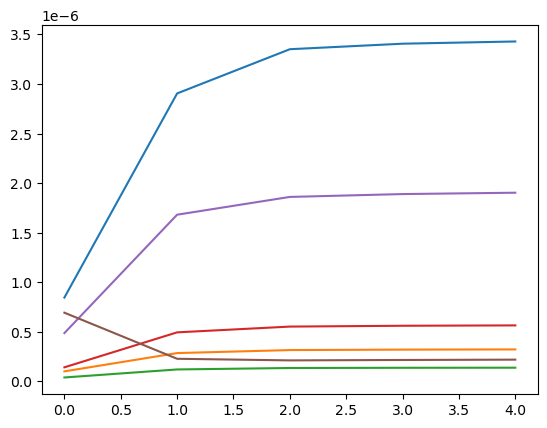

step: 0/1, D_loss: 0.122590914, G_loss_U: 4.082065, G_loss_S: 0.069083, E_loss_t0: 2.212622


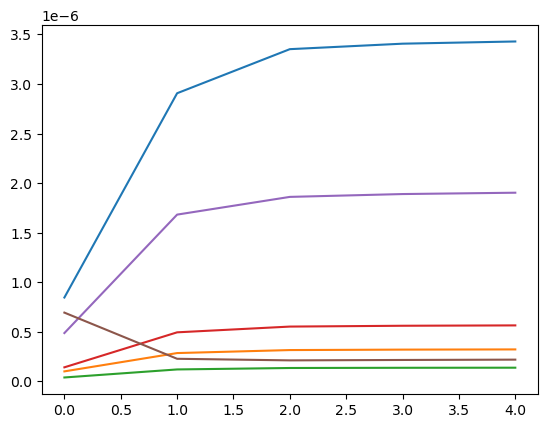

step: 0/1, D_loss: 0.119710475, G_loss_U: 4.0820646, G_loss_S: 0.06911284, E_loss_t0: 2.0474162


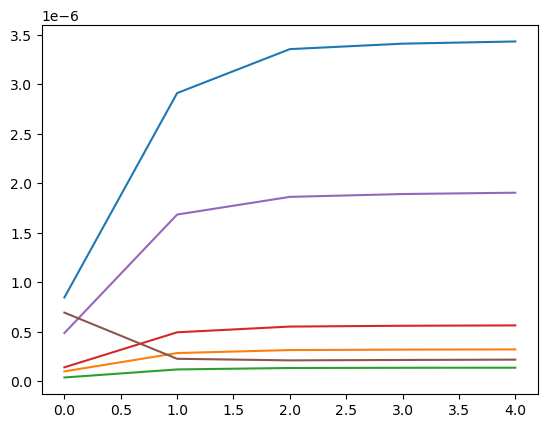

step: 0/1, D_loss: 0.11868944, G_loss_U: 4.0820646, G_loss_S: 0.06908421, E_loss_t0: 2.1825588


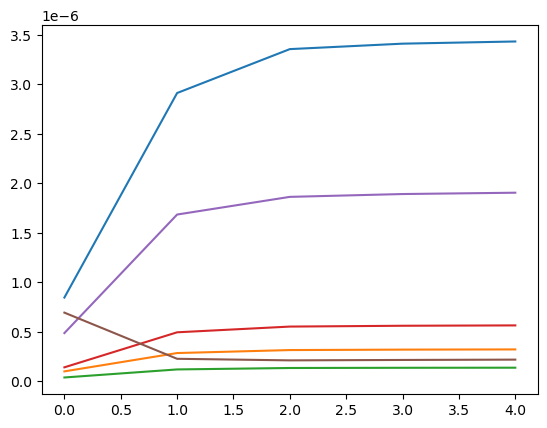

step: 0/1, D_loss: 0.122214645, G_loss_U: 4.082064, G_loss_S: 0.06904875, E_loss_t0: 2.2010932


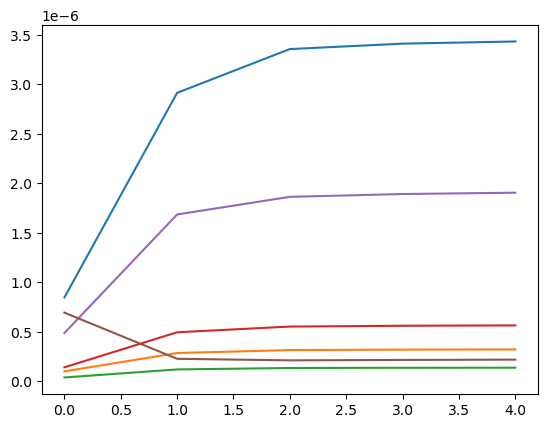

step: 0/1, D_loss: 0.11153886, G_loss_U: 4.0820637, G_loss_S: 0.06908412, E_loss_t0: 1.6040403


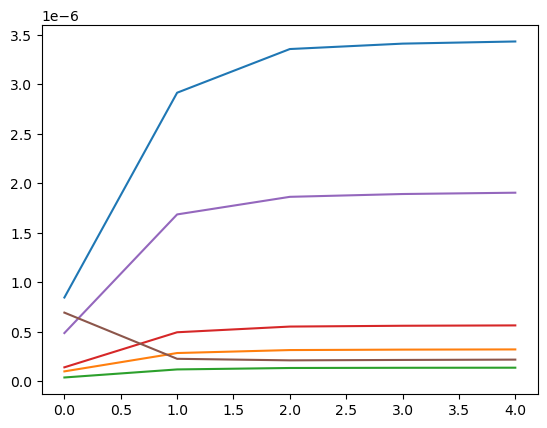

step: 0/1, D_loss: 0.11060905, G_loss_U: 4.082063, G_loss_S: 0.06909275, E_loss_t0: 1.3886472


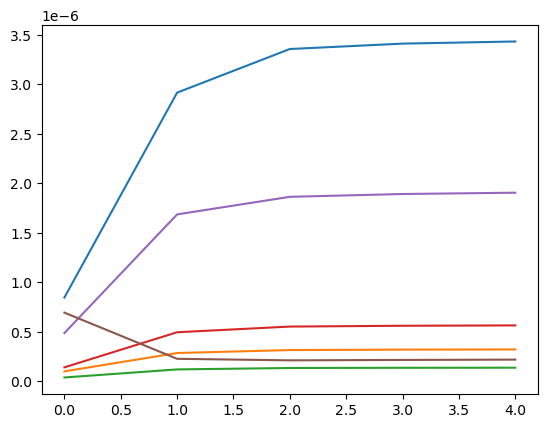

step: 0/1, D_loss: 0.12387055, G_loss_U: 4.082063, G_loss_S: 0.0690227, E_loss_t0: 2.199544


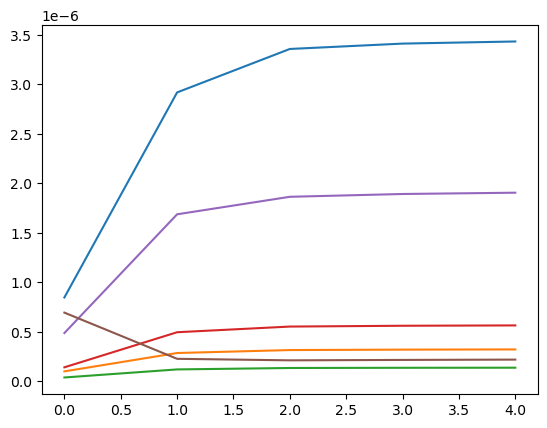

step: 0/1, D_loss: 0.12666002, G_loss_U: 4.0820622, G_loss_S: 0.068971045, E_loss_t0: 2.3301482


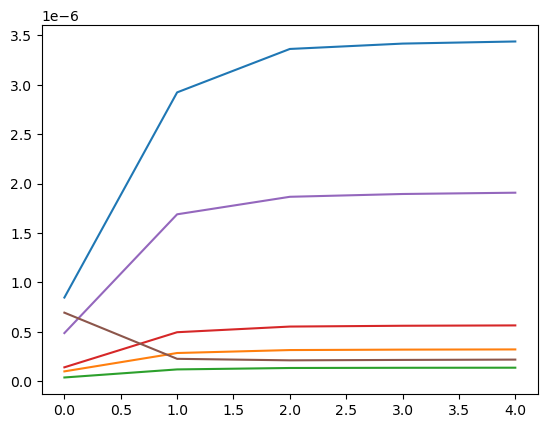

step: 0/1, D_loss: 0.11073414, G_loss_U: 4.0820622, G_loss_S: 0.06898621, E_loss_t0: 1.645942


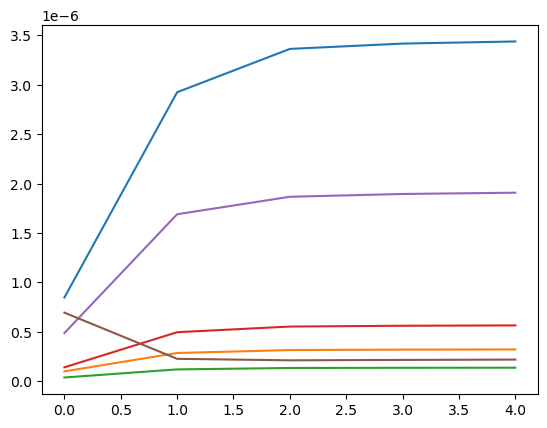

step: 0/1, D_loss: 0.115449175, G_loss_U: 4.082062, G_loss_S: 0.06894305, E_loss_t0: 1.9812622


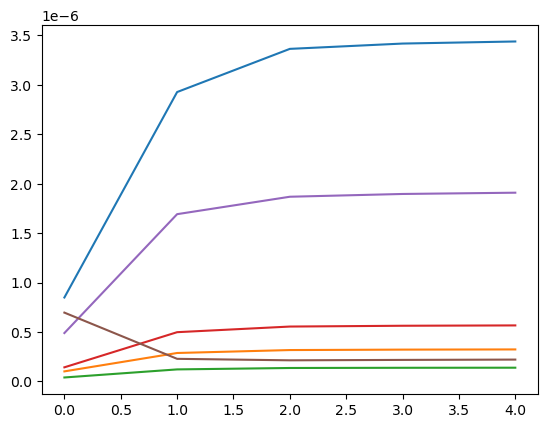

step: 0/1, D_loss: 0.1144486, G_loss_U: 4.0820613, G_loss_S: 0.06891463, E_loss_t0: 1.8303934


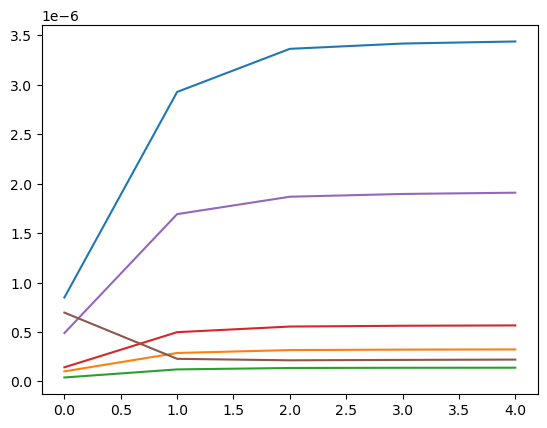

step: 0/1, D_loss: 0.12359581, G_loss_U: 4.0820613, G_loss_S: 0.068923295, E_loss_t0: 2.0779192


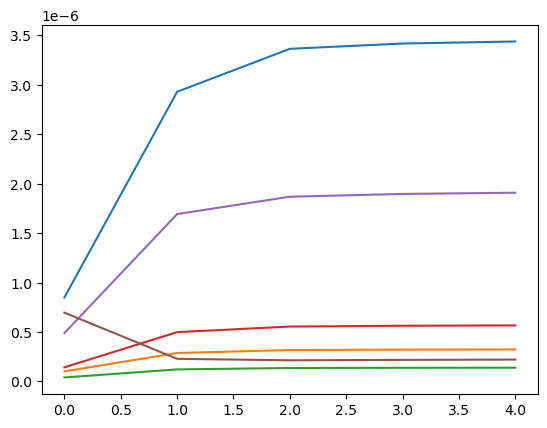

step: 0/1, D_loss: 0.113308005, G_loss_U: 4.082061, G_loss_S: 0.06883132, E_loss_t0: 1.9755771


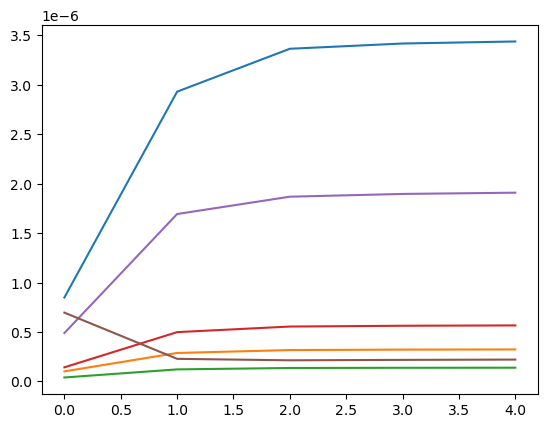

step: 0/1, D_loss: 0.110139124, G_loss_U: 4.0820603, G_loss_S: 0.06885312, E_loss_t0: 1.1839967


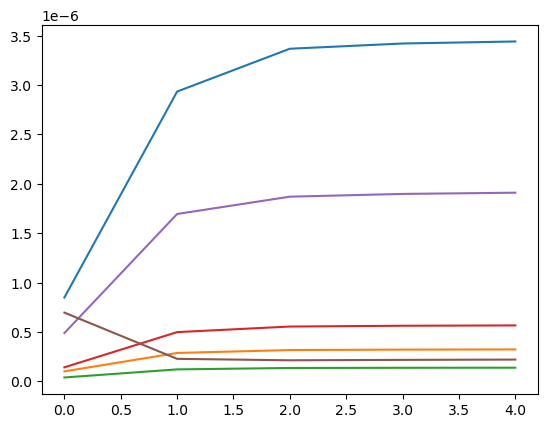

step: 0/1, D_loss: 0.11211408, G_loss_U: 4.08206, G_loss_S: 0.06878499, E_loss_t0: 1.4694117


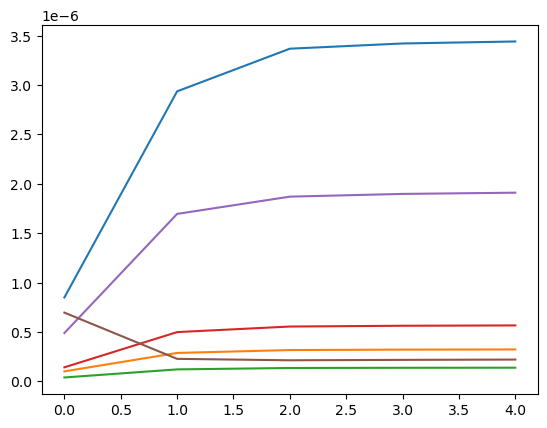

step: 0/1, D_loss: 0.115422495, G_loss_U: 4.0820594, G_loss_S: 0.068693385, E_loss_t0: 2.109507


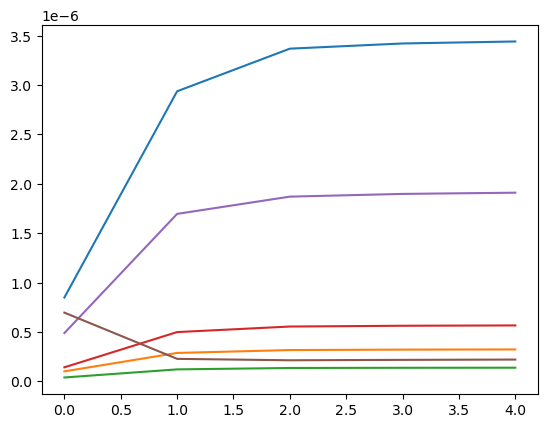

step: 0/1, D_loss: 0.119825445, G_loss_U: 4.082059, G_loss_S: 0.068672016, E_loss_t0: 1.9194698


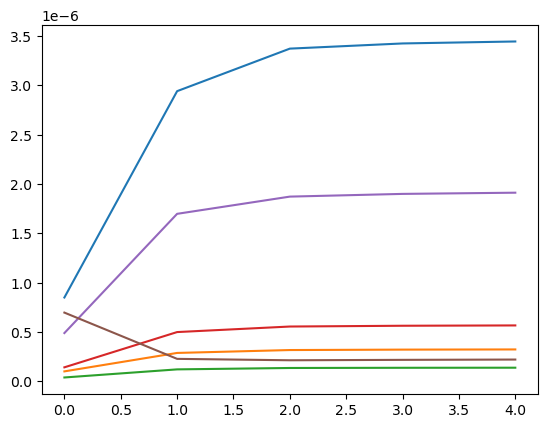

step: 0/1, D_loss: 0.12161332, G_loss_U: 4.0820584, G_loss_S: 0.06862386, E_loss_t0: 2.0542135


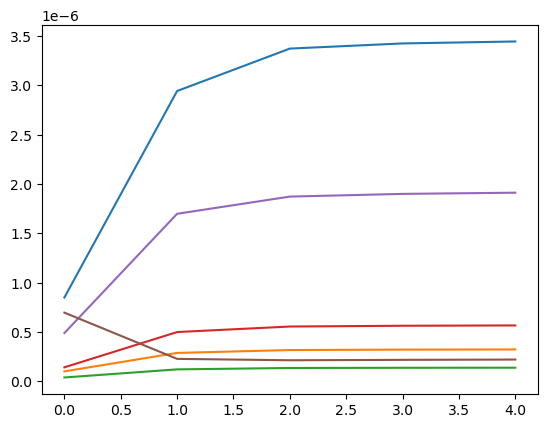

step: 0/1, D_loss: 0.11140199, G_loss_U: 4.0820584, G_loss_S: 0.06856373, E_loss_t0: 1.635098


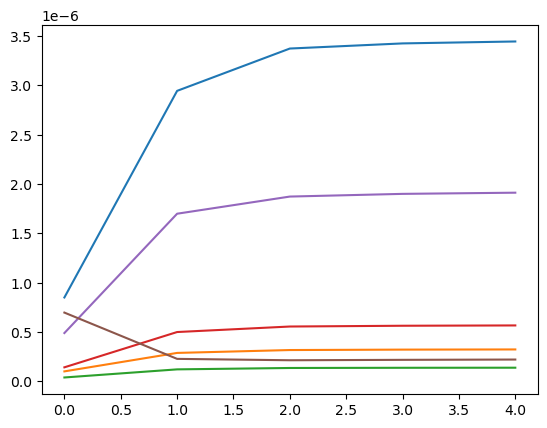

step: 0/1, D_loss: 0.11440862, G_loss_U: 4.082058, G_loss_S: 0.06844042, E_loss_t0: 2.0636885


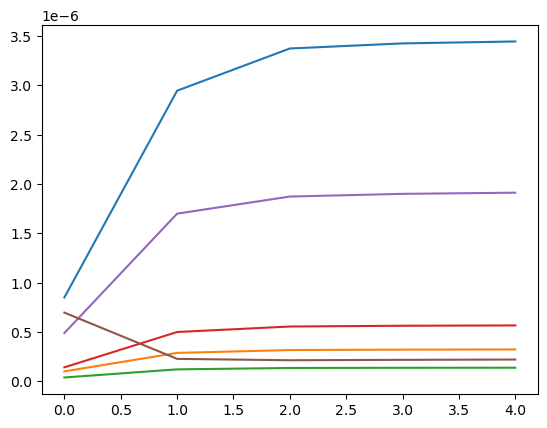

step: 0/1, D_loss: 0.11749956, G_loss_U: 4.0820575, G_loss_S: 0.06838941, E_loss_t0: 1.9053601


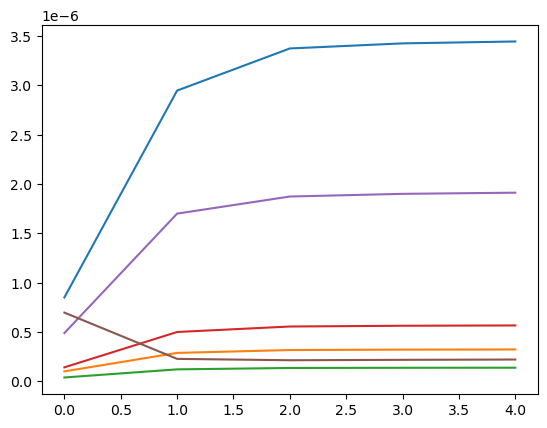

step: 0/1, D_loss: 0.111567095, G_loss_U: 4.082057, G_loss_S: 0.06838027, E_loss_t0: 1.3957921


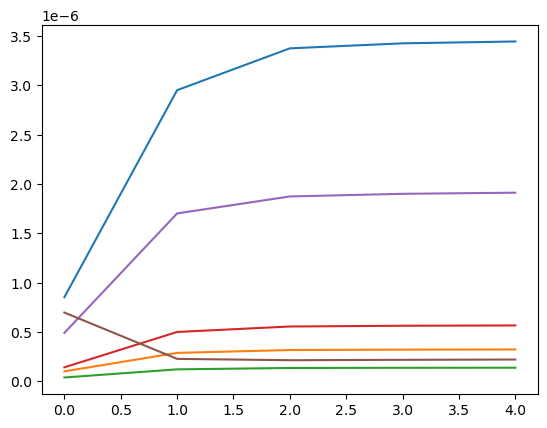

step: 0/1, D_loss: 0.11145723, G_loss_U: 4.082057, G_loss_S: 0.06816815, E_loss_t0: 1.3172697


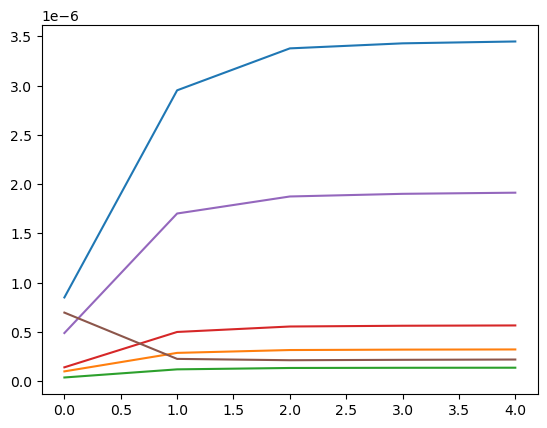

step: 0/1, D_loss: 0.11079241, G_loss_U: 4.082056, G_loss_S: 0.068005815, E_loss_t0: 1.3707621


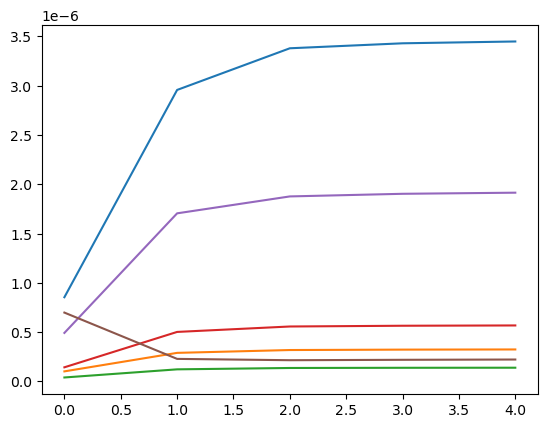

step: 0/1, D_loss: 0.11343087, G_loss_U: 4.082056, G_loss_S: 0.068083614, E_loss_t0: 1.8030576


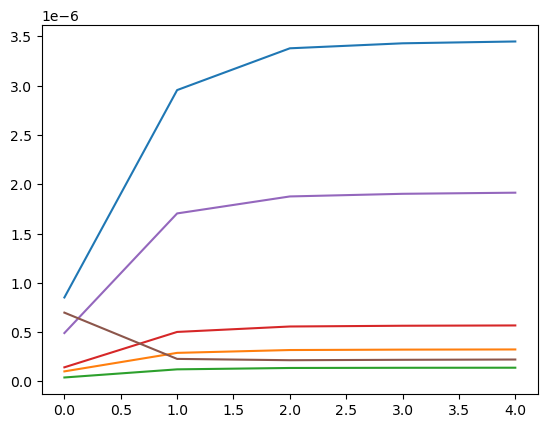

step: 0/1, D_loss: 0.11189026, G_loss_U: 4.0820556, G_loss_S: 0.067685015, E_loss_t0: 1.3537879


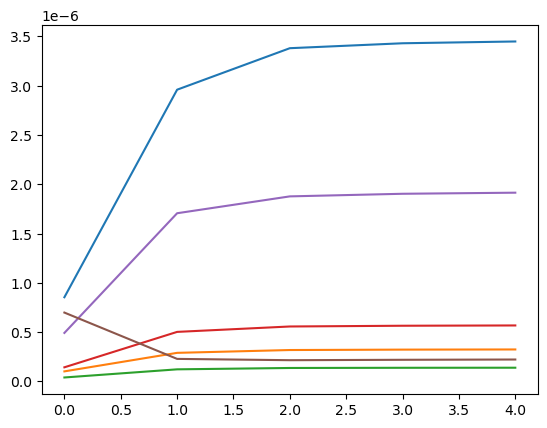

step: 0/1, D_loss: 0.13355185, G_loss_U: 4.0820556, G_loss_S: 0.067482166, E_loss_t0: 2.4100528


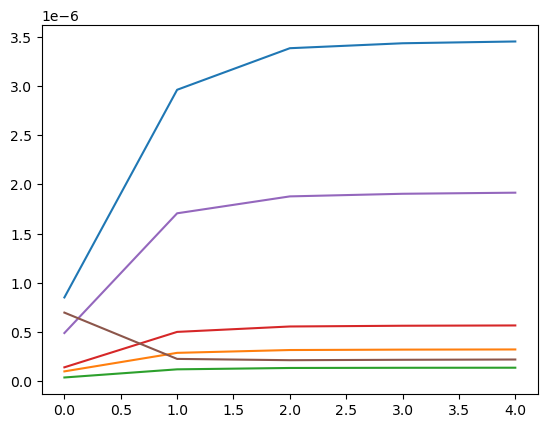

step: 0/1, D_loss: 0.112893745, G_loss_U: 4.0820546, G_loss_S: 0.067205474, E_loss_t0: 1.9158155


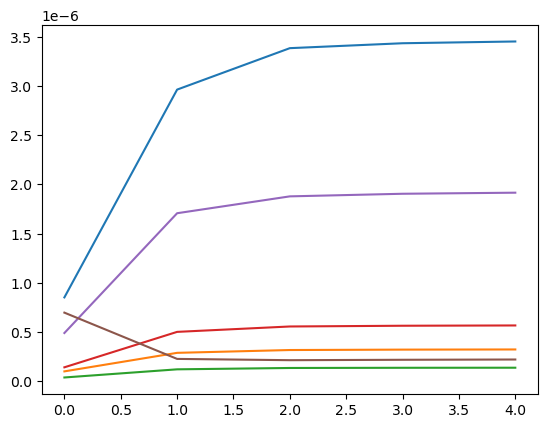

step: 0/1, D_loss: 0.111997955, G_loss_U: 4.0820546, G_loss_S: 0.06686855, E_loss_t0: 1.6226102


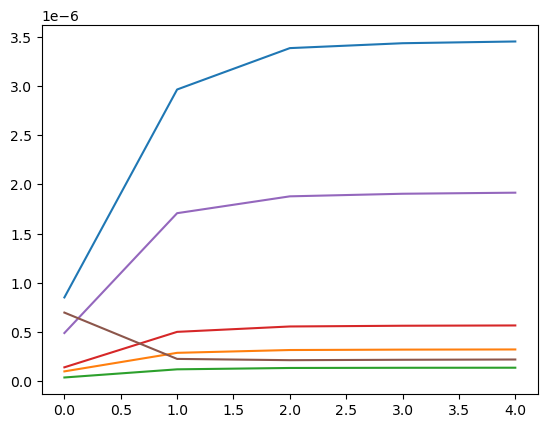

step: 0/1, D_loss: 0.12489578, G_loss_U: 4.0820546, G_loss_S: 0.066560976, E_loss_t0: 2.1233852


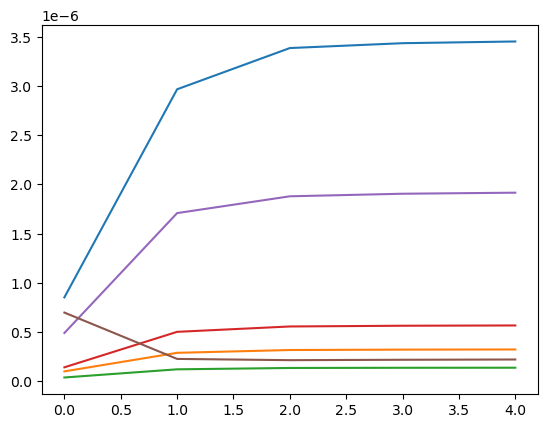

step: 0/1, D_loss: 0.12520015, G_loss_U: 4.0820537, G_loss_S: 0.06621264, E_loss_t0: 2.0276127


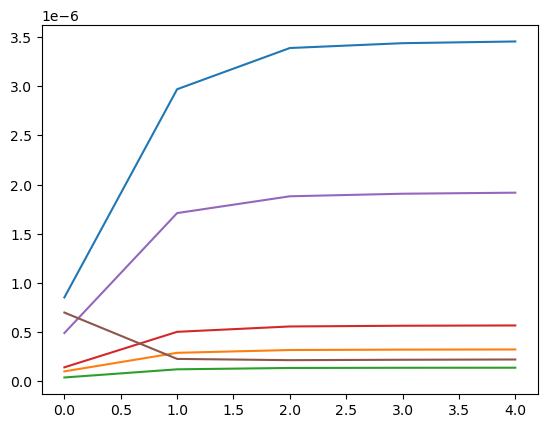

step: 0/1, D_loss: 0.12123202, G_loss_U: 4.0820537, G_loss_S: 0.06574769, E_loss_t0: 2.0167558


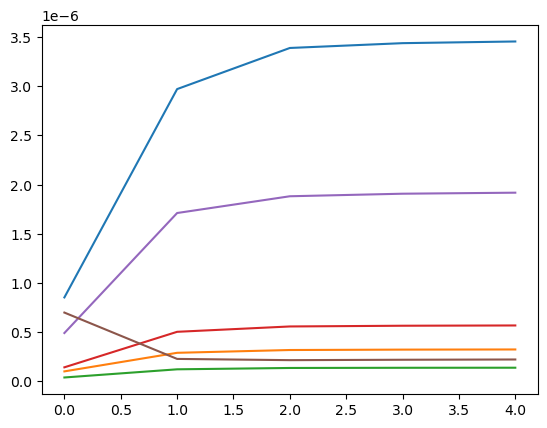

step: 0/1, D_loss: 0.11501905, G_loss_U: 4.082053, G_loss_S: 0.0653448, E_loss_t0: 1.8779265


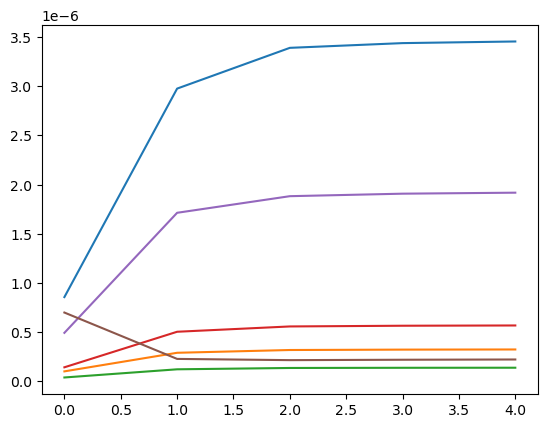

step: 0/1, D_loss: 0.12447953, G_loss_U: 4.0820527, G_loss_S: 0.06501645, E_loss_t0: 2.0859463


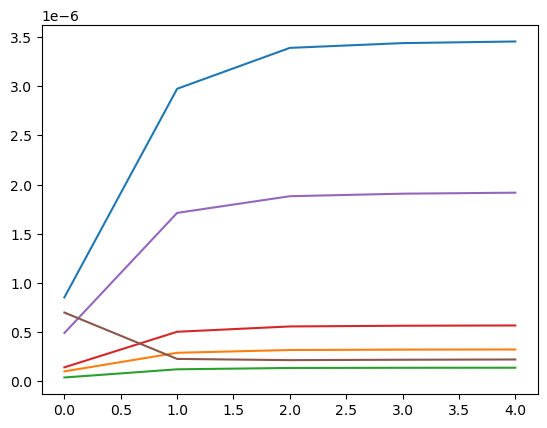

step: 0/1, D_loss: 0.12290967, G_loss_U: 4.0820527, G_loss_S: 0.06476072, E_loss_t0: 2.1292498


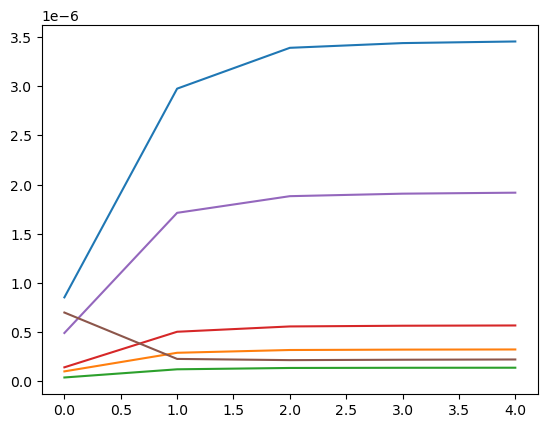

step: 0/1, D_loss: 0.1384329, G_loss_U: 4.082052, G_loss_S: 0.06475405, E_loss_t0: 2.384499


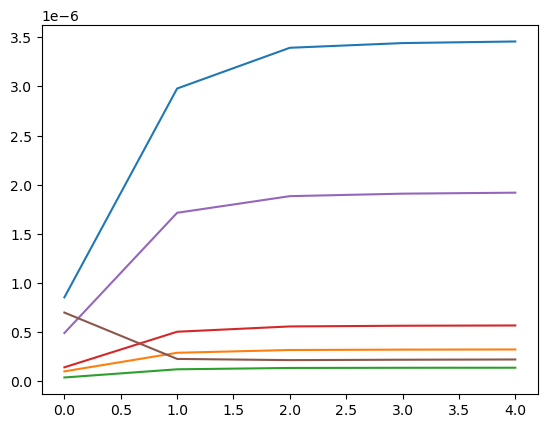

step: 0/1, D_loss: 0.11820464, G_loss_U: 4.0820513, G_loss_S: 0.0647979, E_loss_t0: 1.7207086


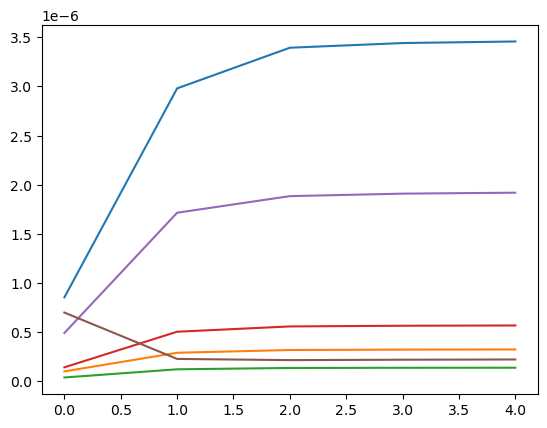

step: 0/1, D_loss: 0.13626768, G_loss_U: 4.0820513, G_loss_S: 0.06478081, E_loss_t0: 2.3501


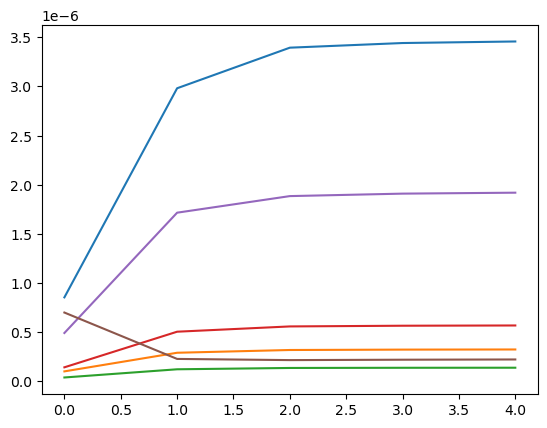

step: 0/1, D_loss: 0.117268816, G_loss_U: 4.082051, G_loss_S: 0.06528436, E_loss_t0: 1.303089


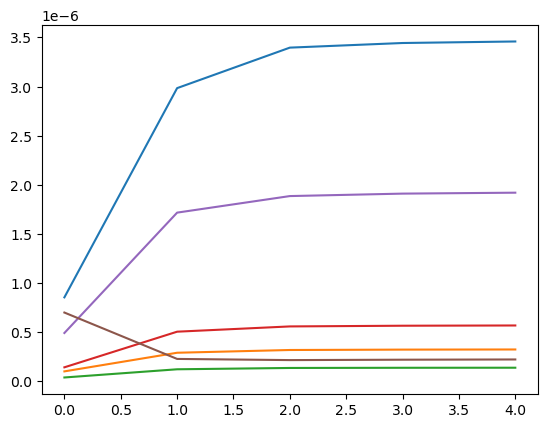

step: 0/1, D_loss: 0.11742135, G_loss_U: 4.082051, G_loss_S: 0.06522257, E_loss_t0: 1.6562712


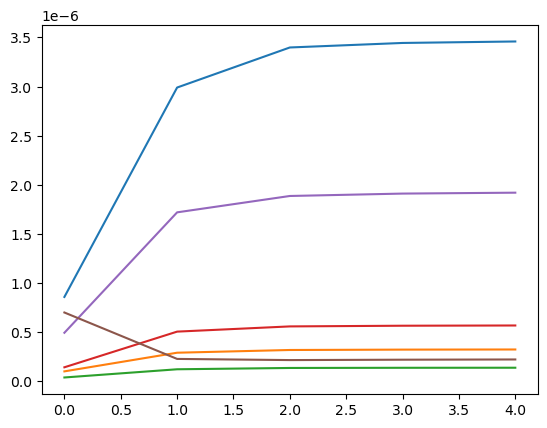

step: 0/1, D_loss: 0.12124143, G_loss_U: 4.0820503, G_loss_S: 0.06541356, E_loss_t0: 1.873102


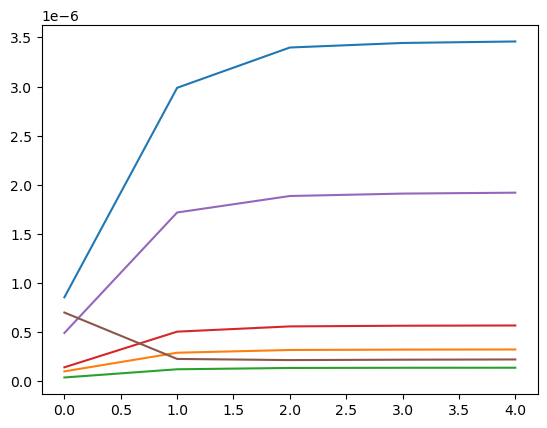

step: 0/1, D_loss: 0.119849294, G_loss_U: 4.08205, G_loss_S: 0.0655352, E_loss_t0: 1.4997569


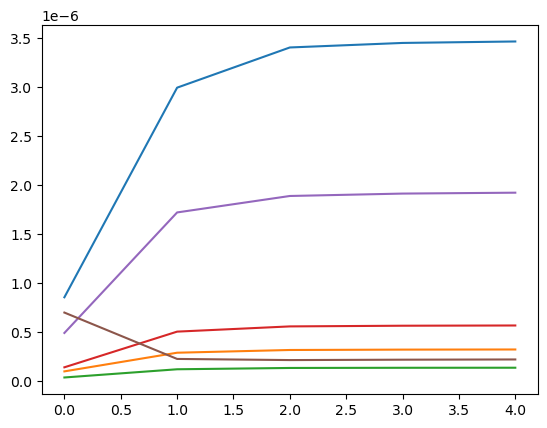

step: 0/1, D_loss: 0.12307055, G_loss_U: 4.0820494, G_loss_S: 0.06526717, E_loss_t0: 1.9324648


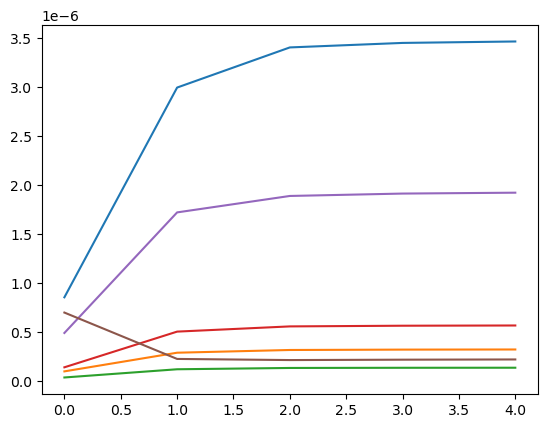

step: 0/1, D_loss: 0.14207408, G_loss_U: 4.0820494, G_loss_S: 0.06511737, E_loss_t0: 2.372016


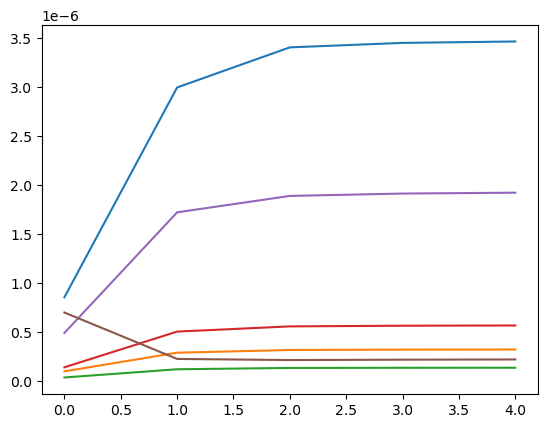

step: 0/1, D_loss: 0.14166453, G_loss_U: 4.082049, G_loss_S: 0.064985506, E_loss_t0: 2.3788664


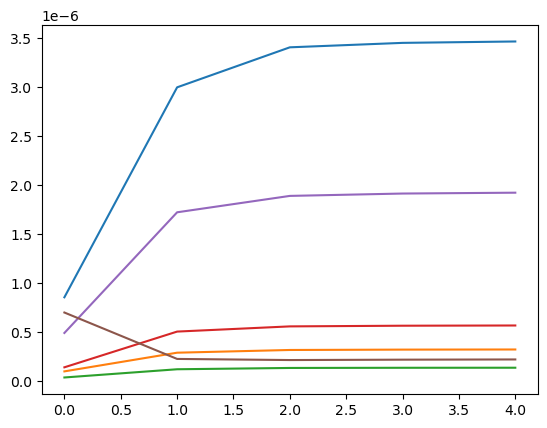

step: 0/1, D_loss: 0.13423868, G_loss_U: 4.082048, G_loss_S: 0.06489956, E_loss_t0: 2.2248778


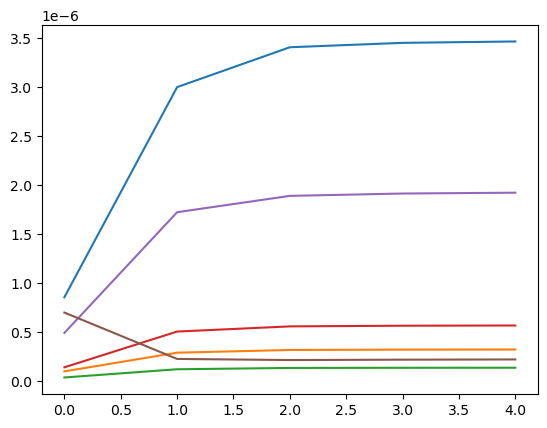

step: 0/1, D_loss: 0.11586993, G_loss_U: 4.082048, G_loss_S: 0.06479053, E_loss_t0: 1.7092928


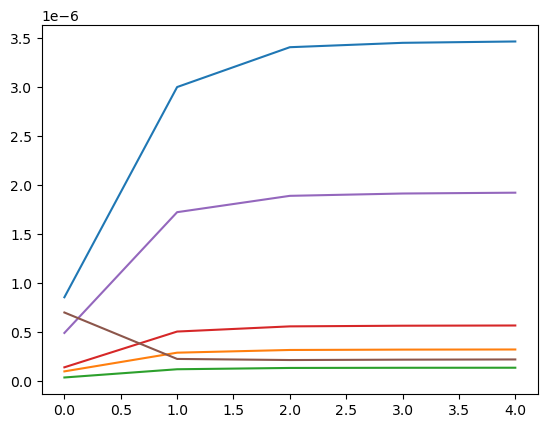

step: 0/1, D_loss: 0.13625857, G_loss_U: 4.082048, G_loss_S: 0.064730495, E_loss_t0: 2.263792


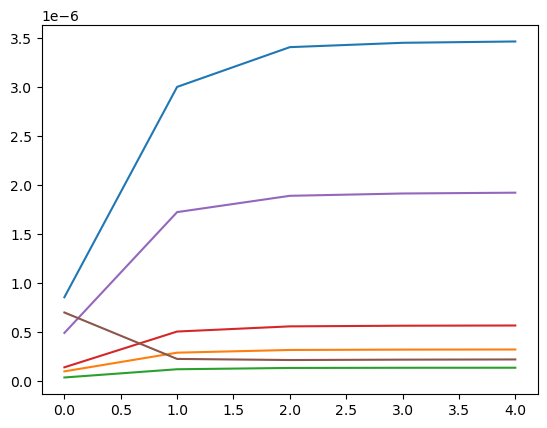

step: 0/1, D_loss: 0.11961597, G_loss_U: 4.082048, G_loss_S: 0.0645767, E_loss_t0: 2.1143231


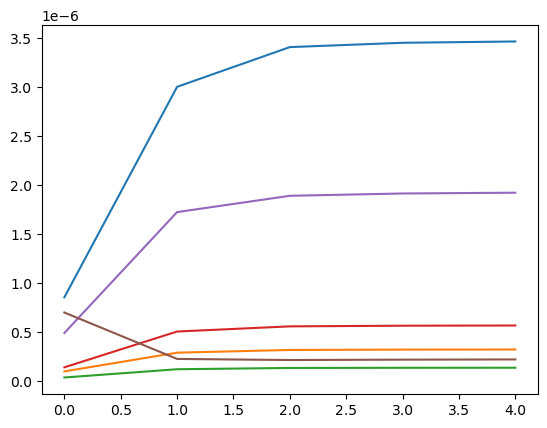

step: 0/1, D_loss: 0.116837144, G_loss_U: 4.0820465, G_loss_S: 0.064608335, E_loss_t0: 1.8798704


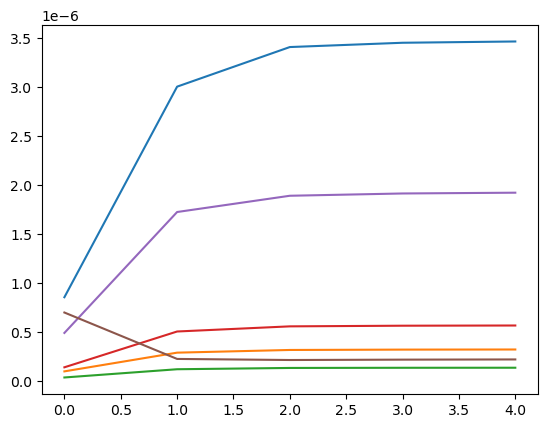

step: 0/1, D_loss: 0.12725037, G_loss_U: 4.082046, G_loss_S: 0.06465092, E_loss_t0: 2.013871


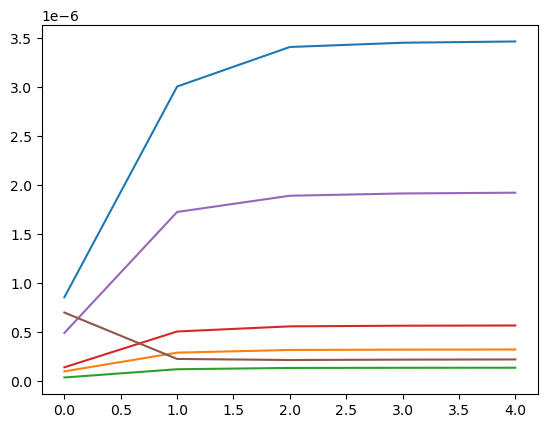

step: 0/1, D_loss: 0.11631468, G_loss_U: 4.082046, G_loss_S: 0.06464757, E_loss_t0: 1.7978864


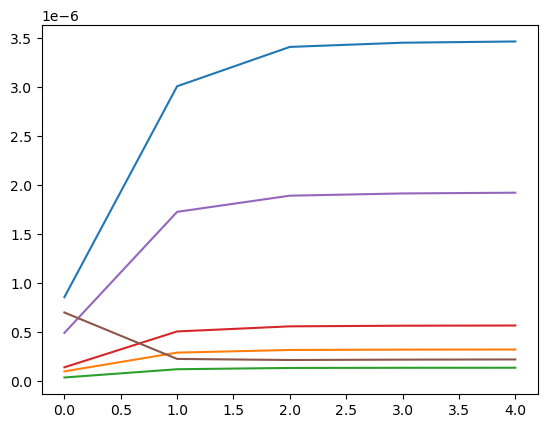

step: 0/1, D_loss: 0.123736344, G_loss_U: 4.0820456, G_loss_S: 0.06470055, E_loss_t0: 1.9973369


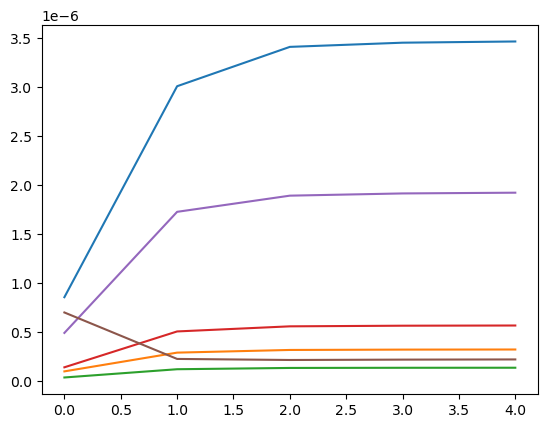

step: 0/1, D_loss: 0.12786642, G_loss_U: 4.082045, G_loss_S: 0.064722106, E_loss_t0: 2.1463168


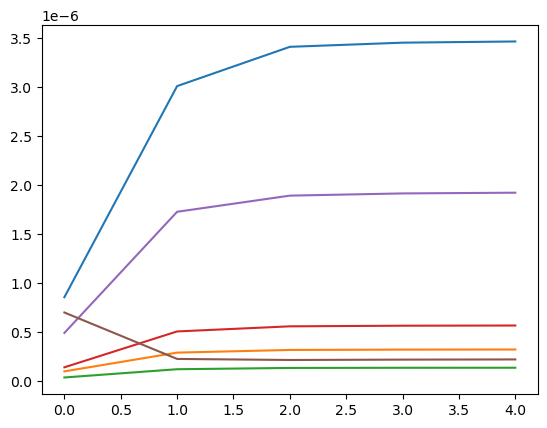

step: 0/1, D_loss: 0.11790187, G_loss_U: 4.082045, G_loss_S: 0.06475244, E_loss_t0: 1.7202556


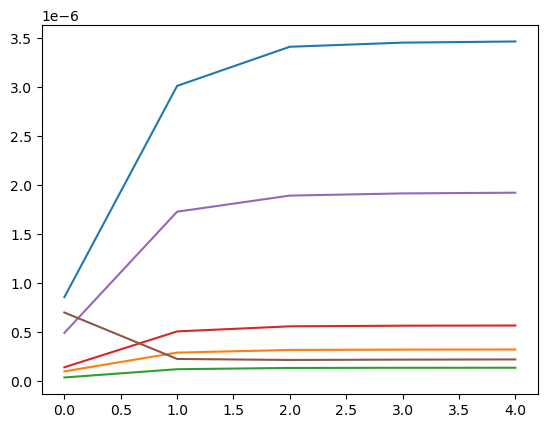

step: 0/1, D_loss: 0.11684893, G_loss_U: 4.0820446, G_loss_S: 0.064693205, E_loss_t0: 1.9191738


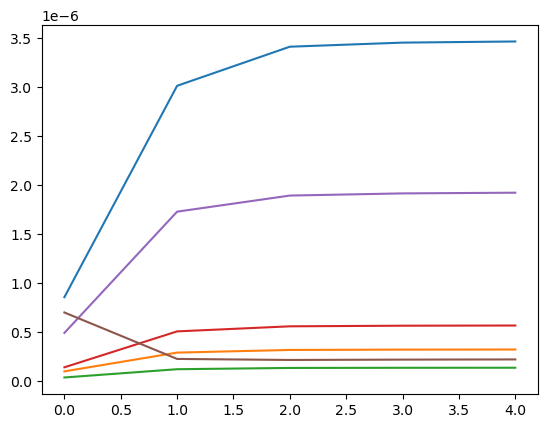

step: 0/1, D_loss: 0.12384765, G_loss_U: 4.082044, G_loss_S: 0.064680666, E_loss_t0: 2.1314683


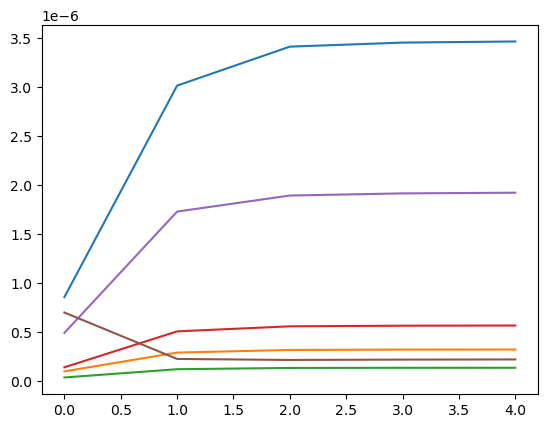

step: 0/1, D_loss: 0.11626196, G_loss_U: 4.082043, G_loss_S: 0.064762086, E_loss_t0: 1.3143245


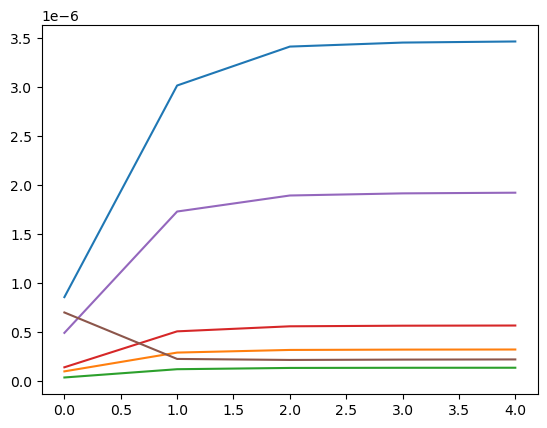

step: 0/1, D_loss: 0.12346359, G_loss_U: 4.082043, G_loss_S: 0.064653784, E_loss_t0: 2.040314


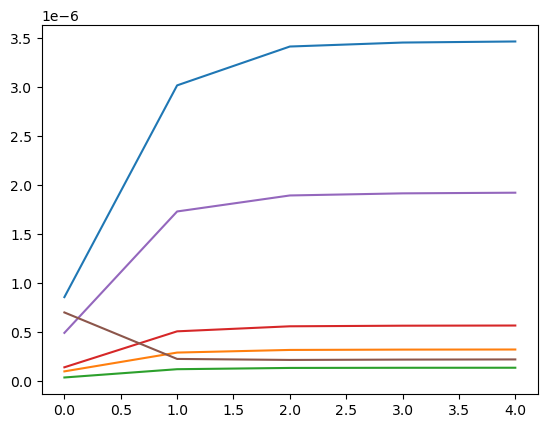

step: 0/1, D_loss: 0.117524825, G_loss_U: 4.0820427, G_loss_S: 0.06470738, E_loss_t0: 1.6840844


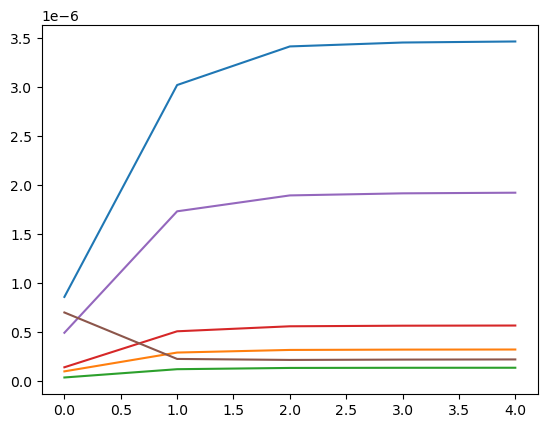

step: 0/1, D_loss: 0.11468997, G_loss_U: 4.0820427, G_loss_S: 0.064618185, E_loss_t0: 1.5347441


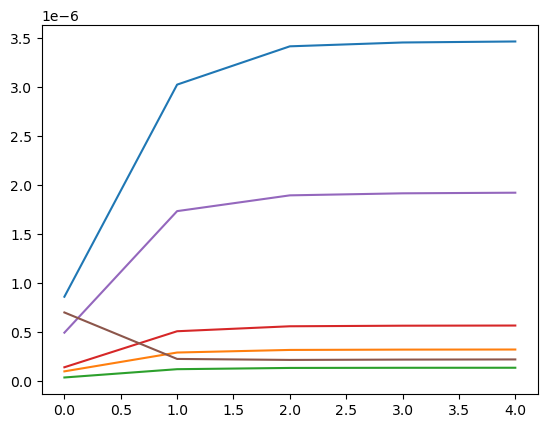

step: 0/1, D_loss: 0.115494534, G_loss_U: 4.082042, G_loss_S: 0.06458689, E_loss_t0: 1.6161349


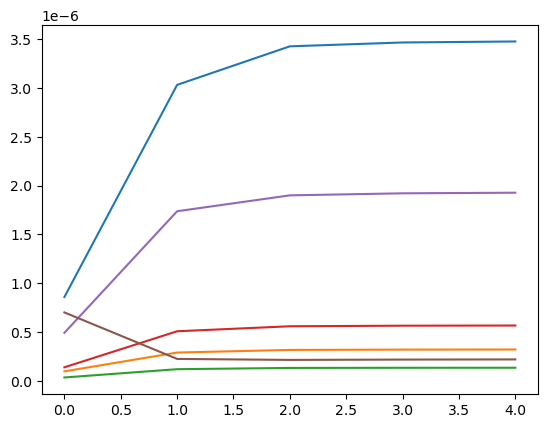

step: 0/1, D_loss: 0.13088822, G_loss_U: 4.082042, G_loss_S: 0.0645718, E_loss_t0: 2.152943


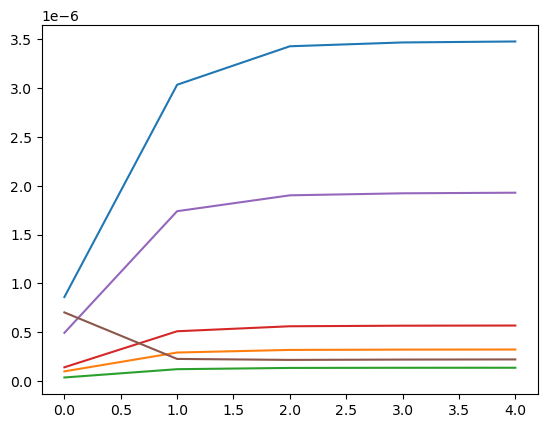

step: 0/1, D_loss: 0.117562495, G_loss_U: 4.0820417, G_loss_S: 0.06462056, E_loss_t0: 1.7802855


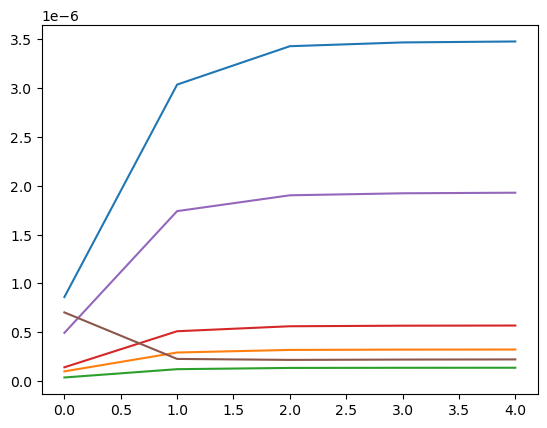

step: 0/1, D_loss: 0.11939268, G_loss_U: 4.0820413, G_loss_S: 0.06455257, E_loss_t0: 1.8520583


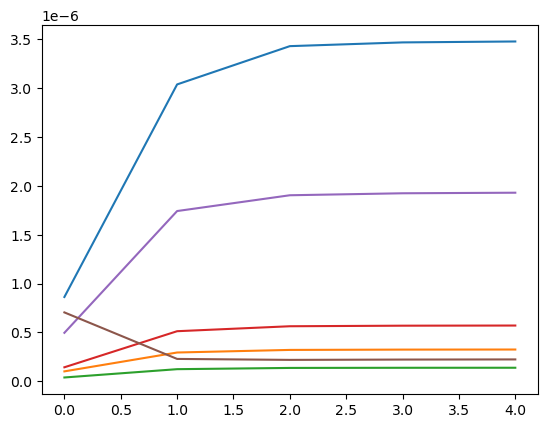

step: 0/1, D_loss: 0.11841801, G_loss_U: 4.0820403, G_loss_S: 0.06450733, E_loss_t0: 2.0072532


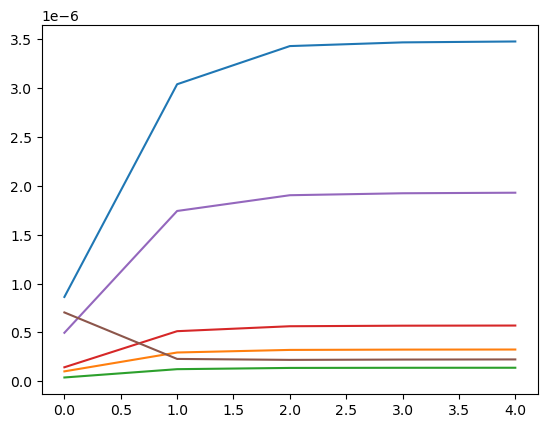

step: 0/1, D_loss: 0.115601234, G_loss_U: 4.0820403, G_loss_S: 0.06454152, E_loss_t0: 1.6534461


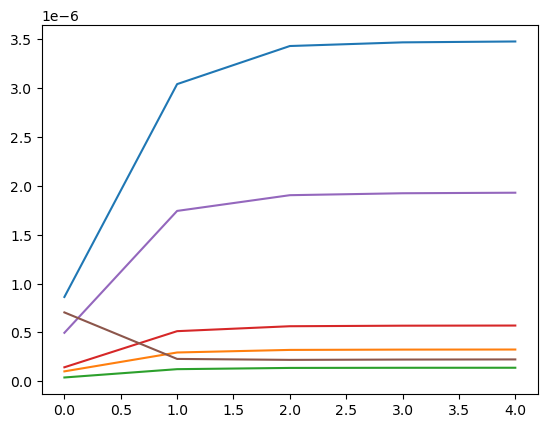

step: 0/1, D_loss: 0.11727457, G_loss_U: 4.0820403, G_loss_S: 0.064607345, E_loss_t0: 1.6975222


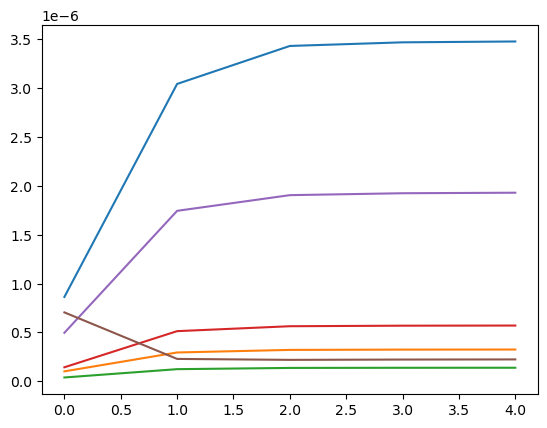

step: 0/1, D_loss: 0.1313416, G_loss_U: 4.0820384, G_loss_S: 0.06456265, E_loss_t0: 2.049072


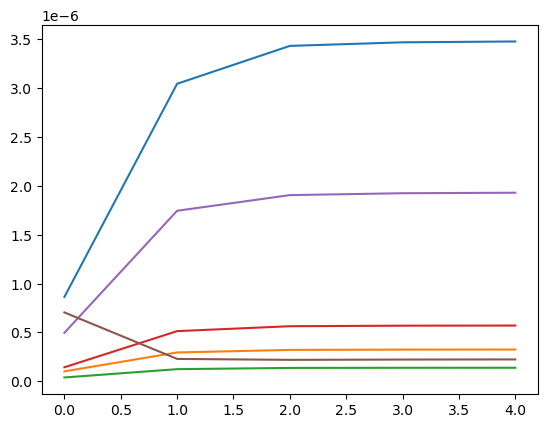

step: 0/1, D_loss: 0.12695381, G_loss_U: 4.0820394, G_loss_S: 0.06452832, E_loss_t0: 2.1852565


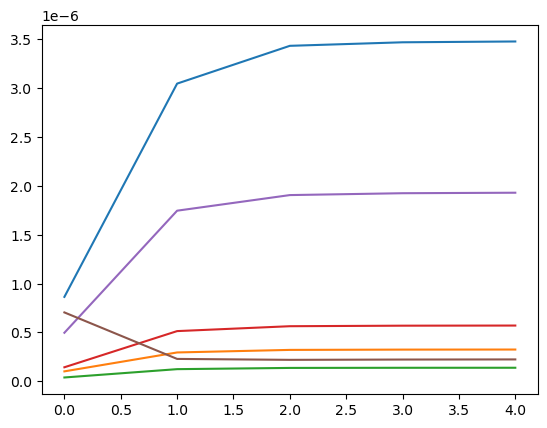

step: 0/1, D_loss: 0.14908138, G_loss_U: 4.0820384, G_loss_S: 0.06448537, E_loss_t0: 2.5319152


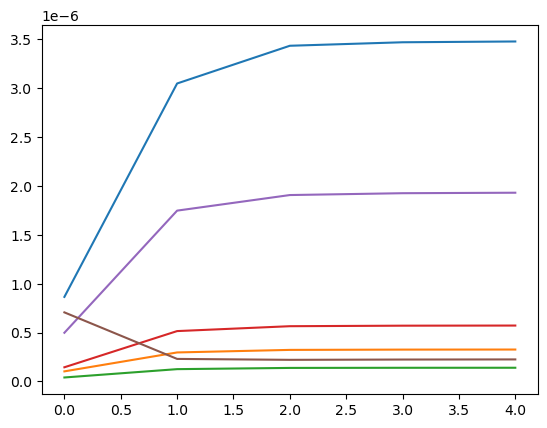

step: 0/1, D_loss: 0.121301115, G_loss_U: 4.0820374, G_loss_S: 0.06444825, E_loss_t0: 2.1182036


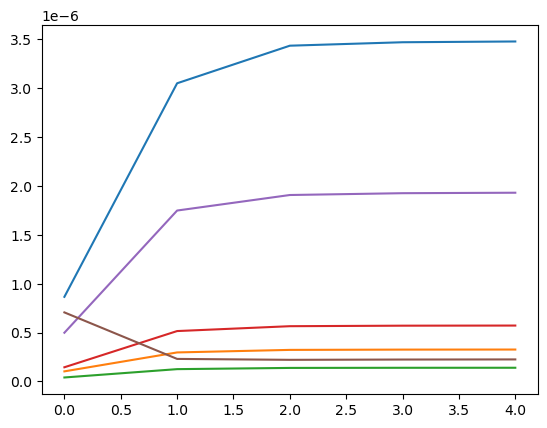

step: 0/1, D_loss: 0.11770106, G_loss_U: 4.0820374, G_loss_S: 0.064471304, E_loss_t0: 1.9000618


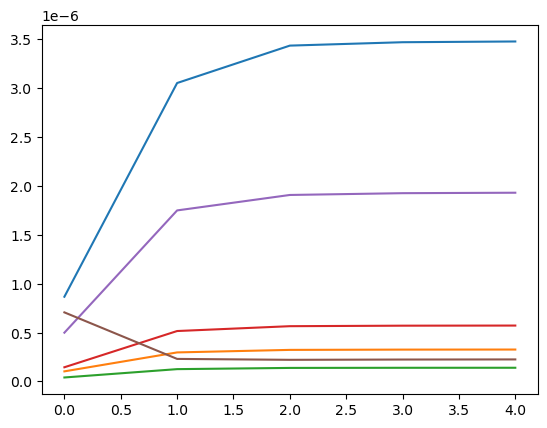

step: 0/1, D_loss: 0.116336696, G_loss_U: 4.082037, G_loss_S: 0.06451832, E_loss_t0: 1.3668705


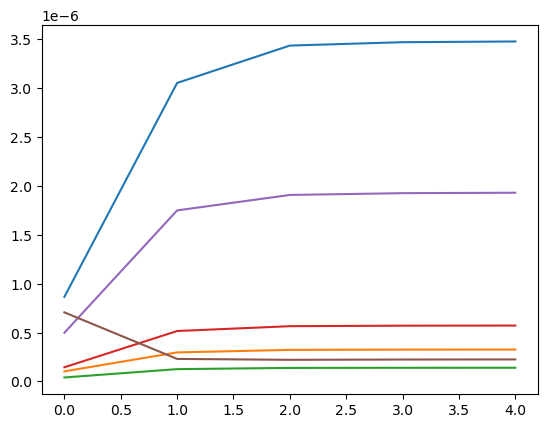

step: 0/1, D_loss: 0.13960789, G_loss_U: 4.082037, G_loss_S: 0.064441614, E_loss_t0: 2.3172152


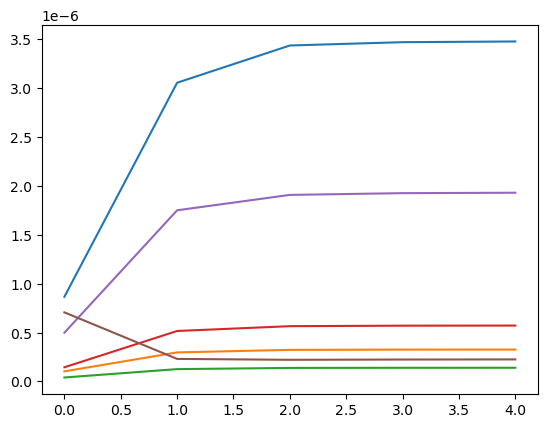

step: 0/1, D_loss: 0.11504537, G_loss_U: 4.082036, G_loss_S: 0.06446245, E_loss_t0: 1.4032642


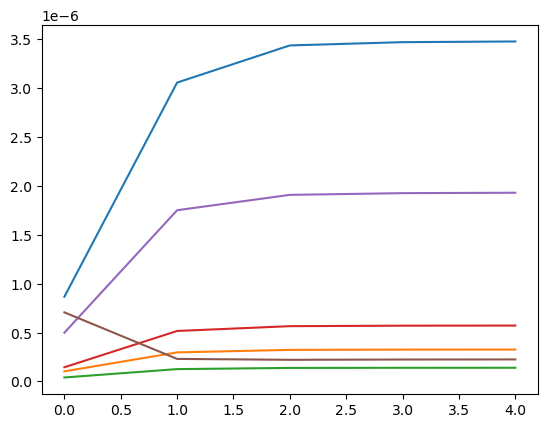

step: 0/1, D_loss: 0.11685741, G_loss_U: 4.082036, G_loss_S: 0.064463444, E_loss_t0: 1.6402985


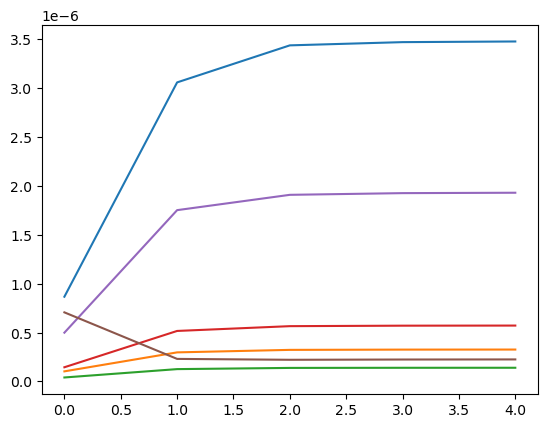

step: 0/1, D_loss: 0.12921071, G_loss_U: 4.082035, G_loss_S: 0.06442377, E_loss_t0: 1.9703978


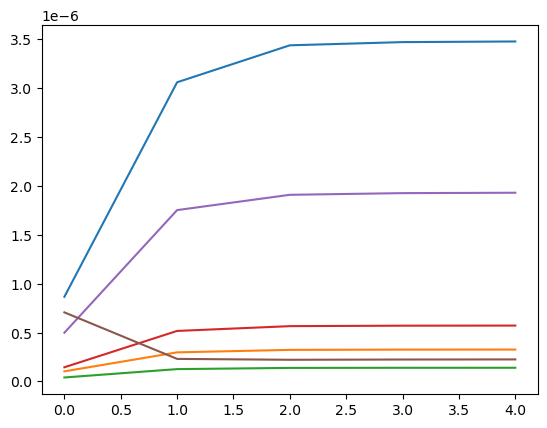

step: 0/1, D_loss: 0.12199631, G_loss_U: 4.082035, G_loss_S: 0.064416036, E_loss_t0: 1.969557


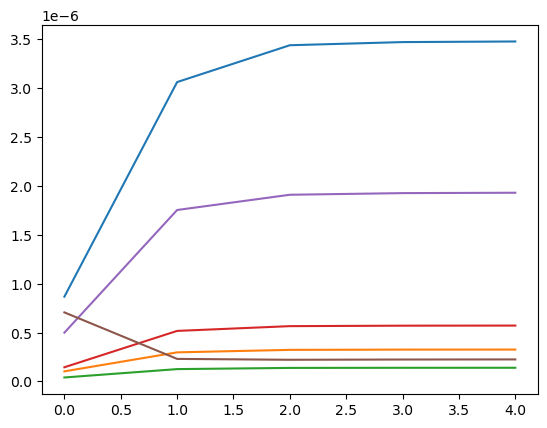

step: 0/1, D_loss: 0.120880514, G_loss_U: 4.0820346, G_loss_S: 0.06433879, E_loss_t0: 1.9885203


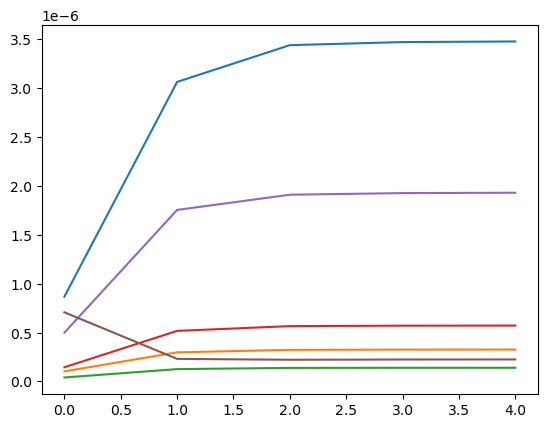

step: 0/1, D_loss: 0.13745056, G_loss_U: 4.0820336, G_loss_S: 0.06431511, E_loss_t0: 2.3935397


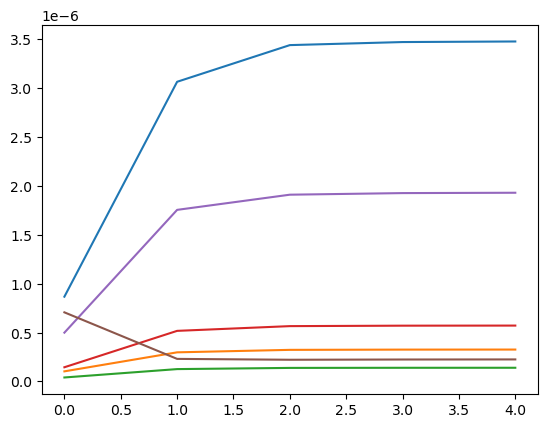

step: 0/1, D_loss: 0.11858818, G_loss_U: 4.082033, G_loss_S: 0.064316794, E_loss_t0: 1.905415


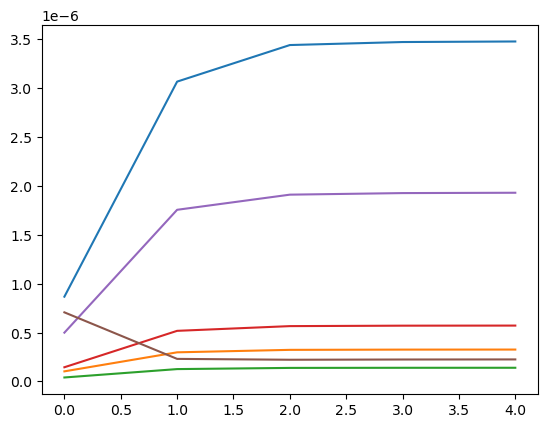

step: 0/1, D_loss: 0.117220305, G_loss_U: 4.0820327, G_loss_S: 0.0642741, E_loss_t0: 1.9178187


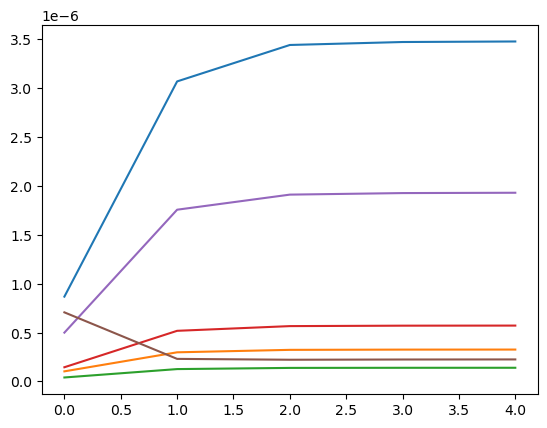

step: 0/1, D_loss: 0.115784325, G_loss_U: 4.0820327, G_loss_S: 0.06425705, E_loss_t0: 1.5439326


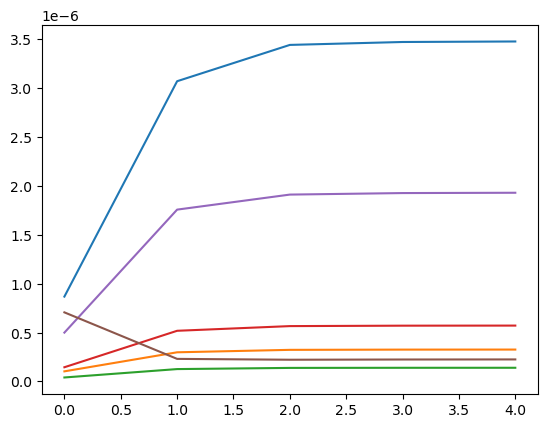

step: 0/1, D_loss: 0.11814736, G_loss_U: 4.0820317, G_loss_S: 0.06424748, E_loss_t0: 1.6621367


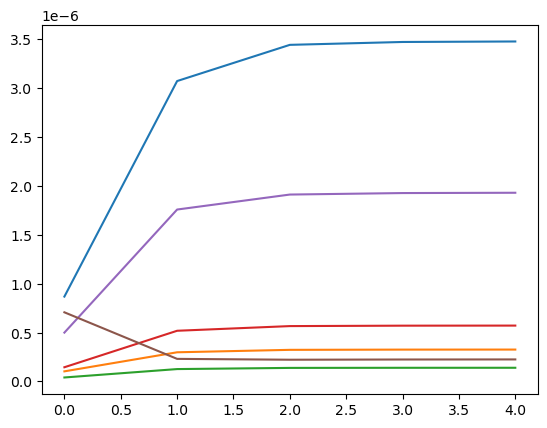

step: 0/1, D_loss: 0.11547807, G_loss_U: 4.0820312, G_loss_S: 0.064178064, E_loss_t0: 1.3866197


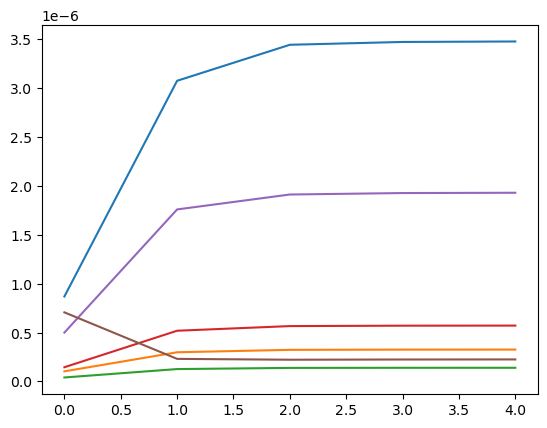

step: 0/1, D_loss: 0.12340674, G_loss_U: 4.082031, G_loss_S: 0.06408304, E_loss_t0: 2.1033914


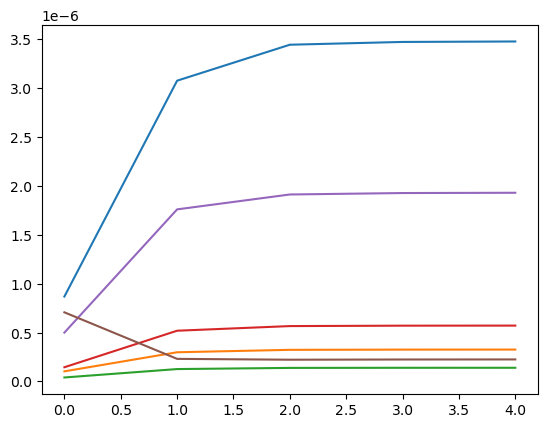

step: 0/1, D_loss: 0.11566666, G_loss_U: 4.0820303, G_loss_S: 0.06401322, E_loss_t0: 1.6235468


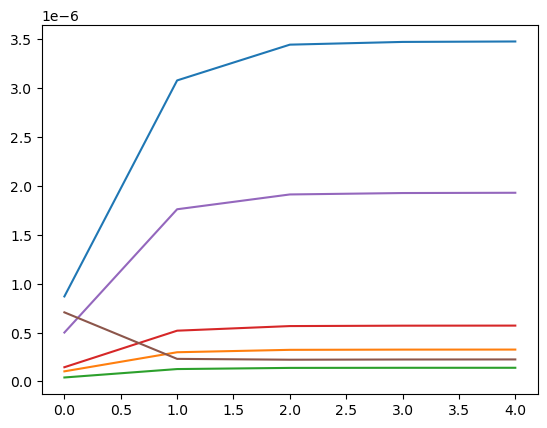

step: 0/1, D_loss: 0.117512405, G_loss_U: 4.08203, G_loss_S: 0.0639096, E_loss_t0: 1.8787974


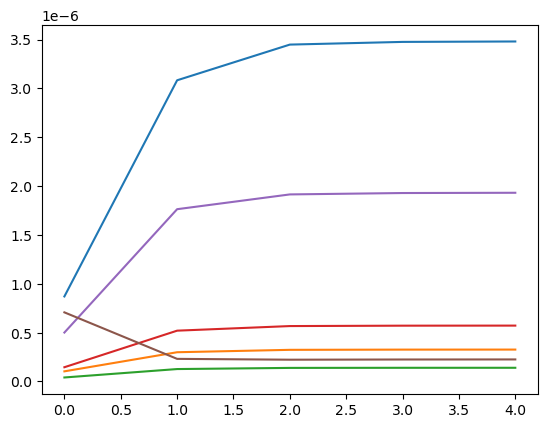

step: 0/1, D_loss: 0.11631949, G_loss_U: 4.08203, G_loss_S: 0.06378316, E_loss_t0: 1.3514179


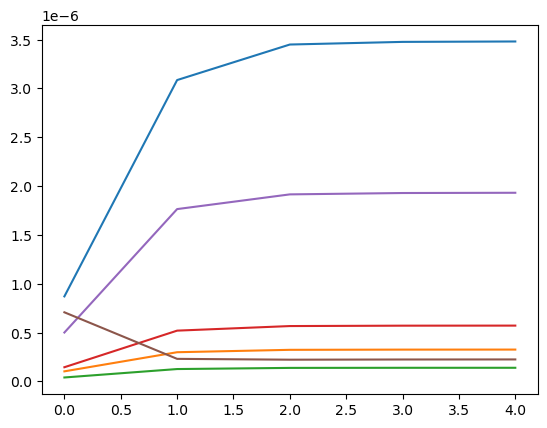

step: 0/1, D_loss: 0.117212154, G_loss_U: 4.082029, G_loss_S: 0.063620076, E_loss_t0: 1.4949894


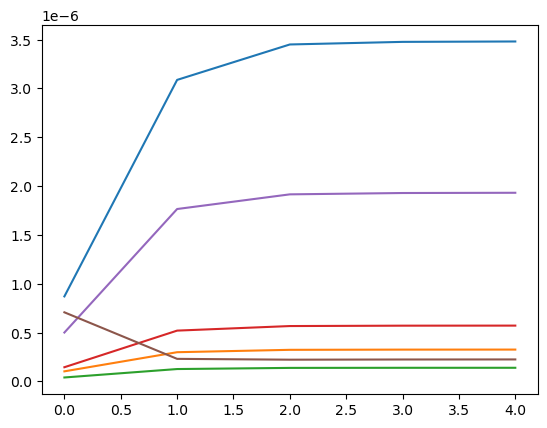

step: 0/1, D_loss: 0.12822743, G_loss_U: 4.0820284, G_loss_S: 0.06347032, E_loss_t0: 2.0037458


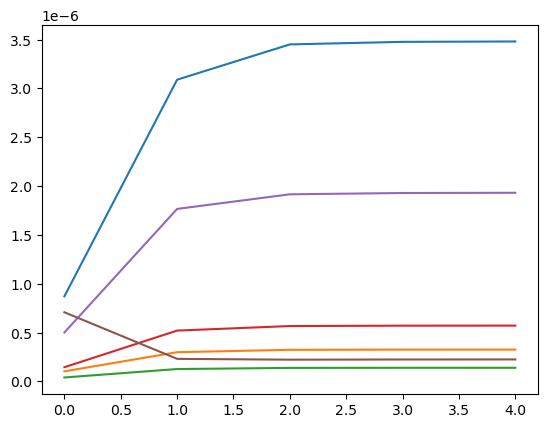

step: 0/1, D_loss: 0.11698747, G_loss_U: 4.0820284, G_loss_S: 0.06315893, E_loss_t0: 1.5847164


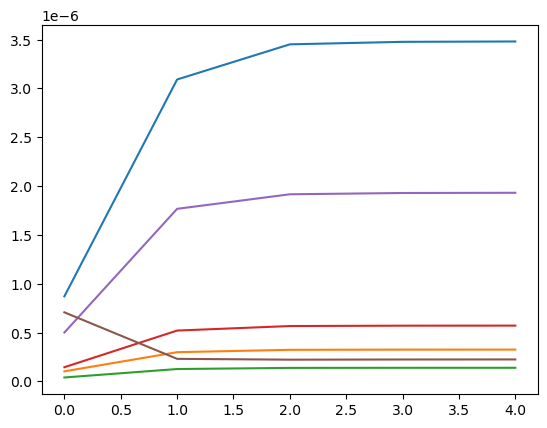

step: 0/1, D_loss: 0.12278331, G_loss_U: 4.0820274, G_loss_S: 0.06287221, E_loss_t0: 2.017146


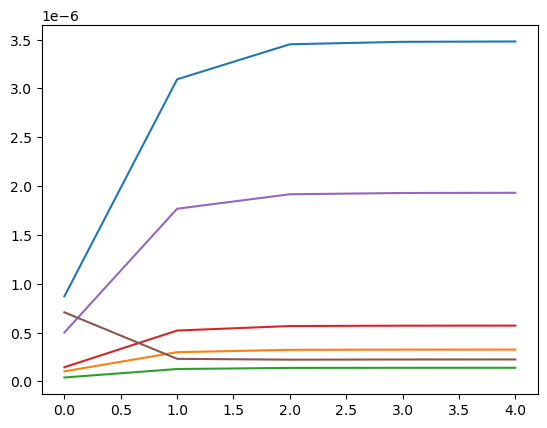

step: 0/1, D_loss: 0.11790644, G_loss_U: 4.0820274, G_loss_S: 0.062347263, E_loss_t0: 1.793231


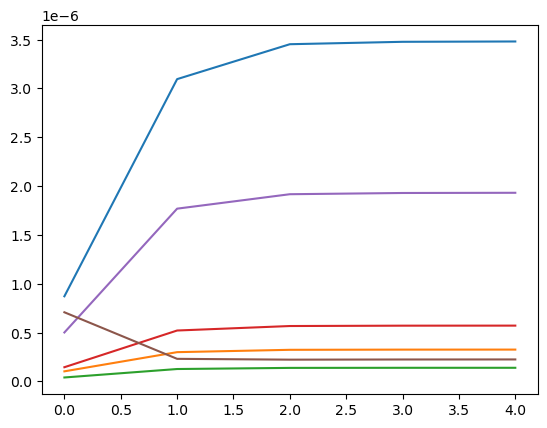

step: 0/1, D_loss: 0.11634617, G_loss_U: 4.0820265, G_loss_S: 0.061634365, E_loss_t0: 1.530434


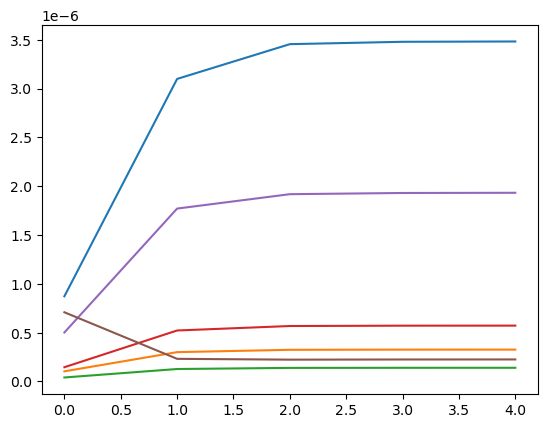

step: 0/1, D_loss: 0.13106877, G_loss_U: 4.0820255, G_loss_S: 0.0605916, E_loss_t0: 2.0031555


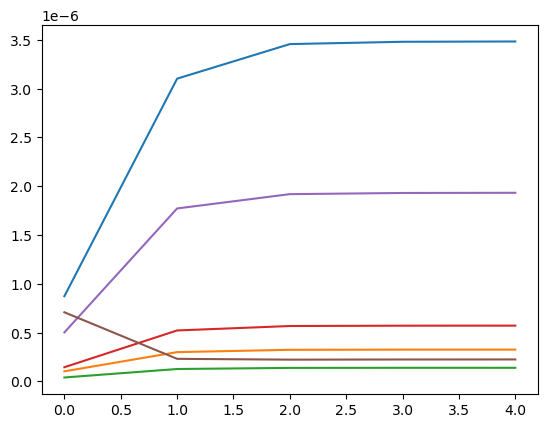

step: 0/1, D_loss: 0.12516302, G_loss_U: 4.0820255, G_loss_S: 0.059591368, E_loss_t0: 1.9915504


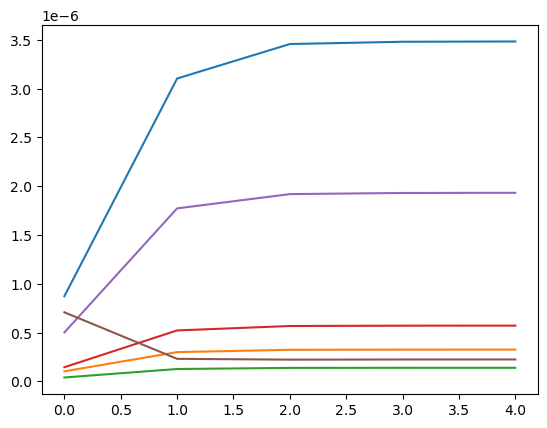

step: 0/1, D_loss: 0.12986906, G_loss_U: 4.082025, G_loss_S: 0.058495782, E_loss_t0: 2.1387312


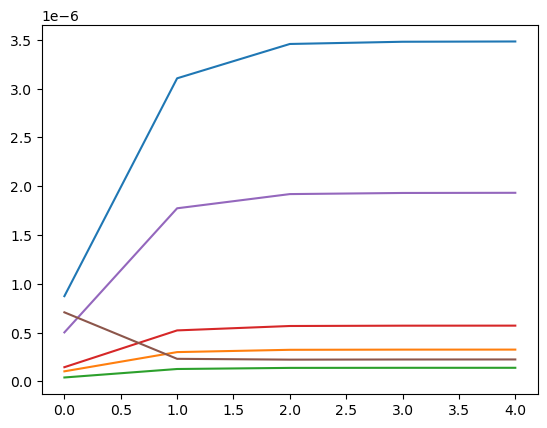

step: 0/1, D_loss: 0.12163976, G_loss_U: 4.082025, G_loss_S: 0.058059093, E_loss_t0: 1.4162661


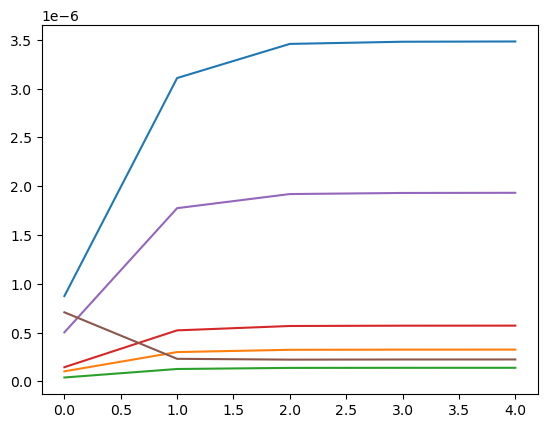

step: 0/1, D_loss: 0.13035837, G_loss_U: 4.082024, G_loss_S: 0.05827706, E_loss_t0: 1.9948109


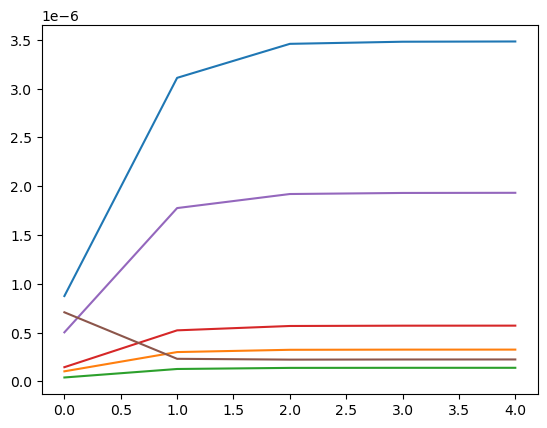

step: 0/1, D_loss: 0.13590877, G_loss_U: 4.082023, G_loss_S: 0.05882852, E_loss_t0: 2.2326725


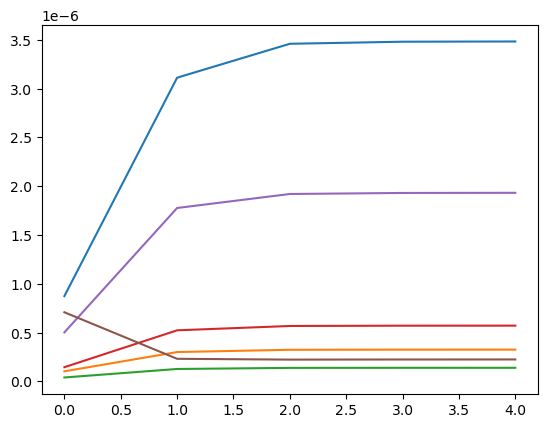

step: 0/1, D_loss: 0.14026749, G_loss_U: 4.0820227, G_loss_S: 0.05956389, E_loss_t0: 2.0879376


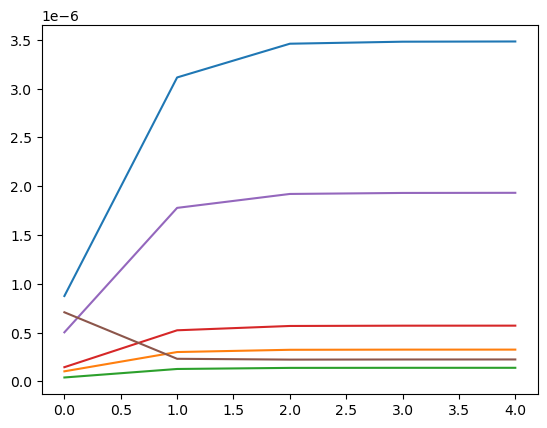

step: 0/1, D_loss: 0.12620838, G_loss_U: 4.082022, G_loss_S: 0.05990764, E_loss_t0: 1.337178


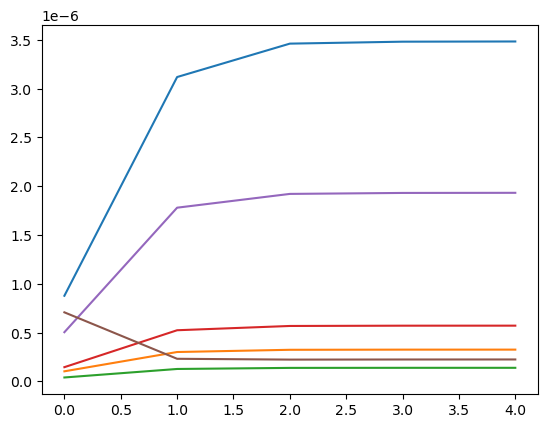

step: 0/1, D_loss: 0.1374978, G_loss_U: 4.0820217, G_loss_S: 0.059837766, E_loss_t0: 2.083698


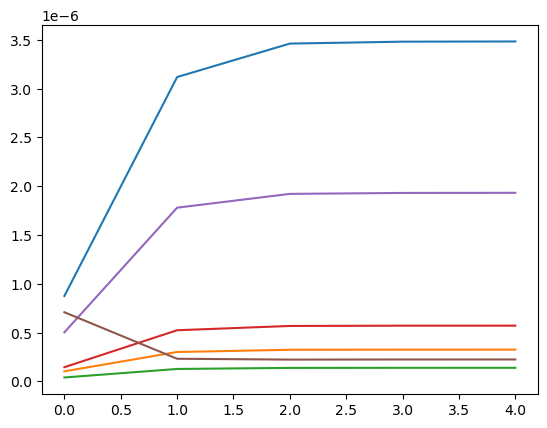

step: 0/1, D_loss: 0.14819482, G_loss_U: 4.0820208, G_loss_S: 0.059568968, E_loss_t0: 2.3591435


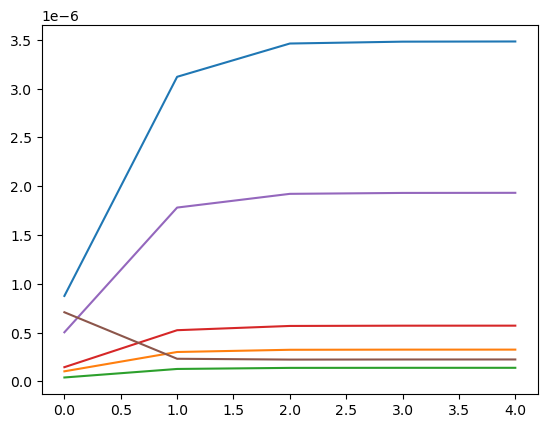

step: 0/1, D_loss: 0.14129588, G_loss_U: 4.0820203, G_loss_S: 0.05940654, E_loss_t0: 2.2489889


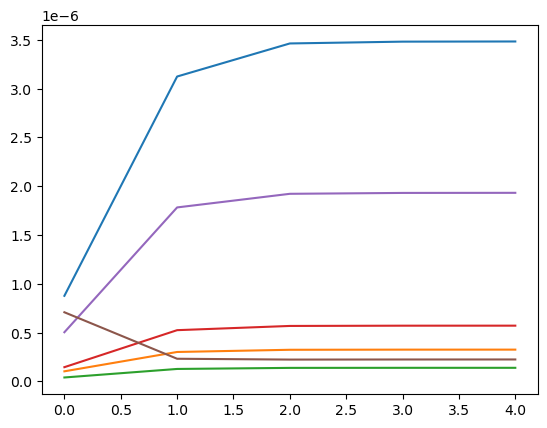

step: 0/1, D_loss: 0.16013964, G_loss_U: 4.270655, G_loss_S: 0.058939606, E_loss_t0: 2.46823


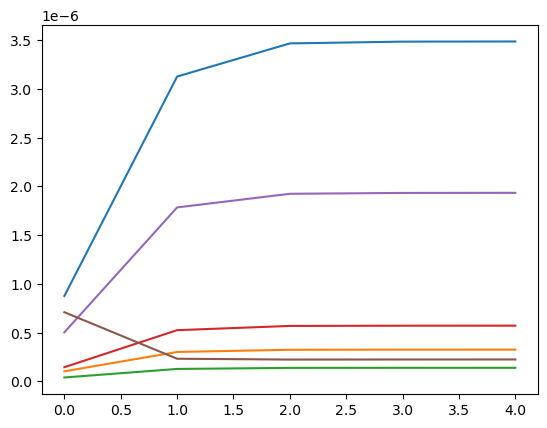

step: 0/1, D_loss: 0.10361438, G_loss_U: 4.2706556, G_loss_S: 0.059181675, E_loss_t0: 1.8827142


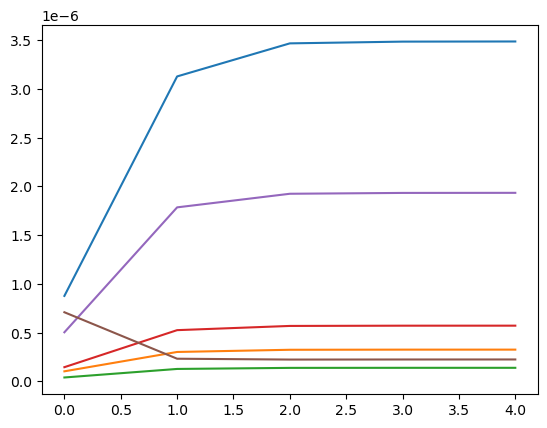

step: 0/1, D_loss: 0.10638409, G_loss_U: 4.2706556, G_loss_S: 0.060420807, E_loss_t0: 2.2119884


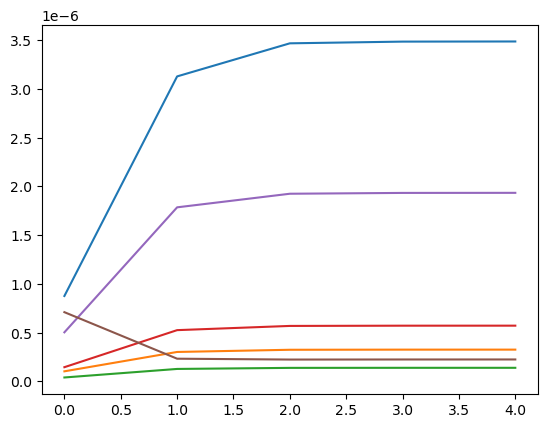

step: 0/1, D_loss: 0.095427155, G_loss_U: 4.270656, G_loss_S: 0.06130477, E_loss_t0: 1.952124


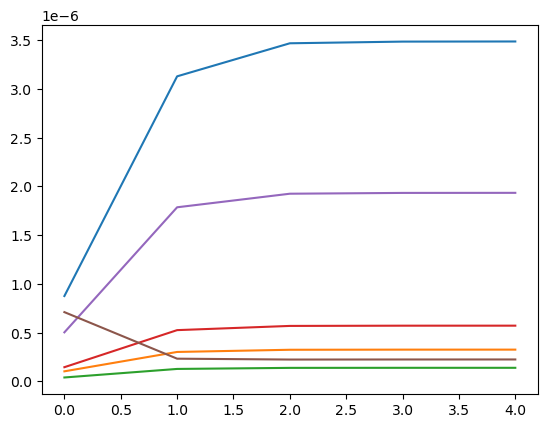

step: 0/1, D_loss: 0.10410784, G_loss_U: 4.2706566, G_loss_S: 0.062320083, E_loss_t0: 2.4512627


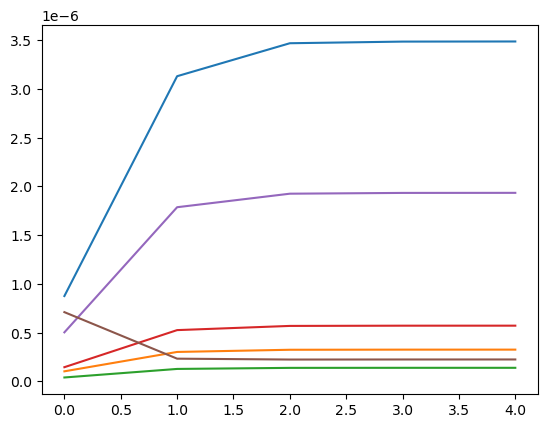

step: 0/1, D_loss: 0.10051973, G_loss_U: 4.2706566, G_loss_S: 0.06137173, E_loss_t0: 2.0823653


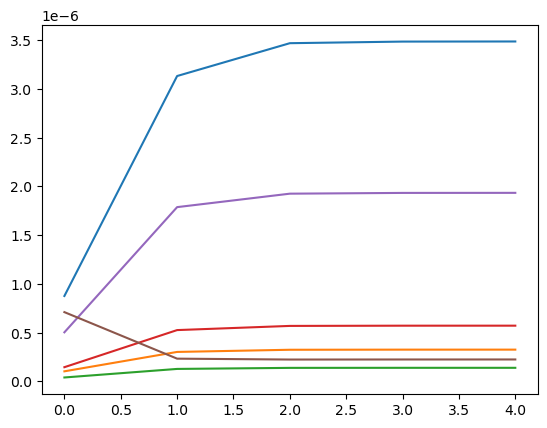

step: 0/1, D_loss: 0.09403819, G_loss_U: 4.270657, G_loss_S: 0.06103282, E_loss_t0: 1.7431861


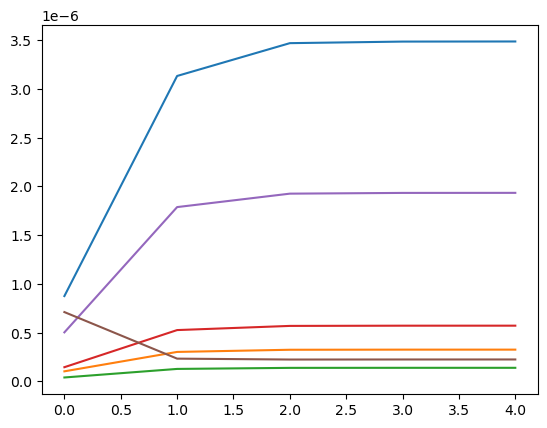

step: 0/1, D_loss: 0.096268654, G_loss_U: 4.2706566, G_loss_S: 0.06040447, E_loss_t0: 1.8895676


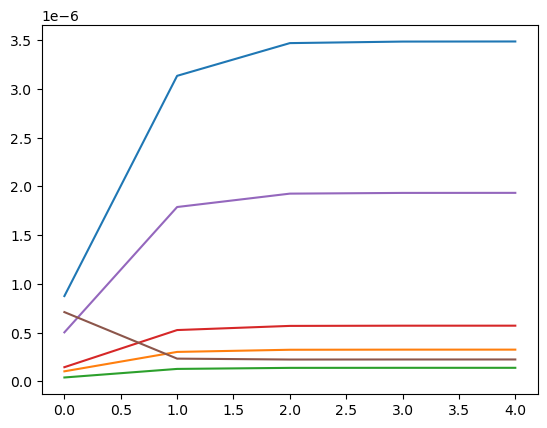

step: 0/1, D_loss: 0.09668323, G_loss_U: 4.270656, G_loss_S: 0.059526253, E_loss_t0: 1.4892824


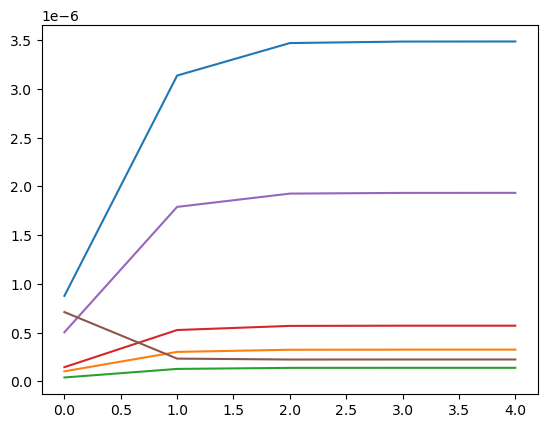

step: 0/1, D_loss: 0.10055875, G_loss_U: 4.2706556, G_loss_S: 0.05911674, E_loss_t0: 2.2056425


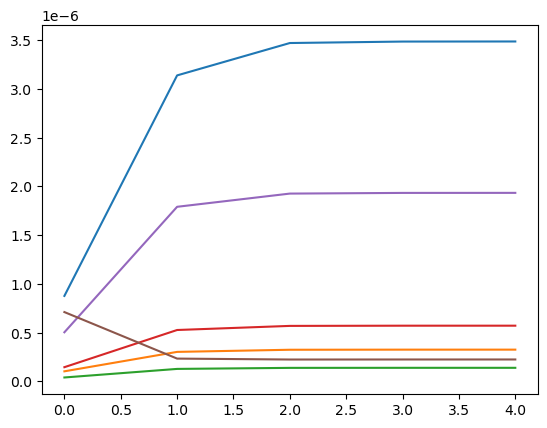

step: 0/1, D_loss: 0.09869078, G_loss_U: 4.2706556, G_loss_S: 0.05861148, E_loss_t0: 1.5972375


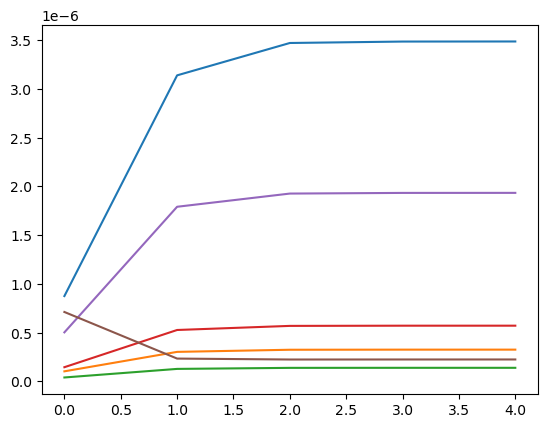

step: 0/1, D_loss: 0.09985345, G_loss_U: 4.2706556, G_loss_S: 0.058689117, E_loss_t0: 1.8409929


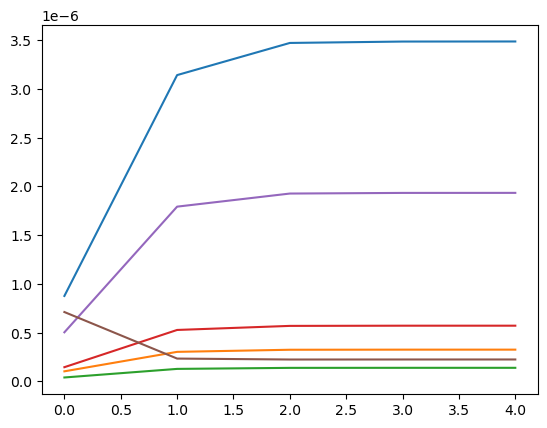

step: 0/1, D_loss: 0.108017735, G_loss_U: 4.2706556, G_loss_S: 0.05897769, E_loss_t0: 2.2915514


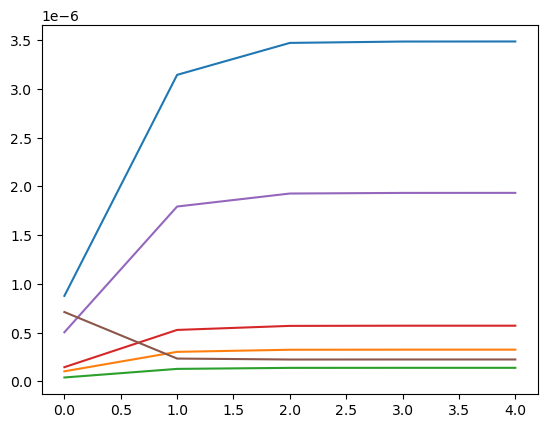

step: 0/1, D_loss: 0.10270381, G_loss_U: 4.2706556, G_loss_S: 0.059226137, E_loss_t0: 1.4945163


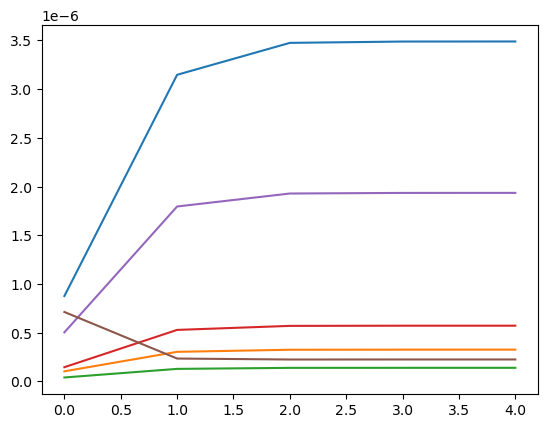

step: 0/1, D_loss: 0.10361131, G_loss_U: 4.270655, G_loss_S: 0.058932558, E_loss_t0: 1.9290061


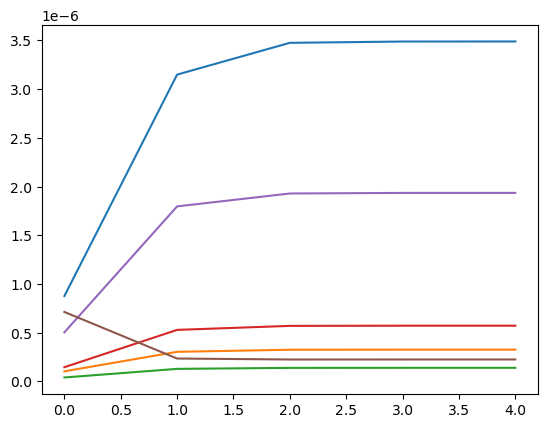

step: 0/1, D_loss: 0.10575215, G_loss_U: 4.2706547, G_loss_S: 0.05901804, E_loss_t0: 2.1423206


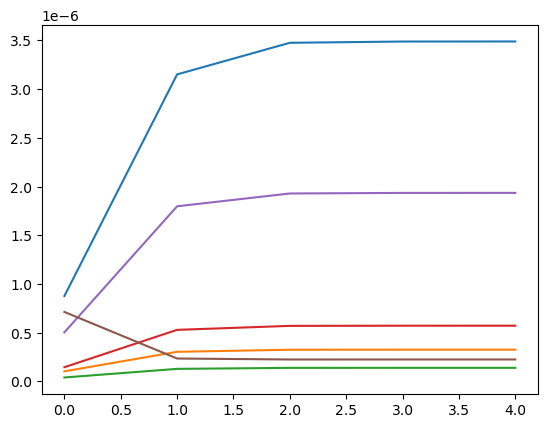

step: 0/1, D_loss: 0.108166896, G_loss_U: 4.270654, G_loss_S: 0.058776833, E_loss_t0: 2.1597369


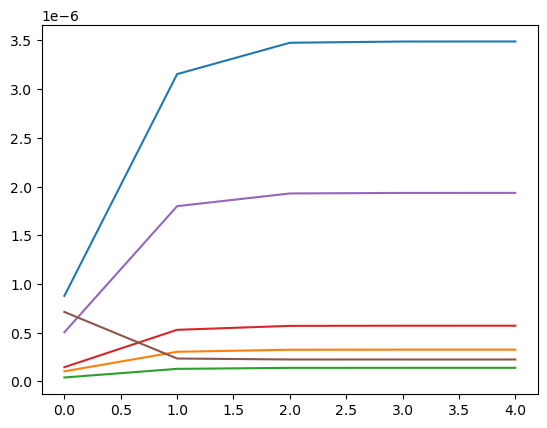

step: 0/1, D_loss: 0.10251746, G_loss_U: 4.270654, G_loss_S: 0.059020117, E_loss_t0: 1.72373


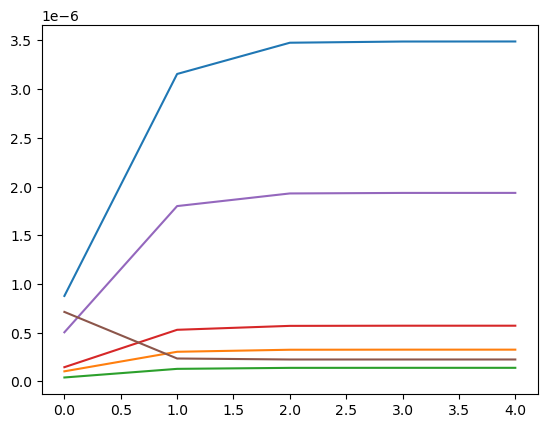

step: 0/1, D_loss: 0.10962911, G_loss_U: 4.2706532, G_loss_S: 0.05894307, E_loss_t0: 2.134977


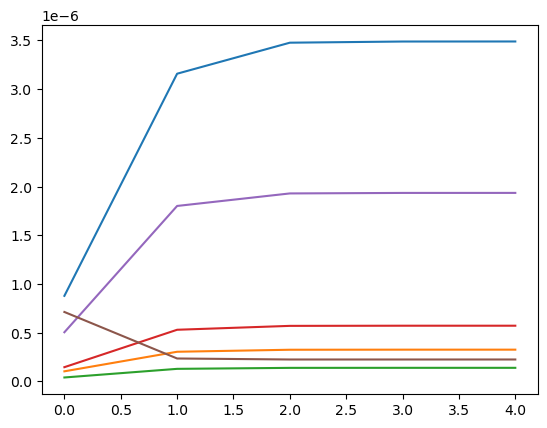

step: 0/1, D_loss: 0.10706003, G_loss_U: 4.2706532, G_loss_S: 0.058874086, E_loss_t0: 1.944998


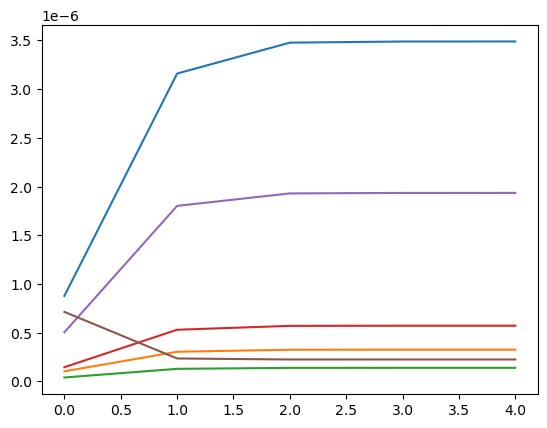

step: 0/1, D_loss: 0.098103955, G_loss_U: 4.270653, G_loss_S: 0.058339283, E_loss_t0: 1.6177795


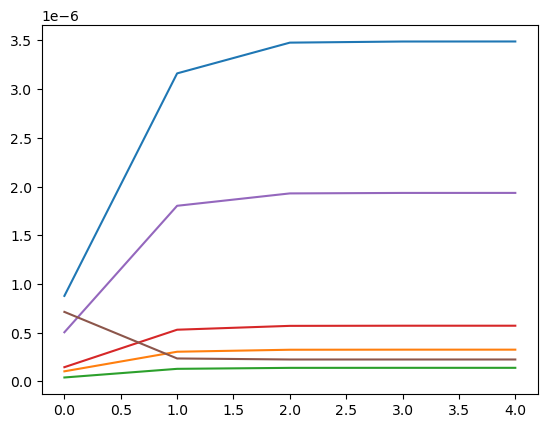

step: 0/1, D_loss: 0.106100604, G_loss_U: 4.2706523, G_loss_S: 0.058464438, E_loss_t0: 2.0311458


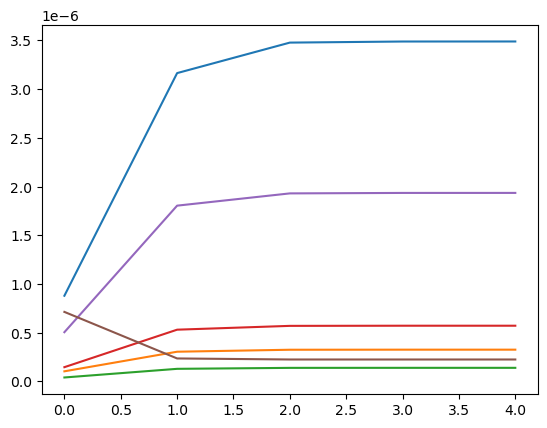

step: 0/1, D_loss: 0.10322065, G_loss_U: 4.2706523, G_loss_S: 0.058498174, E_loss_t0: 2.1415772


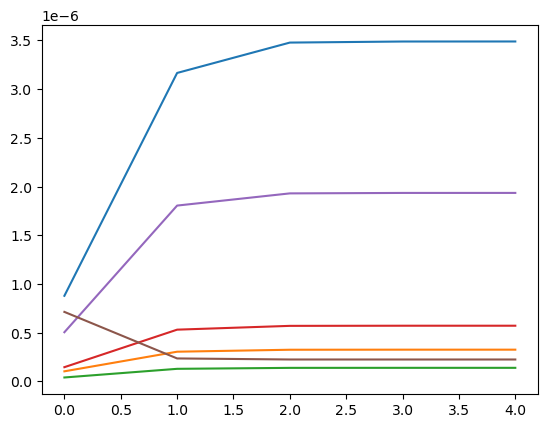

step: 0/1, D_loss: 0.100421146, G_loss_U: 4.2706513, G_loss_S: 0.05845865, E_loss_t0: 2.0167134


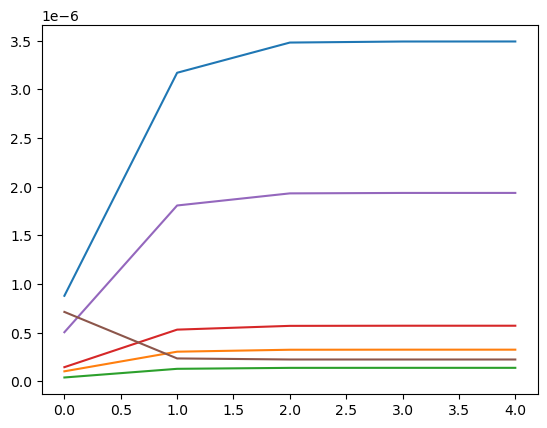

step: 0/1, D_loss: 0.097393446, G_loss_U: 4.270651, G_loss_S: 0.058247924, E_loss_t0: 1.402702


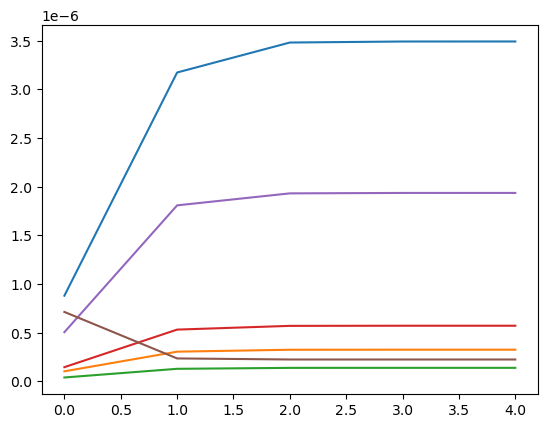

step: 0/1, D_loss: 0.10201222, G_loss_U: 4.270651, G_loss_S: 0.05852774, E_loss_t0: 2.157898


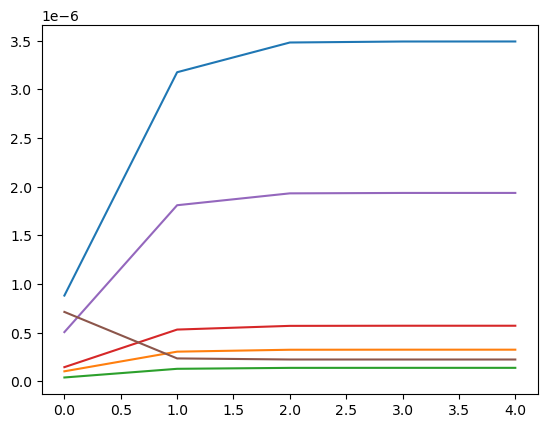

step: 0/1, D_loss: 0.09661196, G_loss_U: 4.27065, G_loss_S: 0.058346275, E_loss_t0: 1.6878244


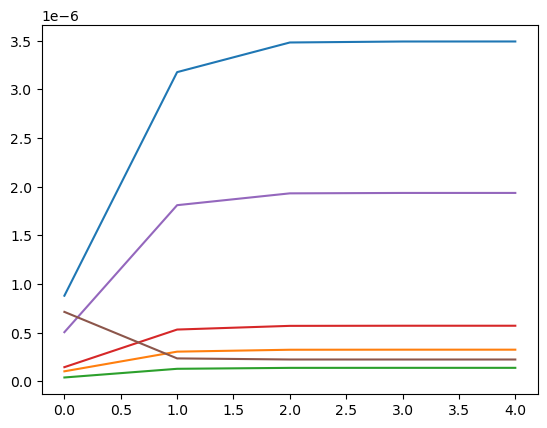

step: 0/1, D_loss: 0.09804343, G_loss_U: 4.27065, G_loss_S: 0.058256883, E_loss_t0: 1.4340334


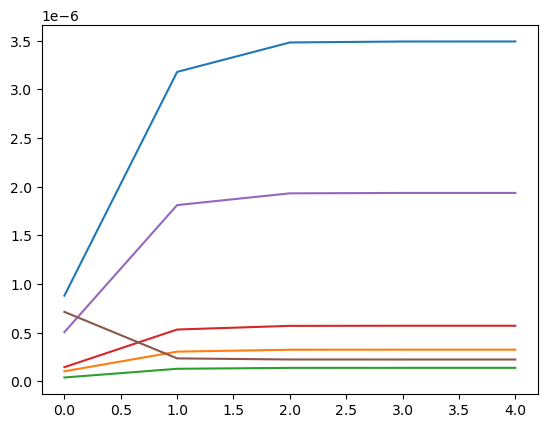

step: 0/1, D_loss: 0.10325789, G_loss_U: 4.270649, G_loss_S: 0.058243375, E_loss_t0: 2.0916858


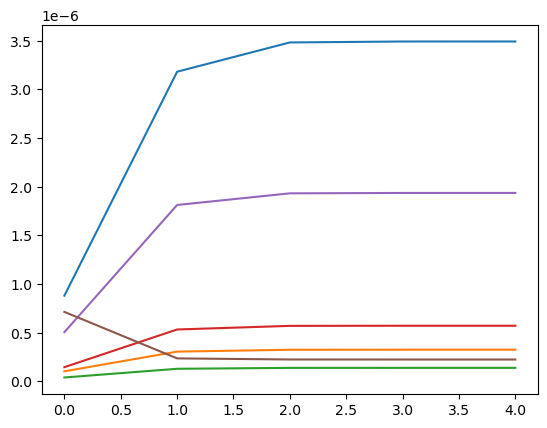

step: 0/1, D_loss: 0.09755995, G_loss_U: 4.2706485, G_loss_S: 0.058062553, E_loss_t0: 1.6289577


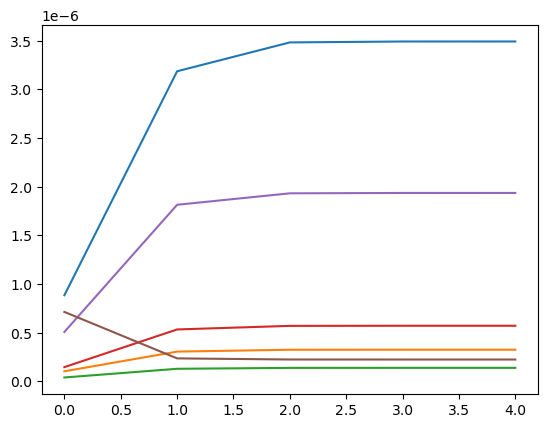

step: 0/1, D_loss: 0.100471854, G_loss_U: 4.270647, G_loss_S: 0.058469947, E_loss_t0: 1.8192581


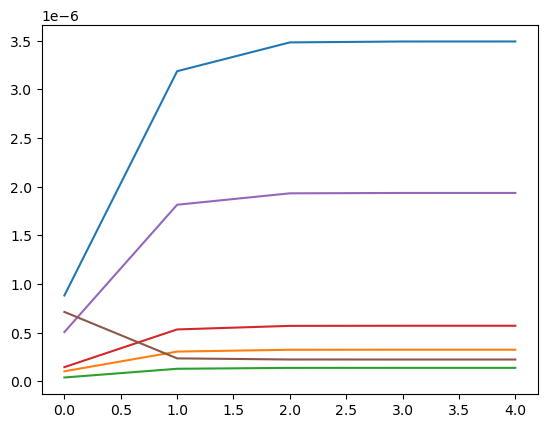

step: 0/1, D_loss: 0.10268442, G_loss_U: 4.270647, G_loss_S: 0.058019843, E_loss_t0: 2.102047


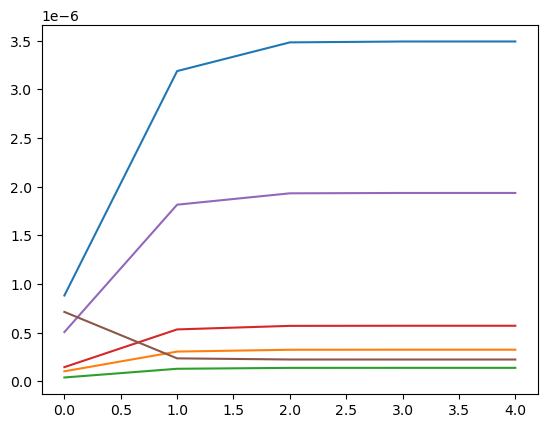

step: 0/1, D_loss: 0.09966385, G_loss_U: 4.2706466, G_loss_S: 0.058137003, E_loss_t0: 1.8404787


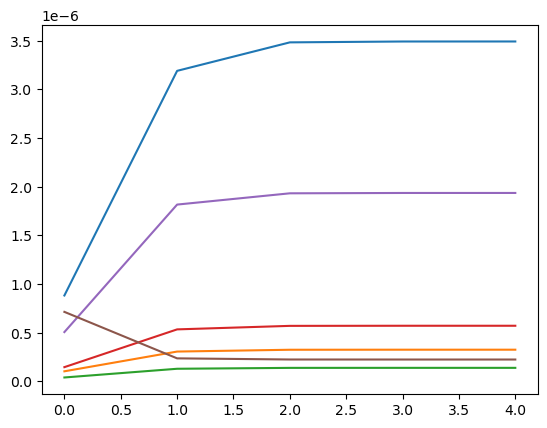

step: 0/1, D_loss: 0.09877694, G_loss_U: 4.2706456, G_loss_S: 0.058121204, E_loss_t0: 1.5532545


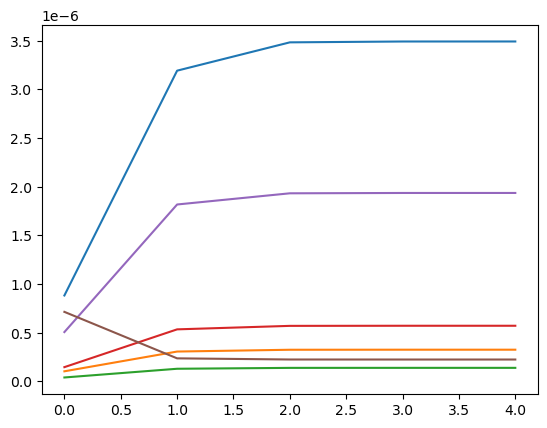

step: 0/1, D_loss: 0.10707541, G_loss_U: 4.2706456, G_loss_S: 0.058089852, E_loss_t0: 2.2490745


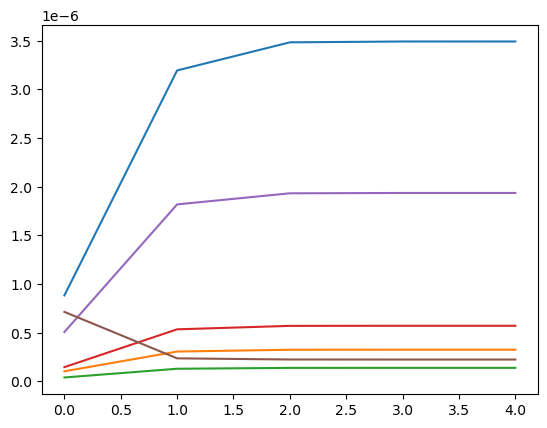

step: 0/1, D_loss: 0.1077959, G_loss_U: 4.2706447, G_loss_S: 0.05814168, E_loss_t0: 2.1758614


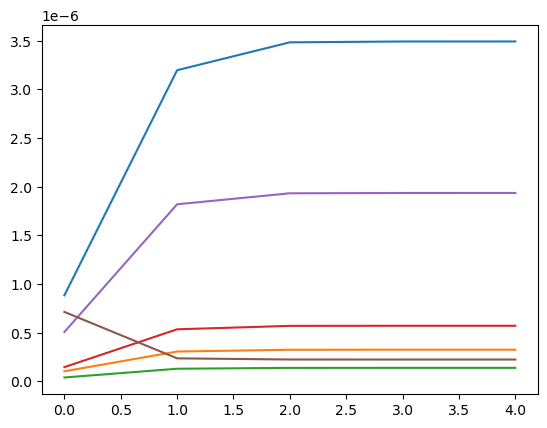

step: 0/1, D_loss: 0.098516315, G_loss_U: 4.270643, G_loss_S: 0.05804737, E_loss_t0: 1.6576017


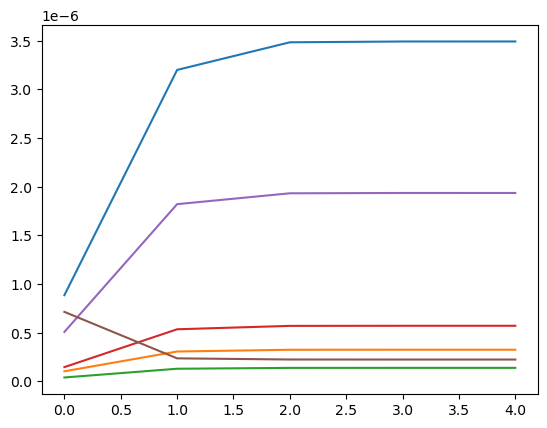

step: 0/1, D_loss: 0.09958727, G_loss_U: 4.270643, G_loss_S: 0.058192283, E_loss_t0: 1.4552715


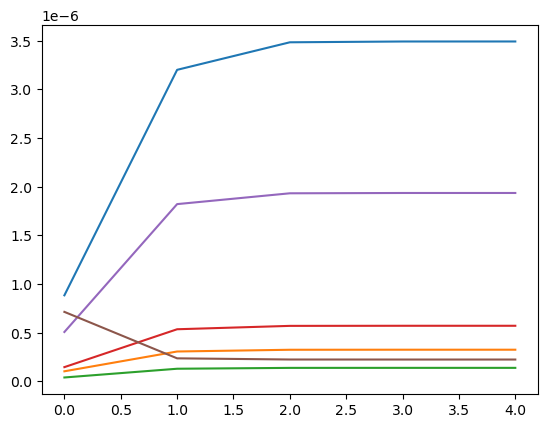

step: 0/1, D_loss: 0.107646614, G_loss_U: 4.2706428, G_loss_S: 0.058085088, E_loss_t0: 2.0821362


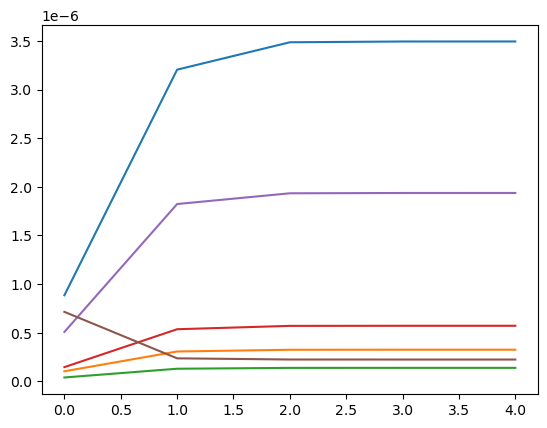

step: 0/1, D_loss: 0.09878219, G_loss_U: 4.2706423, G_loss_S: 0.05806565, E_loss_t0: 1.403459


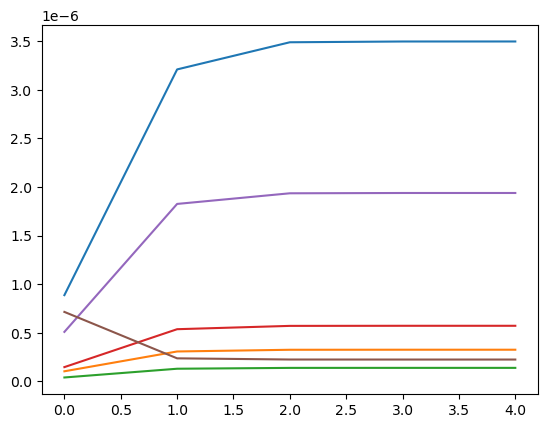

step: 0/1, D_loss: 0.09842721, G_loss_U: 4.2706413, G_loss_S: 0.057953224, E_loss_t0: 1.8358978


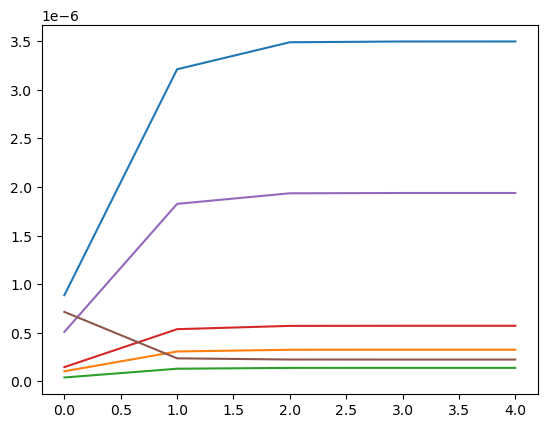

step: 0/1, D_loss: 0.09860285, G_loss_U: 4.270641, G_loss_S: 0.057997487, E_loss_t0: 1.2660658


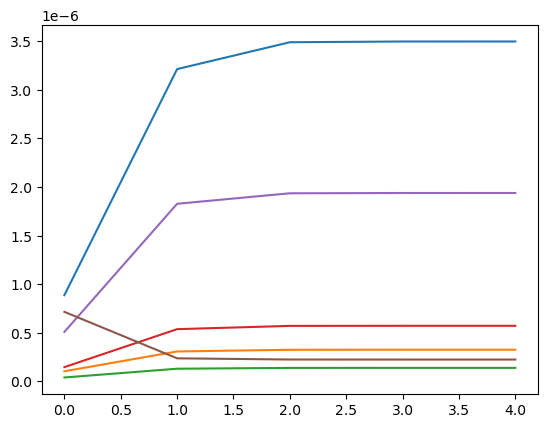

step: 0/1, D_loss: 0.1007637, G_loss_U: 4.2706394, G_loss_S: 0.05804411, E_loss_t0: 1.9999316


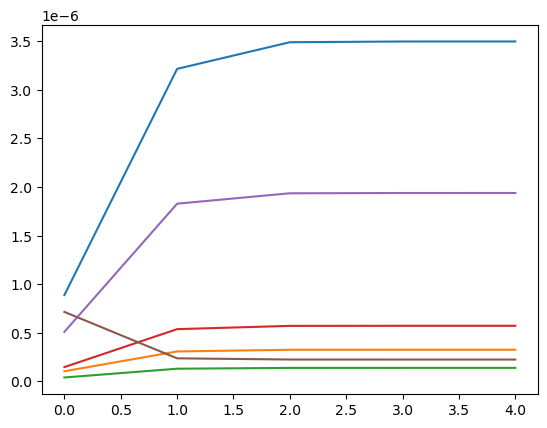

step: 0/1, D_loss: 0.10512265, G_loss_U: 4.2706394, G_loss_S: 0.05884012, E_loss_t0: 1.9749383


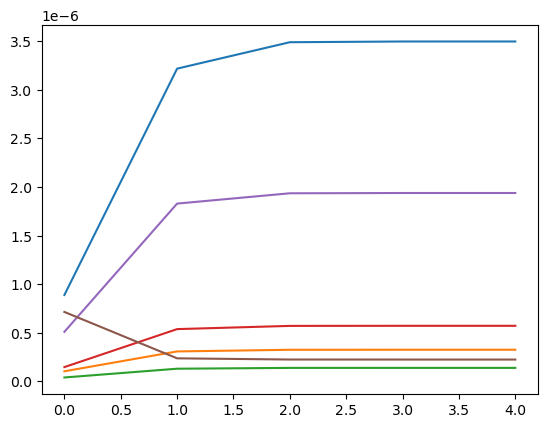

step: 0/1, D_loss: 0.09807382, G_loss_U: 4.270639, G_loss_S: 0.0580282, E_loss_t0: 1.7955154


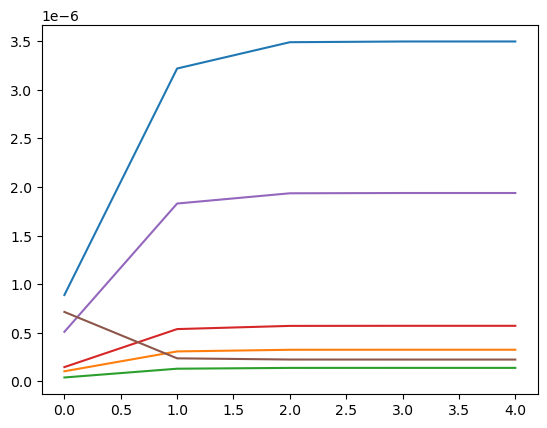

step: 0/1, D_loss: 0.10318087, G_loss_U: 4.270638, G_loss_S: 0.05801168, E_loss_t0: 2.2400682


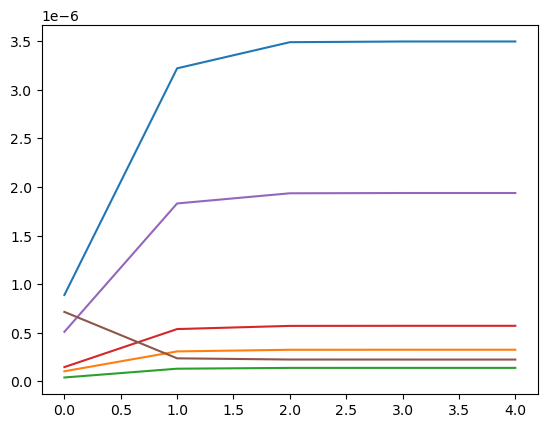

step: 0/1, D_loss: 0.099803485, G_loss_U: 4.2706375, G_loss_S: 0.05802431, E_loss_t0: 1.956862


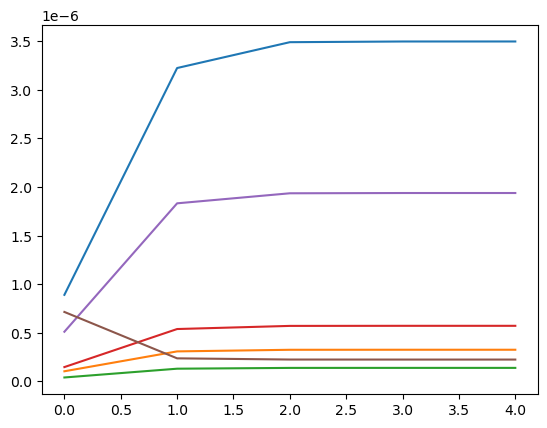

step: 0/1, D_loss: 0.099285185, G_loss_U: 4.2706366, G_loss_S: 0.05793534, E_loss_t0: 1.9077699


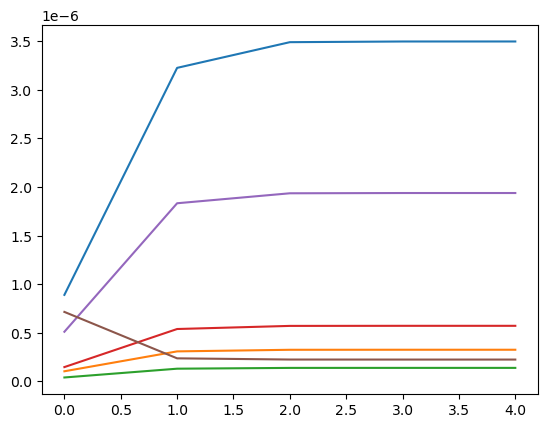

step: 0/1, D_loss: 0.09880045, G_loss_U: 4.2706356, G_loss_S: 0.057918295, E_loss_t0: 1.6621172


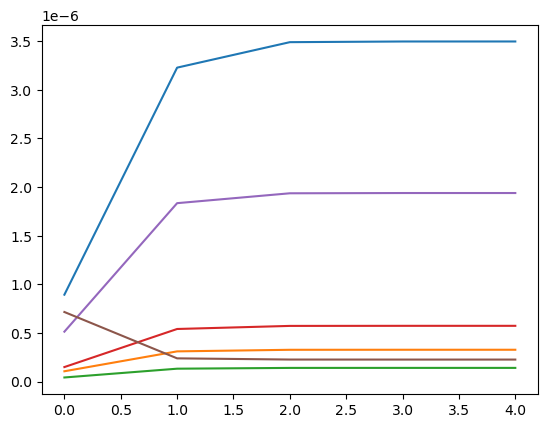

step: 0/1, D_loss: 0.10060935, G_loss_U: 4.2706347, G_loss_S: 0.057858154, E_loss_t0: 2.0914369


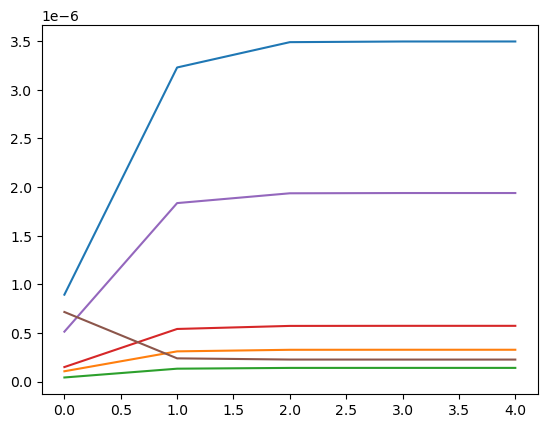

step: 0/1, D_loss: 0.098887116, G_loss_U: 4.270634, G_loss_S: 0.057925653, E_loss_t0: 1.7504938


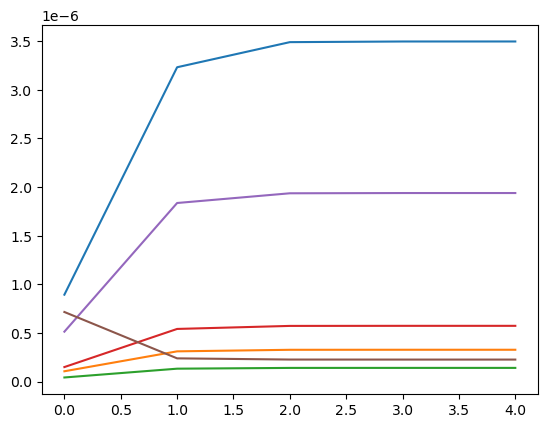

step: 0/1, D_loss: 0.103305325, G_loss_U: 4.2706337, G_loss_S: 0.057921596, E_loss_t0: 2.1768284


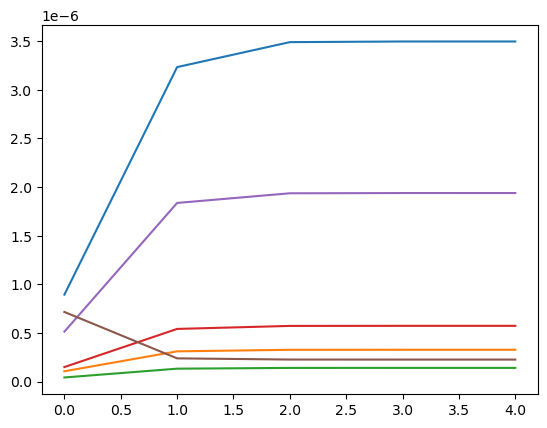

step: 0/1, D_loss: 0.09960816, G_loss_U: 4.2706327, G_loss_S: 0.05788194, E_loss_t0: 1.9145064


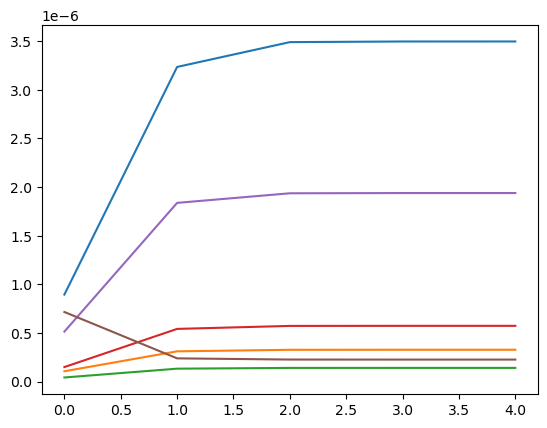

step: 0/1, D_loss: 0.11776856, G_loss_U: 4.270632, G_loss_S: 0.05791254, E_loss_t0: 2.5848517


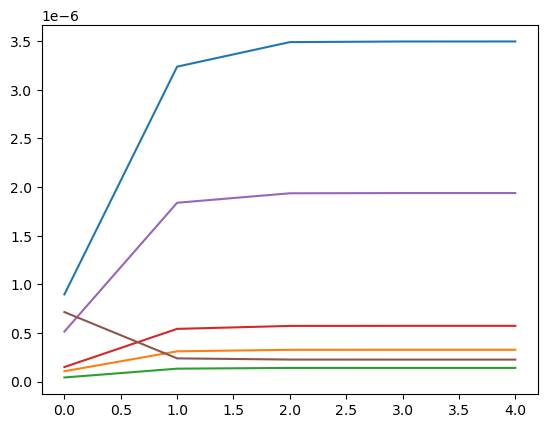

step: 0/1, D_loss: 0.11005329, G_loss_U: 4.2706313, G_loss_S: 0.058030467, E_loss_t0: 2.1557343


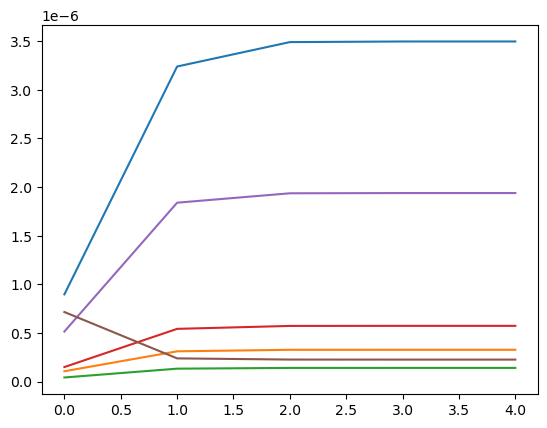

step: 0/1, D_loss: 0.108505666, G_loss_U: 4.2706304, G_loss_S: 0.05788818, E_loss_t0: 2.3281882


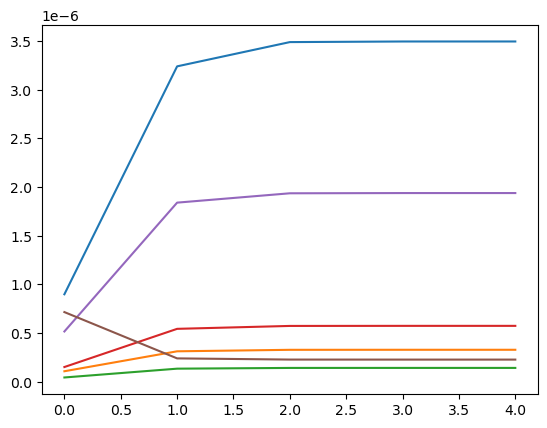

step: 0/1, D_loss: 0.098541, G_loss_U: 4.2706294, G_loss_S: 0.05794172, E_loss_t0: 1.4216719


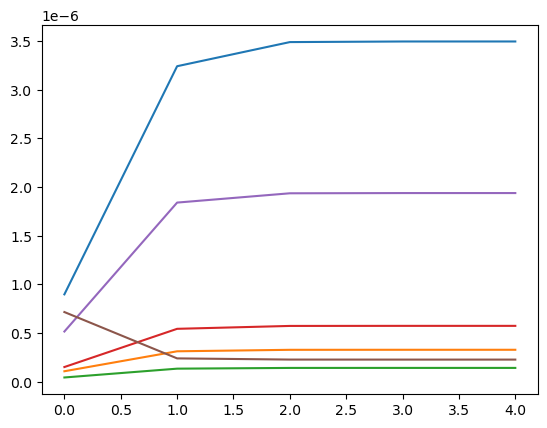

step: 0/1, D_loss: 0.09984793, G_loss_U: 4.2706285, G_loss_S: 0.058029674, E_loss_t0: 1.309066


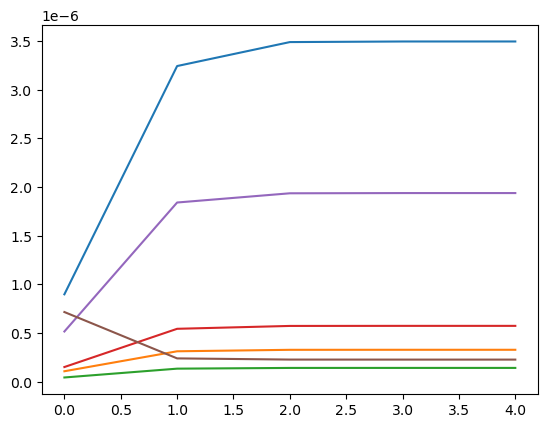

step: 0/1, D_loss: 0.10332479, G_loss_U: 4.270627, G_loss_S: 0.057863608, E_loss_t0: 2.0920734


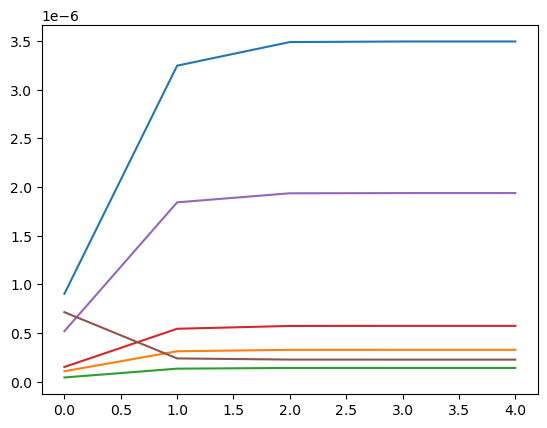

step: 0/1, D_loss: 0.10414308, G_loss_U: 4.270627, G_loss_S: 0.05793493, E_loss_t0: 2.0893197


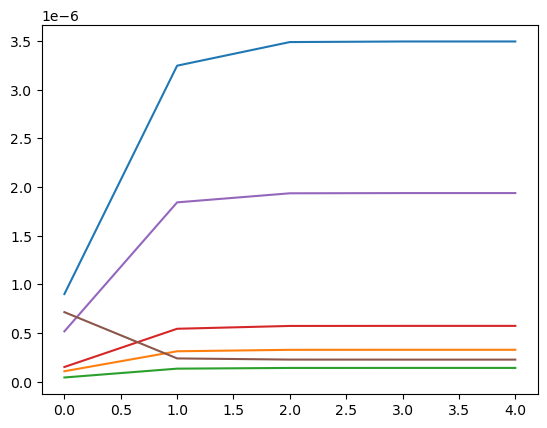

step: 0/1, D_loss: 0.09926458, G_loss_U: 4.2706256, G_loss_S: 0.057906218, E_loss_t0: 1.710852


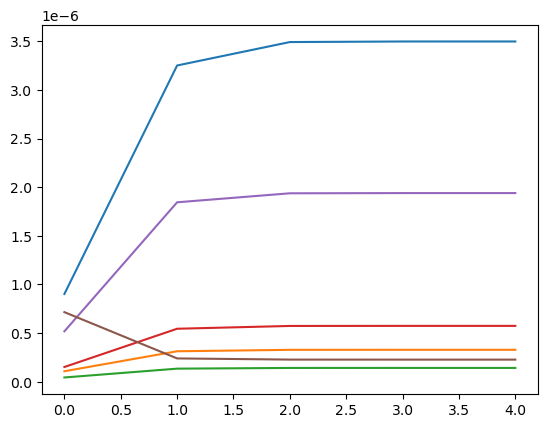

step: 0/1, D_loss: 0.10133331, G_loss_U: 4.2706246, G_loss_S: 0.05790874, E_loss_t0: 1.8155987


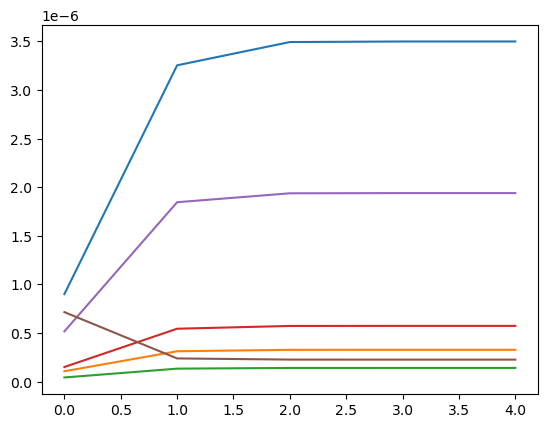

step: 0/1, D_loss: 0.100980364, G_loss_U: 4.270624, G_loss_S: 0.058020666, E_loss_t0: 1.8011546


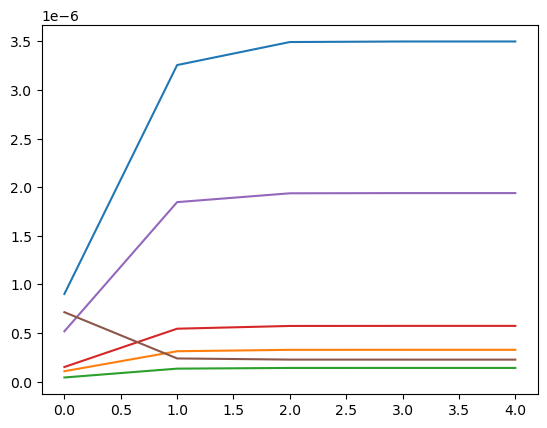

step: 0/1, D_loss: 0.11415893, G_loss_U: 4.270623, G_loss_S: 0.05797888, E_loss_t0: 2.41568


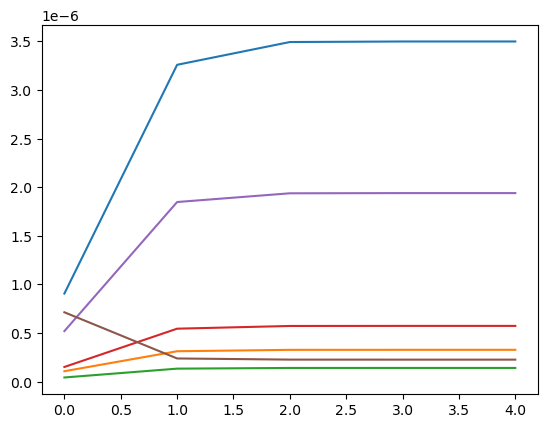

step: 0/1, D_loss: 0.09932442, G_loss_U: 4.2706227, G_loss_S: 0.057880774, E_loss_t0: 1.736893


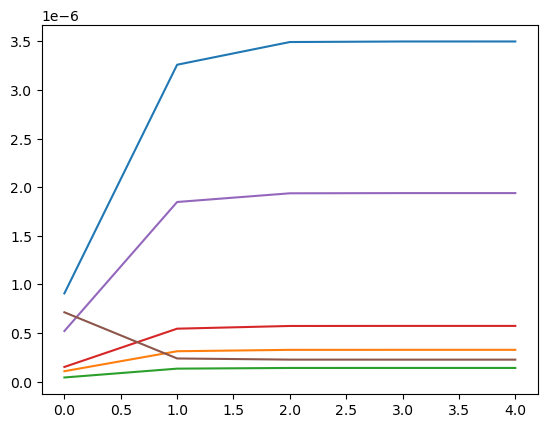

step: 0/1, D_loss: 0.098560214, G_loss_U: 4.2706213, G_loss_S: 0.057870325, E_loss_t0: 1.7950197


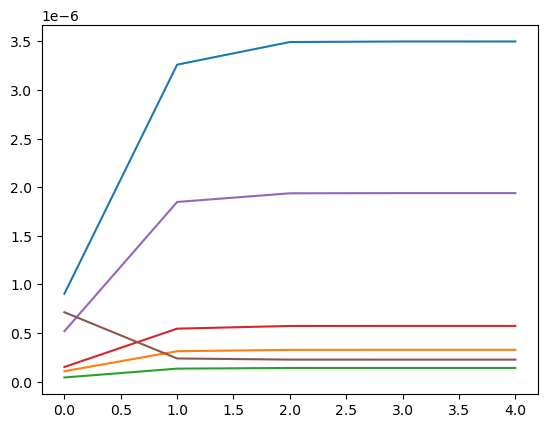

step: 0/1, D_loss: 0.10113768, G_loss_U: 4.2706203, G_loss_S: 0.05786455, E_loss_t0: 1.8912381


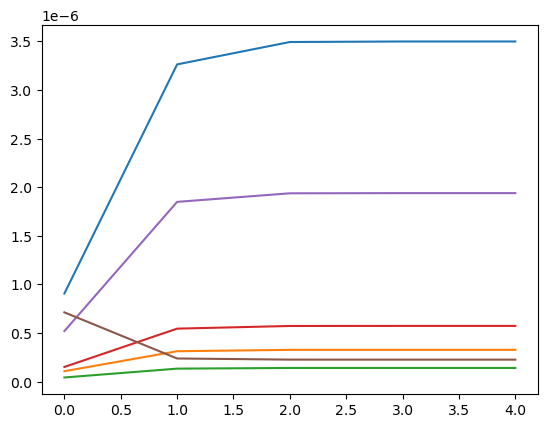

step: 0/1, D_loss: 0.1000413, G_loss_U: 4.2706194, G_loss_S: 0.05787975, E_loss_t0: 1.7513454


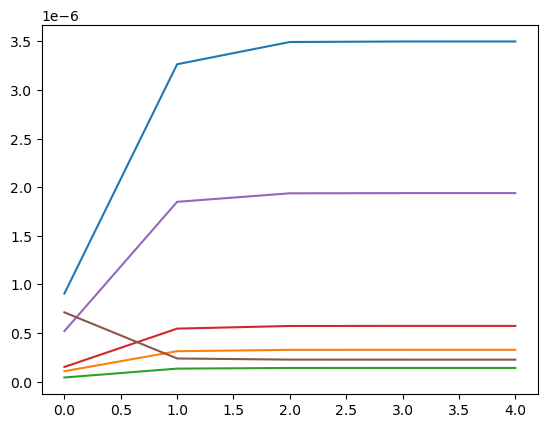

step: 0/1, D_loss: 0.10870871, G_loss_U: 4.2706184, G_loss_S: 0.05801734, E_loss_t0: 2.1022108


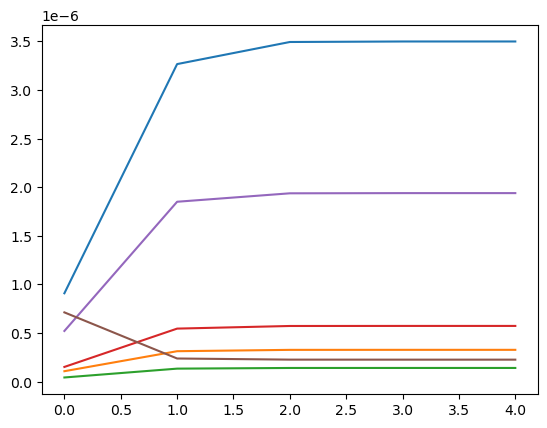

step: 0/1, D_loss: 0.09919348, G_loss_U: 4.270618, G_loss_S: 0.057962514, E_loss_t0: 1.4615669


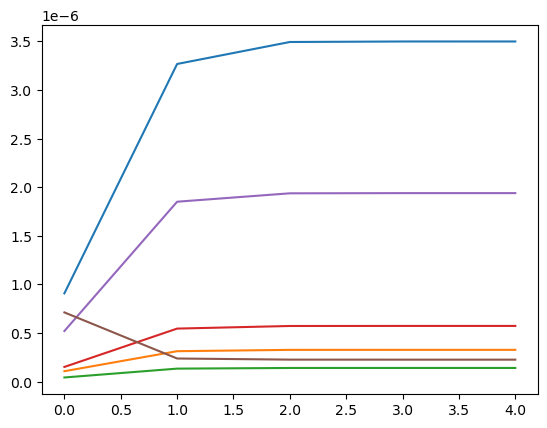

step: 0/1, D_loss: 0.10769584, G_loss_U: 4.270617, G_loss_S: 0.057811856, E_loss_t0: 2.2991557


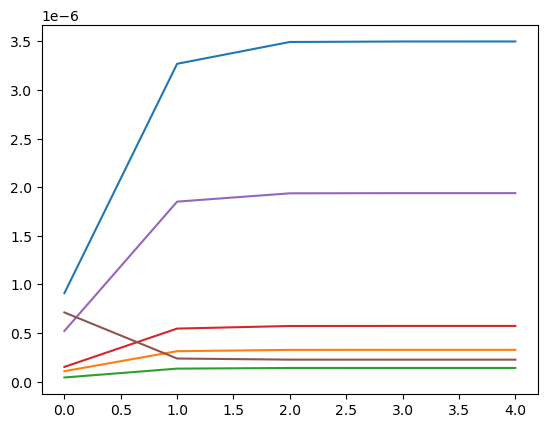

step: 0/1, D_loss: 0.108190686, G_loss_U: 4.270616, G_loss_S: 0.05787618, E_loss_t0: 2.370347


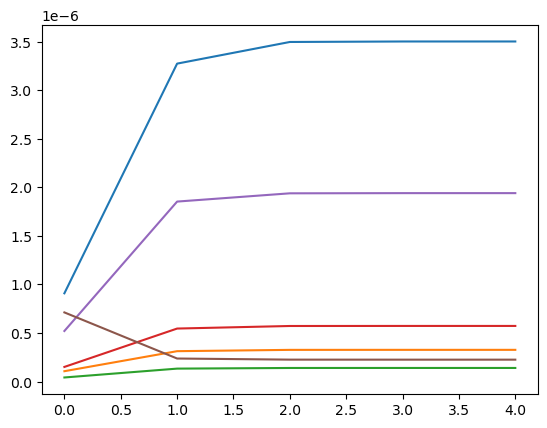

step: 0/1, D_loss: 0.10313457, G_loss_U: 4.270615, G_loss_S: 0.057864025, E_loss_t0: 1.9332237


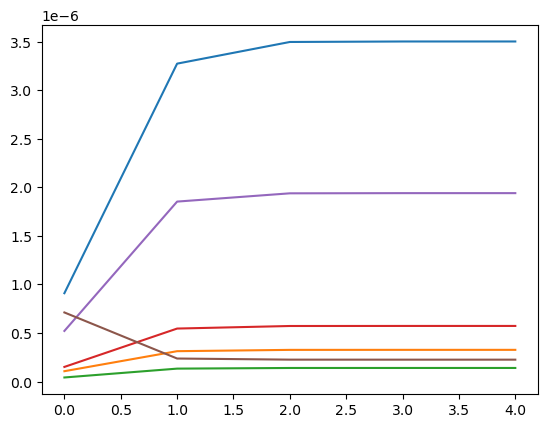

step: 0/1, D_loss: 0.106065944, G_loss_U: 4.270614, G_loss_S: 0.057823453, E_loss_t0: 2.1574214


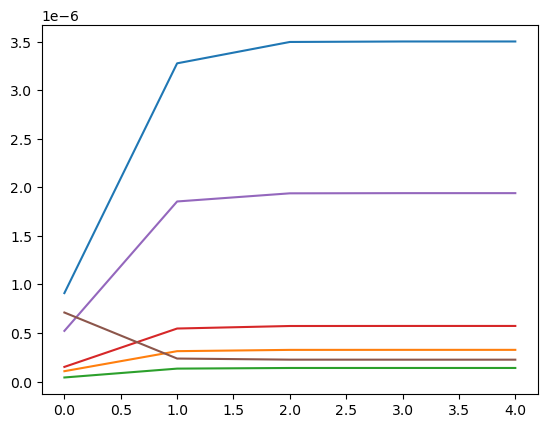

step: 0/1, D_loss: 0.10479905, G_loss_U: 4.270613, G_loss_S: 0.057831515, E_loss_t0: 2.028288


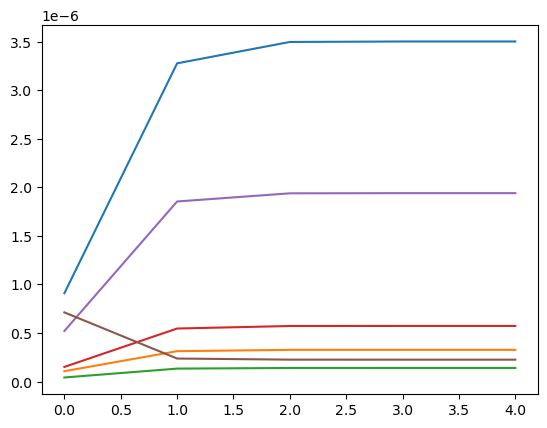

step: 0/1, D_loss: 0.09988462, G_loss_U: 4.2706127, G_loss_S: 0.057916597, E_loss_t0: 1.6390127


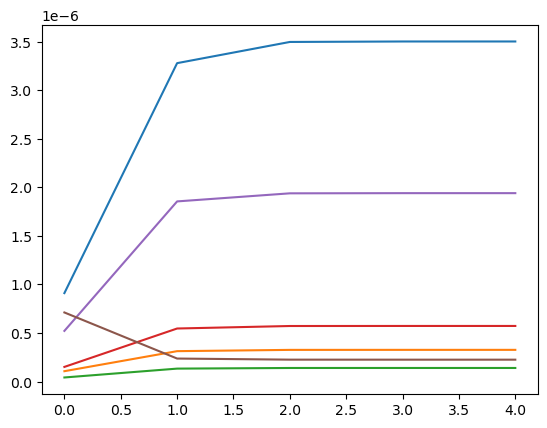

step: 0/1, D_loss: 0.11350722, G_loss_U: 4.270611, G_loss_S: 0.05791463, E_loss_t0: 2.29552


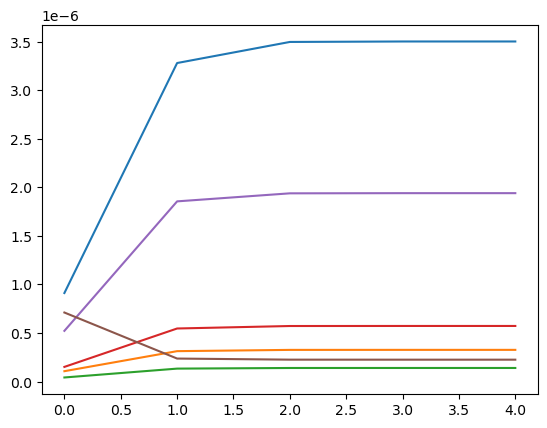

step: 0/1, D_loss: 0.10022417, G_loss_U: 4.27061, G_loss_S: 0.05791311, E_loss_t0: 1.2821804


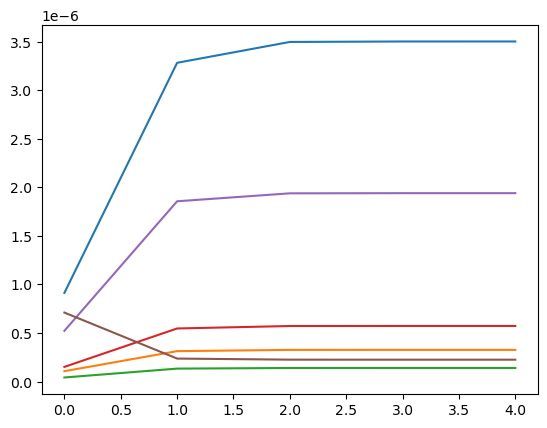

step: 0/1, D_loss: 0.100261934, G_loss_U: 4.270609, G_loss_S: 0.057848353, E_loss_t0: 1.7882124


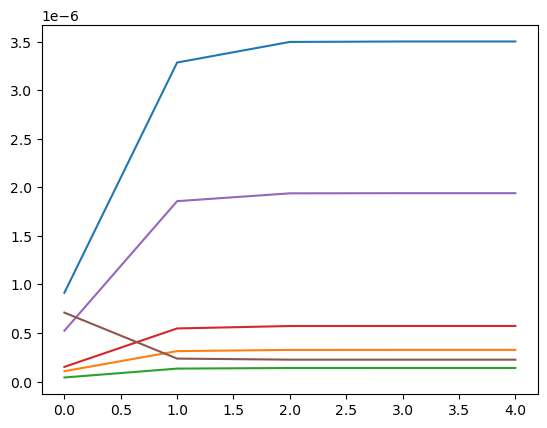

step: 0/1, D_loss: 0.10183775, G_loss_U: 4.2706084, G_loss_S: 0.057844333, E_loss_t0: 1.9939786


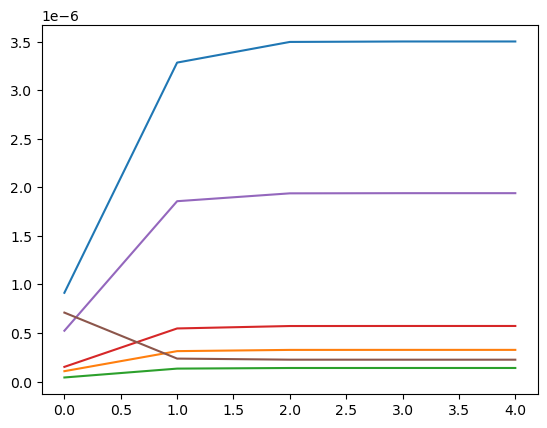

step: 0/1, D_loss: 0.101833075, G_loss_U: 4.270608, G_loss_S: 0.057884052, E_loss_t0: 1.8593438


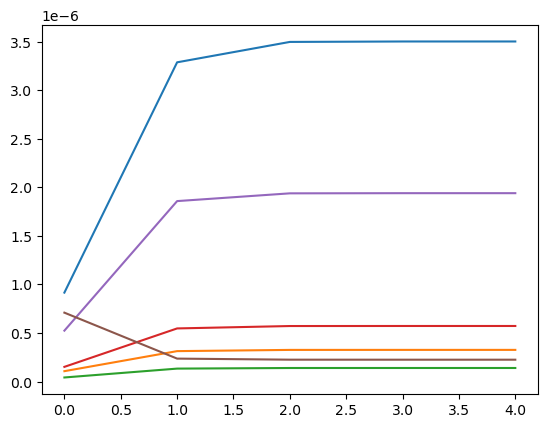

step: 0/1, D_loss: 0.10722379, G_loss_U: 4.2706065, G_loss_S: 0.057886925, E_loss_t0: 2.0975497


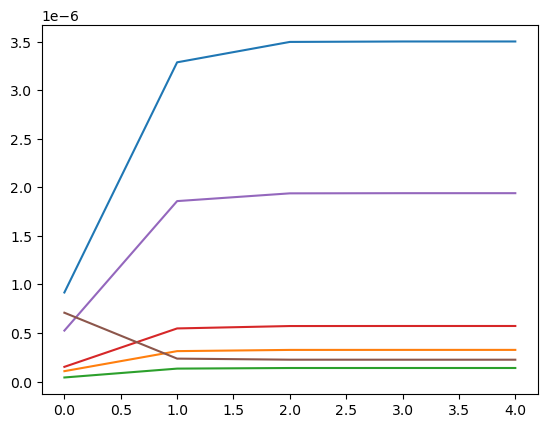

step: 0/1, D_loss: 0.11336009, G_loss_U: 4.2706056, G_loss_S: 0.05800582, E_loss_t0: 2.4207869


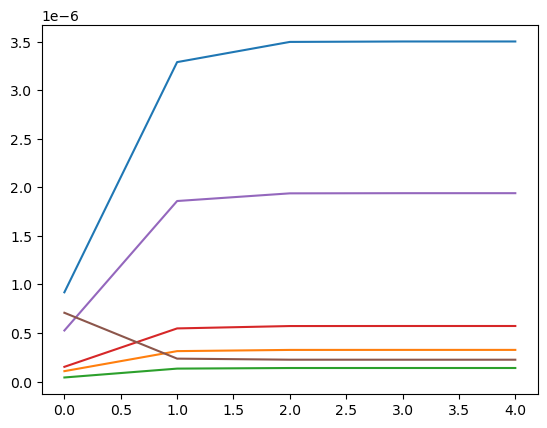

step: 0/1, D_loss: 0.10430047, G_loss_U: 4.270605, G_loss_S: 0.057827983, E_loss_t0: 2.0943034


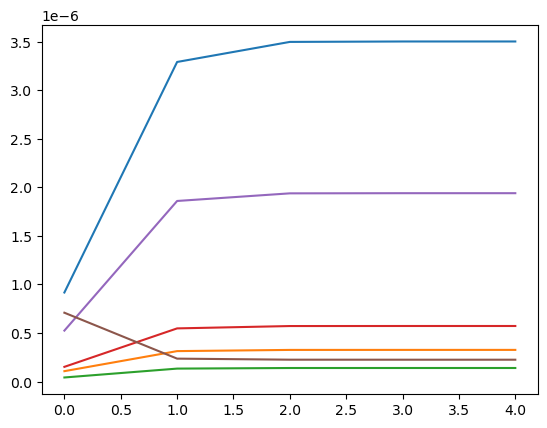

step: 0/1, D_loss: 0.10069307, G_loss_U: 4.2706037, G_loss_S: 0.057971273, E_loss_t0: 1.5520852


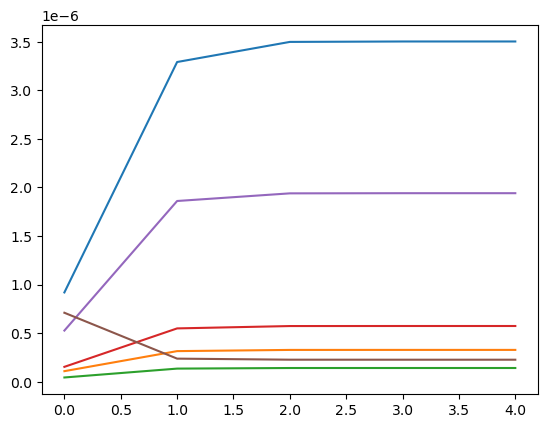

step: 0/1, D_loss: 0.10424548, G_loss_U: 4.2706027, G_loss_S: 0.057795912, E_loss_t0: 2.096673


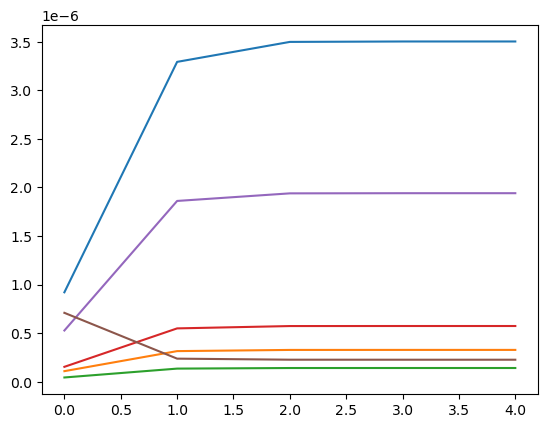

step: 0/1, D_loss: 0.09968741, G_loss_U: 4.2706017, G_loss_S: 0.05786276, E_loss_t0: 1.1788218


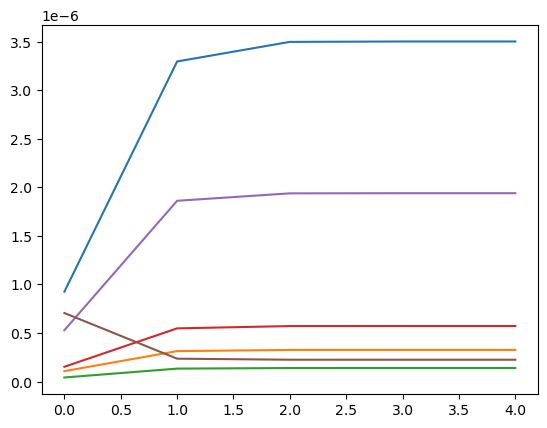

step: 0/1, D_loss: 0.10645723, G_loss_U: 4.270601, G_loss_S: 0.057779714, E_loss_t0: 2.286679


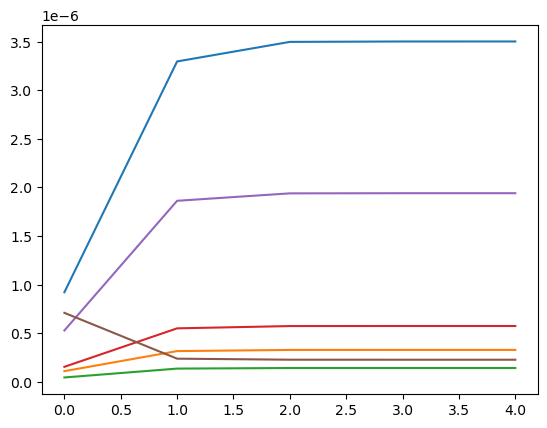

step: 0/1, D_loss: 0.10902338, G_loss_U: 4.2706, G_loss_S: 0.0577913, E_loss_t0: 2.2677145


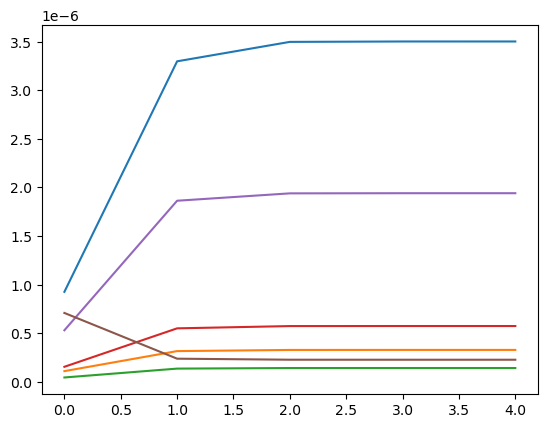

step: 0/1, D_loss: 0.10244325, G_loss_U: 4.270599, G_loss_S: 0.057780534, E_loss_t0: 2.077194


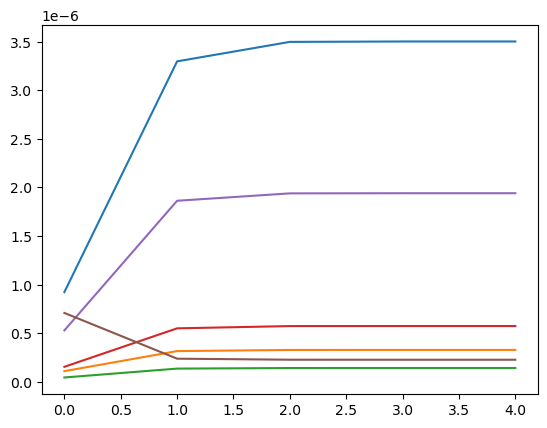

step: 0/1, D_loss: 0.103825636, G_loss_U: 4.270598, G_loss_S: 0.057852615, E_loss_t0: 1.9898174


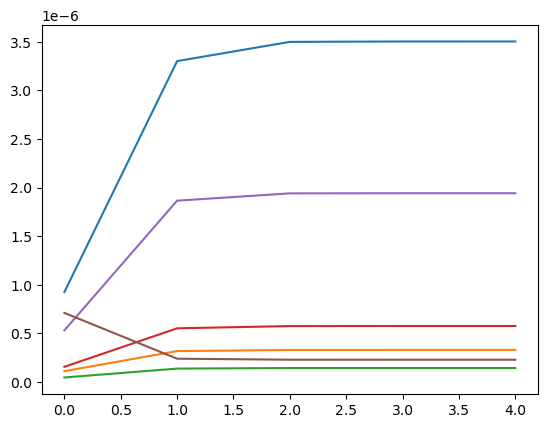

step: 0/1, D_loss: 0.107915975, G_loss_U: 4.270597, G_loss_S: 0.05783473, E_loss_t0: 2.0318747


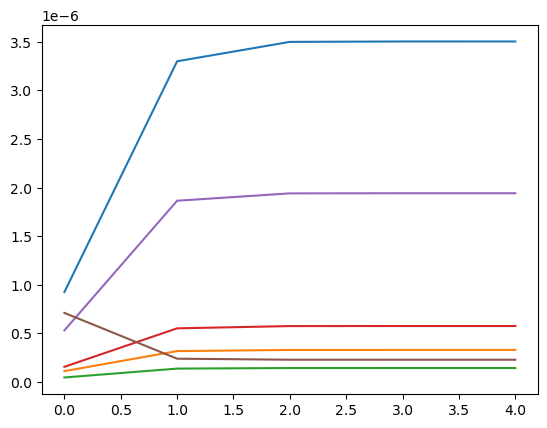

step: 0/1, D_loss: 0.106240645, G_loss_U: 4.2705956, G_loss_S: 0.05780404, E_loss_t0: 2.0459213


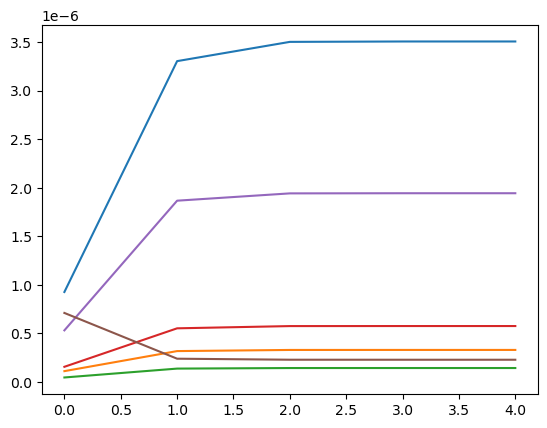

step: 0/1, D_loss: 0.11795222, G_loss_U: 4.2705946, G_loss_S: 0.05788888, E_loss_t0: 2.4634166


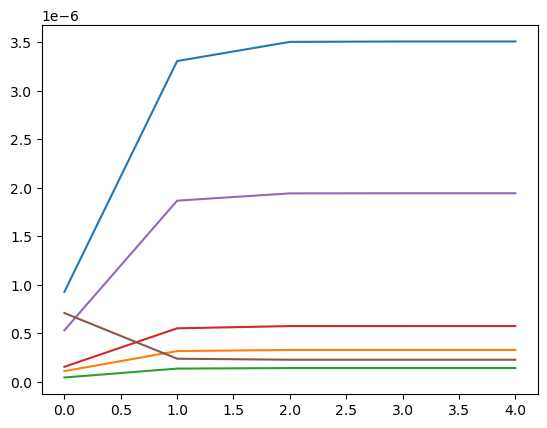

step: 0/1, D_loss: 0.10262726, G_loss_U: 4.270593, G_loss_S: 0.057790194, E_loss_t0: 1.9014858


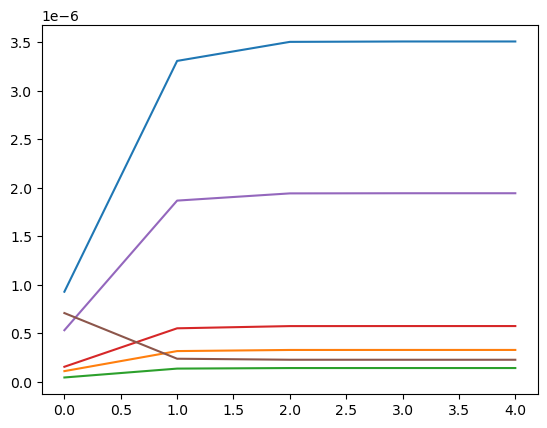

step: 0/1, D_loss: 0.11033655, G_loss_U: 4.2705927, G_loss_S: 0.05801606, E_loss_t0: 2.0901783


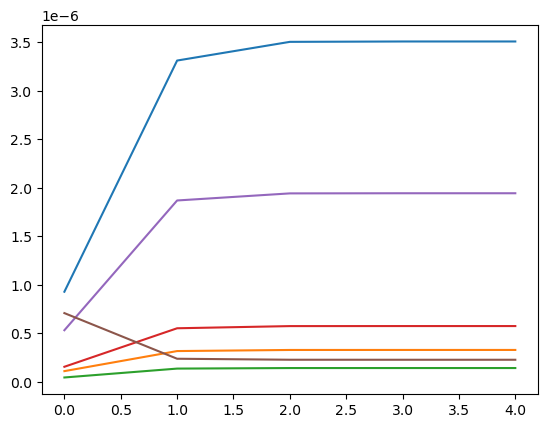

step: 0/1, D_loss: 0.106068805, G_loss_U: 4.2705913, G_loss_S: 0.057919998, E_loss_t0: 2.0597594


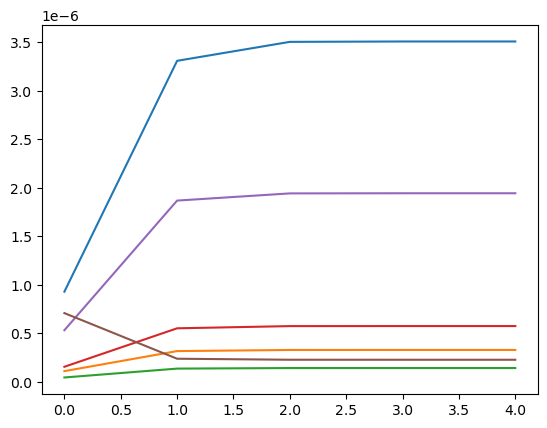

step: 0/1, D_loss: 0.10669456, G_loss_U: 4.27059, G_loss_S: 0.057767257, E_loss_t0: 2.2632813


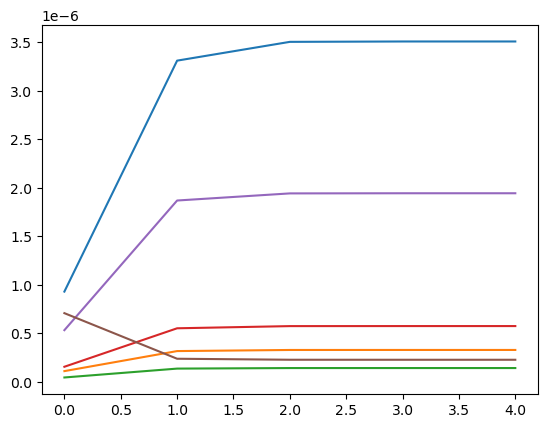

step: 0/1, D_loss: 0.11018916, G_loss_U: 4.2705894, G_loss_S: 0.057876002, E_loss_t0: 2.23236


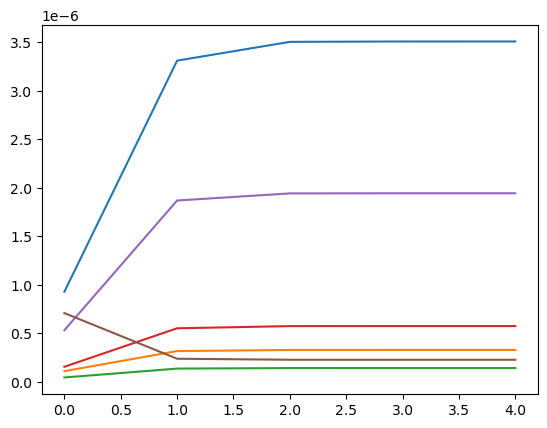

step: 0/1, D_loss: 0.10553976, G_loss_U: 4.270588, G_loss_S: 0.057841863, E_loss_t0: 2.006226


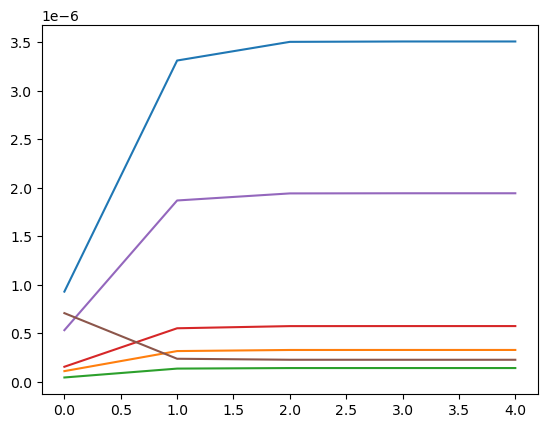

step: 0/1, D_loss: 0.10711647, G_loss_U: 4.270586, G_loss_S: 0.057752028, E_loss_t0: 2.286887


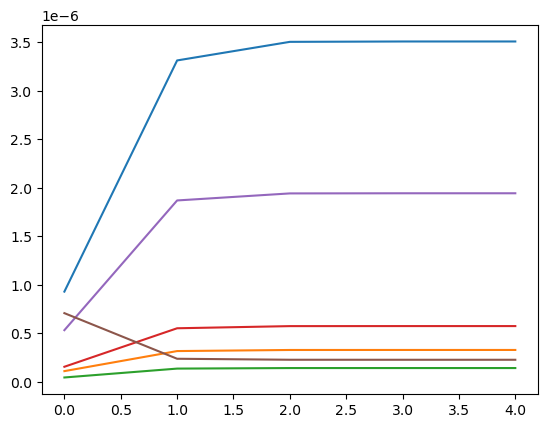

step: 0/1, D_loss: 0.10074709, G_loss_U: 4.2705855, G_loss_S: 0.057809852, E_loss_t0: 1.7634721


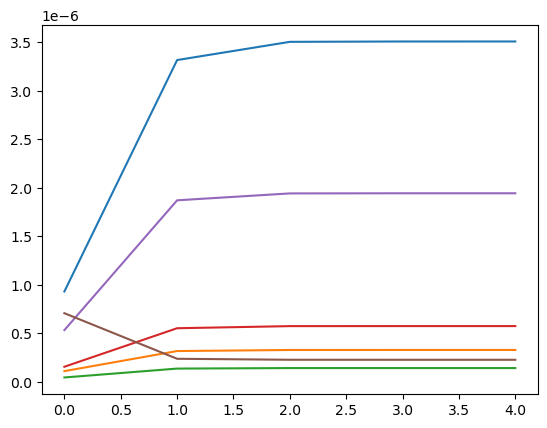

step: 0/1, D_loss: 0.10016692, G_loss_U: 4.270584, G_loss_S: 0.057823144, E_loss_t0: 1.4765984


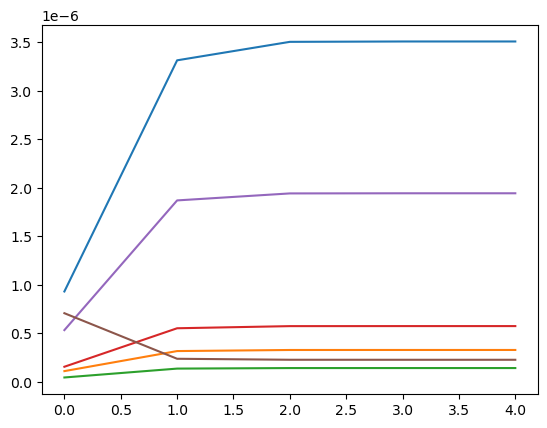

step: 0/1, D_loss: 0.10135928, G_loss_U: 4.270583, G_loss_S: 0.05781756, E_loss_t0: 1.7440089


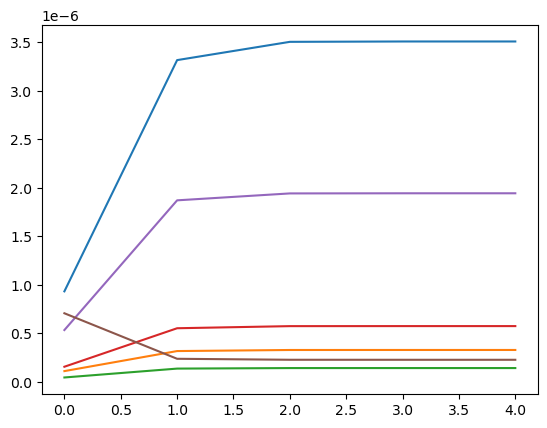

step: 0/1, D_loss: 0.10216506, G_loss_U: 4.2705817, G_loss_S: 0.05784829, E_loss_t0: 1.8333797


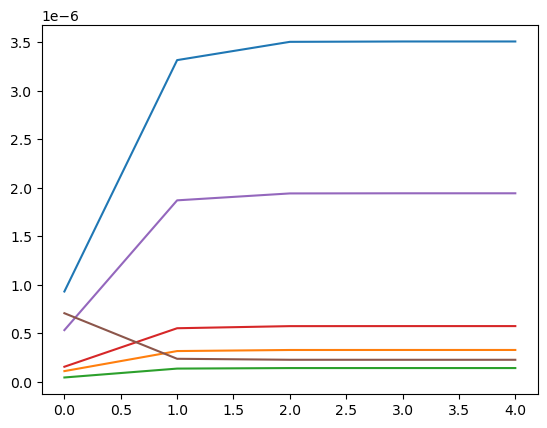

step: 0/1, D_loss: 0.09934267, G_loss_U: 4.2705803, G_loss_S: 0.057772316, E_loss_t0: 1.5457802


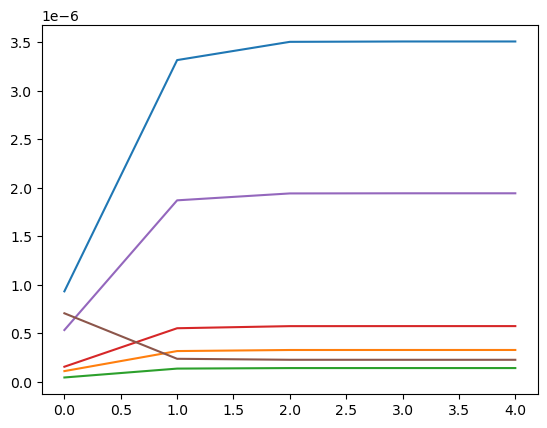

step: 0/1, D_loss: 0.10755688, G_loss_U: 4.270579, G_loss_S: 0.057811998, E_loss_t0: 2.1097684


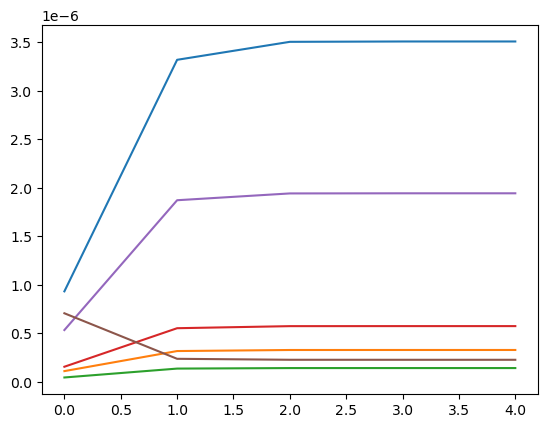

step: 0/1, D_loss: 0.09966931, G_loss_U: 4.270578, G_loss_S: 0.05779661, E_loss_t0: 1.4423085


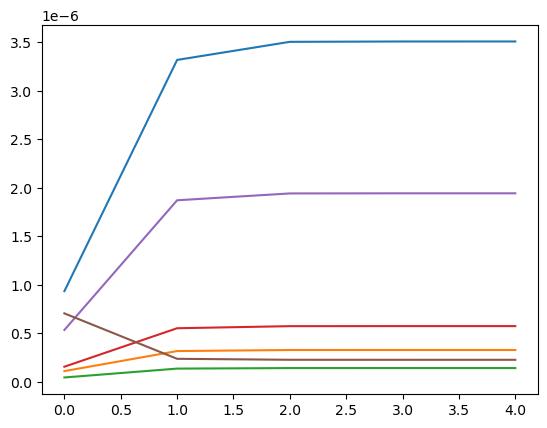

step: 0/1, D_loss: 0.100568086, G_loss_U: 4.2705765, G_loss_S: 0.057787832, E_loss_t0: 1.6940355


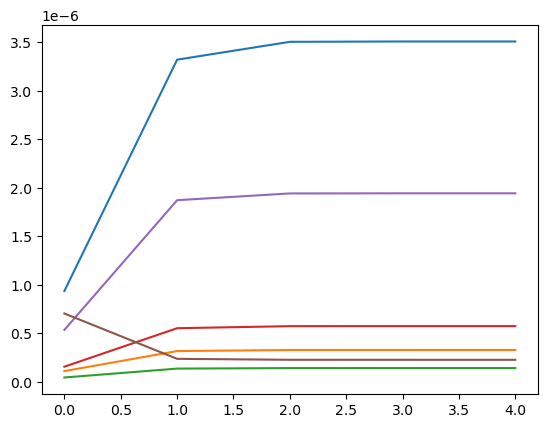

step: 0/1, D_loss: 0.10531778, G_loss_U: 4.270575, G_loss_S: 0.05779084, E_loss_t0: 2.0591488


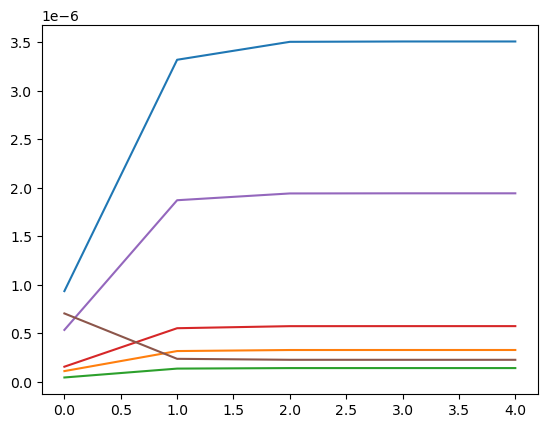

step: 0/1, D_loss: 0.100440755, G_loss_U: 4.2705736, G_loss_S: 0.05778243, E_loss_t0: 1.6515566


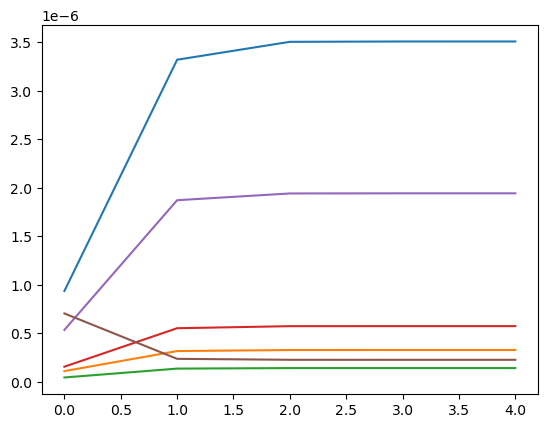

step: 0/1, D_loss: 0.10033118, G_loss_U: 4.270572, G_loss_S: 0.05774774, E_loss_t0: 1.727663


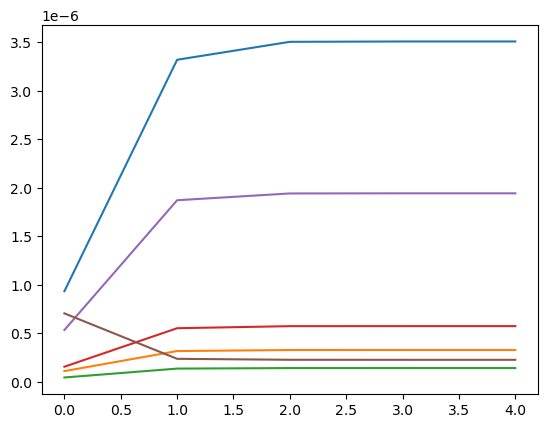

step: 0/1, D_loss: 0.10574545, G_loss_U: 4.2705708, G_loss_S: 0.057760593, E_loss_t0: 2.0644746


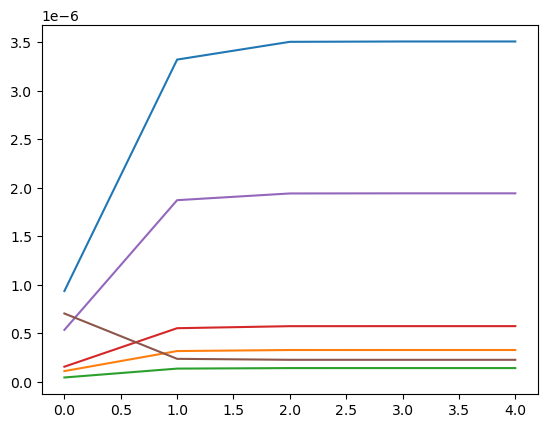

step: 0/1, D_loss: 0.10218984, G_loss_U: 4.2705693, G_loss_S: 0.057737175, E_loss_t0: 1.9607885


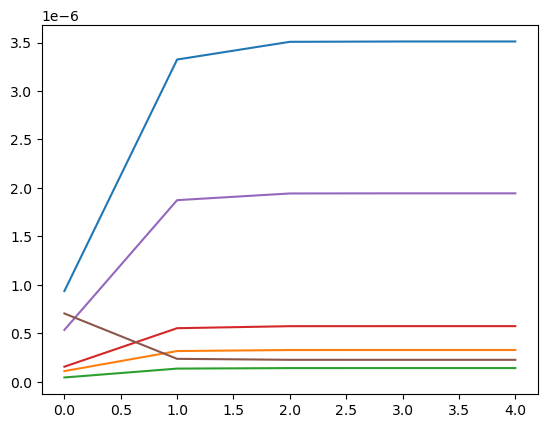

step: 0/1, D_loss: 0.10952662, G_loss_U: 4.2705684, G_loss_S: 0.057753585, E_loss_t0: 2.2866366


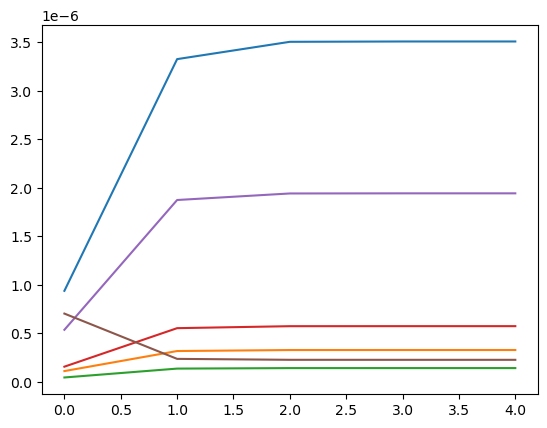

step: 0/1, D_loss: 0.10502426, G_loss_U: 4.270566, G_loss_S: 0.057741288, E_loss_t0: 2.115244


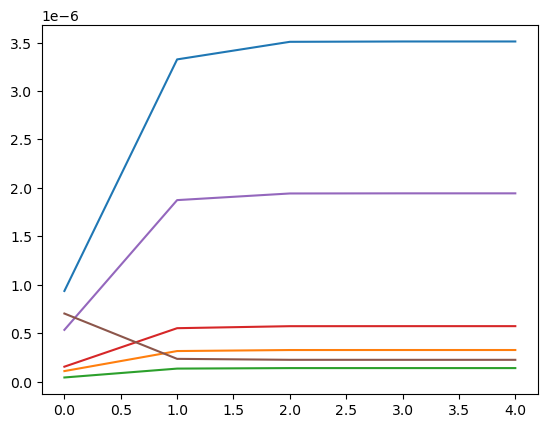

step: 0/1, D_loss: 0.109916404, G_loss_U: 4.2705646, G_loss_S: 0.057752028, E_loss_t0: 2.288292


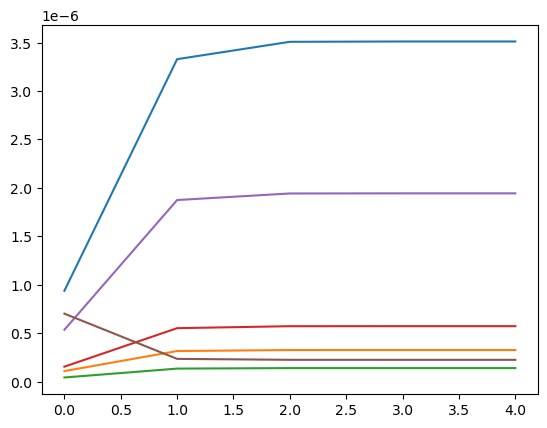

step: 0/1, D_loss: 0.10158785, G_loss_U: 4.270563, G_loss_S: 0.057759065, E_loss_t0: 1.7605904


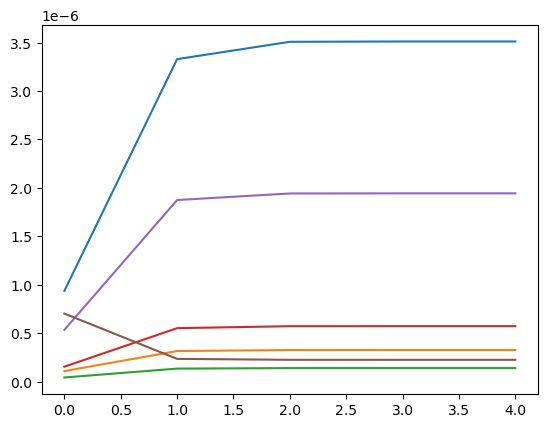

step: 0/1, D_loss: 0.1069403, G_loss_U: 4.2705617, G_loss_S: 0.05811371, E_loss_t0: 1.6740986


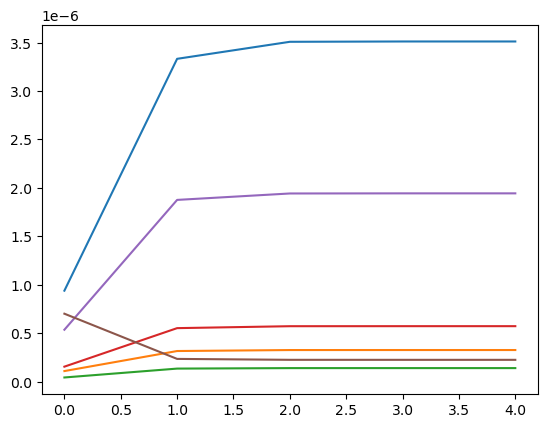

step: 0/1, D_loss: 0.1071604, G_loss_U: 4.27056, G_loss_S: 0.057721388, E_loss_t0: 2.317881


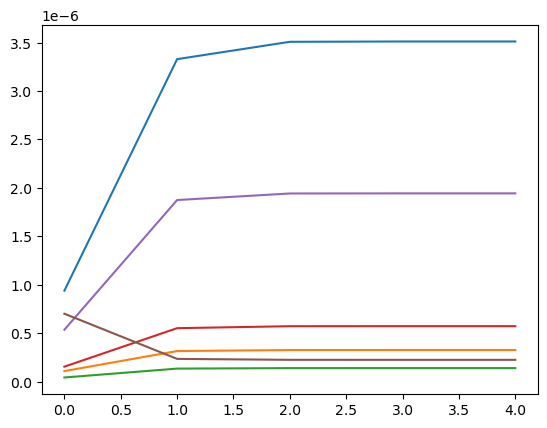

step: 0/1, D_loss: 0.10029833, G_loss_U: 4.270558, G_loss_S: 0.05776102, E_loss_t0: 1.6857045


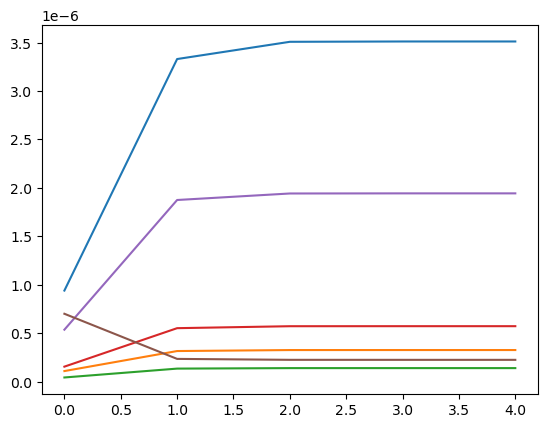

step: 0/1, D_loss: 0.1002244, G_loss_U: 4.2705564, G_loss_S: 0.057803087, E_loss_t0: 1.3981532


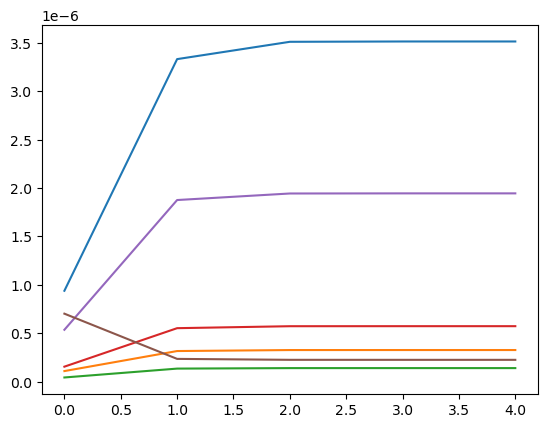

step: 0/1, D_loss: 0.102312, G_loss_U: 4.270554, G_loss_S: 0.057821825, E_loss_t0: 1.9162349


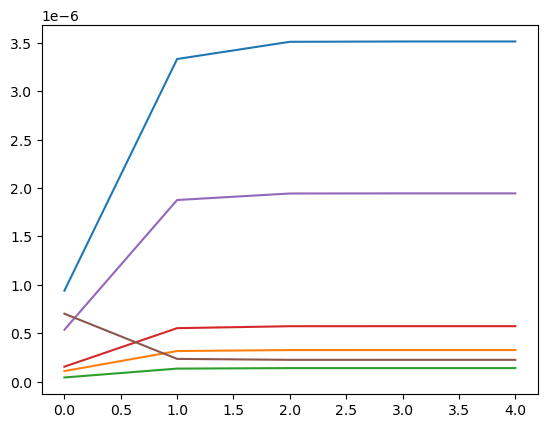

step: 0/1, D_loss: 0.10195845, G_loss_U: 4.270552, G_loss_S: 0.057764564, E_loss_t0: 1.7629694


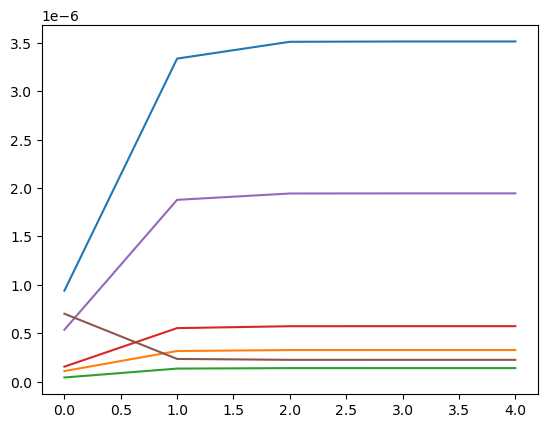

step: 0/1, D_loss: 0.10098366, G_loss_U: 4.2705507, G_loss_S: 0.05770527, E_loss_t0: 1.8826165


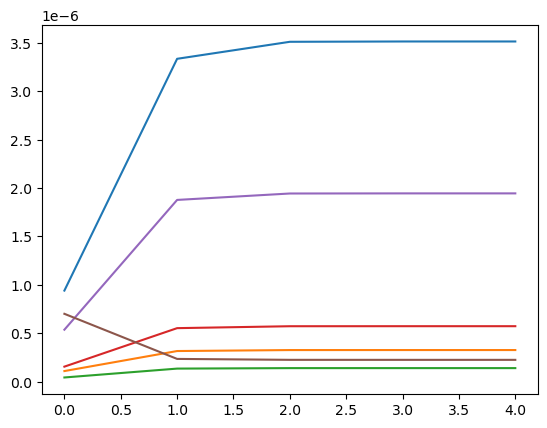

step: 0/1, D_loss: 0.0999634, G_loss_U: 4.270548, G_loss_S: 0.057738286, E_loss_t0: 1.464607


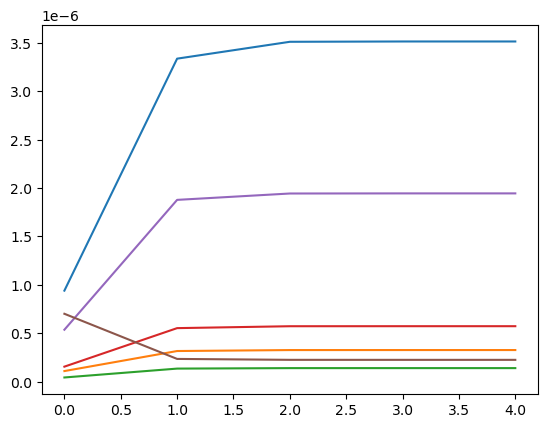

step: 0/1, D_loss: 0.110500924, G_loss_U: 4.2705464, G_loss_S: 0.057709713, E_loss_t0: 2.3320138


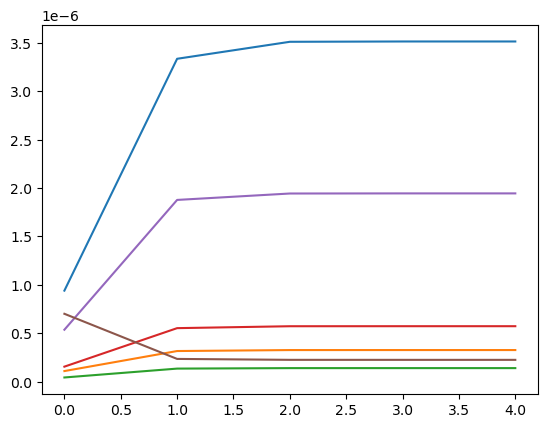

step: 0/1, D_loss: 0.102838226, G_loss_U: 4.270544, G_loss_S: 0.05774156, E_loss_t0: 1.8531723


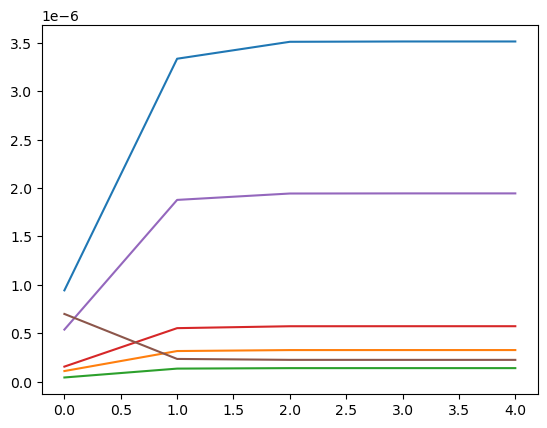

step: 0/1, D_loss: 0.10641937, G_loss_U: 4.2705417, G_loss_S: 0.057761993, E_loss_t0: 1.9646165


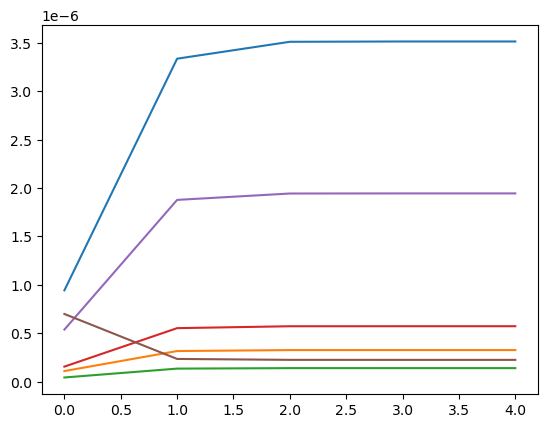

step: 0/1, D_loss: 0.10109783, G_loss_U: 4.270539, G_loss_S: 0.057838913, E_loss_t0: 1.5891019


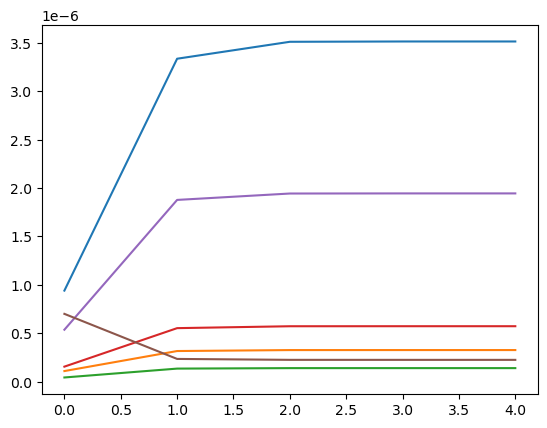

step: 0/1, D_loss: 0.105948225, G_loss_U: 4.2705364, G_loss_S: 0.057941314, E_loss_t0: 1.9555858


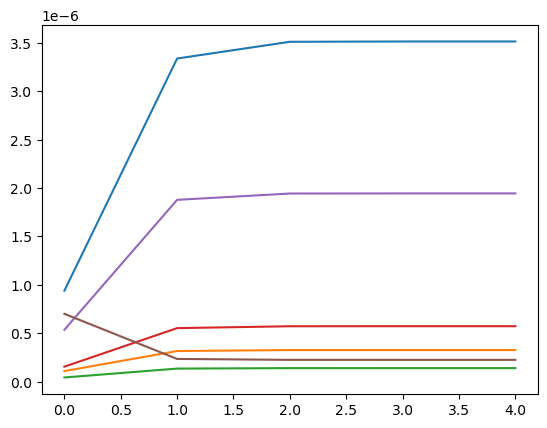

step: 0/1, D_loss: 0.10295095, G_loss_U: 4.2705336, G_loss_S: 0.05769004, E_loss_t0: 2.0273888


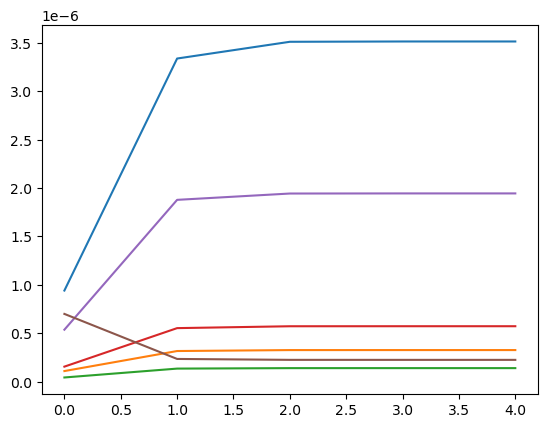

step: 0/1, D_loss: 0.11020352, G_loss_U: 4.2705307, G_loss_S: 0.05773644, E_loss_t0: 2.2318933


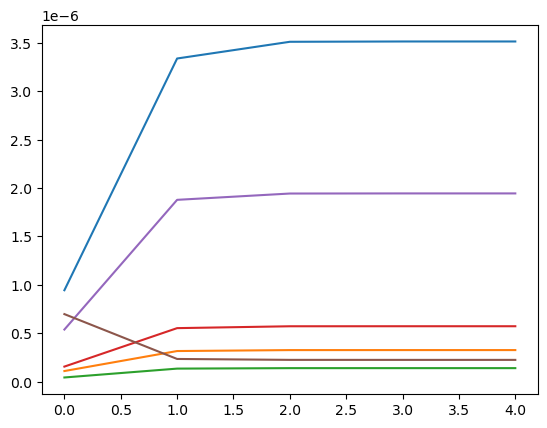

step: 0/1, D_loss: 0.10262023, G_loss_U: 4.2705283, G_loss_S: 0.05777567, E_loss_t0: 1.8058503


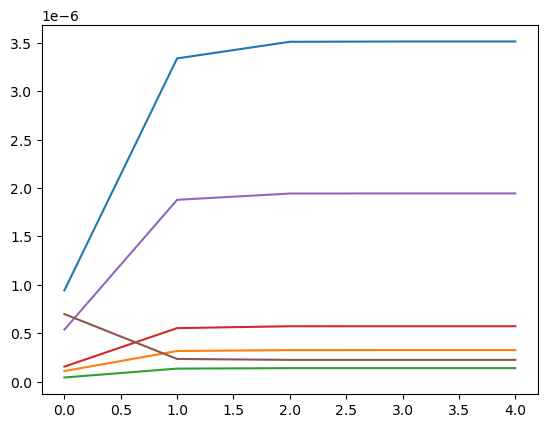

step: 0/1, D_loss: 0.10150853, G_loss_U: 4.270525, G_loss_S: 0.057703476, E_loss_t0: 1.8351654


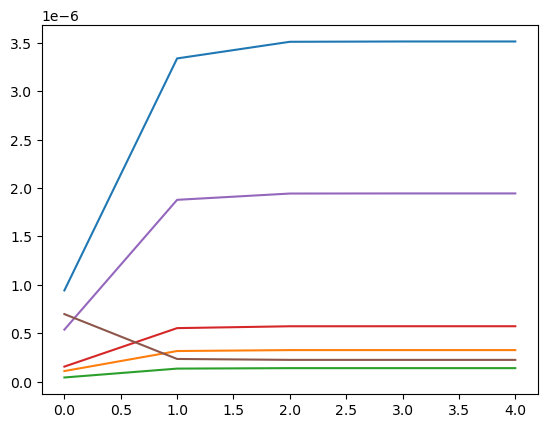

step: 0/1, D_loss: 0.11197336, G_loss_U: 4.2705216, G_loss_S: 0.057798646, E_loss_t0: 2.3296607


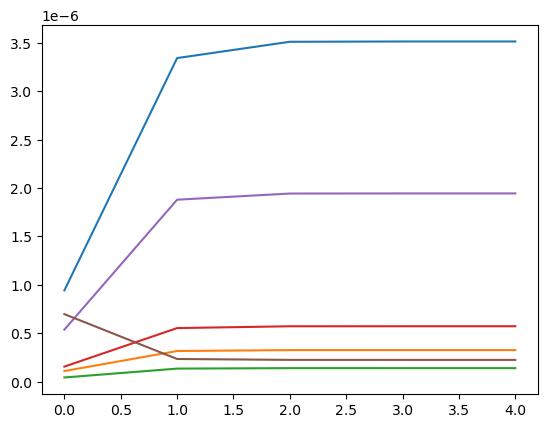

step: 0/1, D_loss: 0.101740494, G_loss_U: 4.270518, G_loss_S: 0.05767351, E_loss_t0: 2.0414243


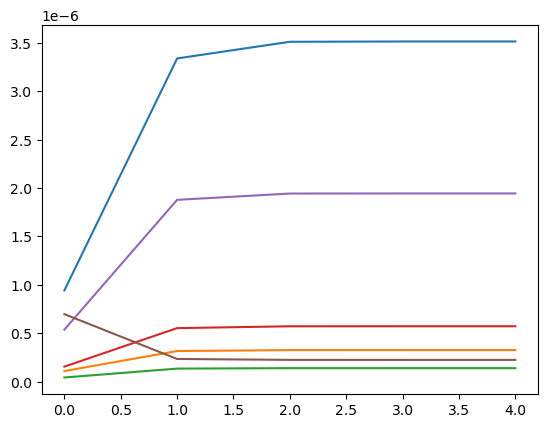

step: 0/1, D_loss: 0.10311415, G_loss_U: 4.270514, G_loss_S: 0.057926554, E_loss_t0: 1.9480432


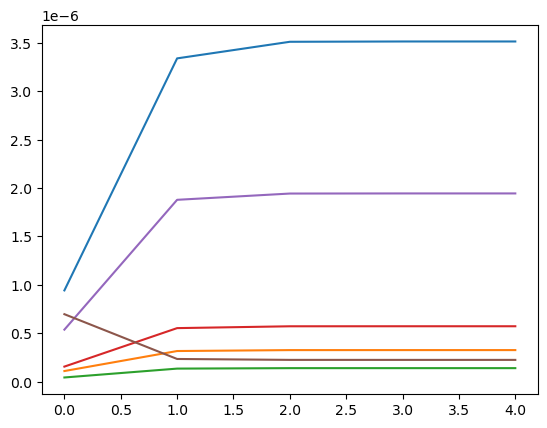

step: 0/1, D_loss: 0.10177077, G_loss_U: 4.27051, G_loss_S: 0.057713762, E_loss_t0: 1.7241524


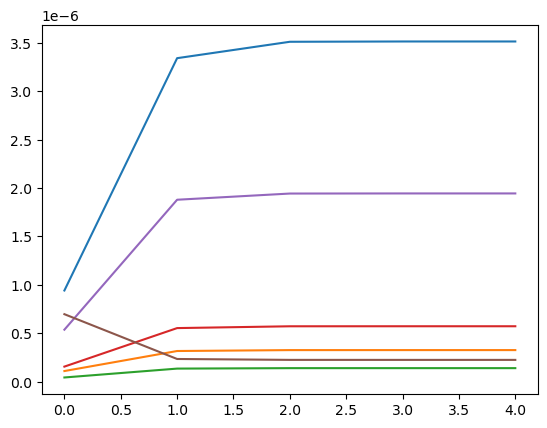

step: 0/1, D_loss: 0.10267801, G_loss_U: 4.2705064, G_loss_S: 0.05785322, E_loss_t0: 1.6190544


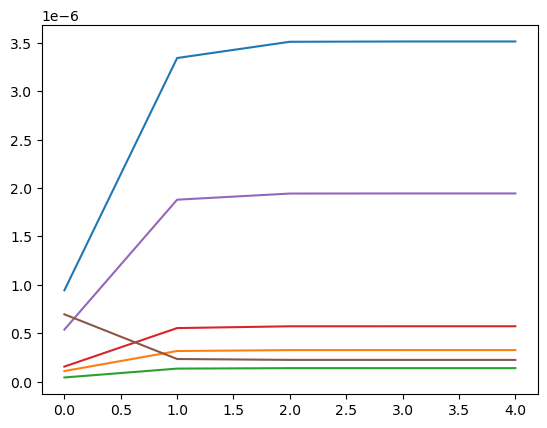

step: 0/1, D_loss: 0.10108566, G_loss_U: 4.270501, G_loss_S: 0.05768097, E_loss_t0: 1.7823462


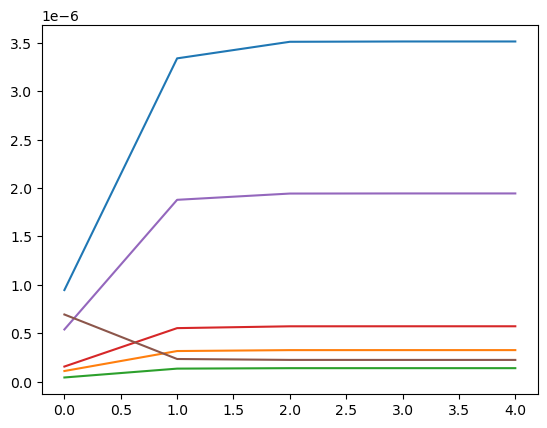

step: 0/1, D_loss: 0.101518534, G_loss_U: 4.2704964, G_loss_S: 0.05769355, E_loss_t0: 1.7277855


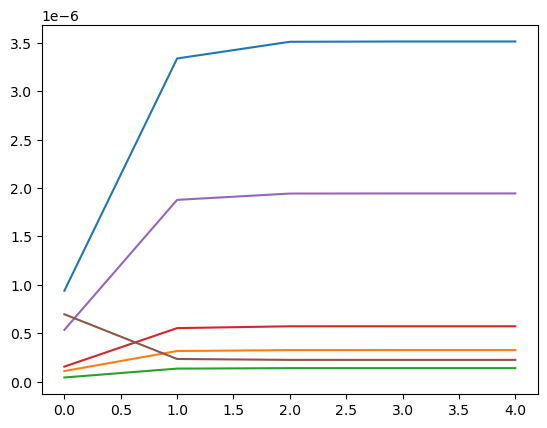

step: 0/1, D_loss: 0.111063205, G_loss_U: 4.270491, G_loss_S: 0.057754055, E_loss_t0: 2.2768705


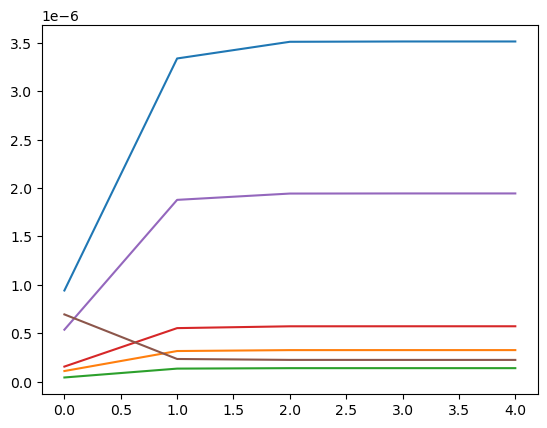

step: 0/1, D_loss: 0.11339927, G_loss_U: 4.2704854, G_loss_S: 0.057721473, E_loss_t0: 2.3460946


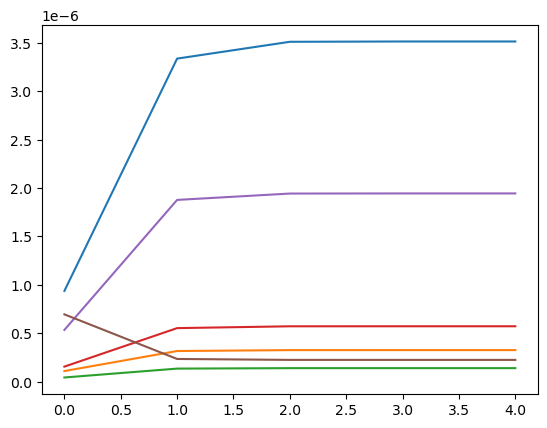

step: 0/1, D_loss: 0.10431481, G_loss_U: 4.270479, G_loss_S: 0.05772179, E_loss_t0: 1.7912409


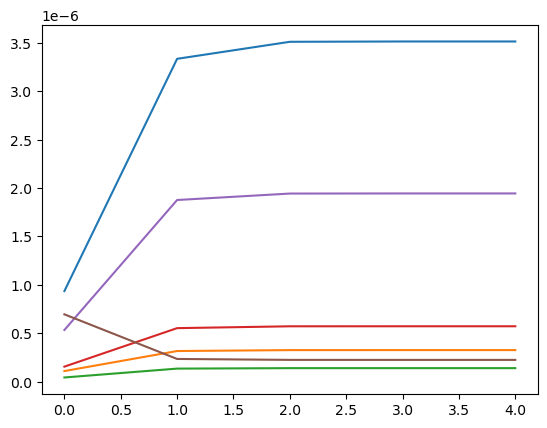

step: 0/1, D_loss: 0.1020723, G_loss_U: 4.270473, G_loss_S: 0.057718825, E_loss_t0: 1.4689528


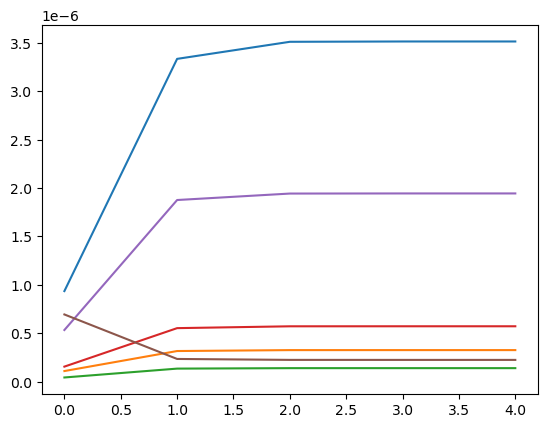

step: 0/1, D_loss: 0.11139034, G_loss_U: 4.2704663, G_loss_S: 0.05772505, E_loss_t0: 2.2992966


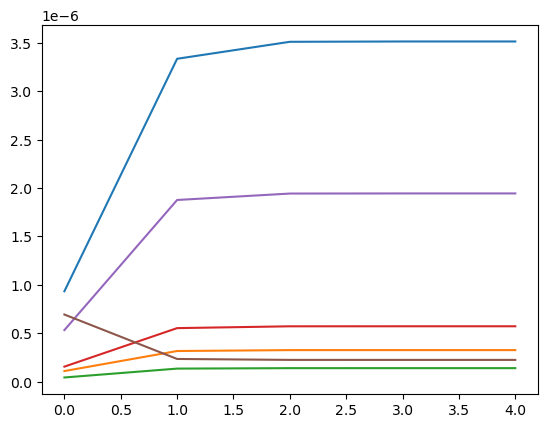

step: 0/1, D_loss: 0.10345975, G_loss_U: 4.2704606, G_loss_S: 0.057776432, E_loss_t0: 1.761147


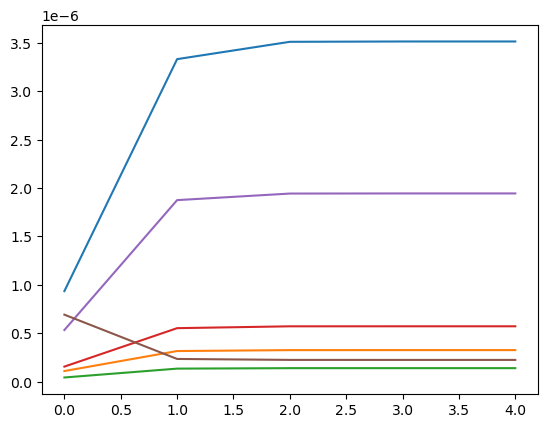

step: 0/1, D_loss: 0.10639508, G_loss_U: 4.270454, G_loss_S: 0.057740312, E_loss_t0: 1.9830015


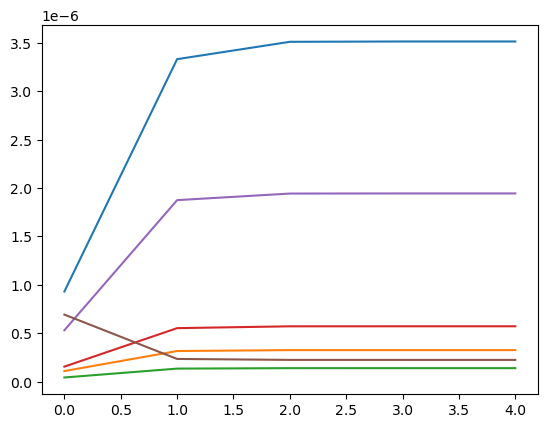

step: 0/1, D_loss: 0.11984189, G_loss_U: 4.2704473, G_loss_S: 0.057718974, E_loss_t0: 2.4640872


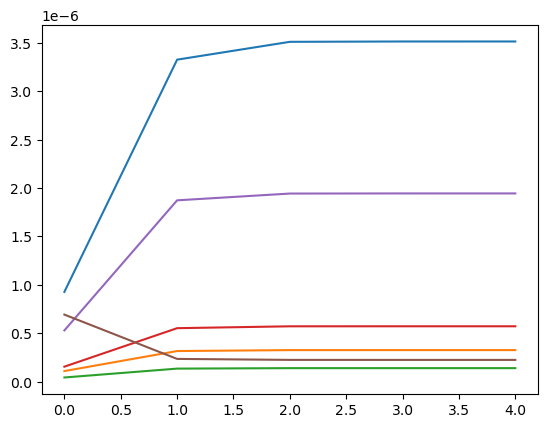

step: 0/1, D_loss: 0.10502994, G_loss_U: 4.270441, G_loss_S: 0.057669714, E_loss_t0: 1.9321767


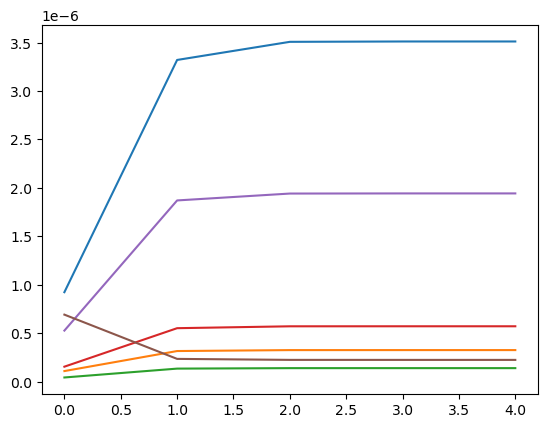

step: 0/1, D_loss: 0.104971275, G_loss_U: 4.2704363, G_loss_S: 0.057701826, E_loss_t0: 1.841703


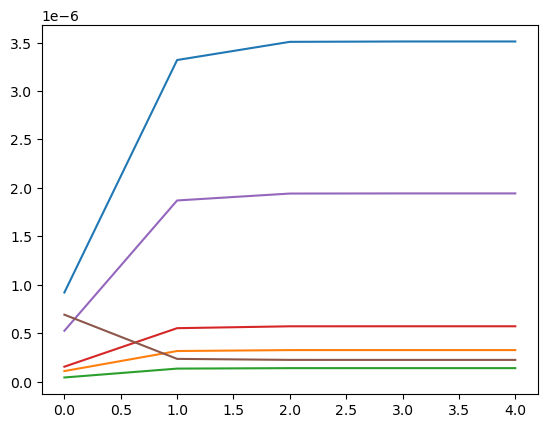

step: 0/1, D_loss: 0.10923888, G_loss_U: 4.270432, G_loss_S: 0.057677697, E_loss_t0: 2.1688519


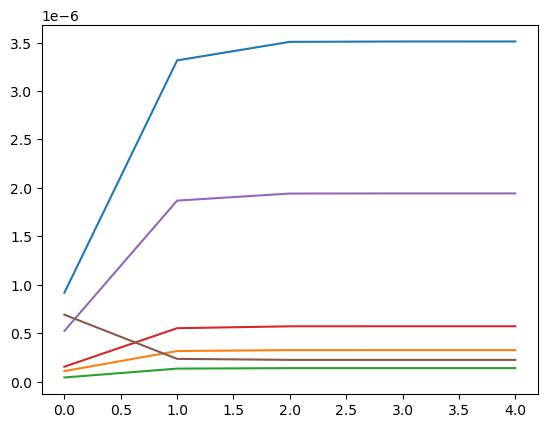

step: 0/1, D_loss: 0.10383219, G_loss_U: 4.2704287, G_loss_S: 0.057725444, E_loss_t0: 1.36455


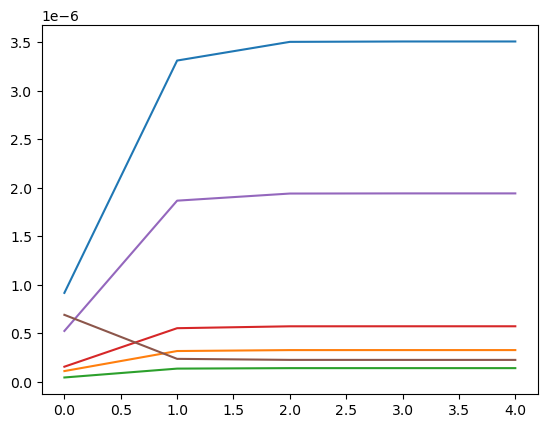

step: 0/1, D_loss: 0.10504876, G_loss_U: 4.2704268, G_loss_S: 0.057731386, E_loss_t0: 1.6524547


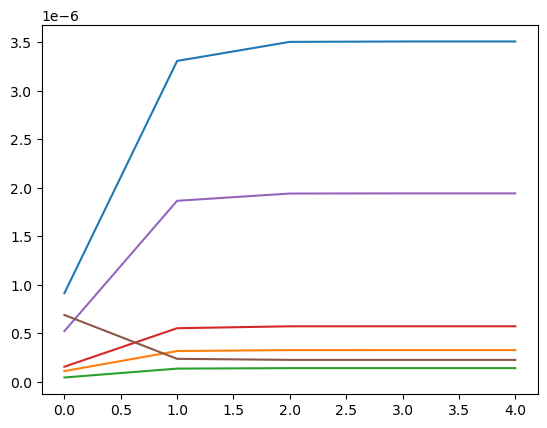

step: 0/1, D_loss: 0.10509071, G_loss_U: 4.2704253, G_loss_S: 0.05772574, E_loss_t0: 1.4278235


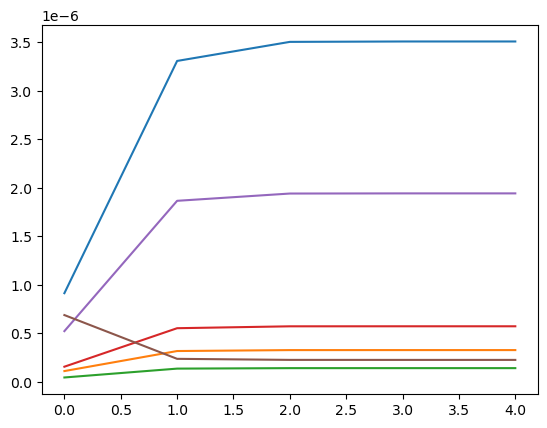

step: 0/1, D_loss: 0.12109618, G_loss_U: 4.2704253, G_loss_S: 0.057685483, E_loss_t0: 2.4542503


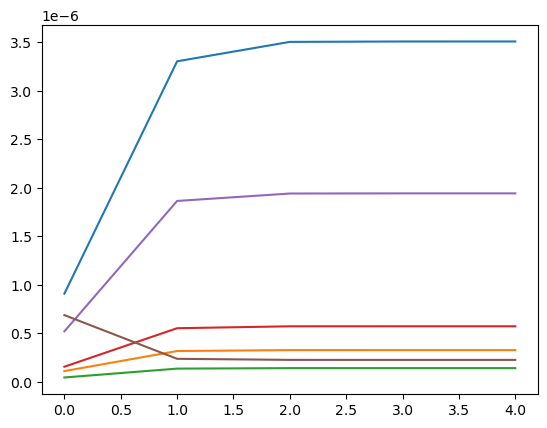

step: 0/1, D_loss: 0.1058192, G_loss_U: 4.2704253, G_loss_S: 0.057683673, E_loss_t0: 1.8338782


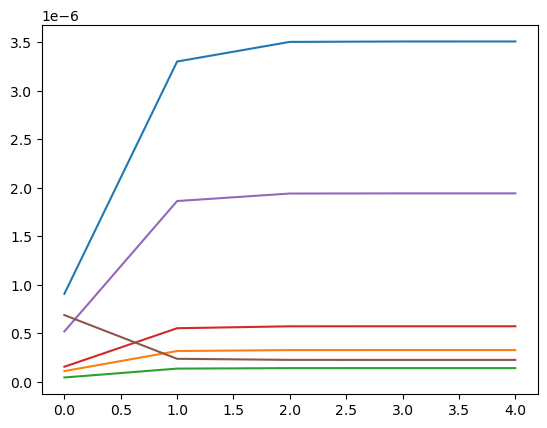

step: 0/1, D_loss: 0.11283626, G_loss_U: 4.270425, G_loss_S: 0.057709116, E_loss_t0: 2.1050894


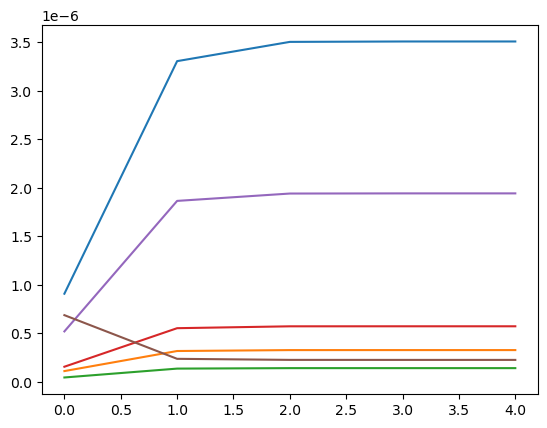

step: 0/1, D_loss: 0.10550949, G_loss_U: 4.2704244, G_loss_S: 0.05768647, E_loss_t0: 1.7498217


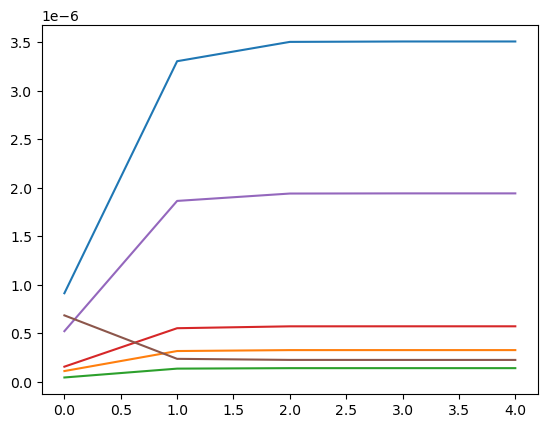

step: 0/1, D_loss: 0.11850597, G_loss_U: 4.270424, G_loss_S: 0.057650298, E_loss_t0: 2.506991


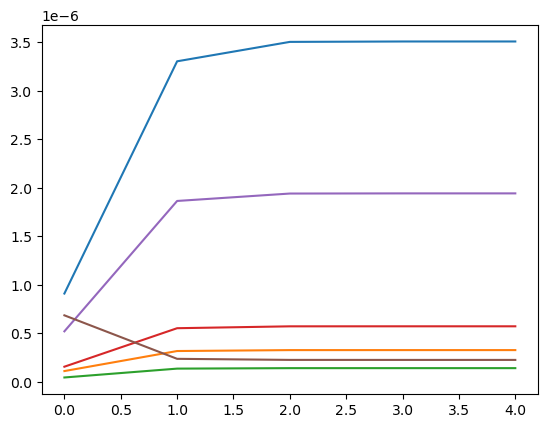

step: 0/1, D_loss: 0.10621076, G_loss_U: 4.2704225, G_loss_S: 0.05770136, E_loss_t0: 1.5041238


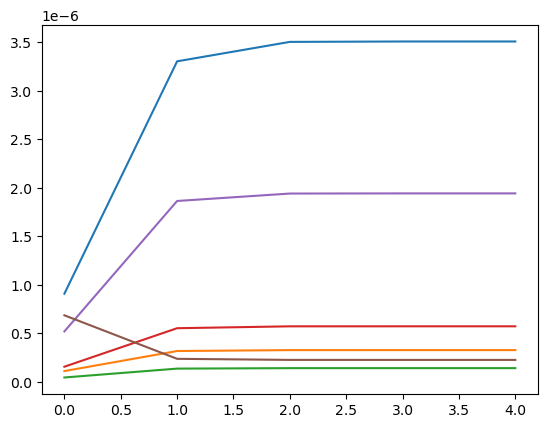

step: 0/1, D_loss: 0.10625857, G_loss_U: 4.2704206, G_loss_S: 0.05766767, E_loss_t0: 1.7787172


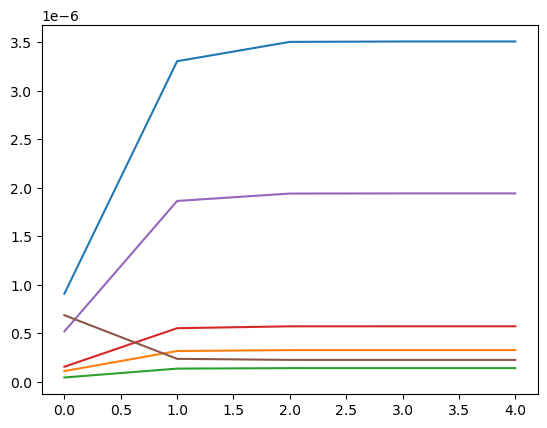

step: 0/1, D_loss: 0.10924182, G_loss_U: 4.2704177, G_loss_S: 0.05764853, E_loss_t0: 2.091423


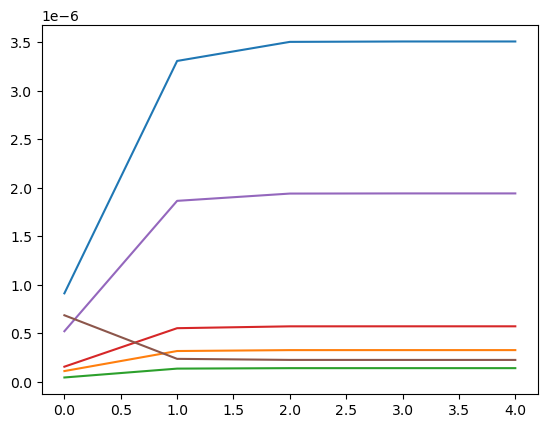

step: 0/1, D_loss: 0.115470275, G_loss_U: 4.270415, G_loss_S: 0.05780442, E_loss_t0: 2.0246944


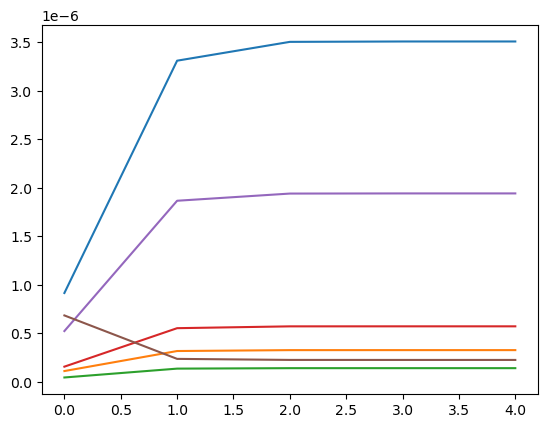

step: 0/1, D_loss: 0.10500392, G_loss_U: 4.270412, G_loss_S: 0.05767017, E_loss_t0: 1.5869764


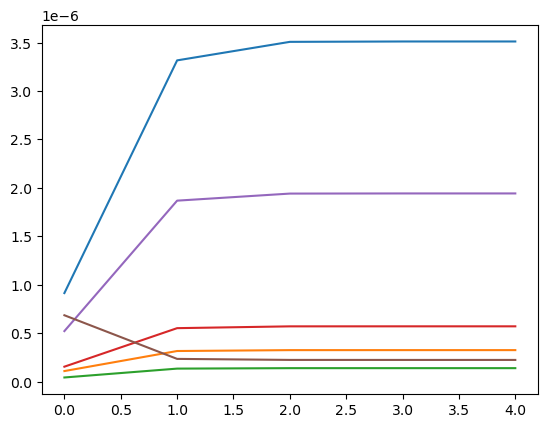

step: 0/1, D_loss: 0.10841857, G_loss_U: 4.2704096, G_loss_S: 0.057663962, E_loss_t0: 1.981939


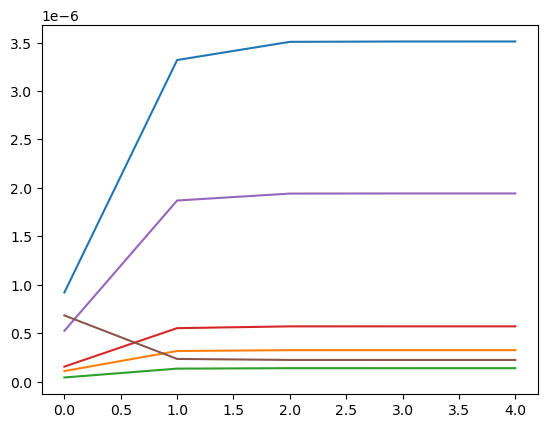

step: 0/1, D_loss: 0.10991123, G_loss_U: 4.270407, G_loss_S: 0.057621785, E_loss_t0: 2.2067122


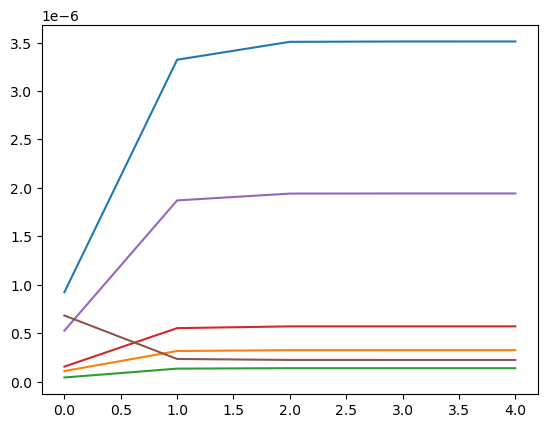

step: 0/1, D_loss: 0.10966037, G_loss_U: 4.270405, G_loss_S: 0.057634253, E_loss_t0: 2.1270301


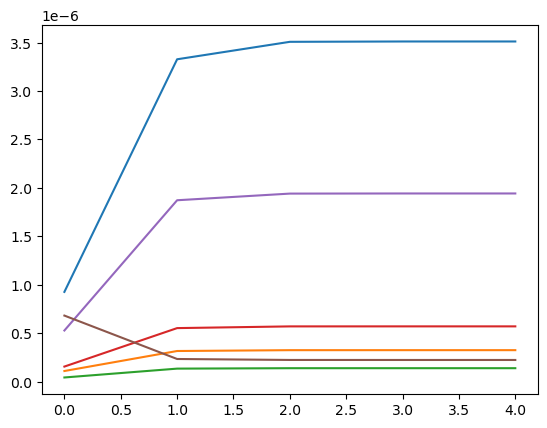

step: 0/1, D_loss: 0.10999277, G_loss_U: 4.2704024, G_loss_S: 0.0576248, E_loss_t0: 2.1661718


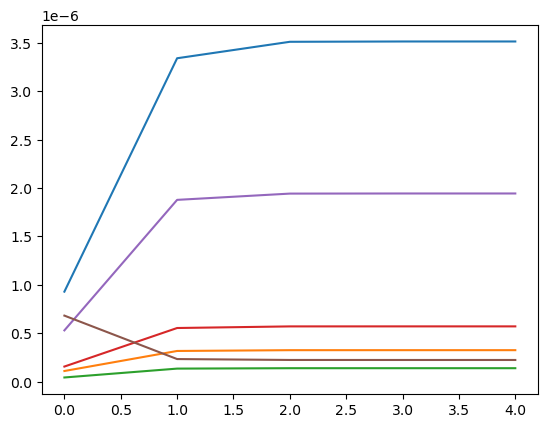

step: 0/1, D_loss: 0.11660873, G_loss_U: 4.270401, G_loss_S: 0.05777062, E_loss_t0: 2.2942595


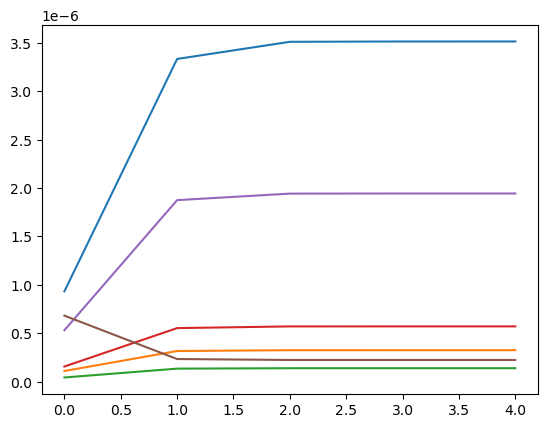

step: 0/1, D_loss: 0.11127824, G_loss_U: 4.2703996, G_loss_S: 0.057623543, E_loss_t0: 2.248358


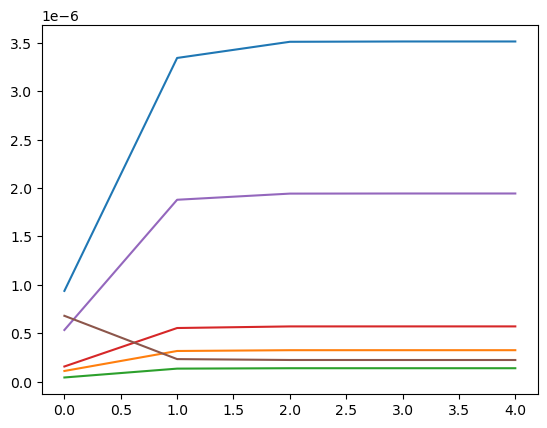

step: 0/1, D_loss: 0.10533639, G_loss_U: 4.270398, G_loss_S: 0.057640996, E_loss_t0: 1.7932259


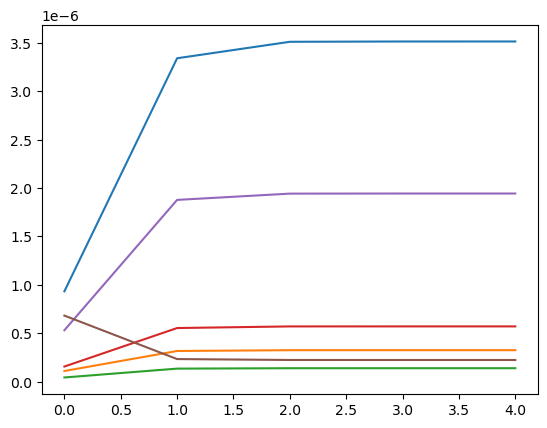

step: 0/1, D_loss: 0.10604663, G_loss_U: 4.2703967, G_loss_S: 0.057791576, E_loss_t0: 1.750542


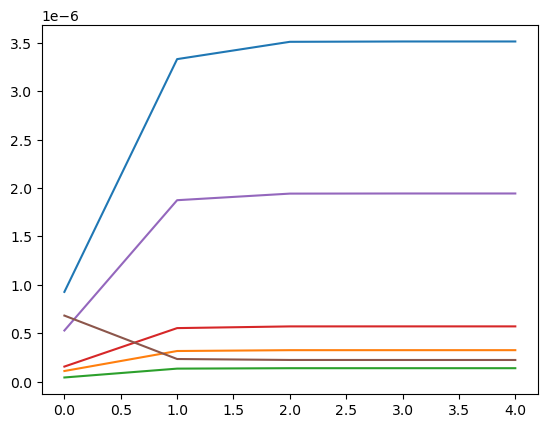

step: 0/1, D_loss: 0.112723395, G_loss_U: 4.2703958, G_loss_S: 0.057653, E_loss_t0: 2.1222484


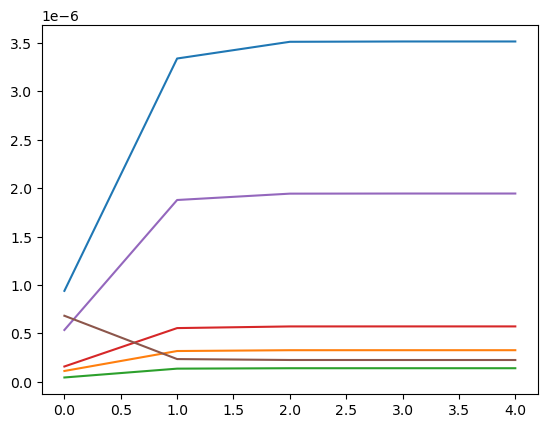

step: 0/1, D_loss: 0.113544695, G_loss_U: 4.270394, G_loss_S: 0.057867482, E_loss_t0: 1.9699001


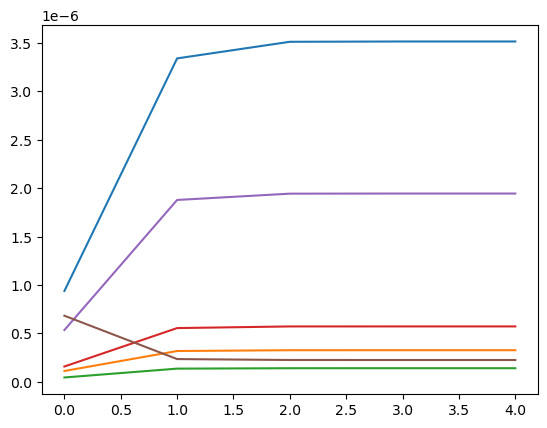

step: 0/1, D_loss: 0.10975245, G_loss_U: 4.270393, G_loss_S: 0.057674594, E_loss_t0: 1.9264132


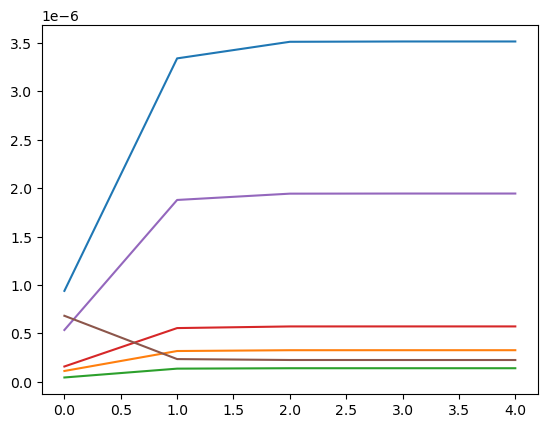

step: 0/1, D_loss: 0.10912229, G_loss_U: 4.270391, G_loss_S: 0.057591844, E_loss_t0: 2.207043


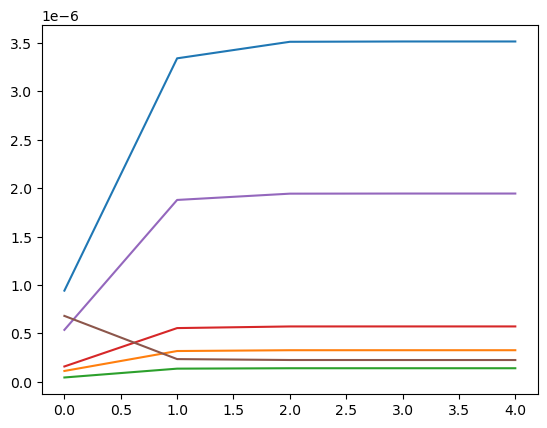

step: 0/1, D_loss: 0.10592407, G_loss_U: 4.2703896, G_loss_S: 0.05767277, E_loss_t0: 1.643136


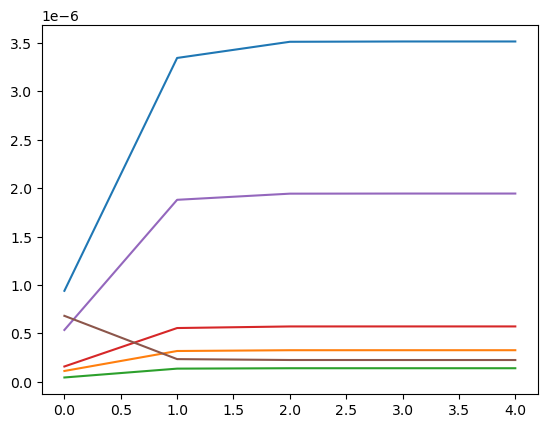

step: 0/1, D_loss: 0.104764685, G_loss_U: 4.2703876, G_loss_S: 0.05766874, E_loss_t0: 1.4529285


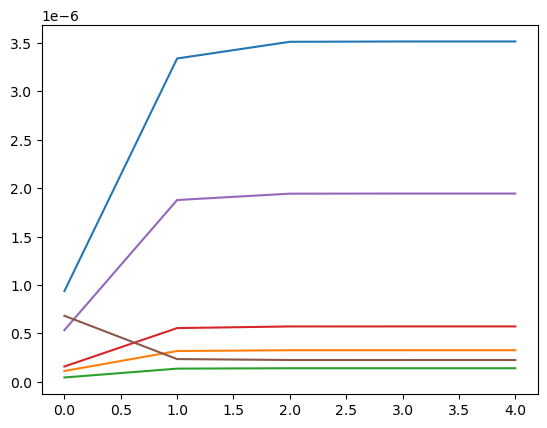

step: 0/1, D_loss: 0.11414642, G_loss_U: 4.270386, G_loss_S: 0.05764563, E_loss_t0: 2.3010244


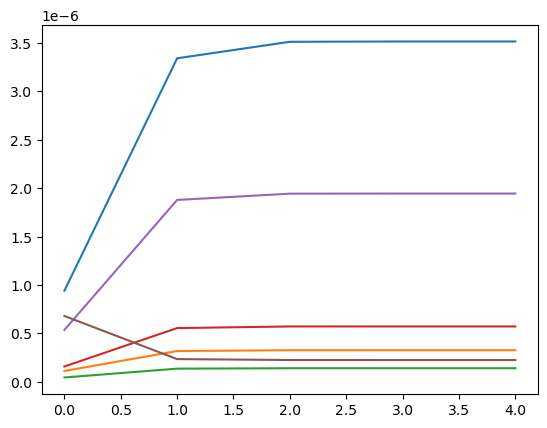

step: 0/1, D_loss: 0.10516329, G_loss_U: 4.2703843, G_loss_S: 0.057608653, E_loss_t0: 1.8261138


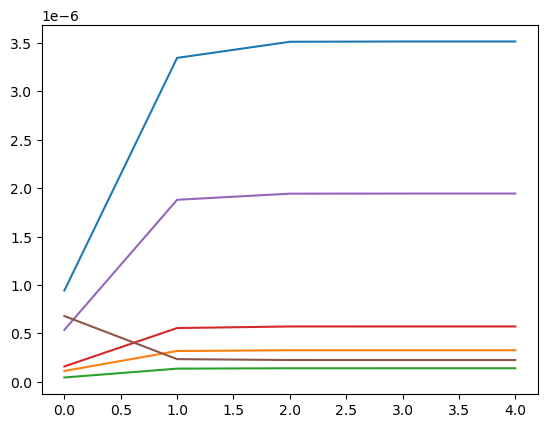

step: 0/1, D_loss: 0.11122596, G_loss_U: 4.270383, G_loss_S: 0.057628475, E_loss_t0: 2.2000823


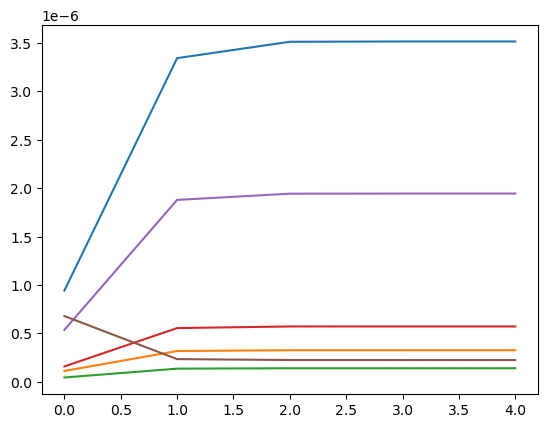

step: 0/1, D_loss: 0.10889432, G_loss_U: 4.27038, G_loss_S: 0.05765297, E_loss_t0: 1.9299607


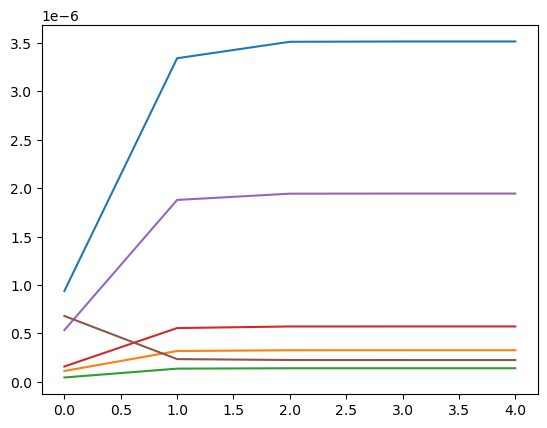

step: 0/1, D_loss: 0.106267564, G_loss_U: 4.2703786, G_loss_S: 0.057707272, E_loss_t0: 1.429101


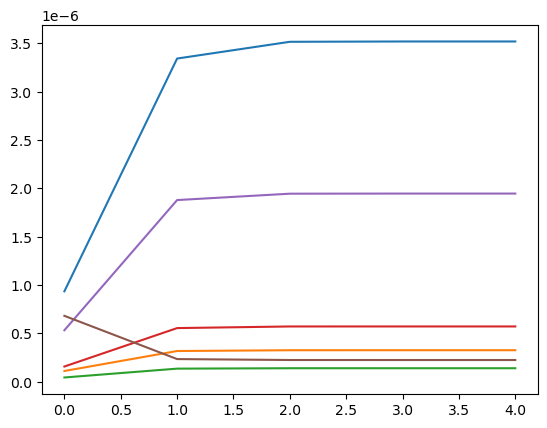

step: 0/1, D_loss: 0.10559182, G_loss_U: 4.270377, G_loss_S: 0.057672996, E_loss_t0: 1.2863833


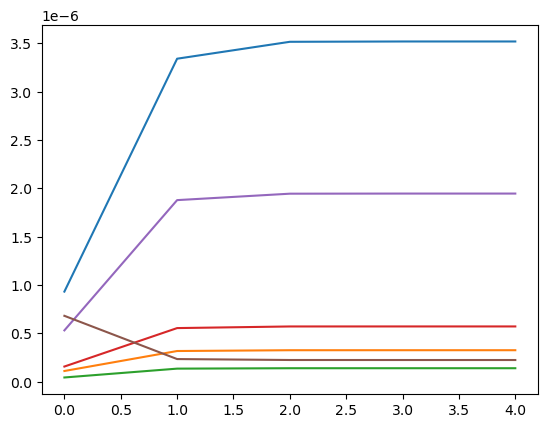

step: 0/1, D_loss: 0.1097014, G_loss_U: 4.2703753, G_loss_S: 0.057646047, E_loss_t0: 1.9987159


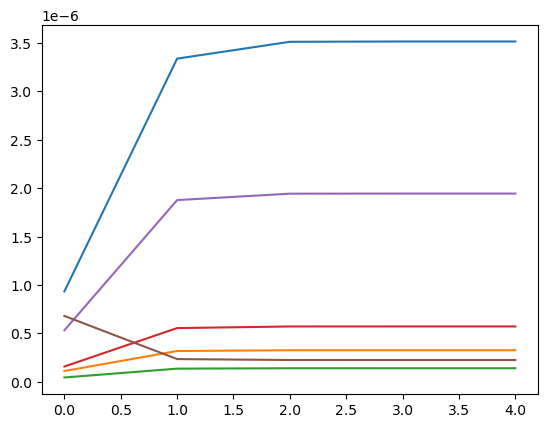

step: 0/1, D_loss: 0.10935534, G_loss_U: 4.2703743, G_loss_S: 0.057681266, E_loss_t0: 1.8765639


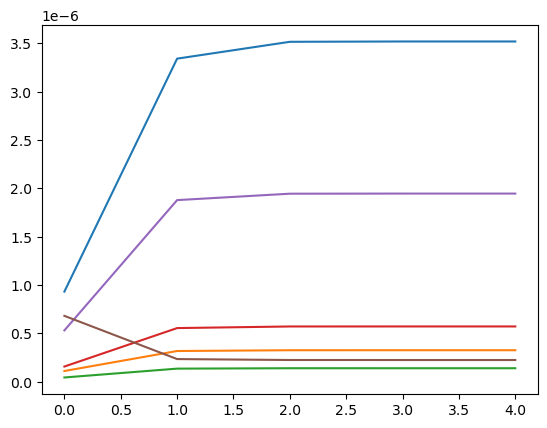

step: 0/1, D_loss: 0.114910334, G_loss_U: 4.2703724, G_loss_S: 0.057647496, E_loss_t0: 2.2032342


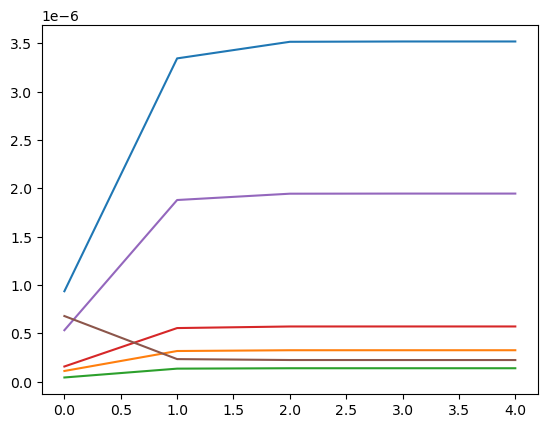

step: 0/1, D_loss: 0.10638769, G_loss_U: 4.270371, G_loss_S: 0.05762419, E_loss_t0: 1.7284039


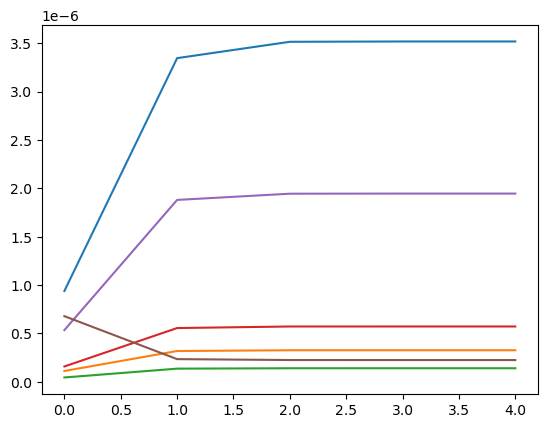

step: 0/1, D_loss: 0.10753911, G_loss_U: 4.270369, G_loss_S: 0.05769408, E_loss_t0: 1.3040433


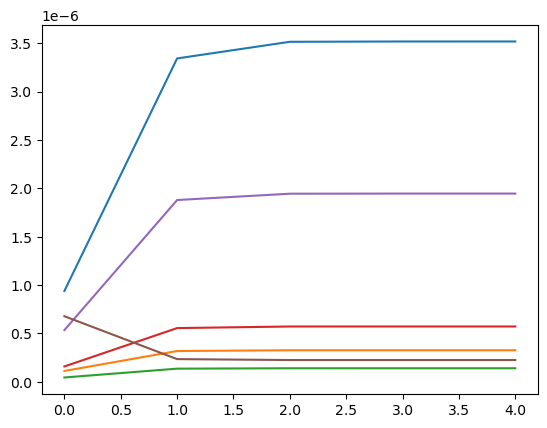

step: 0/1, D_loss: 0.10647233, G_loss_U: 4.270368, G_loss_S: 0.057636734, E_loss_t0: 1.6531025


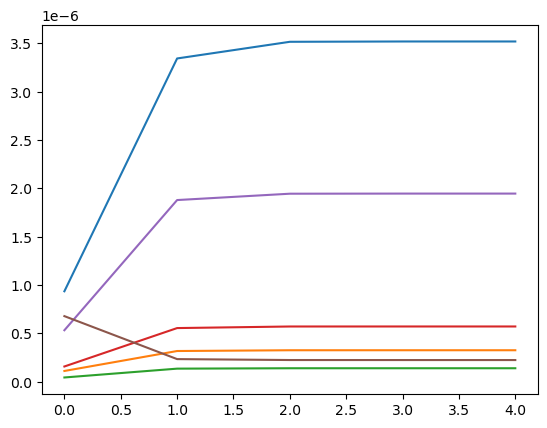

step: 0/1, D_loss: 0.11474707, G_loss_U: 4.2703667, G_loss_S: 0.05762713, E_loss_t0: 2.2150068


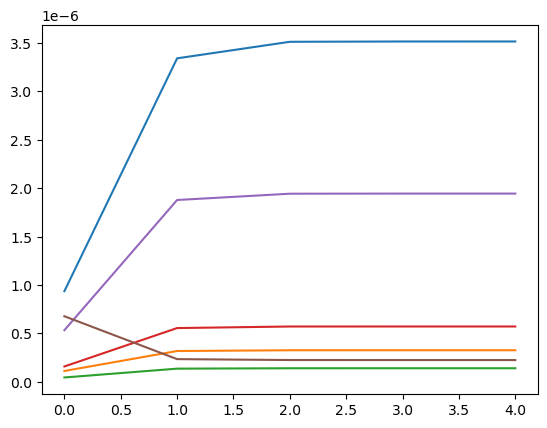

step: 0/1, D_loss: 0.112379305, G_loss_U: 4.2703648, G_loss_S: 0.057593063, E_loss_t0: 2.262686


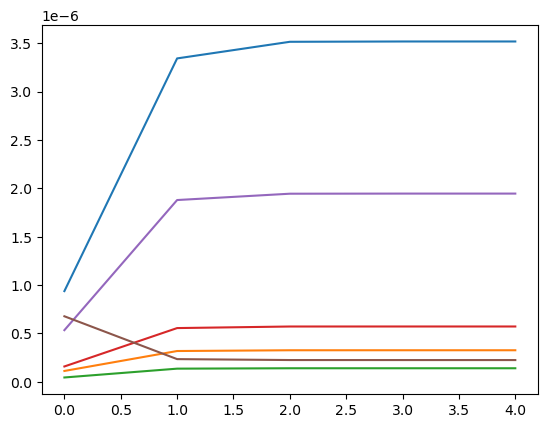

step: 0/1, D_loss: 0.107762724, G_loss_U: 4.2703633, G_loss_S: 0.057678808, E_loss_t0: 1.5933058


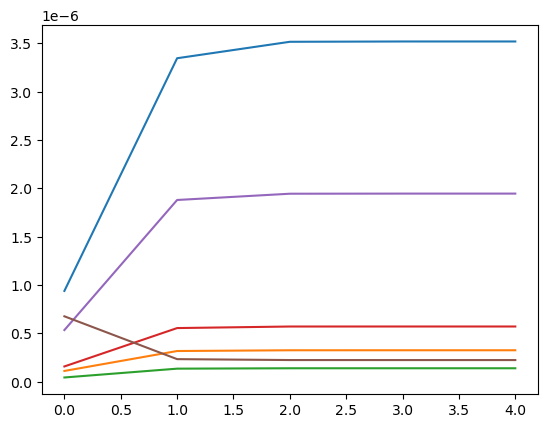

step: 0/1, D_loss: 0.10670468, G_loss_U: 4.2703614, G_loss_S: 0.057630733, E_loss_t0: 1.6800522


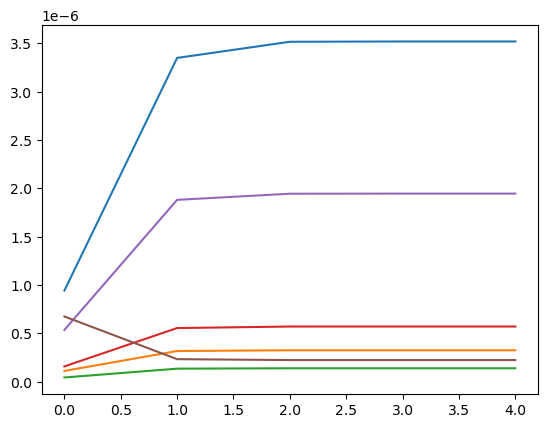

step: 0/1, D_loss: 0.10700968, G_loss_U: 4.27036, G_loss_S: 0.05760361, E_loss_t0: 1.8919924


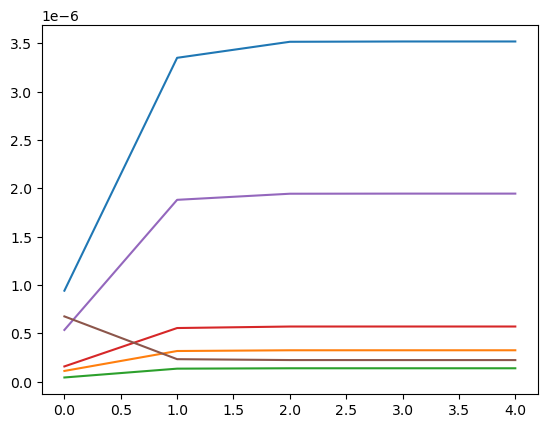

Fin du Training conjoint


In [50]:
Generator, Embedder, Supervisor, Recovery, Discriminator, checkpoints = TimeGAN(d, parameters,learning_rates)

A Data Set of the same size and dimensions of the original synthetic data Set is generated and visualized and both are compared

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.001s...
[t-SNE] Computed neighbors for 2000 samples in 0.175s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.104s
[t-SNE] Iteration 50: error = 69.6659088, gradient norm = 0.0319637 (50 iterations in 0.307s)
[t-SNE] Iteration 100: error = 63.1914825, gradient norm = 0.0115556 (50 iterations in 0.247s)
[t-SNE] Iteration 150: error = 62.2491684, gradient norm = 0.0062721 (50 iterations in 0.243s)
[t-SNE] Iteration 200: error = 61.9154129, gradient norm = 0.0045756 (50 iterations in 0.280s)
[t-SNE] Iteration 250: error = 61.7308044, gradient norm = 0.0034910 (50 iterations in 0.286s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.730804
[t-SNE] Iteration 300: error = 1.3760492, gradient norm = 0.0209997 (50 iterations in 0.236s)

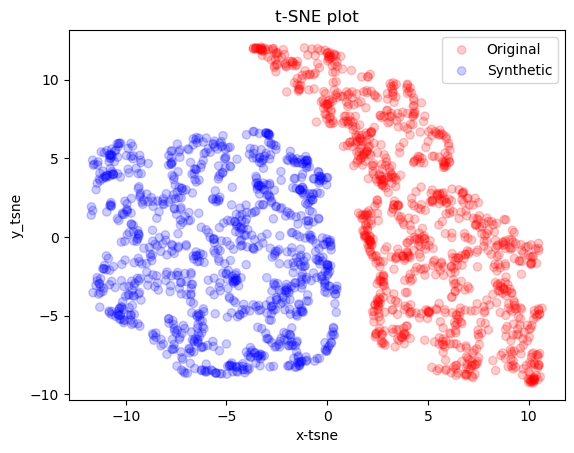

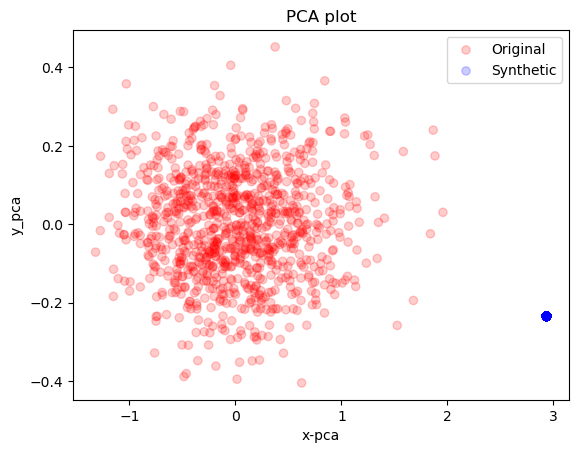

In [51]:
random_test = random_generator(no, dim, extract_time(data)[0], extract_time(data)[1])
test_sample = Generator(torch.tensor(random_generator(no, dim, extract_time(data)[0], extract_time(data)[1])).float())[0]
test_sample = torch.reshape(test_sample, (no, seq_len, parameters['hidden_dim']))
test_recovery = Recovery(test_sample)
test_recovery = torch.reshape(test_recovery[0], (no, seq_len, dim))
visualization(data, test_recovery.detach().numpy(), 'tsne')
visualization(data, test_recovery.detach().numpy(), 'pca')